## COP and COG estimation by derivative method
Trying to estimate COP and COG were used linear function wich didn't give the results expected, therefore we tried to make different approaches and one of them is the next function: 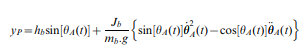

## Python libraries

First, let's import the necessary Python libraries and configure the environment:

In [1]:
import numpy as np
#from scipy.signal import butter, filtfilt
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
#import seaborn as sns
#sns.set_context("notebook", font_scale=1.3,
#                rc={'lines.linewidth': 1.5, 'lines.markersize': 14, 'axes.titlesize': 'x-large'})
#matplotlib.rc('legend', numpoints=1, fontsize=14)
#import glob
import sys, os
sys.path.insert(1, r'./Functions')
# IPython widgets:
from IPython.display import display
import ipywidgets
from ipywidgets import FloatProgress, interactive

Versions of the Python libraries used:

In [2]:
#!pip install version_information
%load_ext version_information
%version_information numpy, scipy, pandas, matplotlib, seaborn

Software versions
Python 3.8.8 64bit [MSC v.1916 64 bit (AMD64)]
IPython 7.22.0
OS Windows 10 10.0.22000 SP0
numpy 1.20.1
scipy 1.6.2
pandas 1.2.4
matplotlib 3.3.4
seaborn 0.11.1
Thu May 19 11:53:24 2022 Hora oficial do Brasil

## Meta data

The file `PDSinfo.txt` contains meta data about the subjects and the experimental trials. The file has a header plus 588 rows per 29 columns (there are 12 rows for each of the 49 subjects).   
Let's use the power of the [pandas](http://pandas.pydata.org/) library to load and explore the meta data:

In [3]:
# GitHub URL:
#path2 = 'C:\Users\ferna\Downloads\IC- dados\Dados'
# local directory:
path2 = r'C:\\Users\\ferna\\Downloads\\IC- dados\\Dados'
fname = os.path.join(path2, 'PDSinfo.txt')
PDSinfo = pd.read_csv(fname, sep='\t', header=0, index_col=None, engine='c', encoding='utf-8')
print(fname)
print("Information of %s subjects loaded (%s rows, %s columns)."
      %(len(pd.unique(PDSinfo.Subject)), PDSinfo.shape[0], PDSinfo.shape[1]))

C:\\Users\\ferna\\Downloads\\IC- dados\\Dados\PDSinfo.txt
Information of 49 subjects loaded (588 rows, 29 columns).


In [4]:
a=PDSinfo[PDSinfo['Subject']==44].index.tolist()
e=PDSinfo[PDSinfo['Subject']==44].index.tolist()[2]
print(a)
print(e)

[516, 517, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527]
518


Here are the first 12 rows and first 10 columns of meta data:

## COP and COG displacements

## For Every Subject

The Center of Pressure mesured will be called COPXrealmatrix and COPZrealmatrix and the one calculated by COPXmatrix and COPZmatrix by the equation with Yp being the center of pressure.

In [5]:
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.cos(angulox)
    cosz=np.cos(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[30:])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, 30):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)

## Graphics between real and calculated COP

We are going to compare the results of our calculation so subtracting the real one from the calculated one is found the error. From it the next steps will try to find where is this error. 

In [6]:
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.cos(angulox)
    cosz=np.cos(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[30:])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, 30):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)

## Graphics between real and calculated COP

We are going to compare the results of our calculation so subtracting the real one from the calculated one is found the error. From it the next steps will try to find where is this error. 

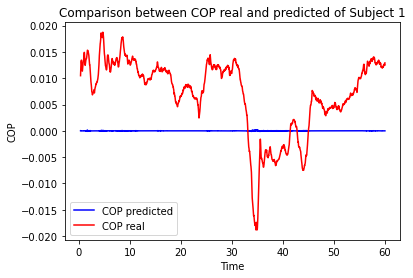

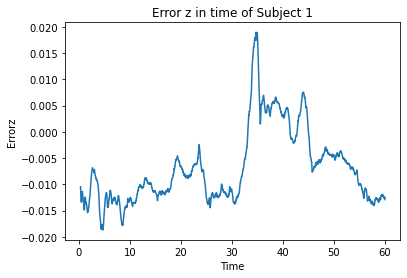

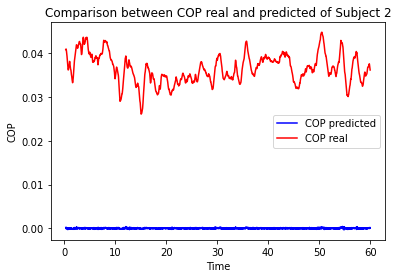

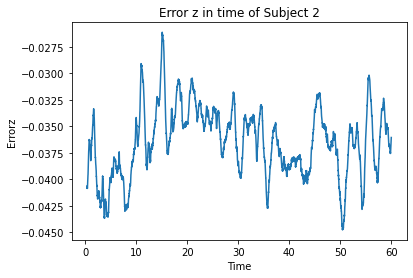

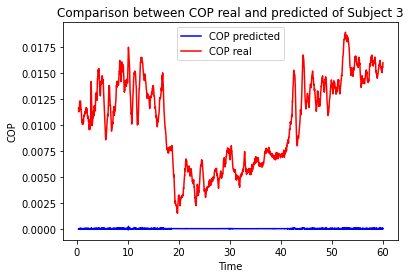

...

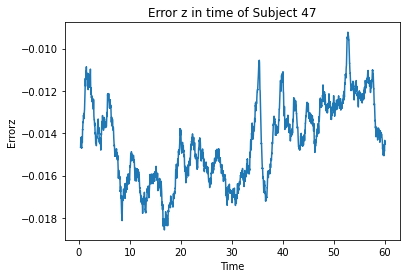

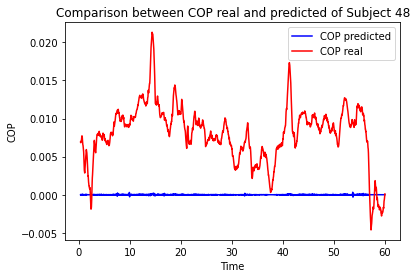

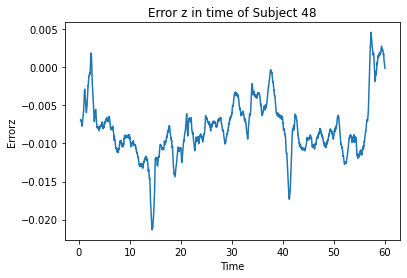

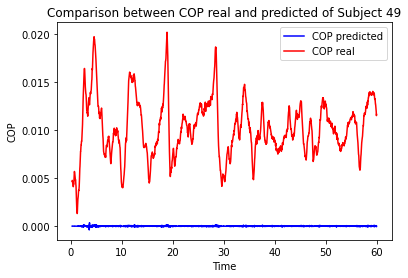

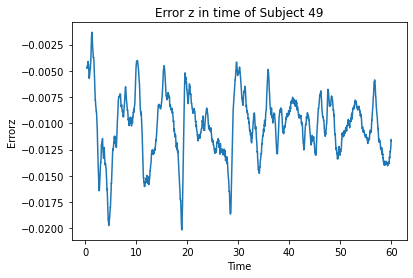

In [16]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(t[30:],COPZmatrix,color='blue',label='COP predicted')
    plt.plot(t[30:],COPZrealmatrix,color='red',label='COP real')
    plt.xlabel("Time")
    plt.ylabel("COP")
    plt.legend()
    plt.title('Comparison between COP real and predicted of Subject {}'.format(s))
    plt.show()
    plt.figure()
    plt.plot(t[30:],errorz,linestyle='-')
    plt.xlabel('Time')
    plt.ylabel('Errorz')
    plt.title('Error z in time of Subject {}'.format(s))
    plt.show()

# COP in function of angles

Let's se how the COP correlates with the angles x and z, if the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice some lack of correlation between them. 

# Correlation between COPZ and Angle x

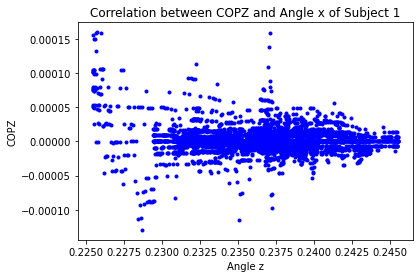

[[ 1.         -0.14403563]
 [-0.14403563  1.        ]]


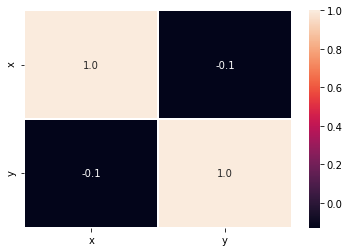

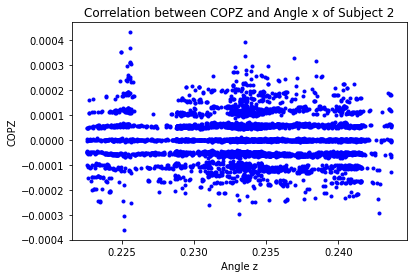

[[1.         0.21807902]
 [0.21807902 1.        ]]


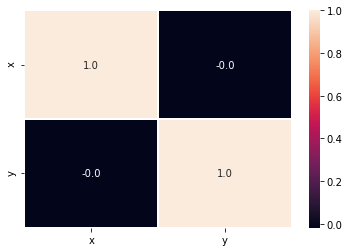

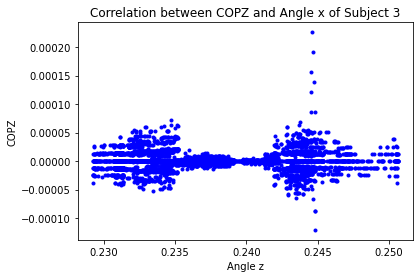

[[1.         0.07228127]
 [0.07228127 1.        ]]


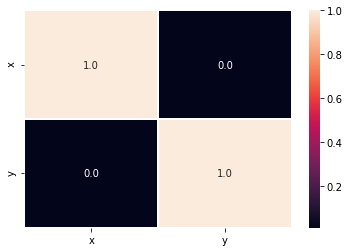

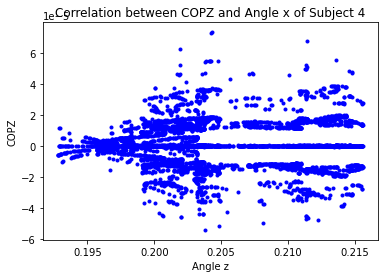

[[1.         0.05828379]
 [0.05828379 1.        ]]


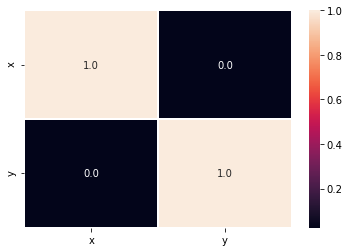

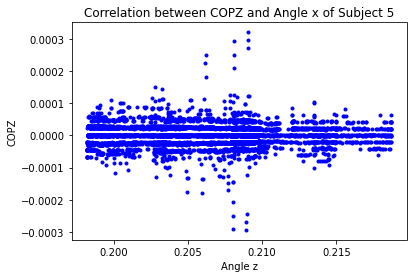

[[ 1.       -0.121604]
 [-0.121604  1.      ]]


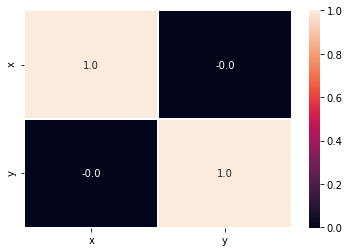

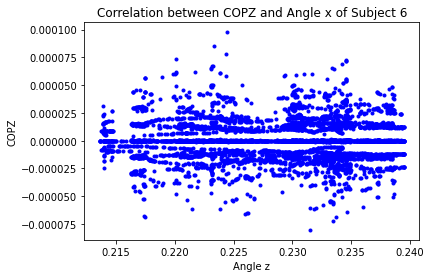

[[1.         0.10193653]
 [0.10193653 1.        ]]


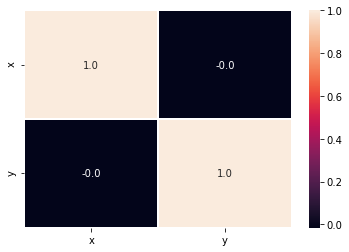

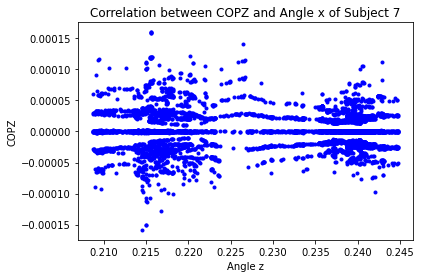

[[1.        0.1471566]
 [0.1471566 1.       ]]


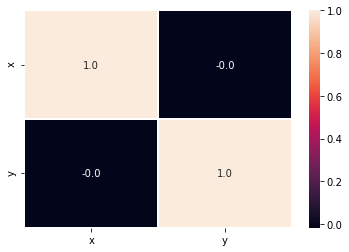

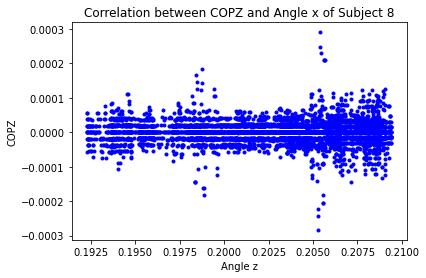

[[1.        0.0648245]
 [0.0648245 1.       ]]


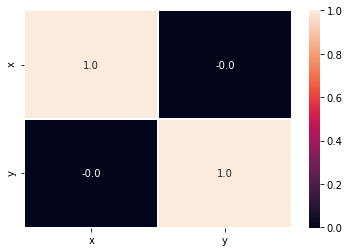

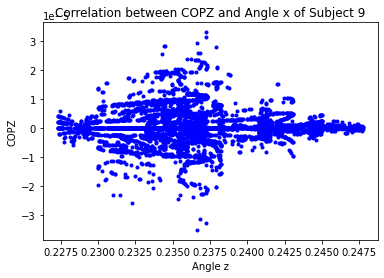

[[1.         0.03271649]
 [0.03271649 1.        ]]


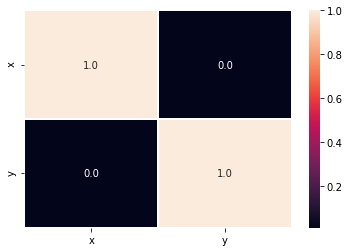

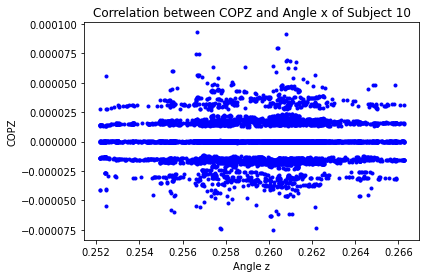

[[1.         0.16756608]
 [0.16756608 1.        ]]


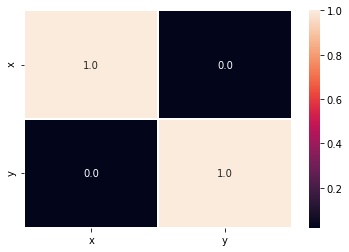

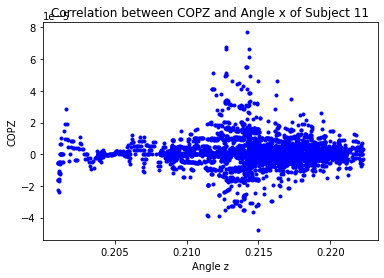

[[1.         0.08961585]
 [0.08961585 1.        ]]


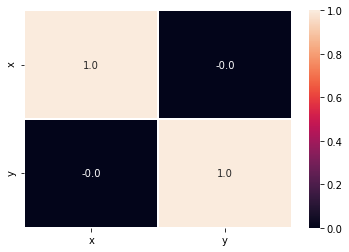

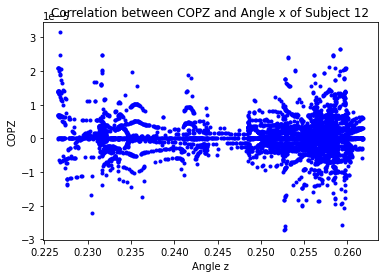

[[1.         0.05003153]
 [0.05003153 1.        ]]


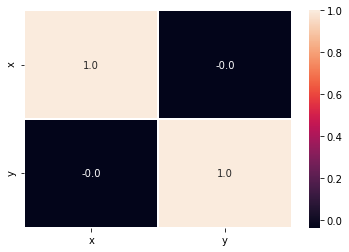

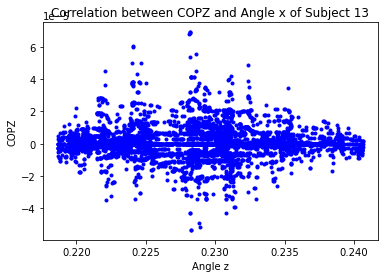

[[ 1.         -0.02690648]
 [-0.02690648  1.        ]]


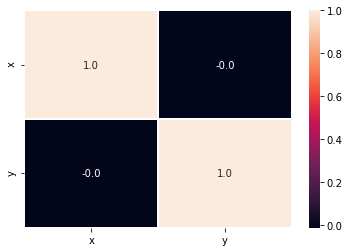

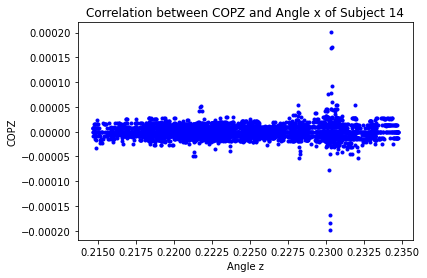

[[ 1.         -0.12561046]
 [-0.12561046  1.        ]]


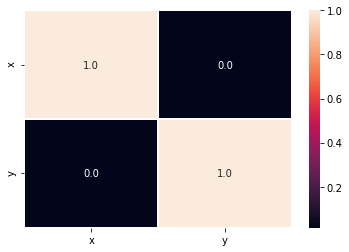

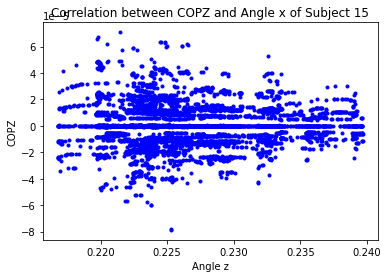

[[1.         0.09933913]
 [0.09933913 1.        ]]


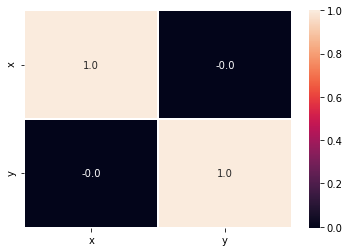

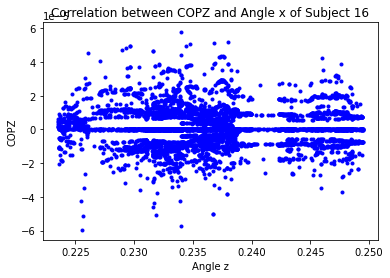

[[ 1.        -0.1455131]
 [-0.1455131  1.       ]]


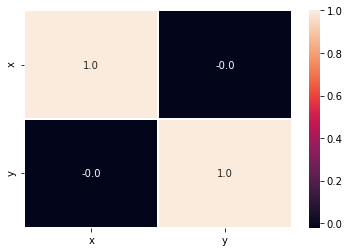

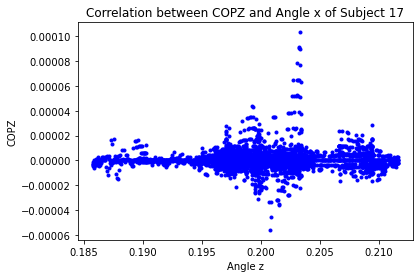

[[ 1.         -0.06016263]
 [-0.06016263  1.        ]]


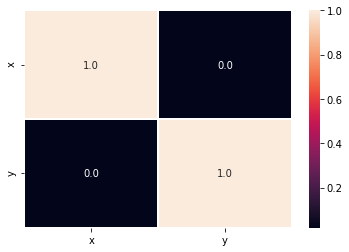

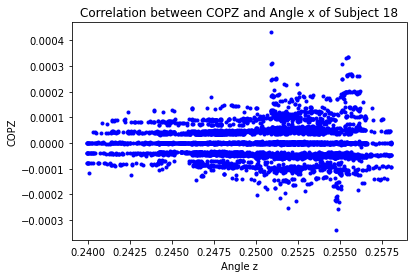

[[1.         0.17367161]
 [0.17367161 1.        ]]


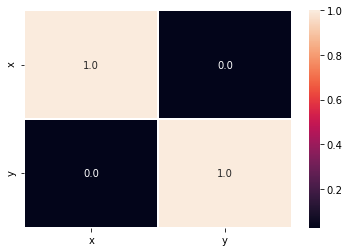

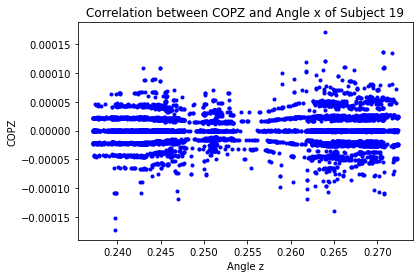

[[ 1.         -0.08445651]
 [-0.08445651  1.        ]]


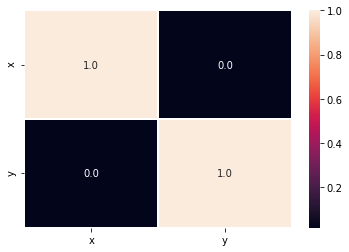

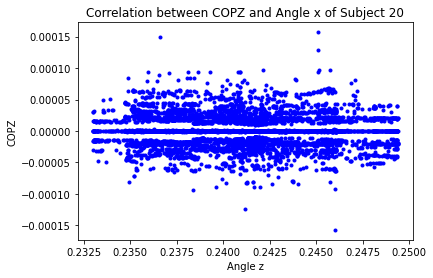

[[1.        0.1390074]
 [0.1390074 1.       ]]


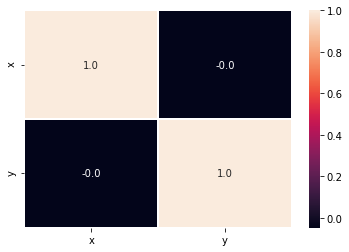

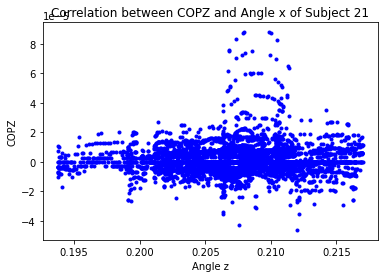

[[1.         0.34361882]
 [0.34361882 1.        ]]


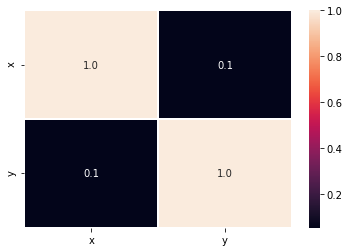

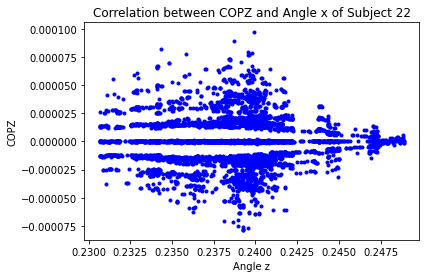

[[ 1.         -0.05863877]
 [-0.05863877  1.        ]]


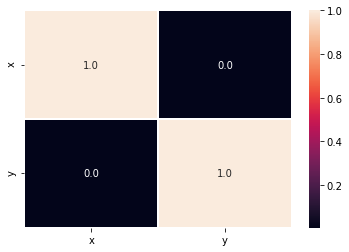

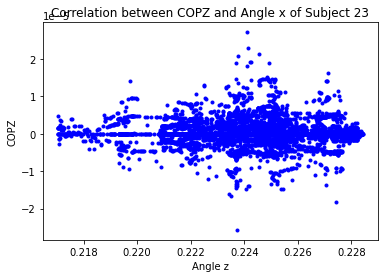

[[1.         0.01442831]
 [0.01442831 1.        ]]


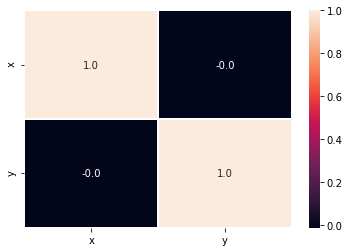

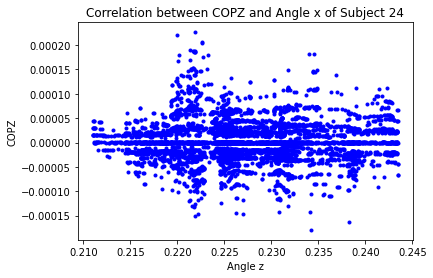

[[1.         0.22243312]
 [0.22243312 1.        ]]


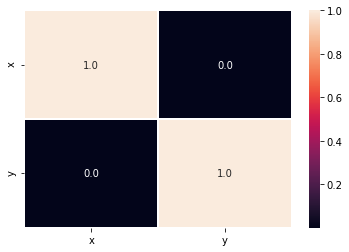

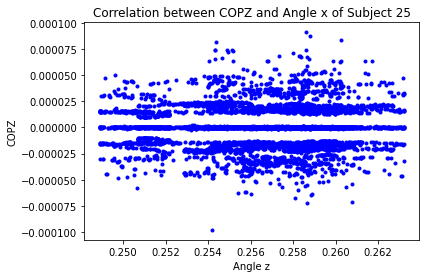

[[1.         0.13088832]
 [0.13088832 1.        ]]


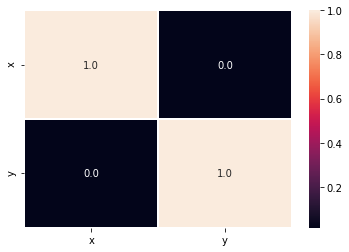

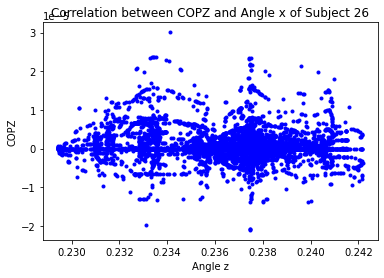

[[1.         0.04235588]
 [0.04235588 1.        ]]


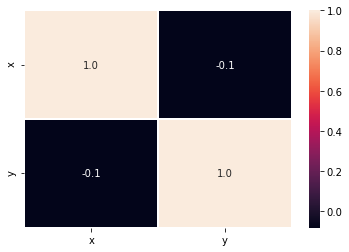

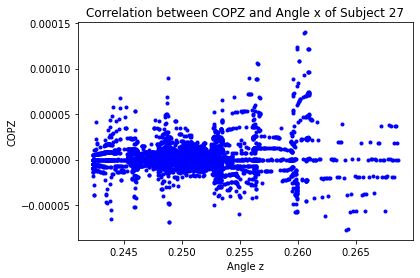

[[1.         0.14430678]
 [0.14430678 1.        ]]


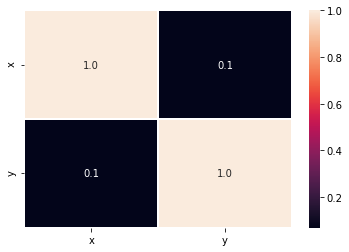

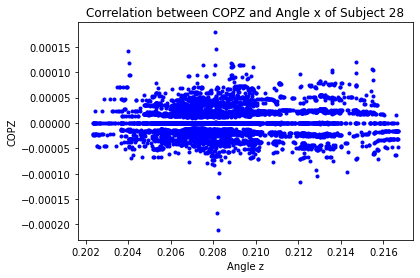

[[1.         0.21324222]
 [0.21324222 1.        ]]


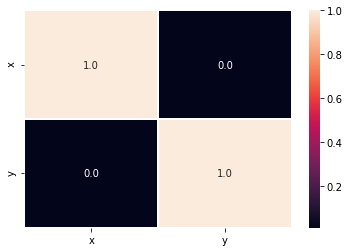

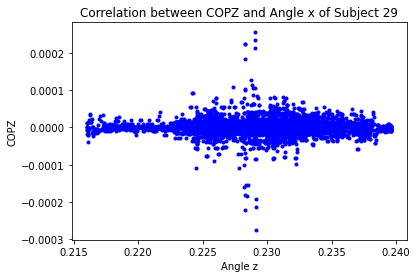

[[1.        0.0097136]
 [0.0097136 1.       ]]


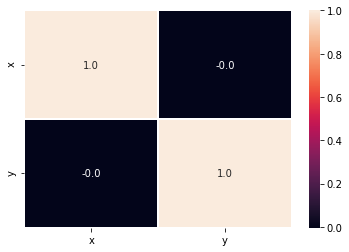

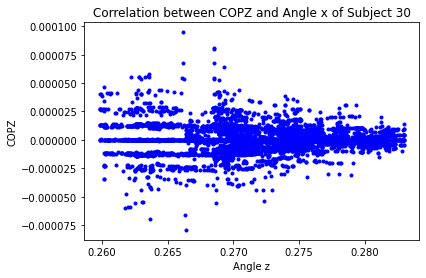

[[ 1.         -0.02822355]
 [-0.02822355  1.        ]]


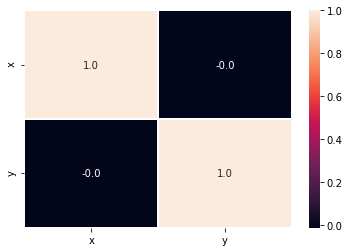

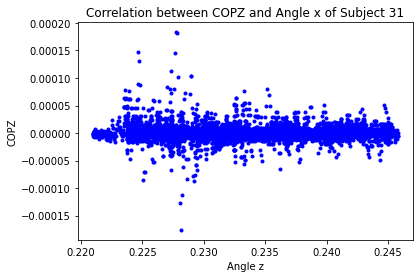

[[ 1.        -0.1785464]
 [-0.1785464  1.       ]]


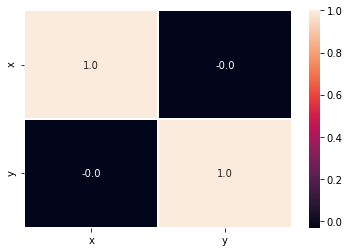

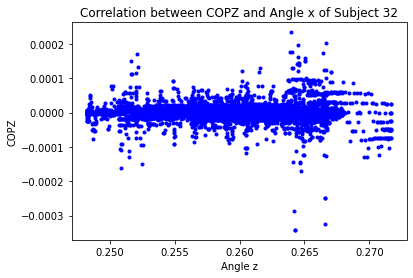

[[1.         0.07953065]
 [0.07953065 1.        ]]


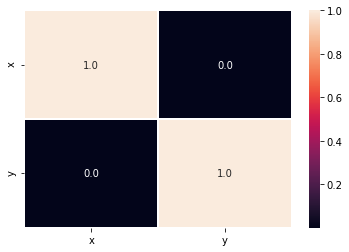

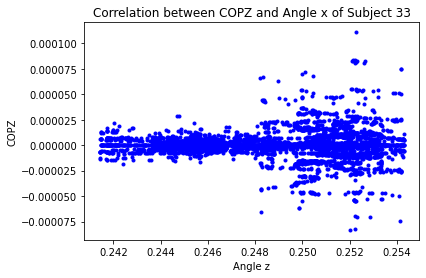

[[1.         0.04422312]
 [0.04422312 1.        ]]


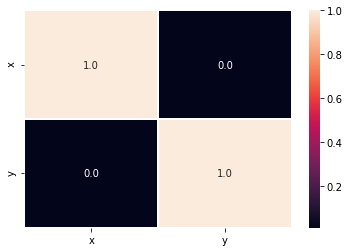

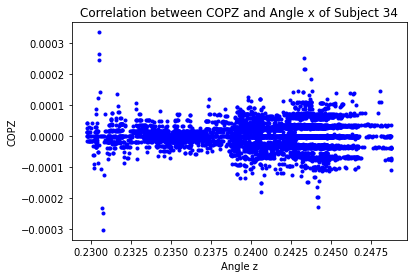

[[1.         0.04524243]
 [0.04524243 1.        ]]


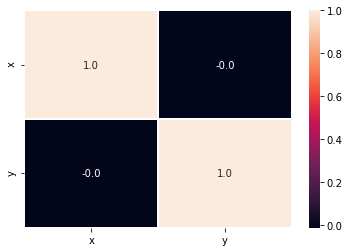

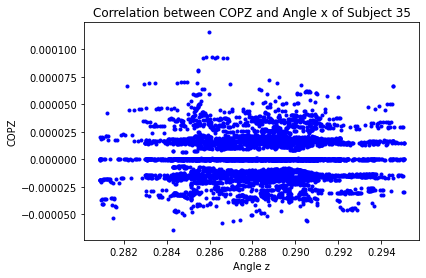

[[1.         0.16706772]
 [0.16706772 1.        ]]


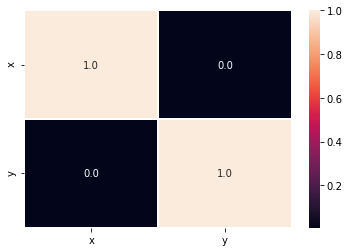

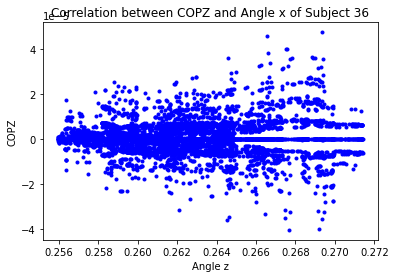

[[ 1.         -0.04901019]
 [-0.04901019  1.        ]]


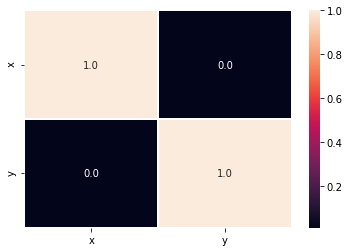

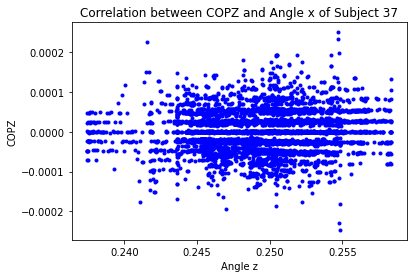

[[ 1.         -0.16876533]
 [-0.16876533  1.        ]]


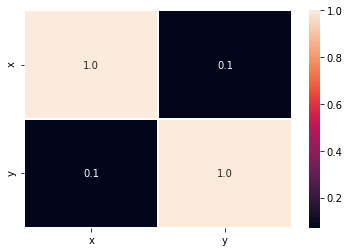

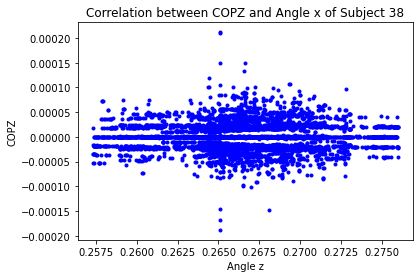

[[ 1.        -0.1125248]
 [-0.1125248  1.       ]]


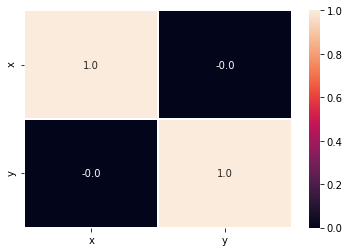

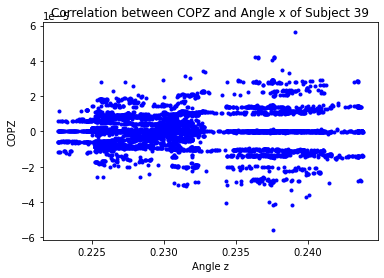

[[ 1.         -0.01624738]
 [-0.01624738  1.        ]]


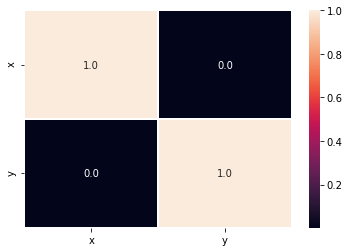

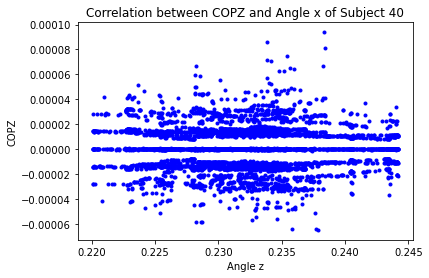

[[ 1.         -0.06845148]
 [-0.06845148  1.        ]]


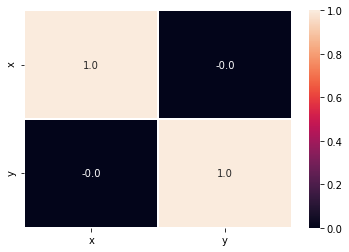

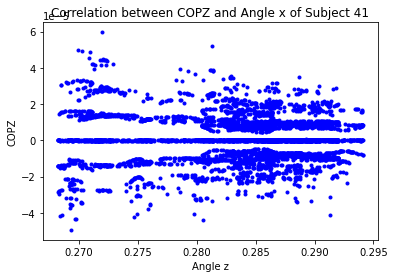

[[1.         0.17065841]
 [0.17065841 1.        ]]


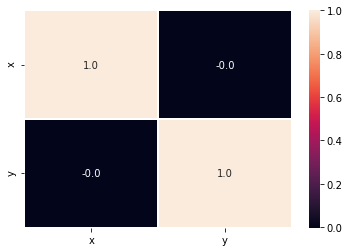

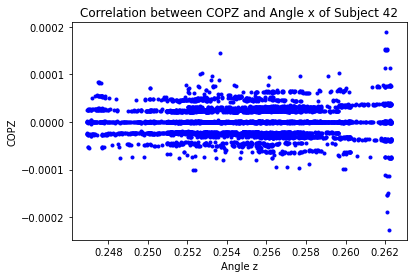

[[1.         0.04994623]
 [0.04994623 1.        ]]


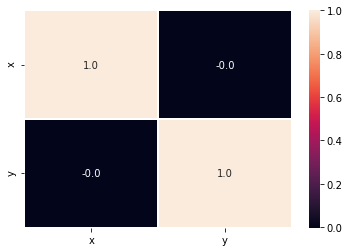

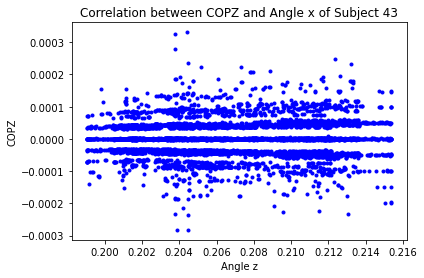

[[1.         0.09778195]
 [0.09778195 1.        ]]


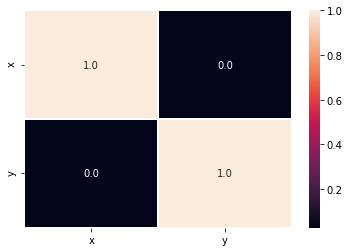

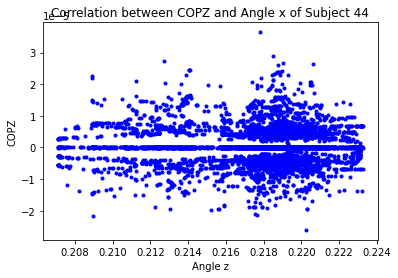

[[ 1.         -0.22033455]
 [-0.22033455  1.        ]]


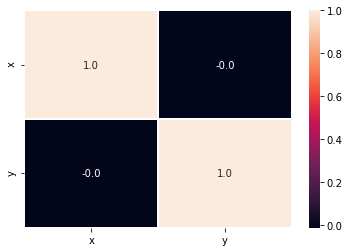

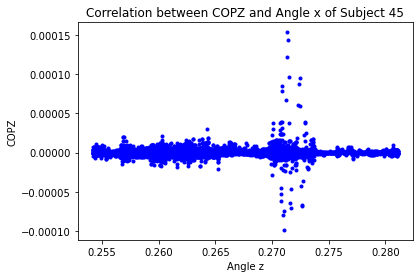

[[1.         0.02480303]
 [0.02480303 1.        ]]


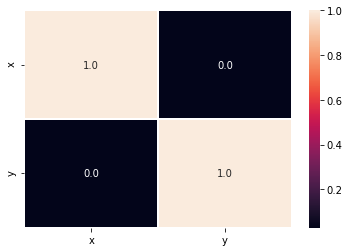

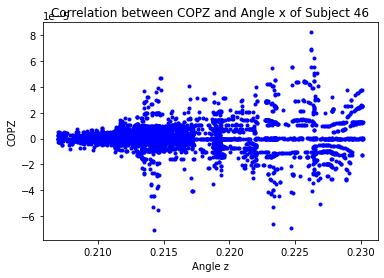

[[1.         0.09148871]
 [0.09148871 1.        ]]


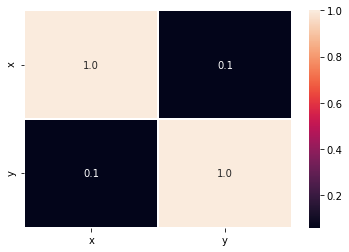

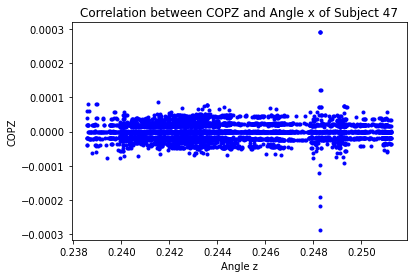

[[1.         0.06547364]
 [0.06547364 1.        ]]


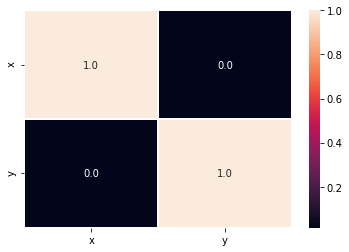

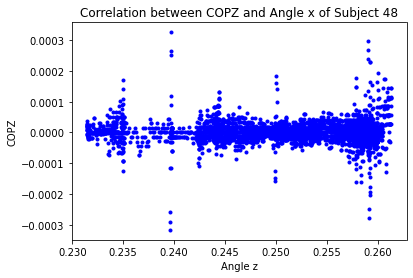

[[1.         0.11003892]
 [0.11003892 1.        ]]


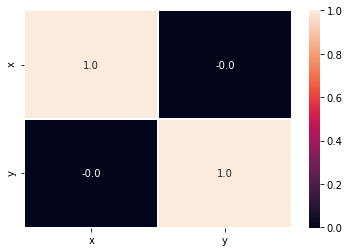

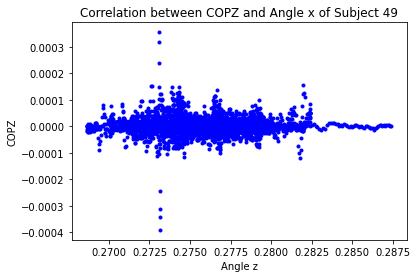

[[1.         0.20266237]
 [0.20266237 1.        ]]


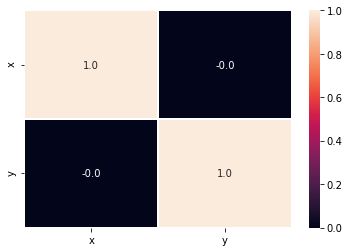

In [18]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangx,
         'y': COPZmatrix
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle z")
    plt.ylabel("COPZ")
    plt.title("Correlation between COPZ and Angle x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangz,COPZmatrix)
    print(r)
    plt.figure()
    data={'x':matrizangx,
          'y': COPZmatrix
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

# Correlation between COPZ and Angle z

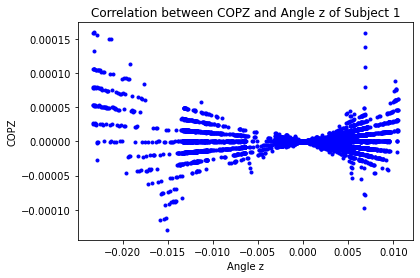

[[ 1.         -0.14403563]
 [-0.14403563  1.        ]]


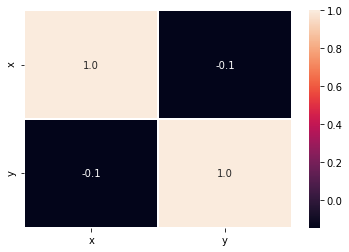

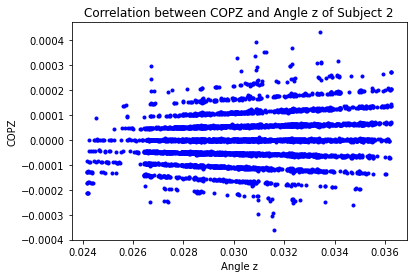

[[1.         0.21807902]
 [0.21807902 1.        ]]


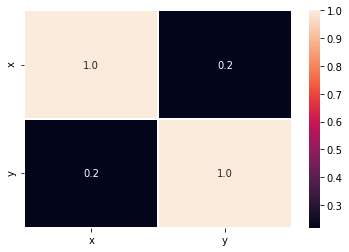

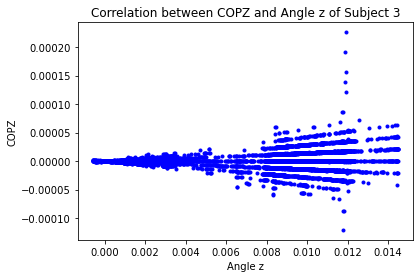

[[1.         0.07228127]
 [0.07228127 1.        ]]


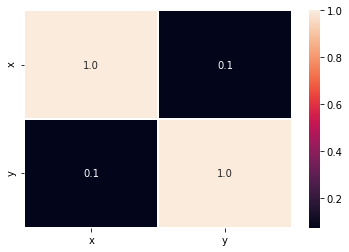

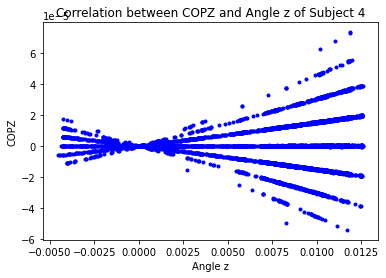

[[1.         0.05828379]
 [0.05828379 1.        ]]


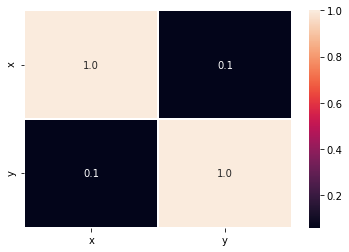

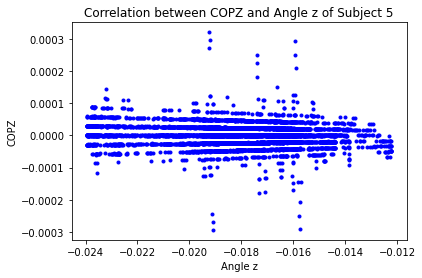

[[ 1.       -0.121604]
 [-0.121604  1.      ]]


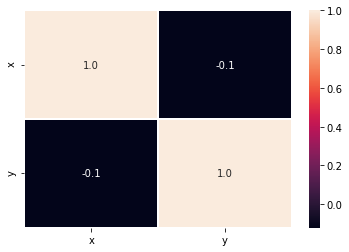

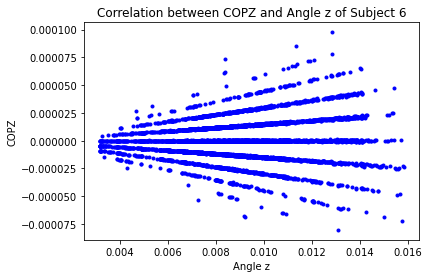

[[1.         0.10193653]
 [0.10193653 1.        ]]


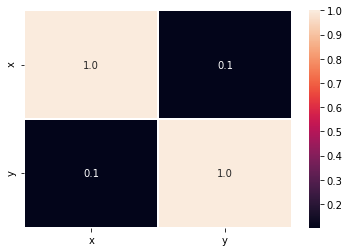

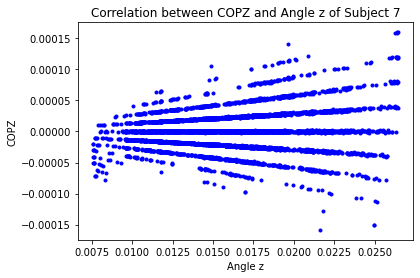

[[1.        0.1471566]
 [0.1471566 1.       ]]


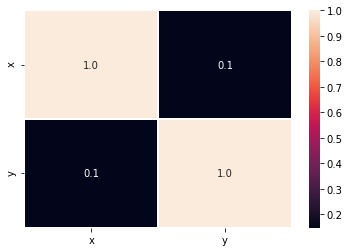

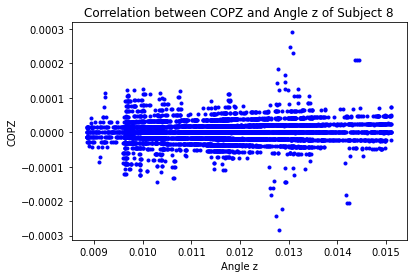

[[1.        0.0648245]
 [0.0648245 1.       ]]


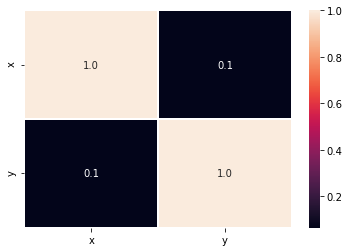

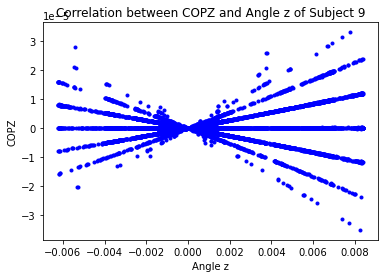

[[1.         0.03271649]
 [0.03271649 1.        ]]


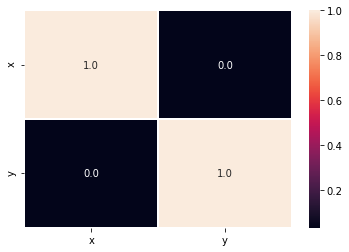

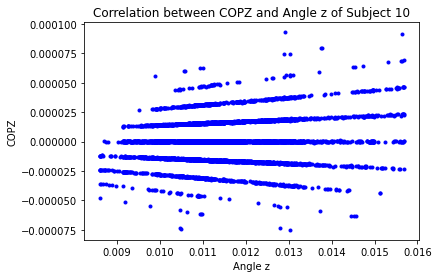

[[1.         0.16756608]
 [0.16756608 1.        ]]


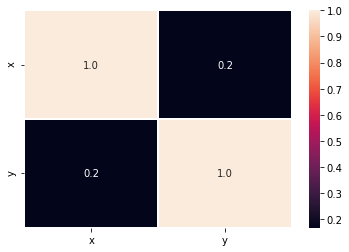

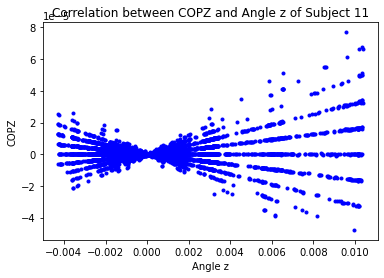

[[1.         0.08961585]
 [0.08961585 1.        ]]


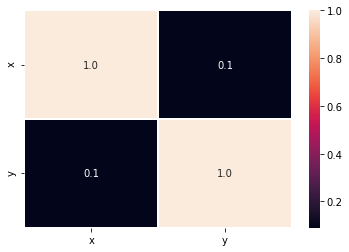

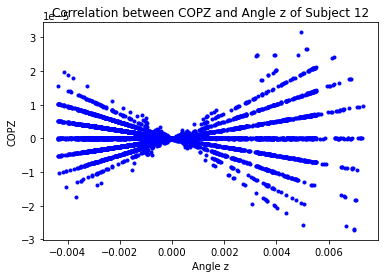

[[1.         0.05003153]
 [0.05003153 1.        ]]


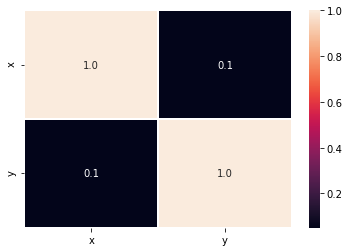

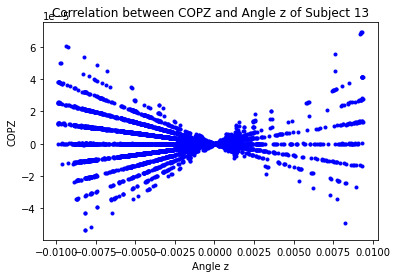

[[ 1.         -0.02690648]
 [-0.02690648  1.        ]]


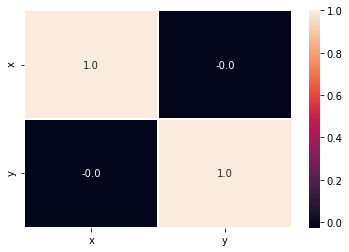

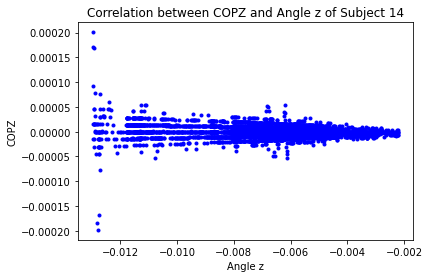

[[ 1.         -0.12561046]
 [-0.12561046  1.        ]]


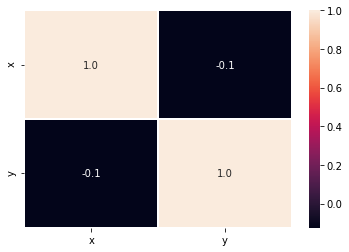

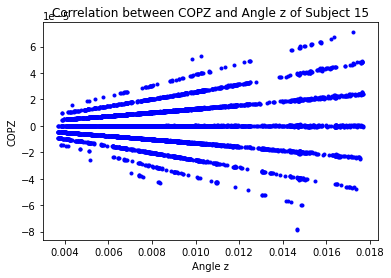

[[1.         0.09933913]
 [0.09933913 1.        ]]


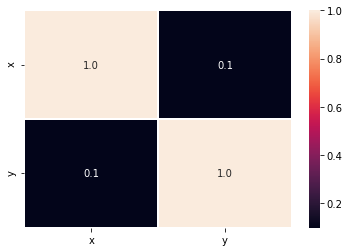

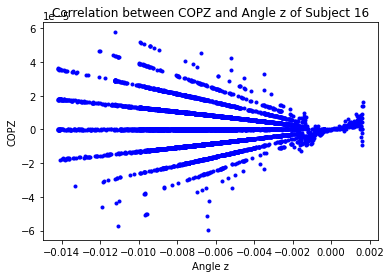

[[ 1.        -0.1455131]
 [-0.1455131  1.       ]]


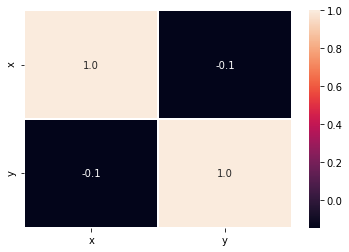

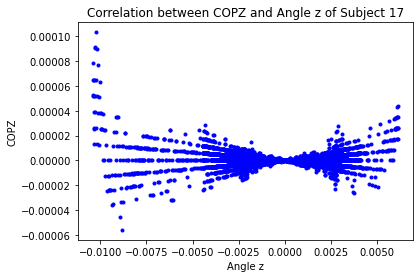

[[ 1.         -0.06016263]
 [-0.06016263  1.        ]]


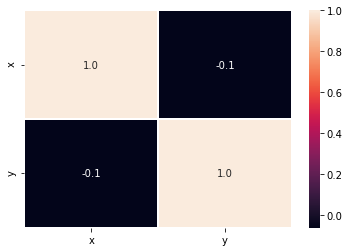

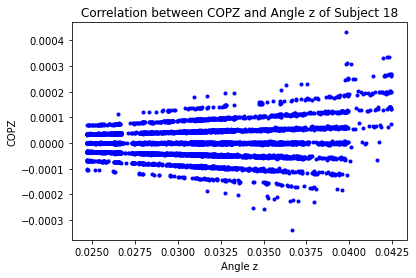

[[1.         0.17367161]
 [0.17367161 1.        ]]


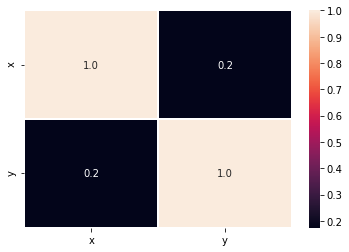

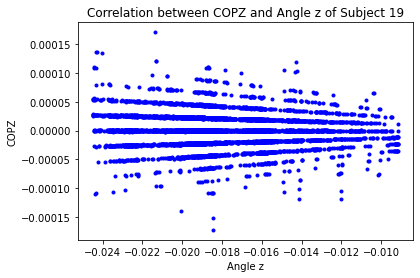

[[ 1.         -0.08445651]
 [-0.08445651  1.        ]]


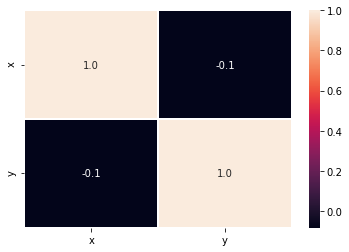

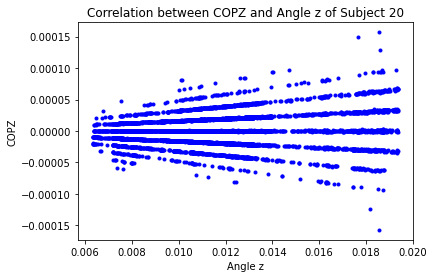

[[1.        0.1390074]
 [0.1390074 1.       ]]


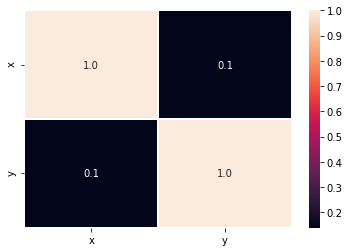

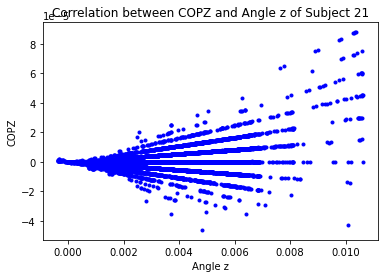

[[1.         0.34361882]
 [0.34361882 1.        ]]


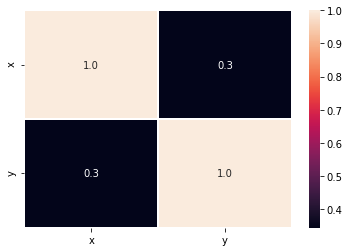

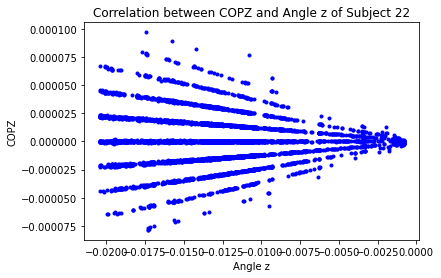

[[ 1.         -0.05863877]
 [-0.05863877  1.        ]]


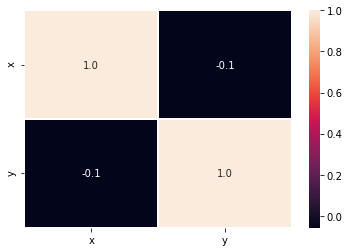

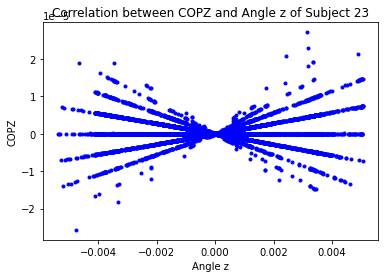

[[1.         0.01442831]
 [0.01442831 1.        ]]


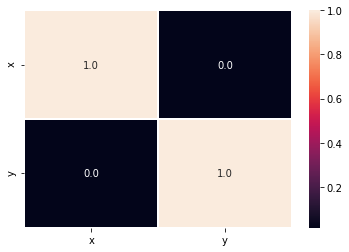

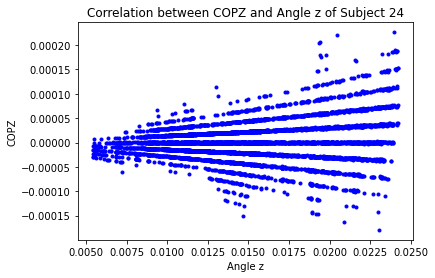

[[1.         0.22243312]
 [0.22243312 1.        ]]


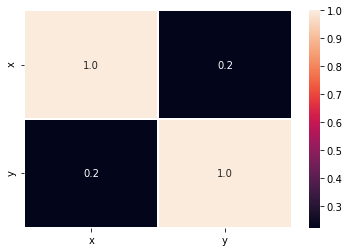

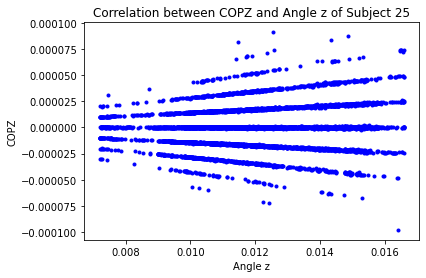

[[1.         0.13088832]
 [0.13088832 1.        ]]


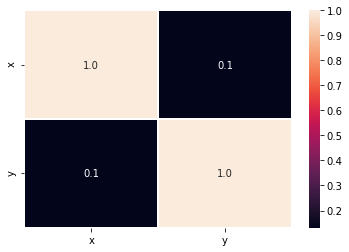

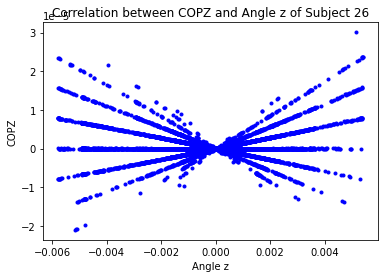

[[1.         0.04235588]
 [0.04235588 1.        ]]


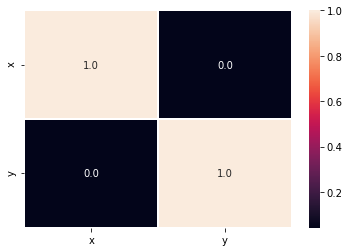

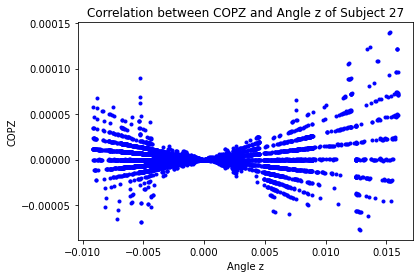

[[1.         0.14430678]
 [0.14430678 1.        ]]


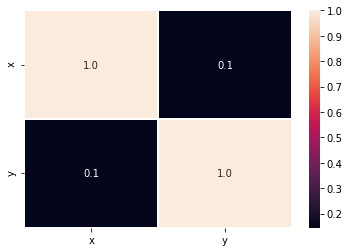

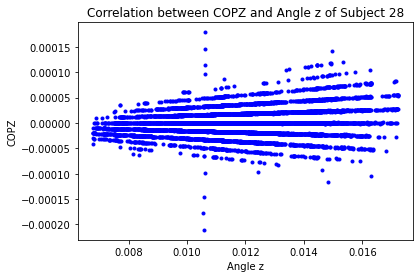

[[1.         0.21324222]
 [0.21324222 1.        ]]


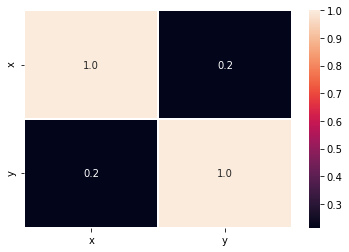

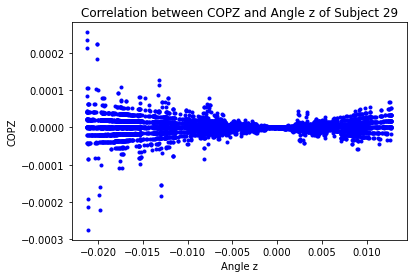

[[1.        0.0097136]
 [0.0097136 1.       ]]


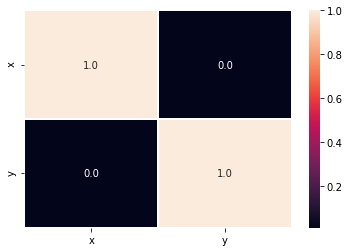

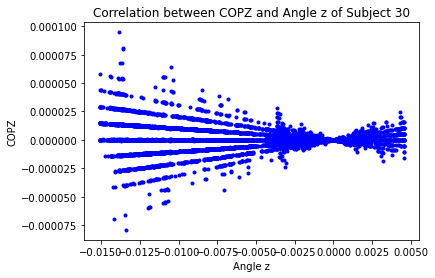

[[ 1.         -0.02822355]
 [-0.02822355  1.        ]]


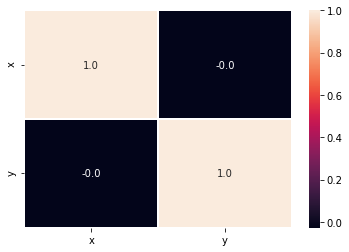

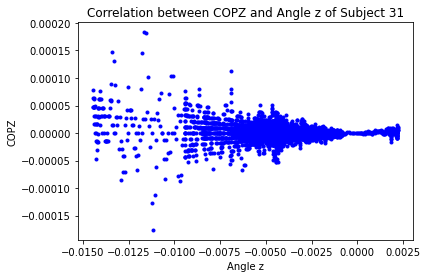

[[ 1.        -0.1785464]
 [-0.1785464  1.       ]]


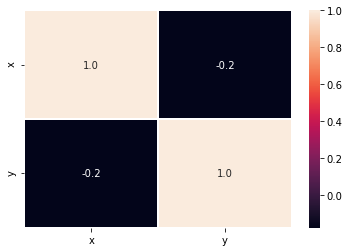

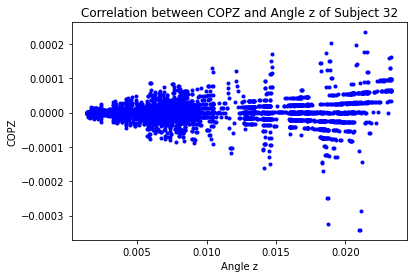

[[1.         0.07953065]
 [0.07953065 1.        ]]


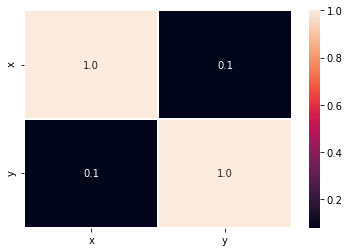

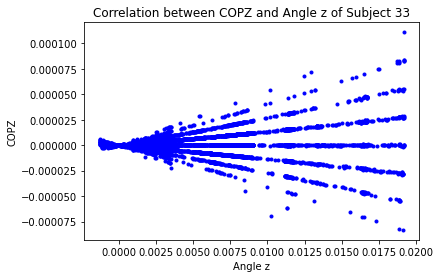

[[1.         0.04422312]
 [0.04422312 1.        ]]


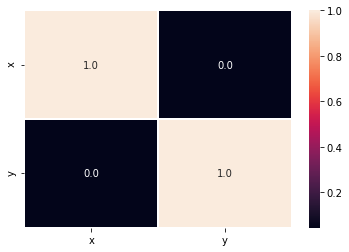

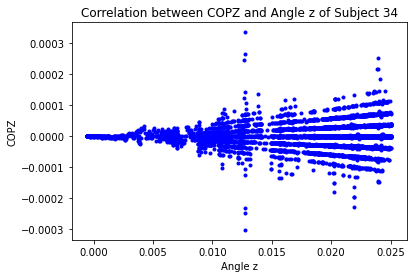

[[1.         0.04524243]
 [0.04524243 1.        ]]


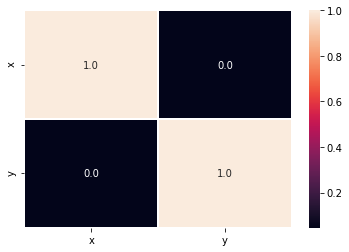

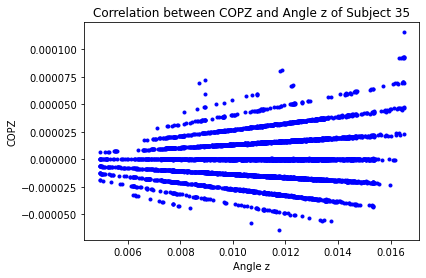

[[1.         0.16706772]
 [0.16706772 1.        ]]


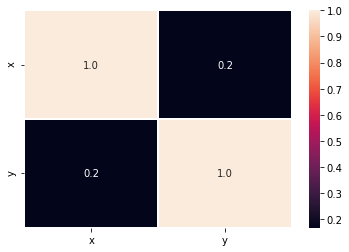

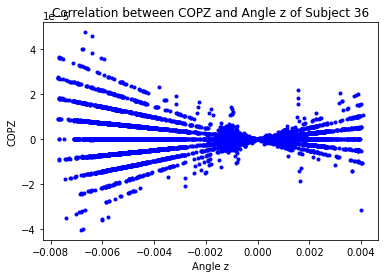

[[ 1.         -0.04901019]
 [-0.04901019  1.        ]]


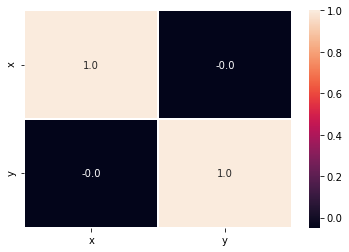

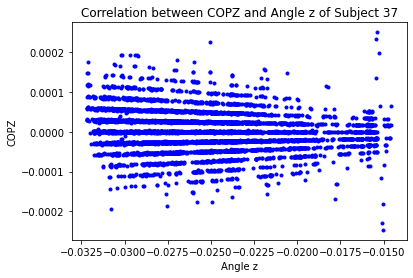

[[ 1.         -0.16876533]
 [-0.16876533  1.        ]]


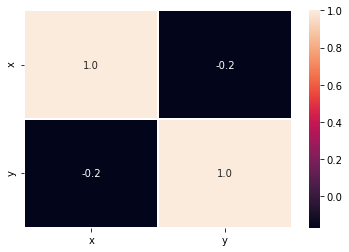

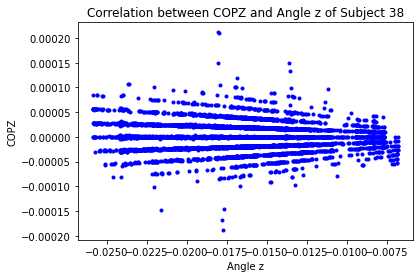

[[ 1.        -0.1125248]
 [-0.1125248  1.       ]]


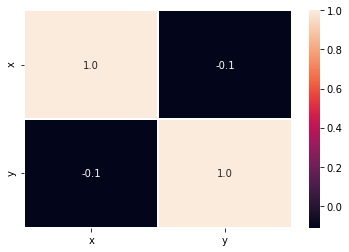

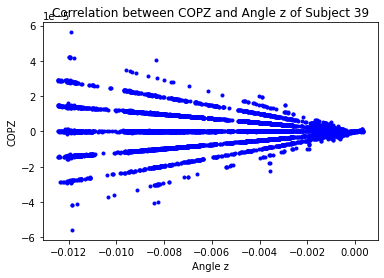

[[ 1.         -0.01624738]
 [-0.01624738  1.        ]]


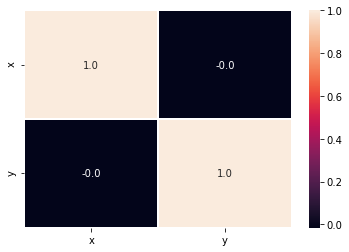

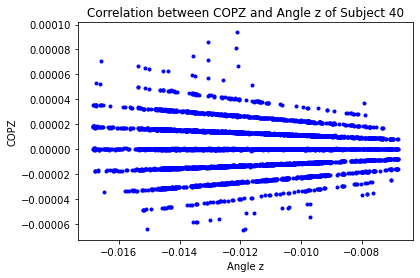

[[ 1.         -0.06845148]
 [-0.06845148  1.        ]]


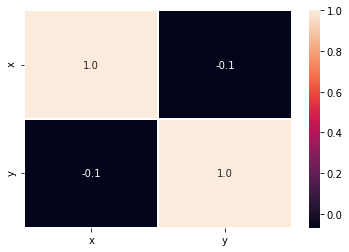

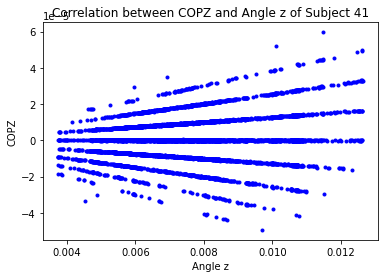

[[1.         0.17065841]
 [0.17065841 1.        ]]


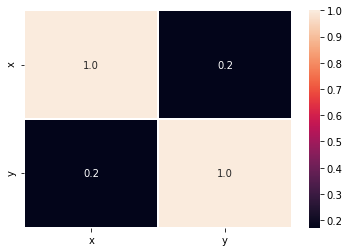

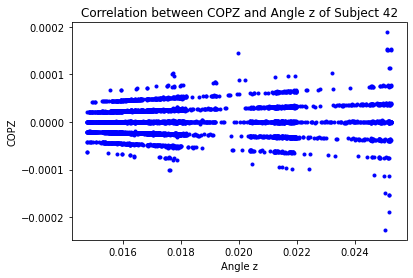

[[1.         0.04994623]
 [0.04994623 1.        ]]


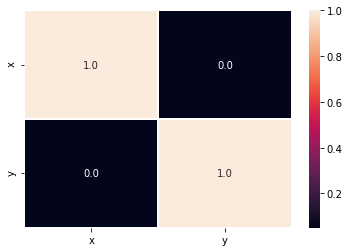

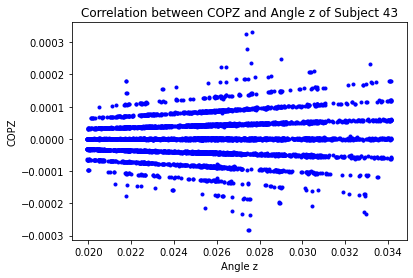

[[1.         0.09778195]
 [0.09778195 1.        ]]


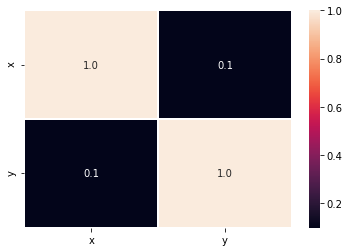

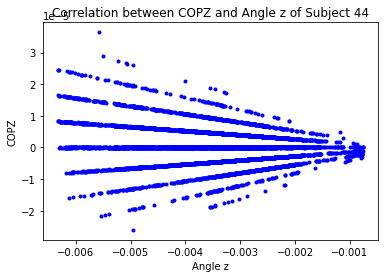

[[ 1.         -0.22033455]
 [-0.22033455  1.        ]]


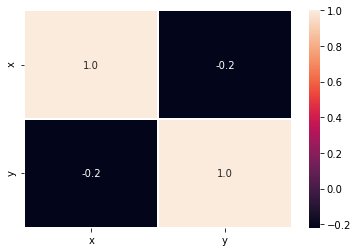

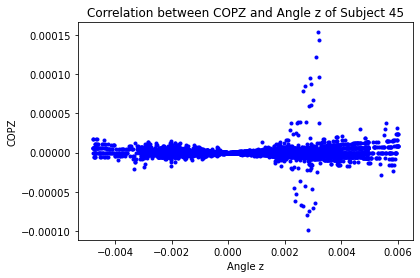

[[1.         0.02480303]
 [0.02480303 1.        ]]


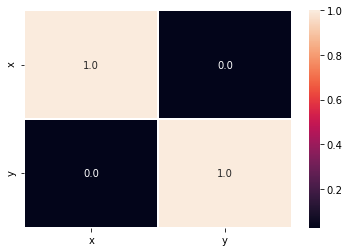

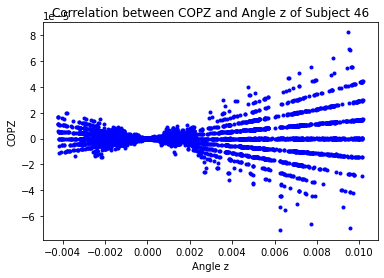

[[1.         0.09148871]
 [0.09148871 1.        ]]


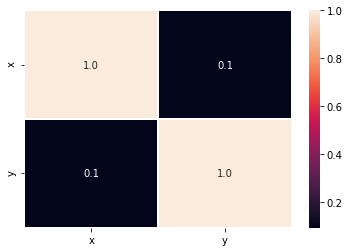

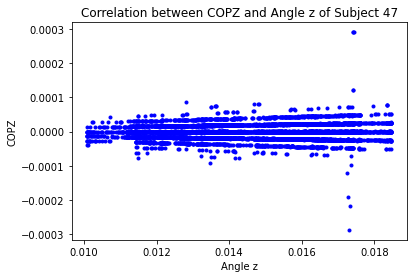

[[1.         0.06547364]
 [0.06547364 1.        ]]


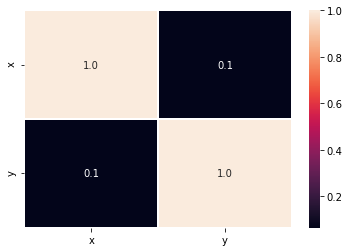

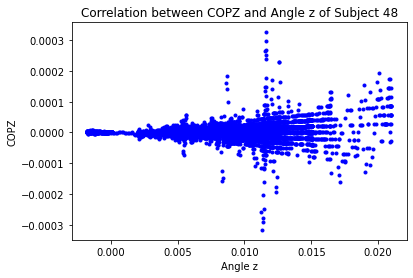

[[1.         0.11003892]
 [0.11003892 1.        ]]


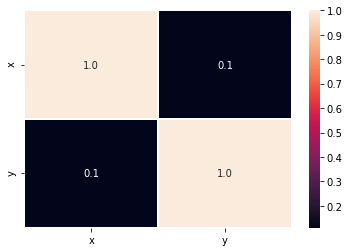

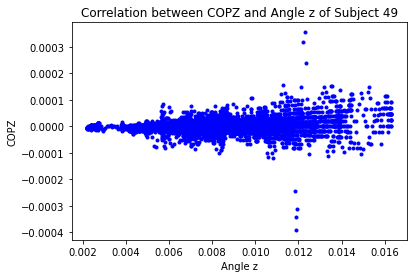

[[1.         0.20266237]
 [0.20266237 1.        ]]


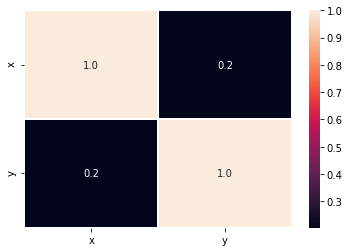

In [17]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangz,
         'y': COPZmatrix
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle z")
    plt.ylabel("COPZ")
    plt.title("Correlation between COPZ and Angle z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangz,COPZmatrix)
    print(r)
    plt.figure()
    data={'x':matrizangz,
          'y': COPZmatrix
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

# Error in function of angles

We are going to correlate the error found with angle x and z. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches -1, indicating a negative correlation betweem them, for the errorz and anglez. With angle x it's possible to conclude that they dont correlate. 

## Correlation between errorz and angle x 

74.3


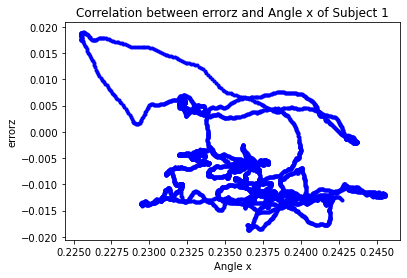

[[ 1.         -0.36276163]
 [-0.36276163  1.        ]]


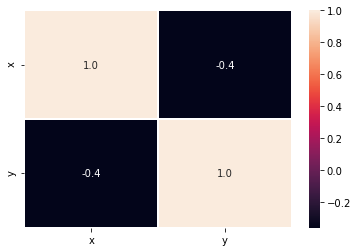

74.3


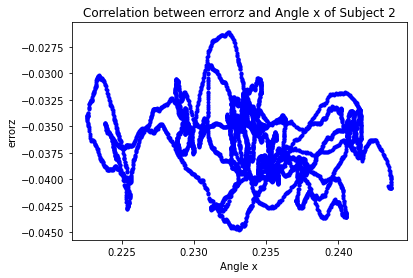

[[ 1.         -0.16986495]
 [-0.16986495  1.        ]]


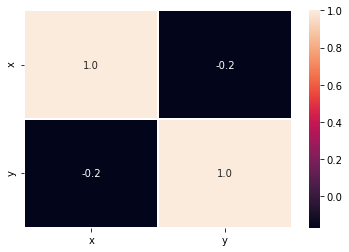

74.3


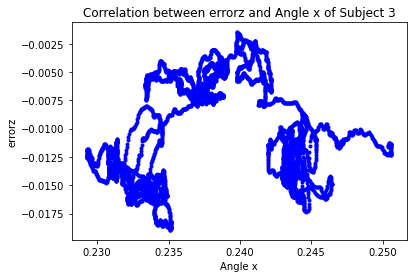

[[1.         0.10928371]
 [0.10928371 1.        ]]


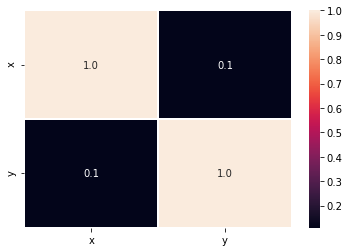

74.3


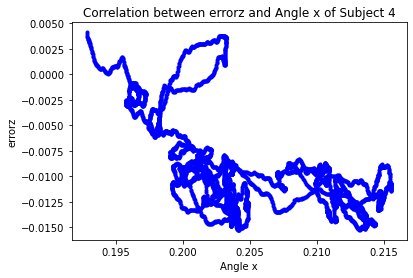

[[ 1.         -0.60624374]
 [-0.60624374  1.        ]]


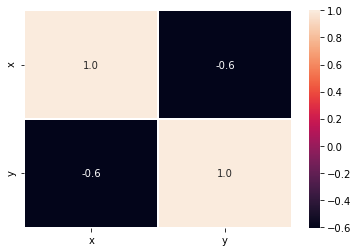

74.3


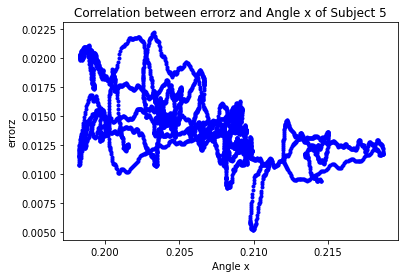

[[ 1.         -0.55847246]
 [-0.55847246  1.        ]]


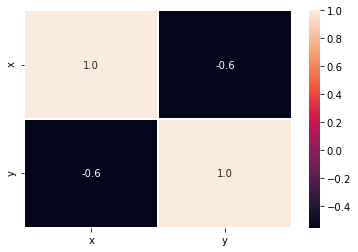

74.3


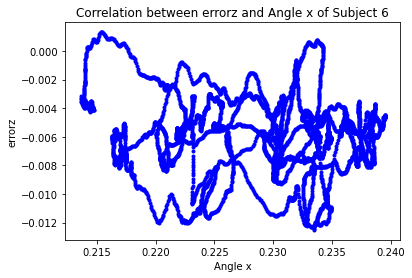

[[ 1.         -0.08493768]
 [-0.08493768  1.        ]]


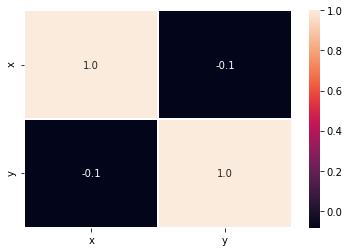

74.3


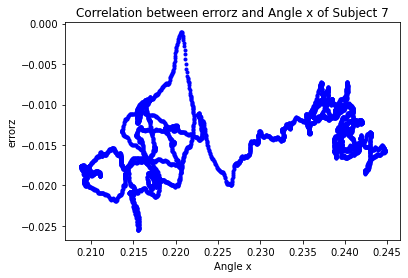

[[1.         0.46387097]
 [0.46387097 1.        ]]


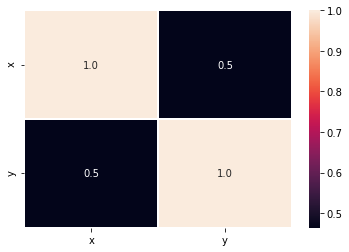

74.3


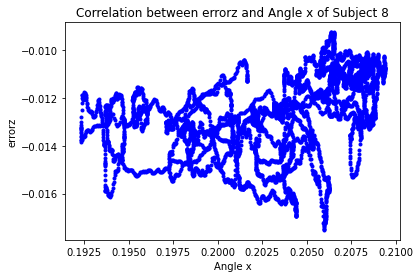

[[1.         0.40392159]
 [0.40392159 1.        ]]


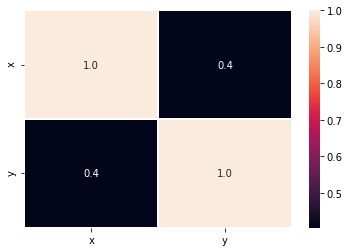

74.3


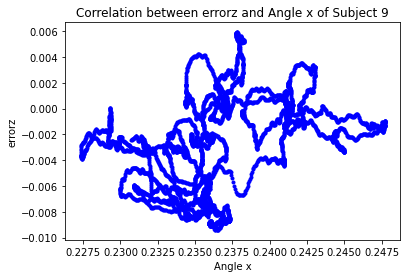

[[1.         0.35623665]
 [0.35623665 1.        ]]


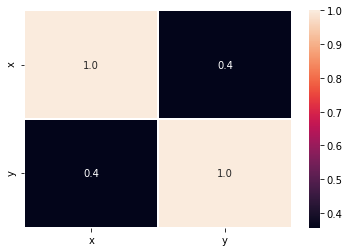

74.3


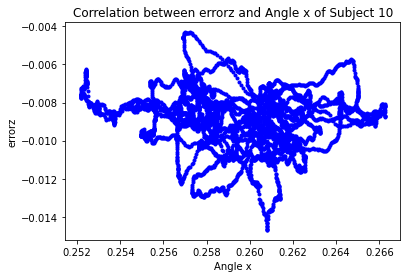

[[ 1.         -0.12909365]
 [-0.12909365  1.        ]]


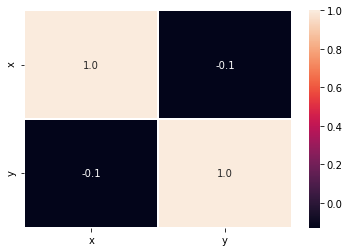

74.3


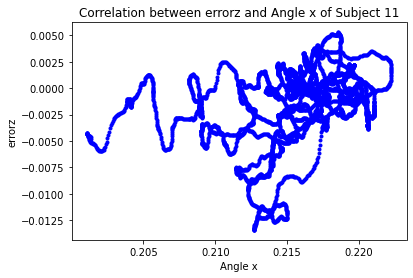

[[1.         0.31296784]
 [0.31296784 1.        ]]


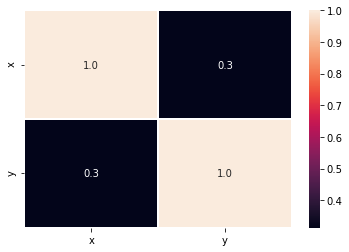

126.3


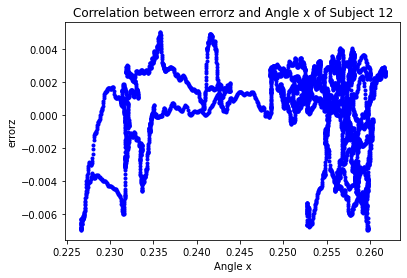

[[1.         0.01179655]
 [0.01179655 1.        ]]


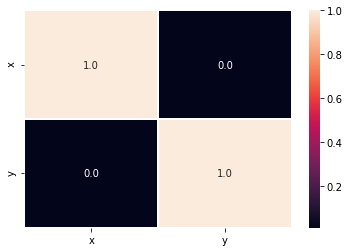

126.3


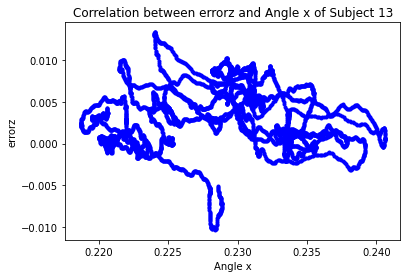

[[ 1.         -0.00137529]
 [-0.00137529  1.        ]]


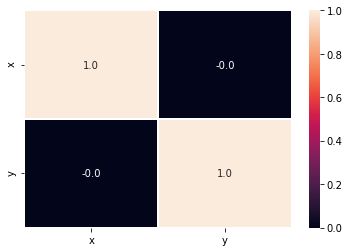

126.3


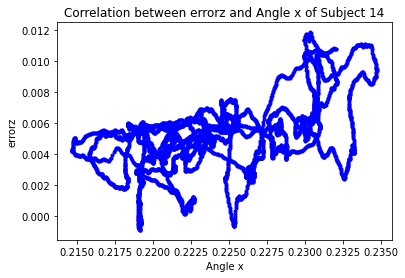

[[1.         0.52739279]
 [0.52739279 1.        ]]


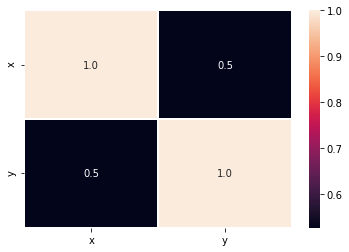

126.3


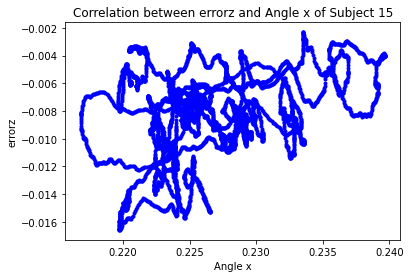

[[1.         0.37615551]
 [0.37615551 1.        ]]


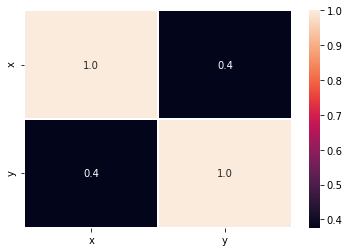

126.3


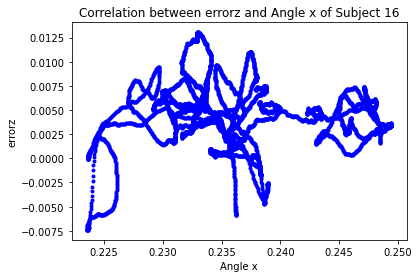

[[ 1.00000000e+00 -4.13937555e-04]
 [-4.13937555e-04  1.00000000e+00]]


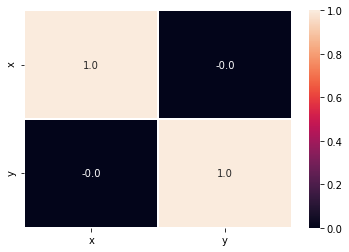

126.3


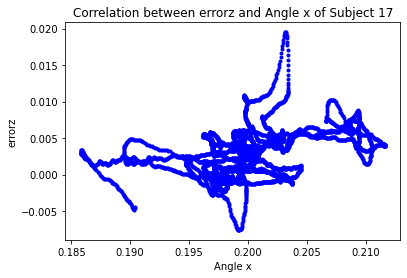

[[1.         0.39400908]
 [0.39400908 1.        ]]


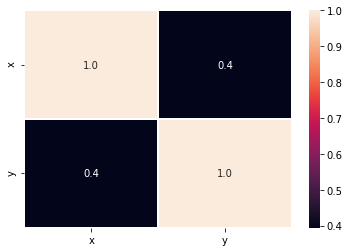

126.3


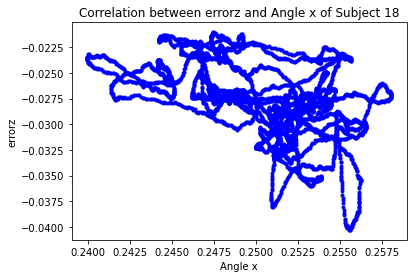

[[ 1.         -0.49836753]
 [-0.49836753  1.        ]]


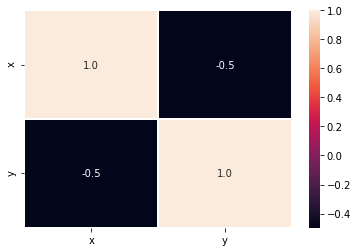

126.3


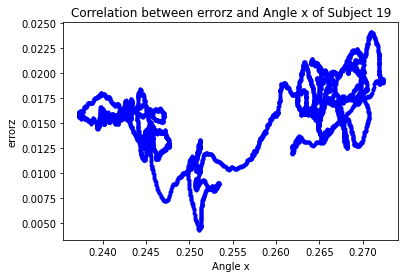

[[1.         0.46862777]
 [0.46862777 1.        ]]


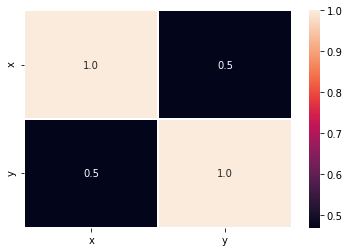

126.3


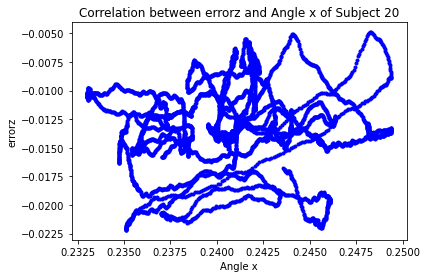

[[1.         0.06684394]
 [0.06684394 1.        ]]


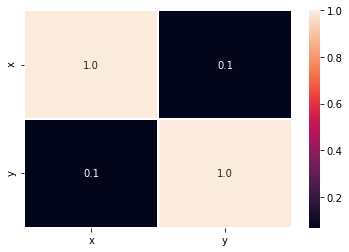

126.3


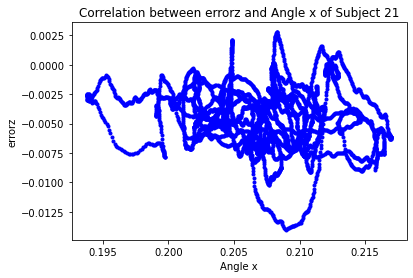

[[ 1.         -0.13839713]
 [-0.13839713  1.        ]]


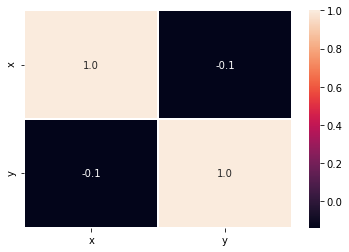

126.3


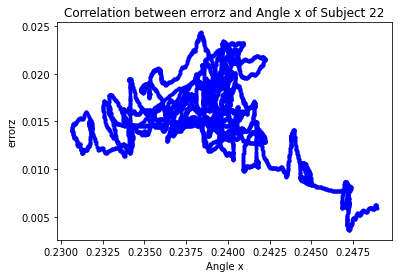

[[ 1.         -0.33471362]
 [-0.33471362  1.        ]]


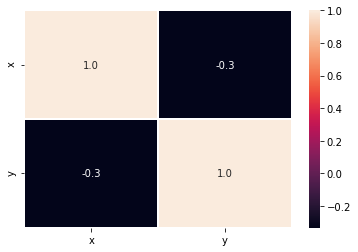

126.3


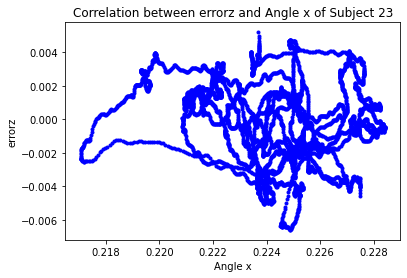

[[ 1.         -0.17755771]
 [-0.17755771  1.        ]]


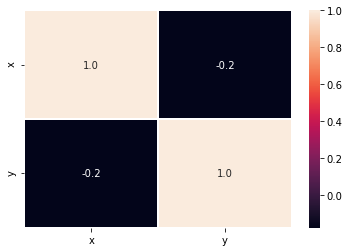

52.9


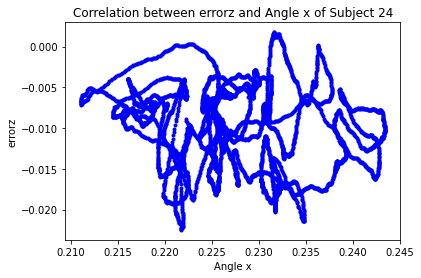

[[ 1.         -0.13585819]
 [-0.13585819  1.        ]]


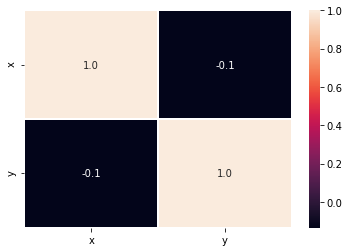

52.9


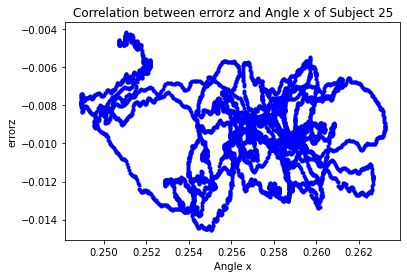

[[ 1.         -0.19073732]
 [-0.19073732  1.        ]]


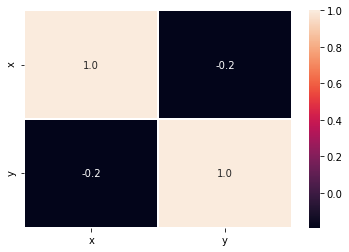

52.9


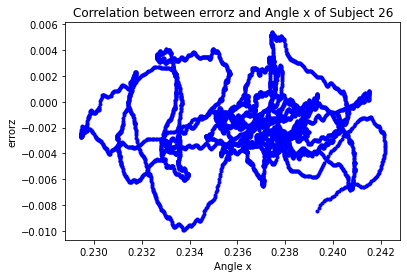

[[ 1.         -0.00423692]
 [-0.00423692  1.        ]]


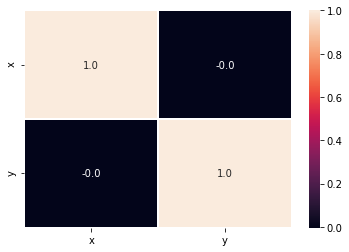

52.9


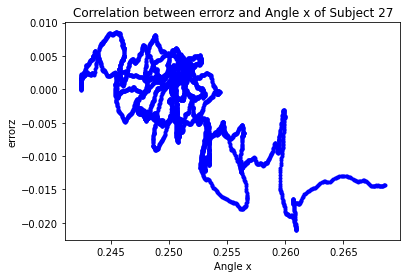

[[ 1.         -0.65902066]
 [-0.65902066  1.        ]]


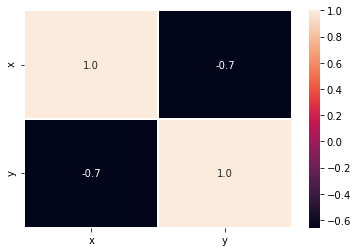

52.9


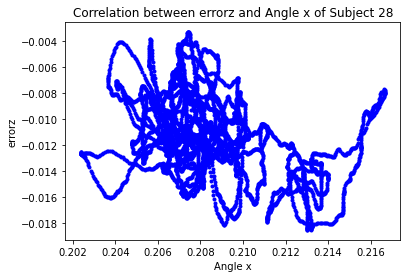

[[ 1.         -0.38349909]
 [-0.38349909  1.        ]]


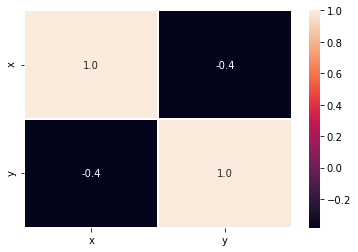

52.9


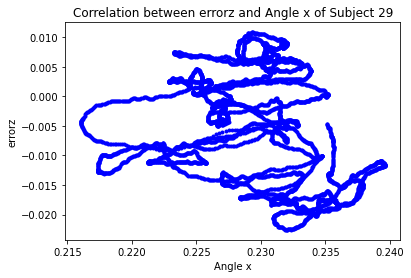

[[ 1.         -0.21136882]
 [-0.21136882  1.        ]]


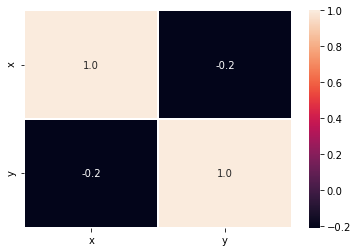

52.9


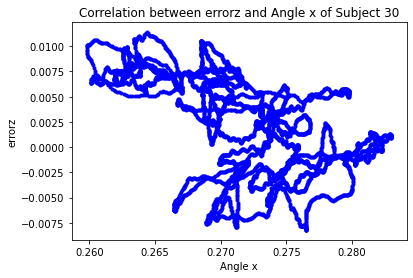

[[ 1.         -0.56125816]
 [-0.56125816  1.        ]]


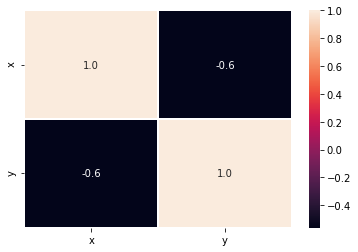

52.9


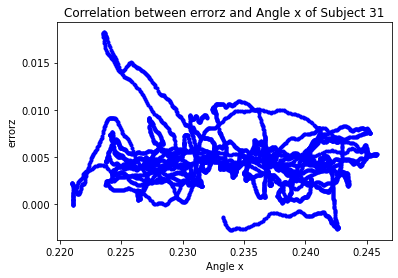

[[ 1.         -0.14356848]
 [-0.14356848  1.        ]]


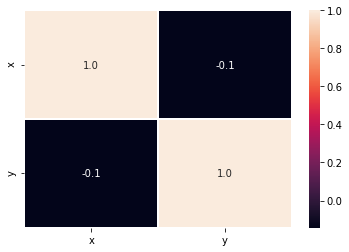

52.9


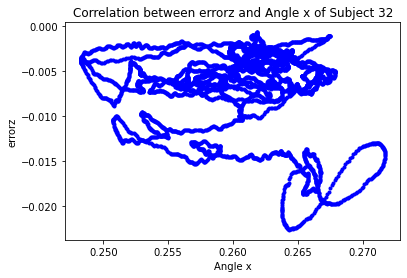

[[ 1.         -0.13754428]
 [-0.13754428  1.        ]]


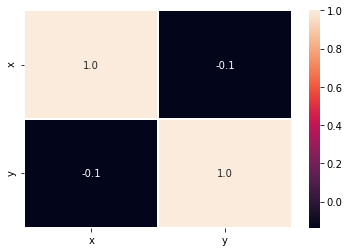

52.9


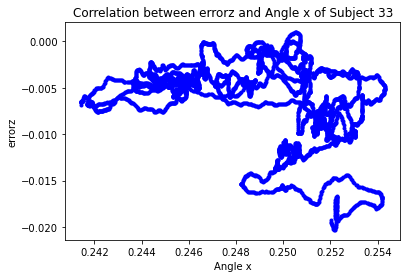

[[ 1.         -0.36895447]
 [-0.36895447  1.        ]]


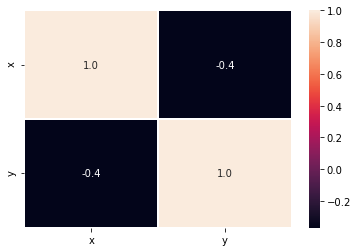

52.9


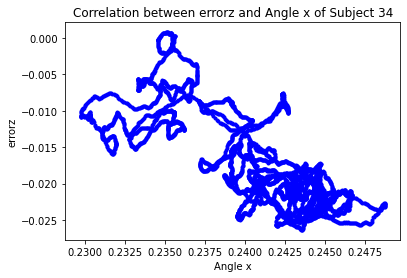

[[ 1.         -0.75414933]
 [-0.75414933  1.        ]]


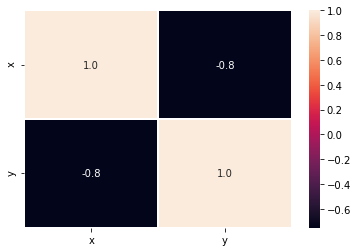

52.9


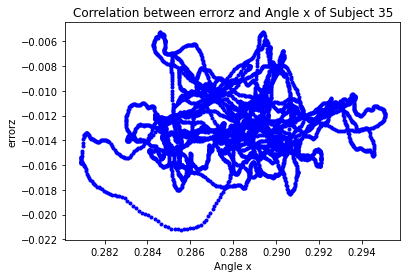

[[1.         0.07293696]
 [0.07293696 1.        ]]


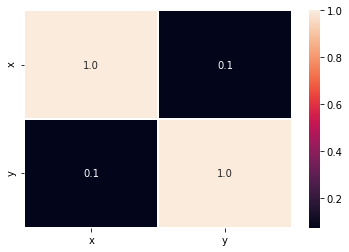

75.85


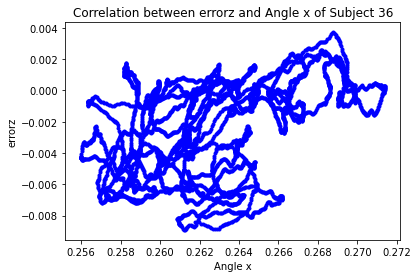

[[1.        0.4410984]
 [0.4410984 1.       ]]


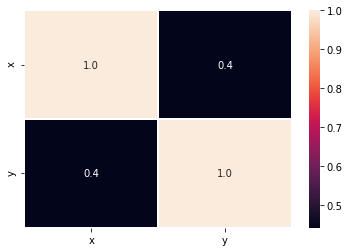

75.85


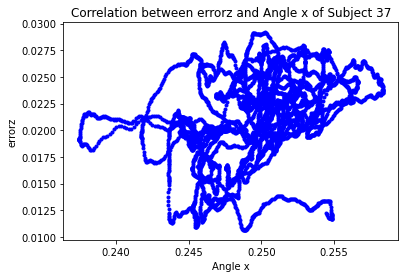

[[1.         0.36908492]
 [0.36908492 1.        ]]


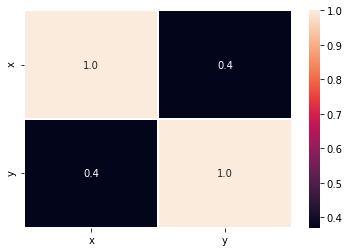

75.85


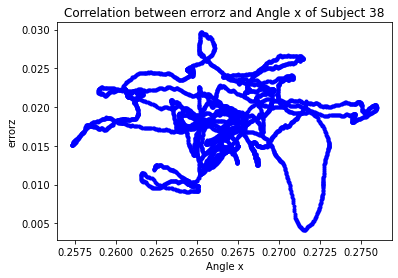

[[1.         0.04881217]
 [0.04881217 1.        ]]


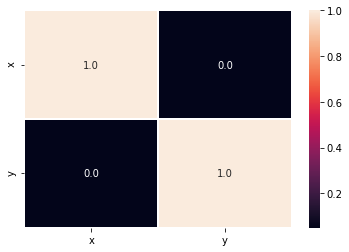

75.85


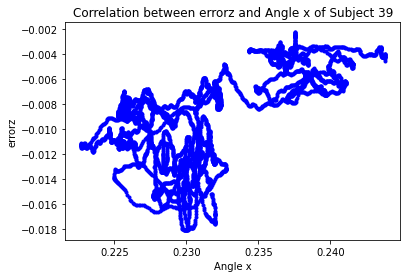

[[1.         0.60530784]
 [0.60530784 1.        ]]


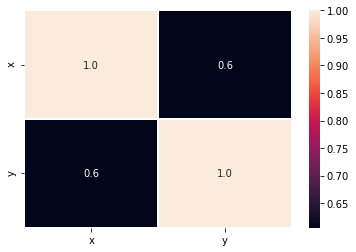

75.85


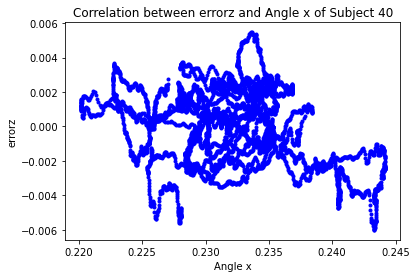

[[ 1.         -0.33175576]
 [-0.33175576  1.        ]]


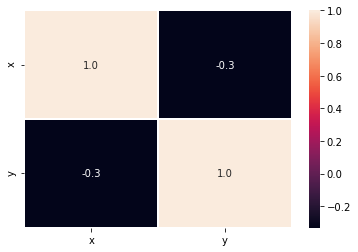

75.85


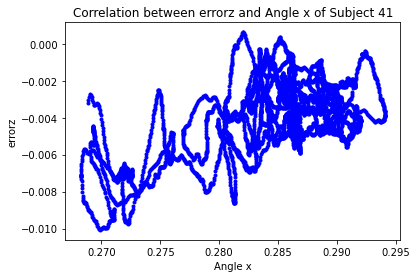

[[1.         0.59961327]
 [0.59961327 1.        ]]


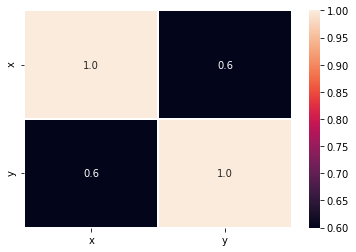

75.85


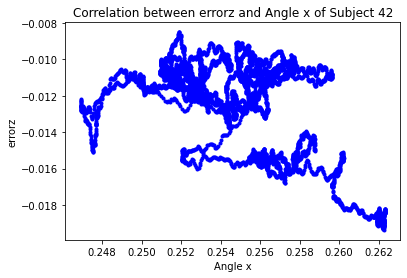

[[ 1.         -0.53697811]
 [-0.53697811  1.        ]]


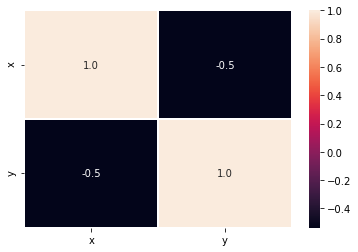

75.85


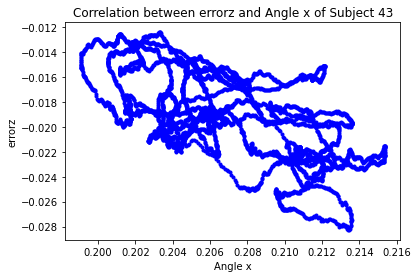

[[ 1.         -0.60511917]
 [-0.60511917  1.        ]]


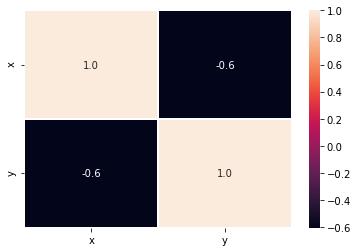

75.85


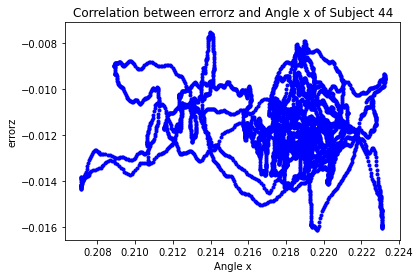

[[ 1.         -0.14651827]
 [-0.14651827  1.        ]]


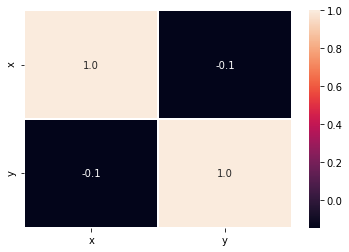

75.85


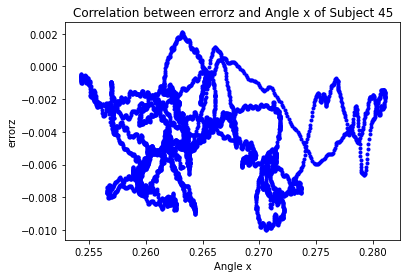

[[ 1.         -0.06604538]
 [-0.06604538  1.        ]]


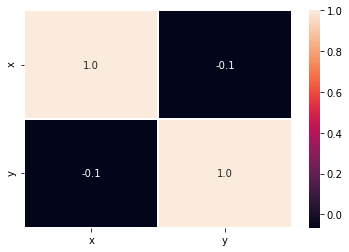

75.85


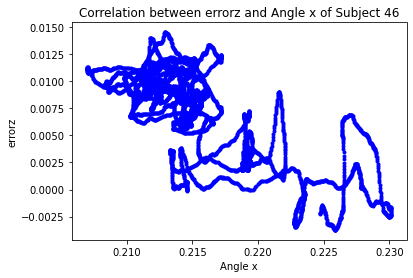

[[ 1.         -0.73256206]
 [-0.73256206  1.        ]]


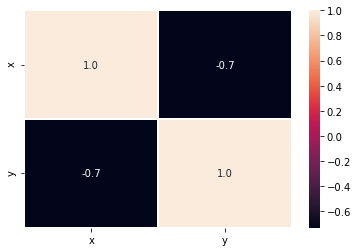

75.85


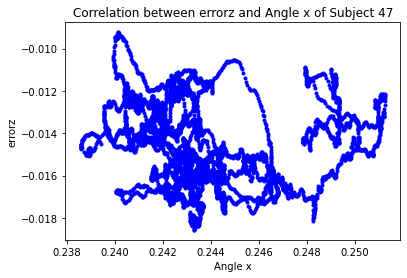

[[ 1.         -0.10957663]
 [-0.10957663  1.        ]]


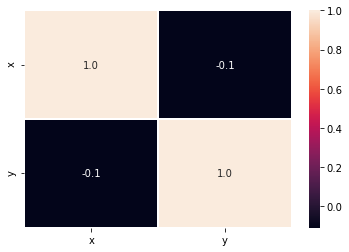

61.05


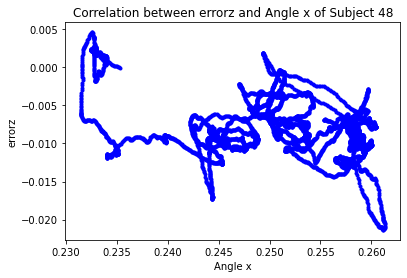

[[ 1.         -0.35138793]
 [-0.35138793  1.        ]]


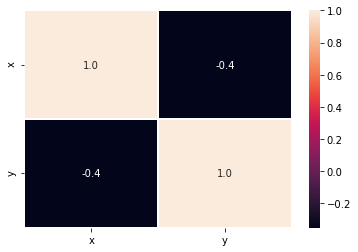

61.05


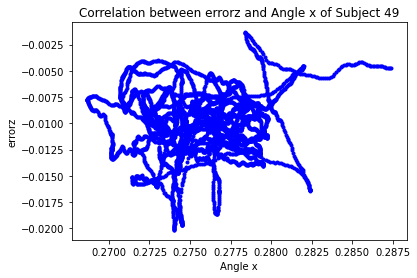

[[1.         0.09829181]
 [0.09829181 1.        ]]


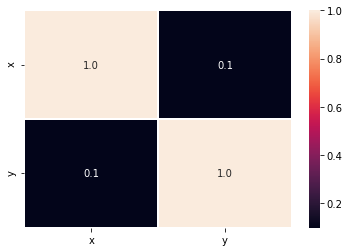

In [9]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangx,
         'y': errorz
          
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle x")
    plt.ylabel("errorz")
    plt.title("Correlation between errorz and Angle x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangx,errorz)
    print(r)
    plt.figure()
    data={'x':matrizangx,
          'y':errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between arrorz and anglez

74.3


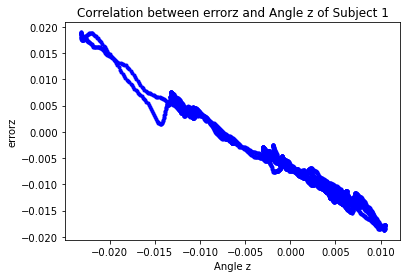

[[ 1.         -0.36276163]
 [-0.36276163  1.        ]]


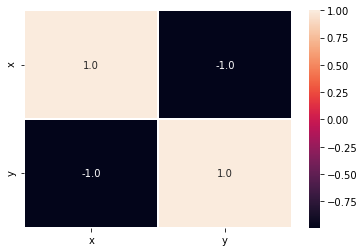

74.3


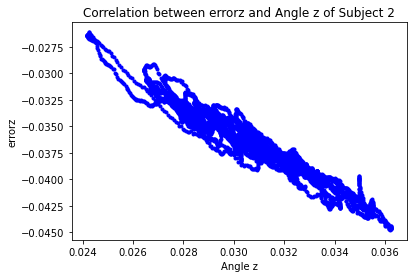

[[ 1.         -0.16986495]
 [-0.16986495  1.        ]]


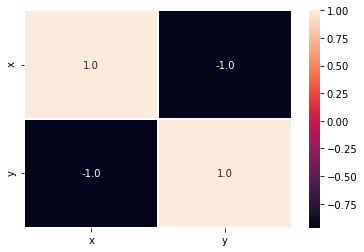

74.3


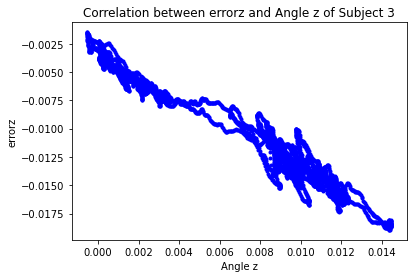

[[1.         0.10928371]
 [0.10928371 1.        ]]


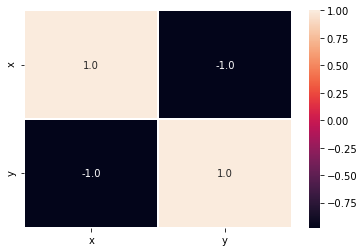

74.3


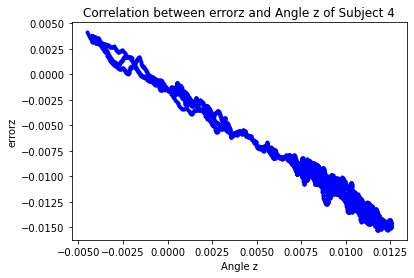

[[ 1.         -0.60624374]
 [-0.60624374  1.        ]]


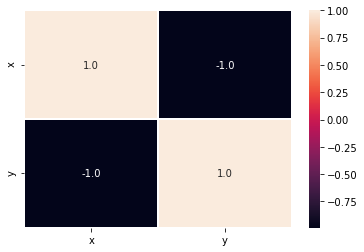

74.3


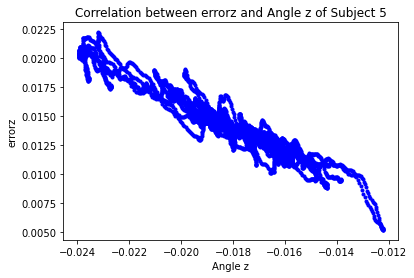

[[ 1.         -0.55847246]
 [-0.55847246  1.        ]]


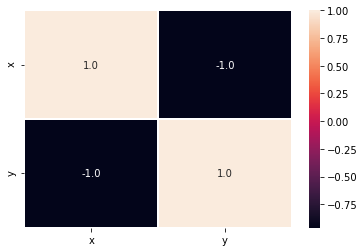

74.3


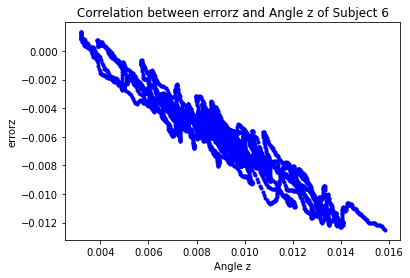

[[ 1.         -0.08493768]
 [-0.08493768  1.        ]]


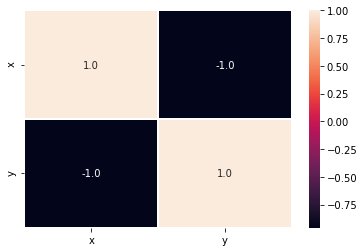

74.3


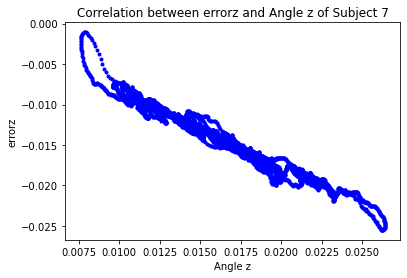

[[1.         0.46387097]
 [0.46387097 1.        ]]


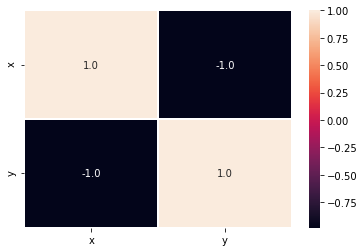

74.3


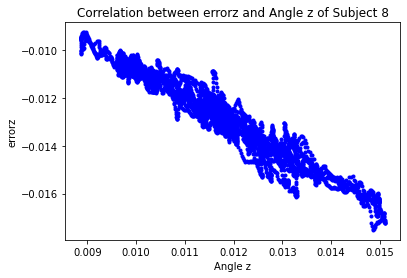

[[1.         0.40392159]
 [0.40392159 1.        ]]


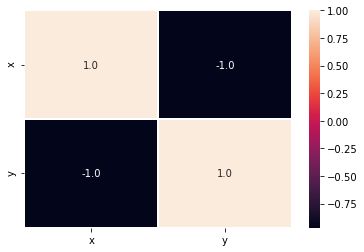

74.3


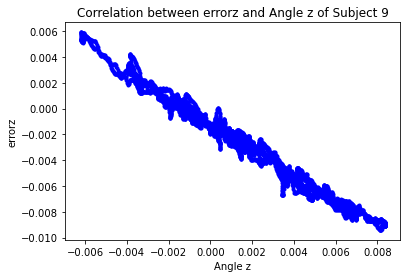

[[1.         0.35623665]
 [0.35623665 1.        ]]


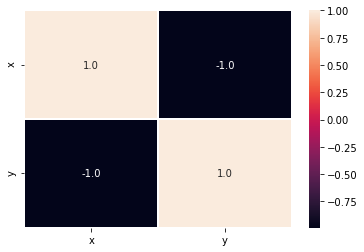

74.3


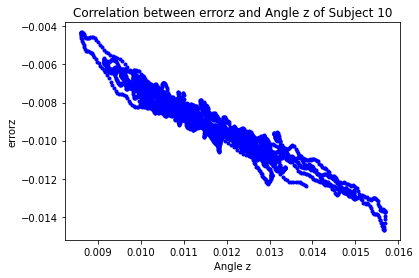

[[ 1.         -0.12909365]
 [-0.12909365  1.        ]]


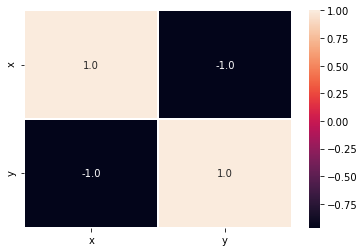

74.3


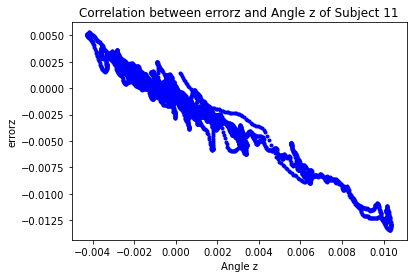

[[1.         0.31296784]
 [0.31296784 1.        ]]


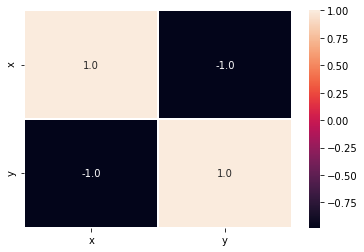

126.3


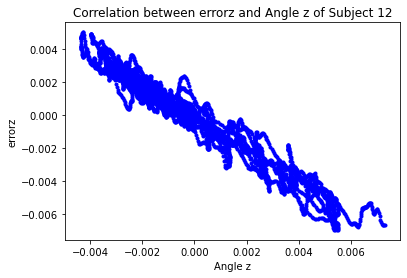

[[1.         0.01179655]
 [0.01179655 1.        ]]


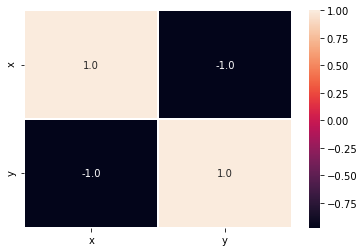

126.3


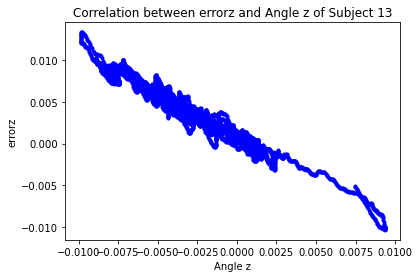

[[ 1.         -0.00137529]
 [-0.00137529  1.        ]]


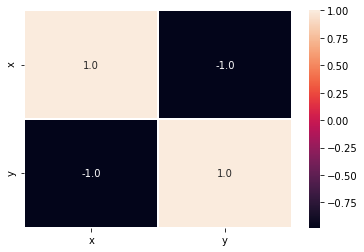

126.3


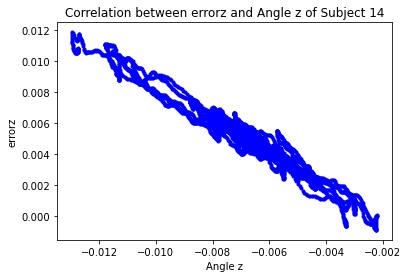

[[1.         0.52739279]
 [0.52739279 1.        ]]


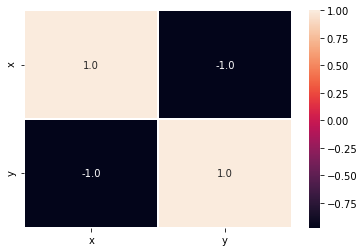

126.3


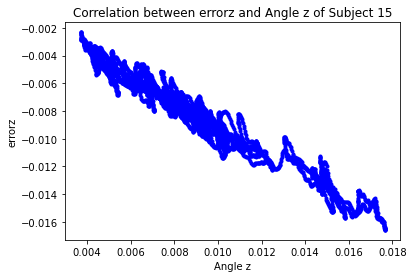

[[1.         0.37615551]
 [0.37615551 1.        ]]


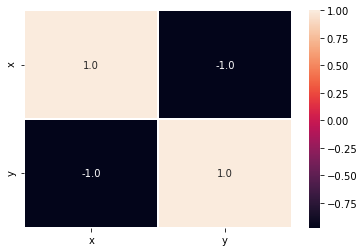

126.3


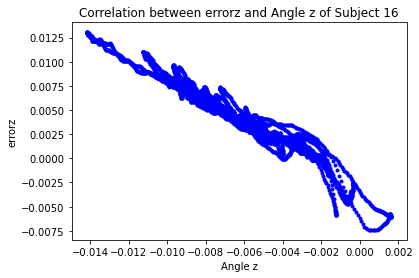

[[ 1.00000000e+00 -4.13937555e-04]
 [-4.13937555e-04  1.00000000e+00]]


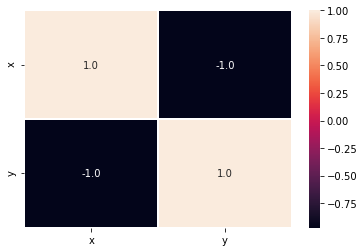

126.3


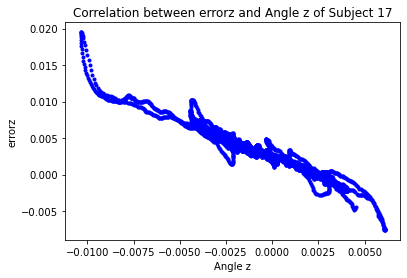

[[1.         0.39400908]
 [0.39400908 1.        ]]


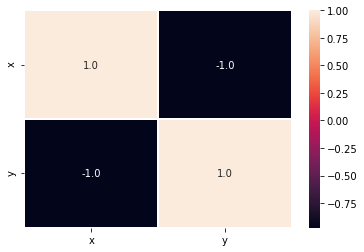

126.3


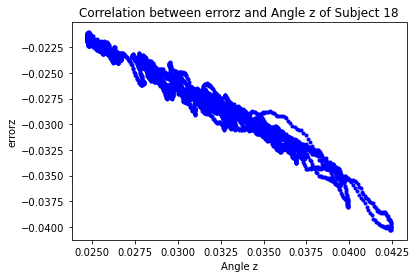

[[ 1.         -0.49836753]
 [-0.49836753  1.        ]]


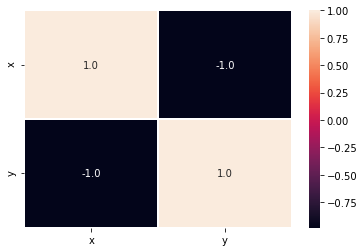

126.3


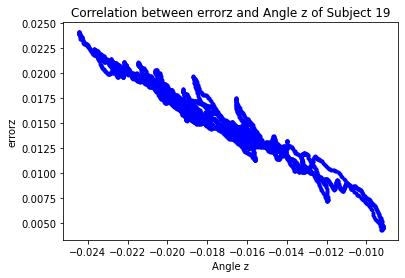

[[1.         0.46862777]
 [0.46862777 1.        ]]


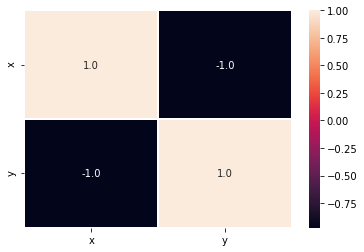

126.3


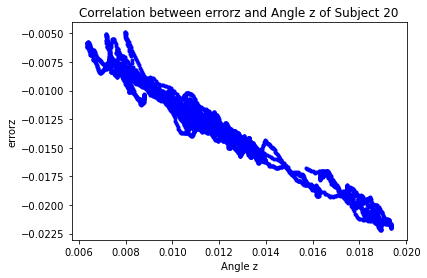

[[1.         0.06684394]
 [0.06684394 1.        ]]


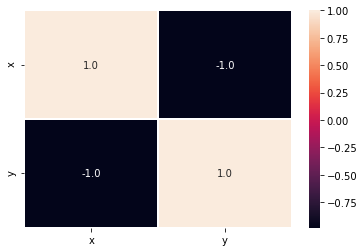

126.3


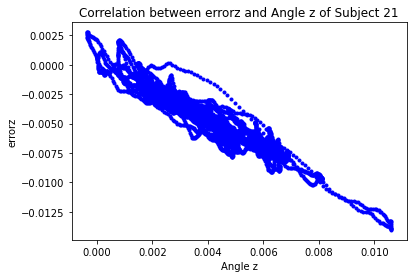

[[ 1.         -0.13839713]
 [-0.13839713  1.        ]]


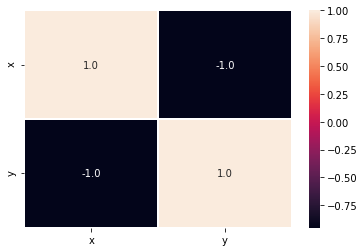

126.3


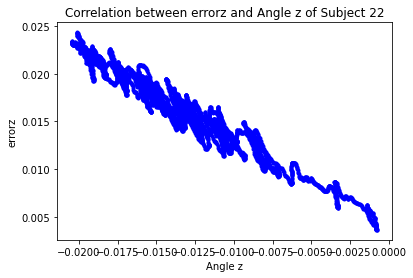

[[ 1.         -0.33471362]
 [-0.33471362  1.        ]]


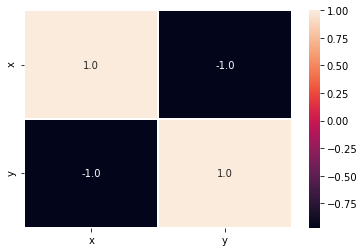

126.3


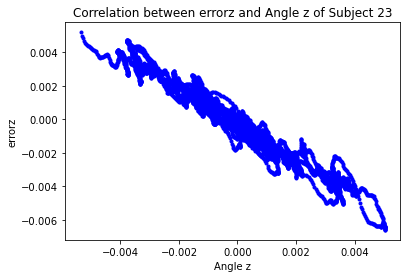

[[ 1.         -0.17755771]
 [-0.17755771  1.        ]]


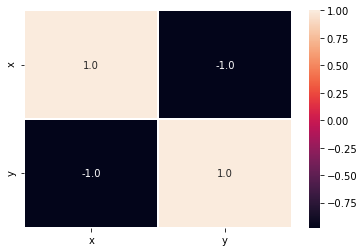

52.9


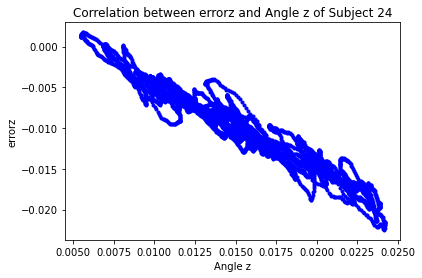

[[ 1.         -0.13585819]
 [-0.13585819  1.        ]]


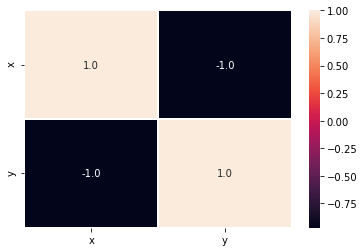

52.9


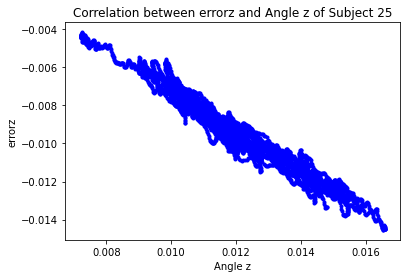

[[ 1.         -0.19073732]
 [-0.19073732  1.        ]]


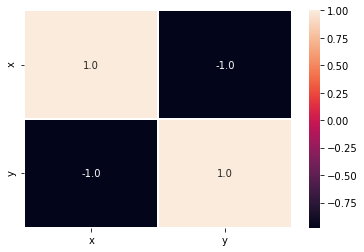

52.9


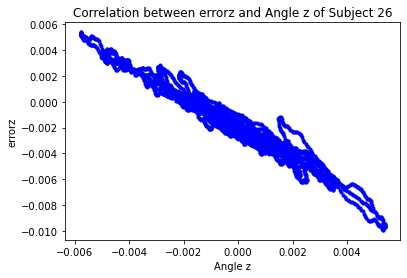

[[ 1.         -0.00423692]
 [-0.00423692  1.        ]]


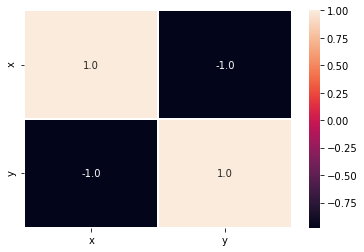

52.9


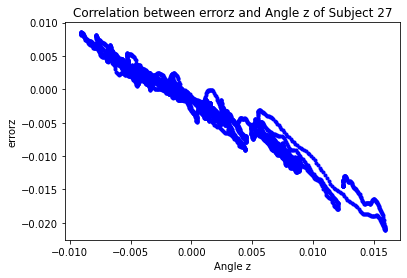

[[ 1.         -0.65902066]
 [-0.65902066  1.        ]]


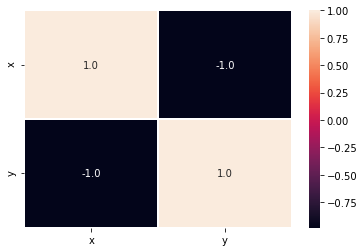

52.9


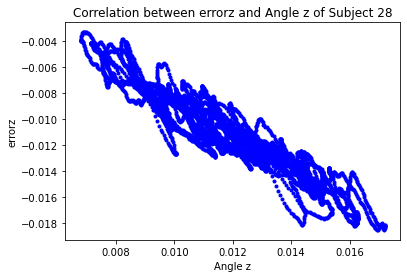

[[ 1.         -0.38349909]
 [-0.38349909  1.        ]]


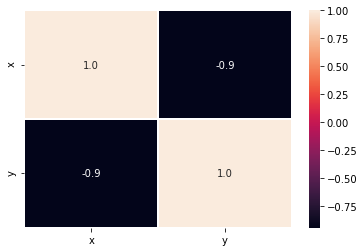

52.9


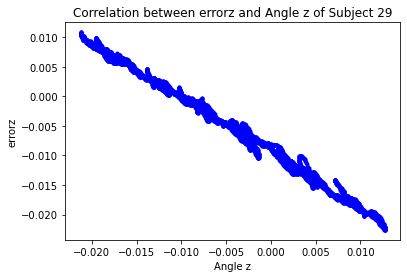

[[ 1.         -0.21136882]
 [-0.21136882  1.        ]]


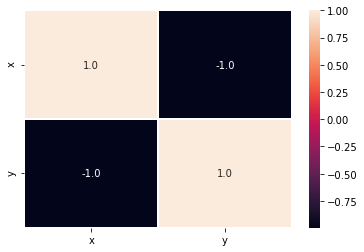

52.9


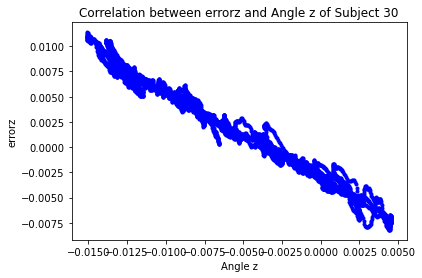

[[ 1.         -0.56125816]
 [-0.56125816  1.        ]]


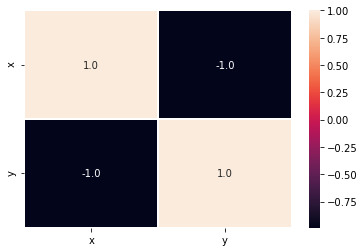

52.9


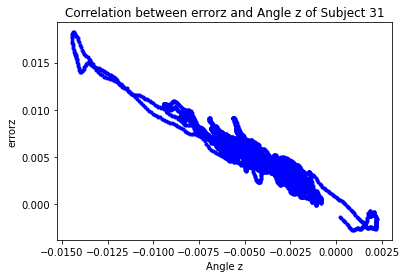

[[ 1.         -0.14356848]
 [-0.14356848  1.        ]]


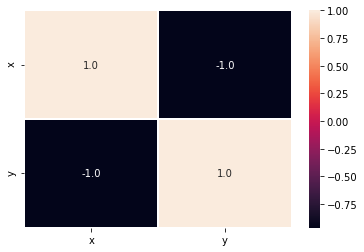

52.9


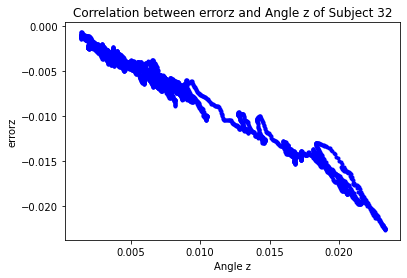

[[ 1.         -0.13754428]
 [-0.13754428  1.        ]]


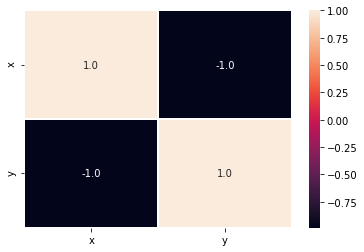

52.9


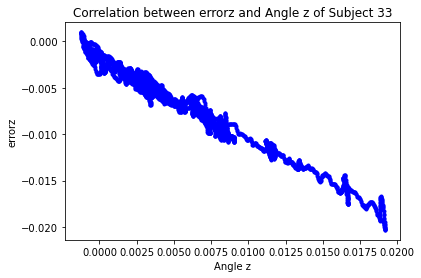

[[ 1.         -0.36895447]
 [-0.36895447  1.        ]]


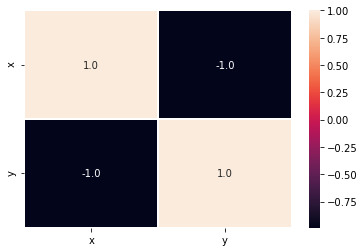

52.9


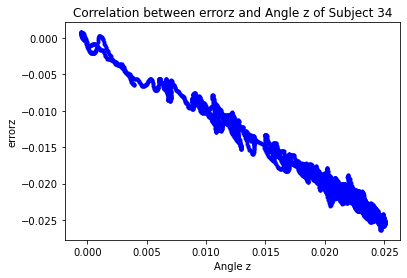

[[ 1.         -0.75414933]
 [-0.75414933  1.        ]]


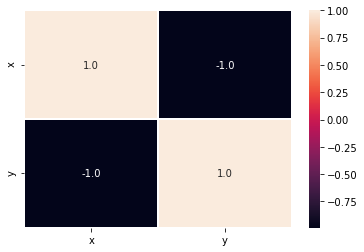

52.9


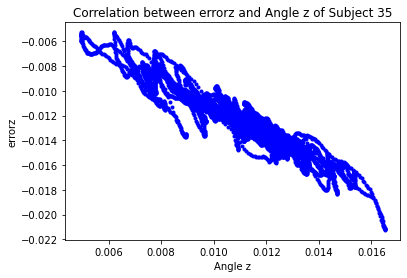

[[1.         0.07293696]
 [0.07293696 1.        ]]


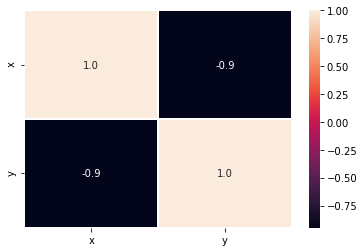

75.85


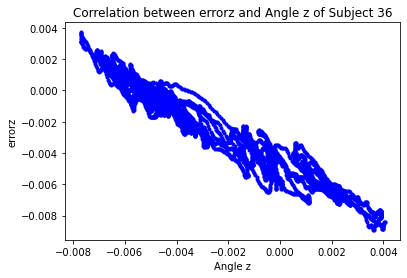

[[1.        0.4410984]
 [0.4410984 1.       ]]


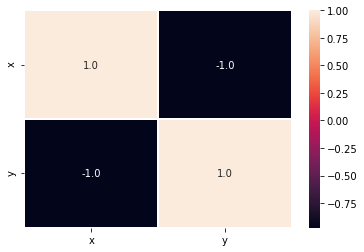

75.85


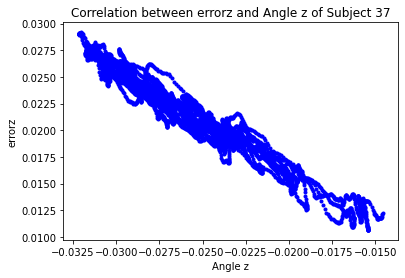

[[1.         0.36908492]
 [0.36908492 1.        ]]


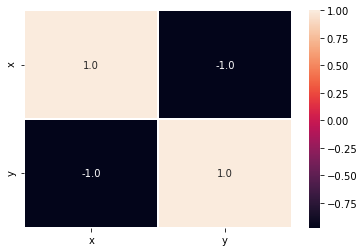

75.85


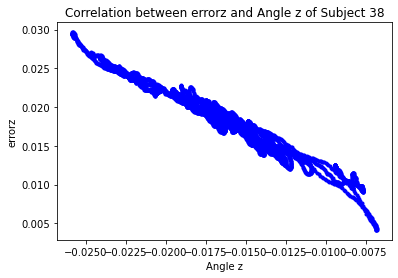

[[1.         0.04881217]
 [0.04881217 1.        ]]


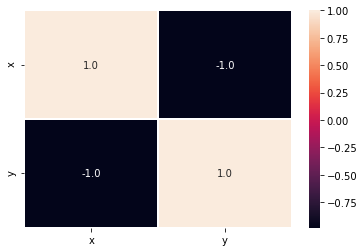

75.85


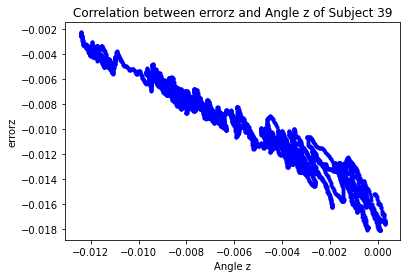

[[1.         0.60530784]
 [0.60530784 1.        ]]


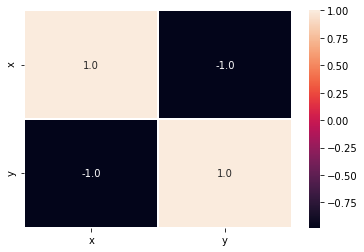

75.85


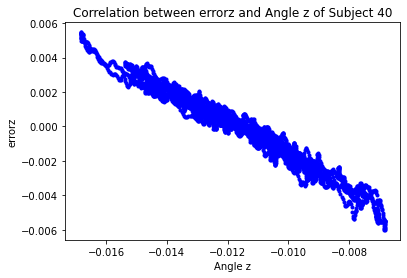

[[ 1.         -0.33175576]
 [-0.33175576  1.        ]]


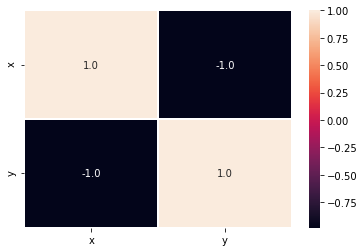

75.85


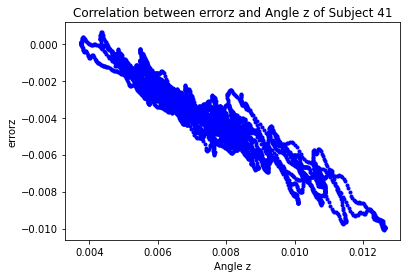

[[1.         0.59961327]
 [0.59961327 1.        ]]


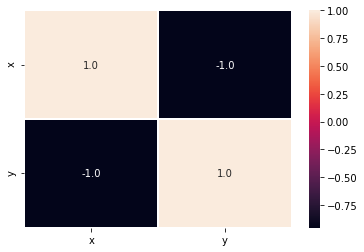

75.85


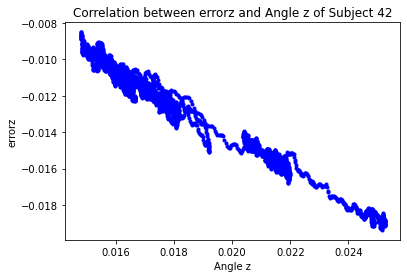

[[ 1.         -0.53697811]
 [-0.53697811  1.        ]]


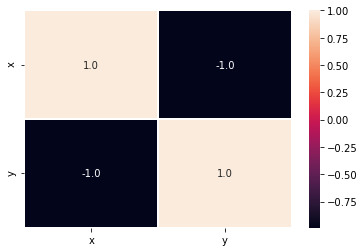

75.85


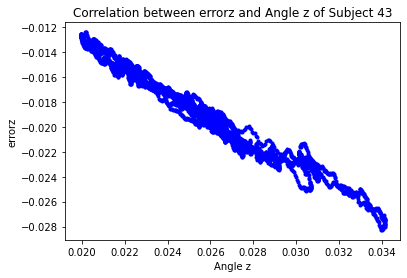

[[ 1.         -0.60511917]
 [-0.60511917  1.        ]]


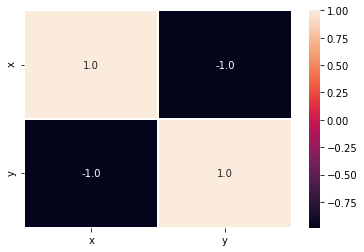

75.85


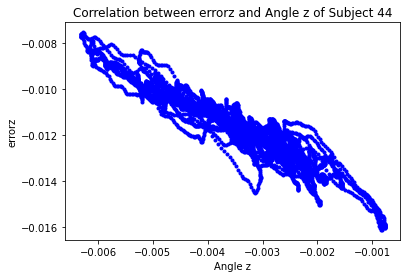

[[ 1.         -0.14651827]
 [-0.14651827  1.        ]]


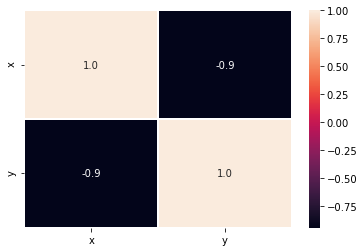

75.85


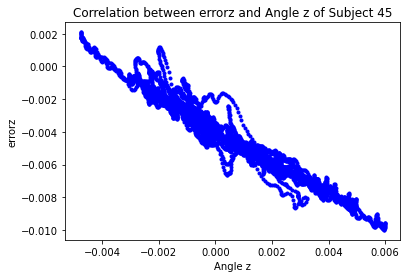

[[ 1.         -0.06604538]
 [-0.06604538  1.        ]]


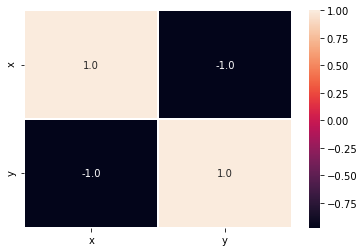

75.85


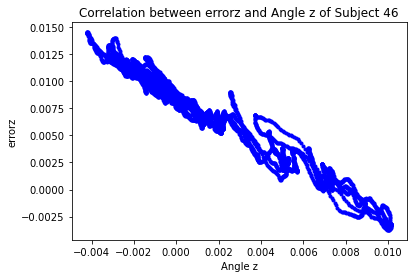

[[ 1.         -0.73256206]
 [-0.73256206  1.        ]]


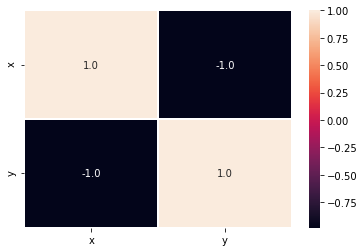

75.85


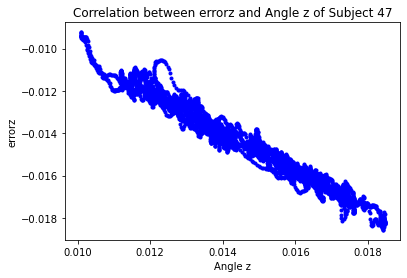

[[ 1.         -0.10957663]
 [-0.10957663  1.        ]]


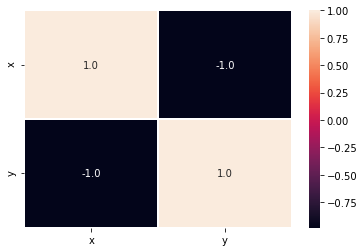

61.05


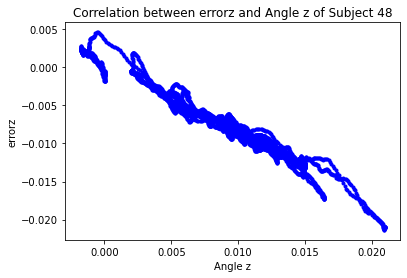

[[ 1.         -0.35138793]
 [-0.35138793  1.        ]]


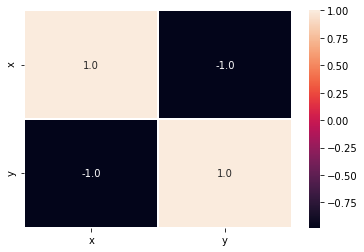

61.05


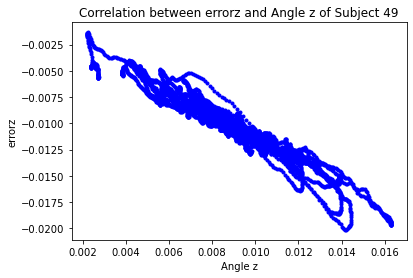

[[1.         0.09829181]
 [0.09829181 1.        ]]


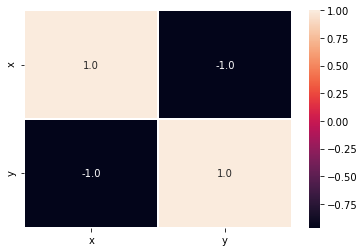

In [10]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangz,
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle z")
    plt.ylabel("errorz")
    plt.title("Correlation between errorz and Angle z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangx,errorz)
    print(r)
    plt.figure()
    data={'x':matrizangz,
          'y':errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

# Error in function of trigonometry

We are going to correlate the error found with the trigonometry angle x and z. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches -1, inidicating a negative correlation betweem them, for the errorz and trigonometry of the anglez. With angle x it's possible to conclude that they dont correlate. 

## Error z and senx, cosx and tanx

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


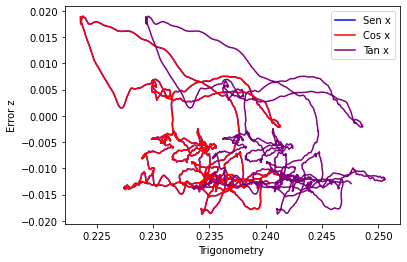

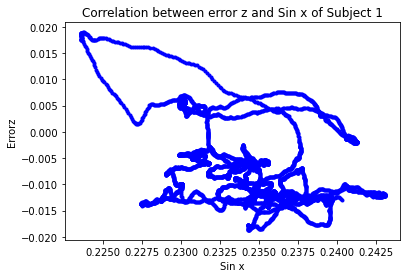

[[ 1.         -0.36293829]
 [-0.36293829  1.        ]]


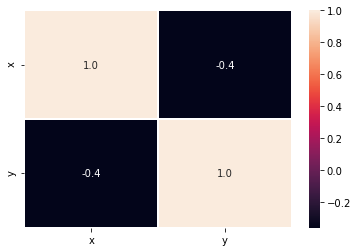

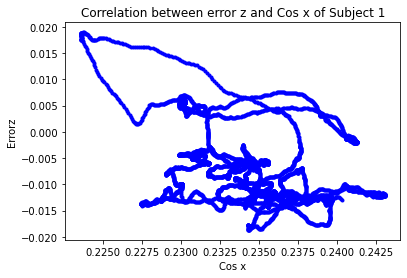

[[ 1.         -0.36293829]
 [-0.36293829  1.        ]]


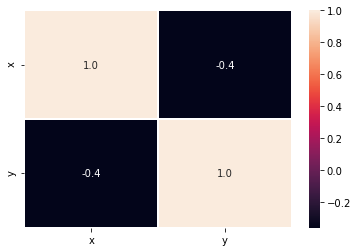

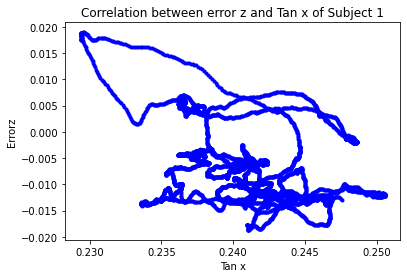

[[ 1.         -0.36240814]
 [-0.36240814  1.        ]]


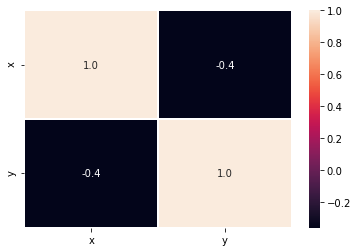

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


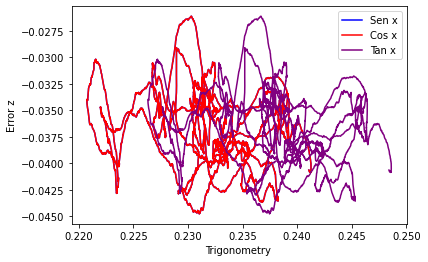

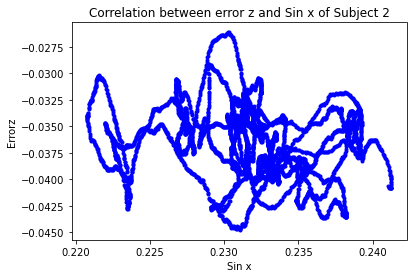

[[ 1.         -0.16984791]
 [-0.16984791  1.        ]]


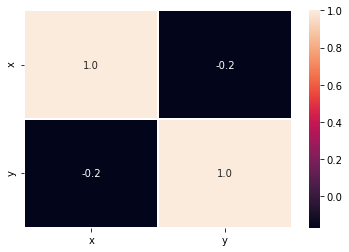

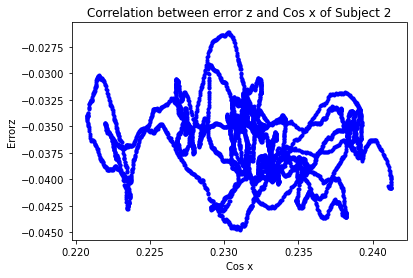

[[ 1.         -0.16984791]
 [-0.16984791  1.        ]]


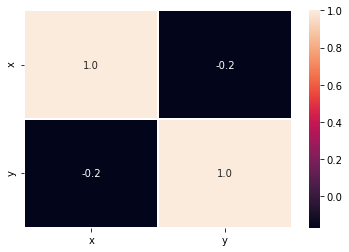

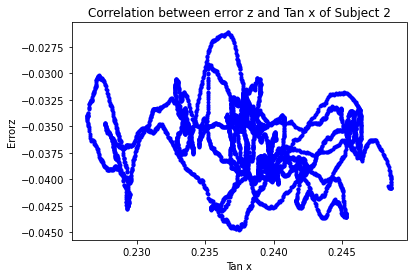

[[ 1.         -0.16989853]
 [-0.16989853  1.        ]]


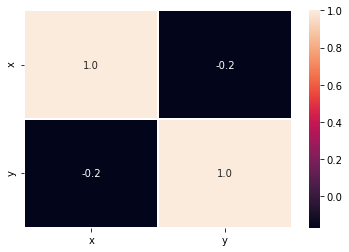

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


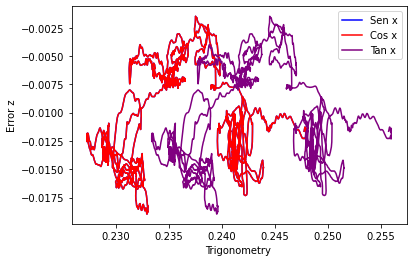

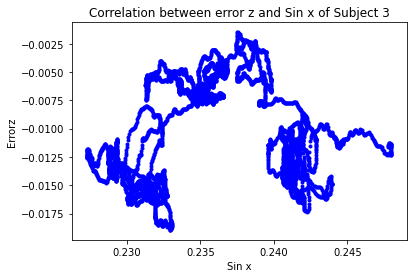

[[1.        0.1095872]
 [0.1095872 1.       ]]


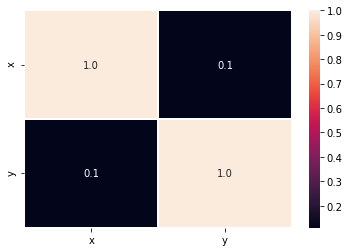

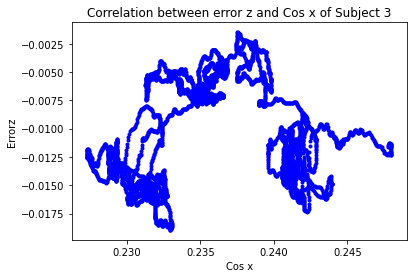

[[1.        0.1095872]
 [0.1095872 1.       ]]


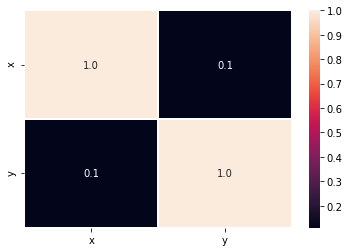

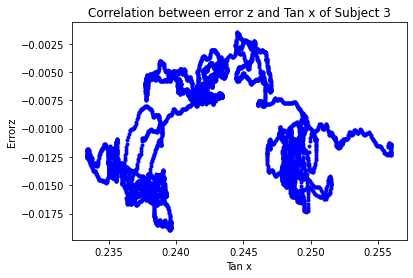

[[1.         0.10867664]
 [0.10867664 1.        ]]


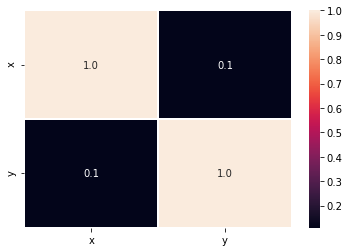

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


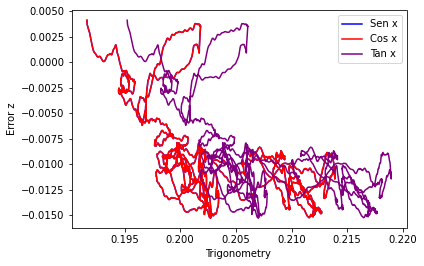

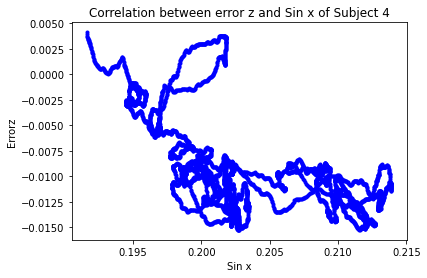

[[ 1.         -0.60642844]
 [-0.60642844  1.        ]]


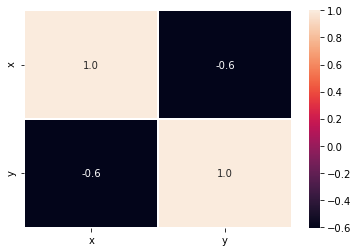

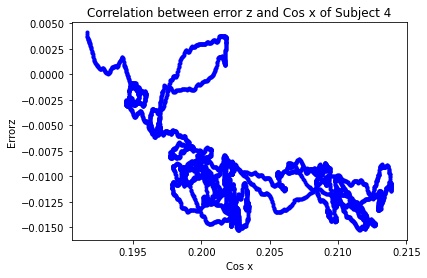

[[ 1.         -0.60642844]
 [-0.60642844  1.        ]]


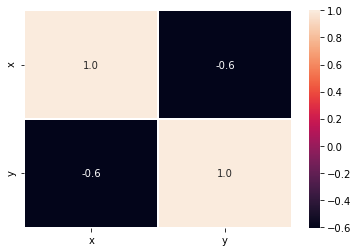

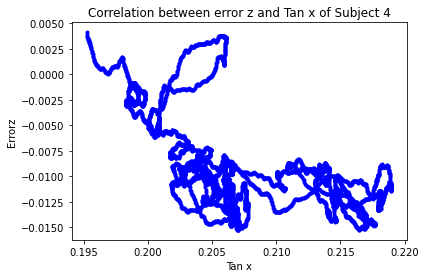

[[ 1.         -0.60587409]
 [-0.60587409  1.        ]]


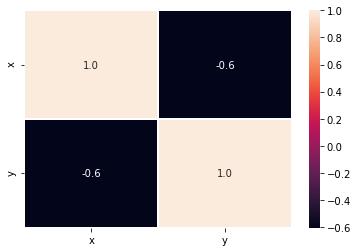

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


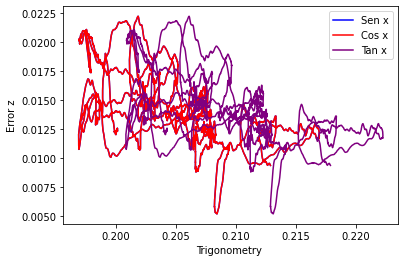

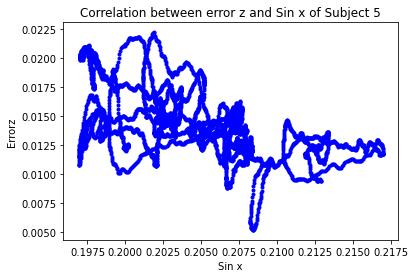

[[ 1.         -0.55852323]
 [-0.55852323  1.        ]]


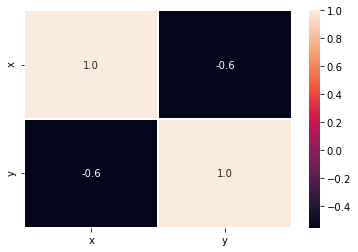

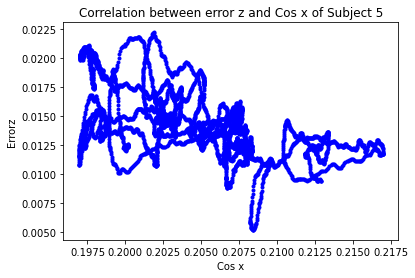

[[ 1.         -0.55852323]
 [-0.55852323  1.        ]]


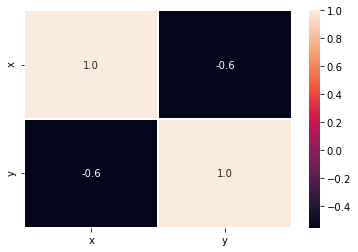

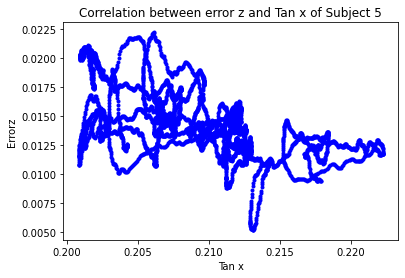

[[ 1.      -0.55837]
 [-0.55837  1.     ]]


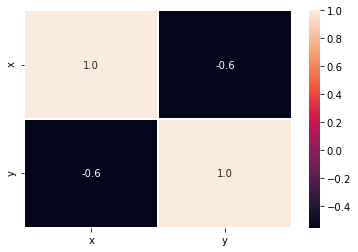

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


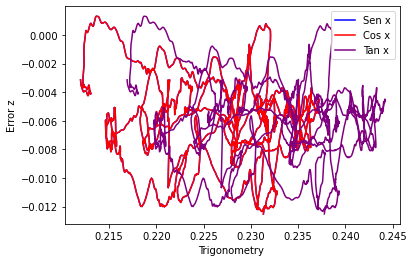

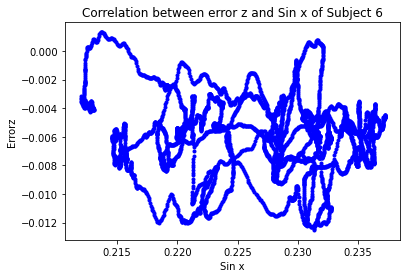

[[ 1.         -0.08503003]
 [-0.08503003  1.        ]]


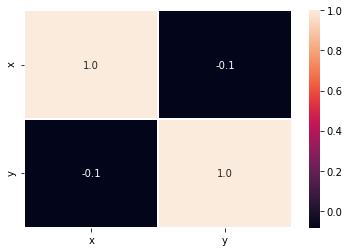

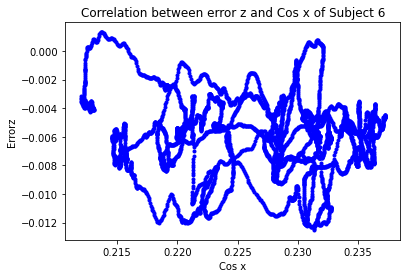

[[ 1.         -0.08503003]
 [-0.08503003  1.        ]]


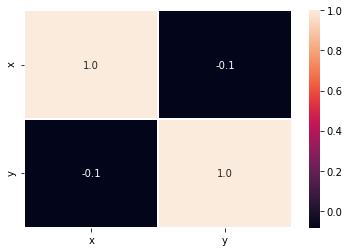

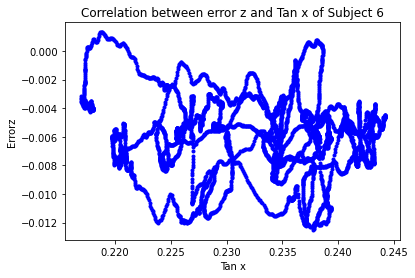

[[ 1.         -0.08475303]
 [-0.08475303  1.        ]]


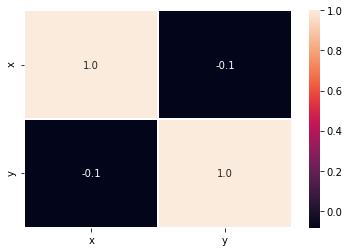

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


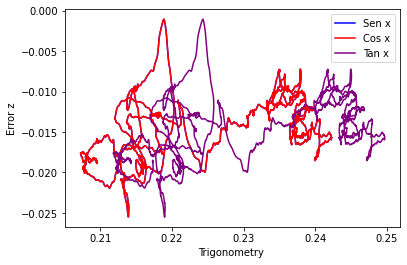

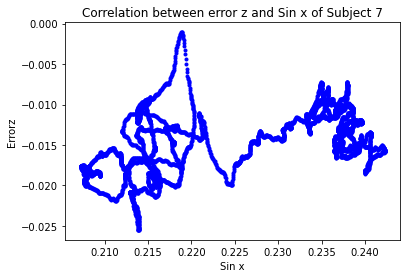

[[1.         0.46406403]
 [0.46406403 1.        ]]


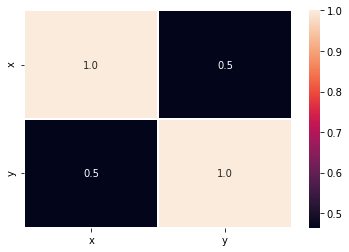

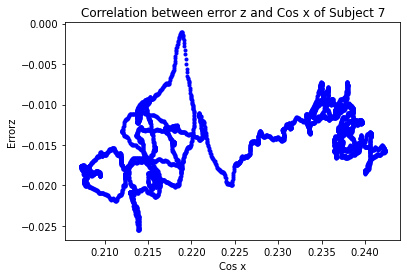

[[1.         0.46406403]
 [0.46406403 1.        ]]


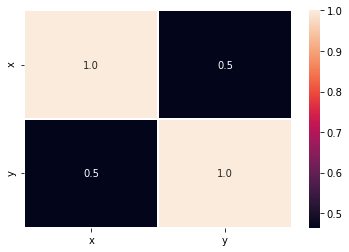

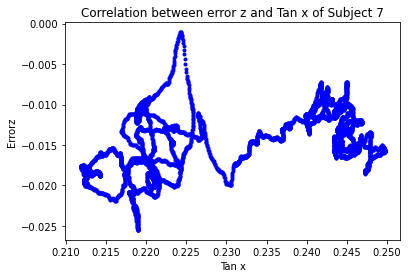

[[1.         0.46348379]
 [0.46348379 1.        ]]


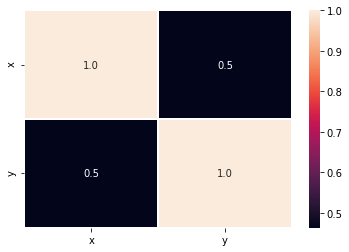

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


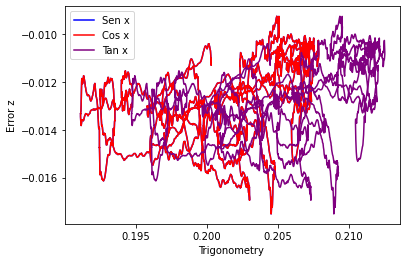

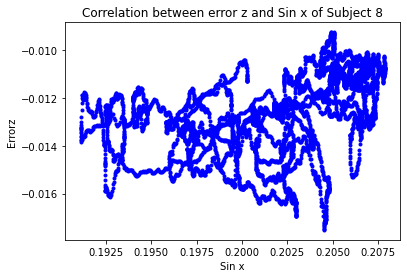

[[1.         0.40377876]
 [0.40377876 1.        ]]


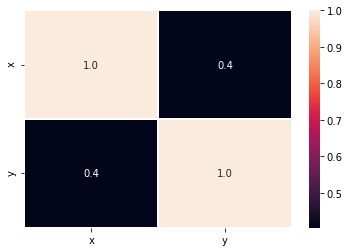

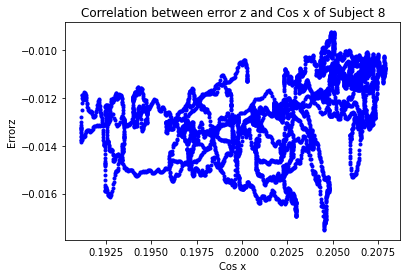

[[1.         0.40377876]
 [0.40377876 1.        ]]


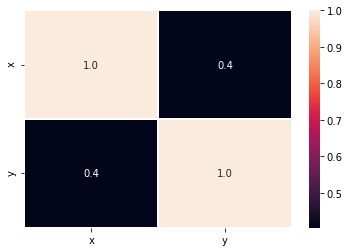

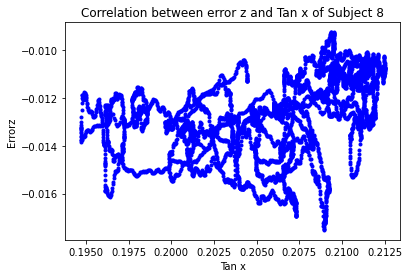

[[1.       0.404207]
 [0.404207 1.      ]]


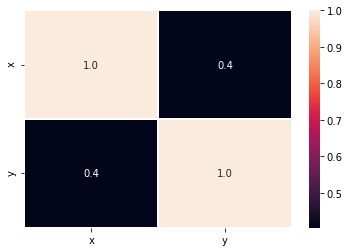

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


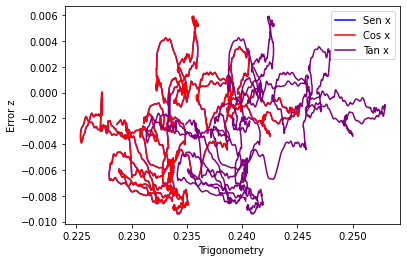

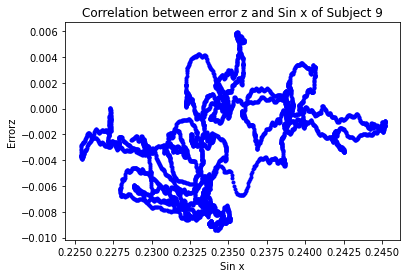

[[1.         0.35622379]
 [0.35622379 1.        ]]


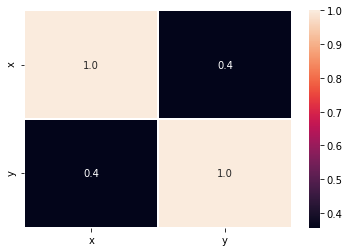

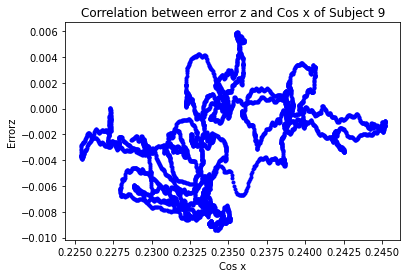

[[1.         0.35622379]
 [0.35622379 1.        ]]


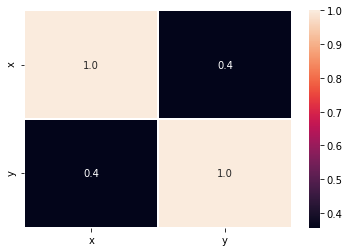

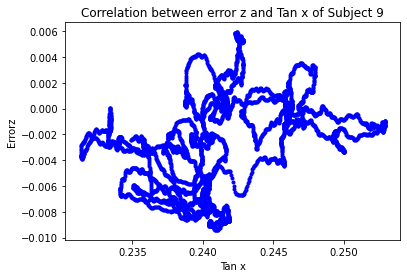

[[1.         0.35626139]
 [0.35626139 1.        ]]


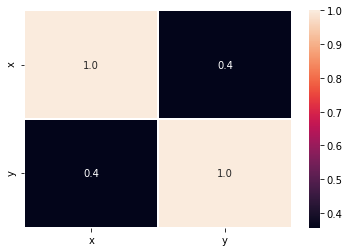

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


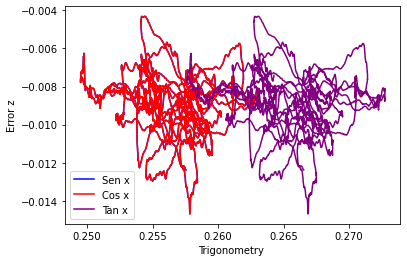

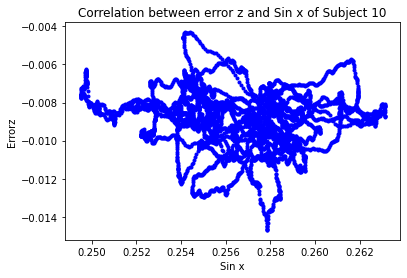

[[ 1.        -0.1292094]
 [-0.1292094  1.       ]]


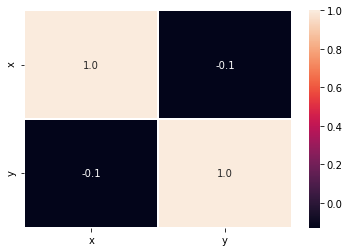

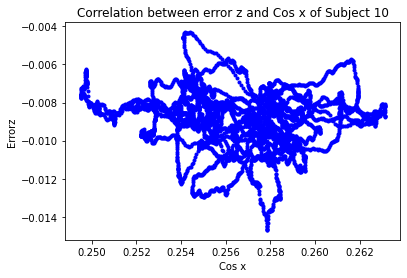

[[ 1.        -0.1292094]
 [-0.1292094  1.       ]]


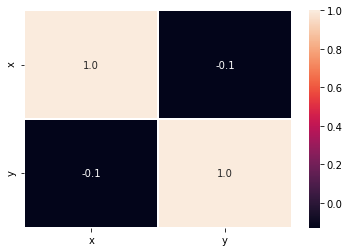

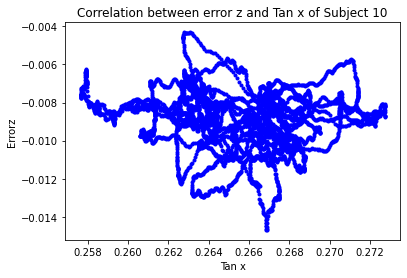

[[ 1.         -0.12886195]
 [-0.12886195  1.        ]]


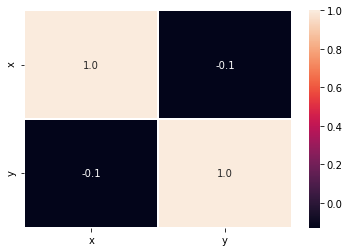

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


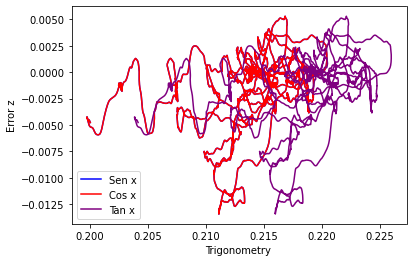

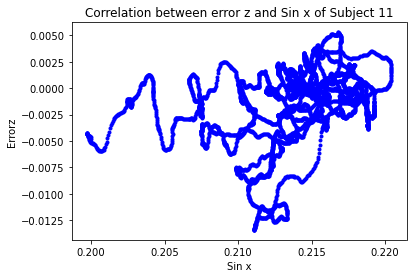

[[1.         0.31286051]
 [0.31286051 1.        ]]


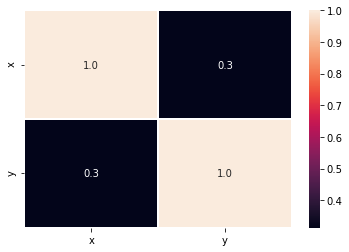

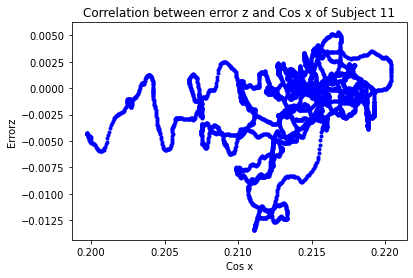

[[1.         0.31286051]
 [0.31286051 1.        ]]


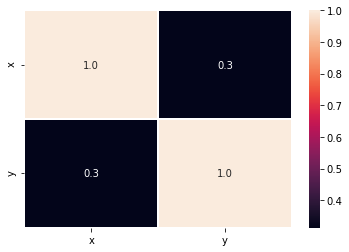

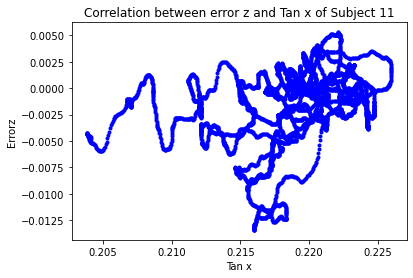

[[1.         0.31318191]
 [0.31318191 1.        ]]


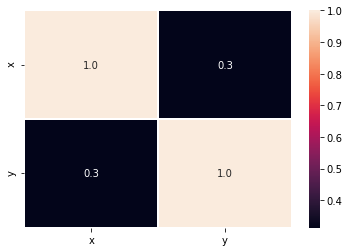

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


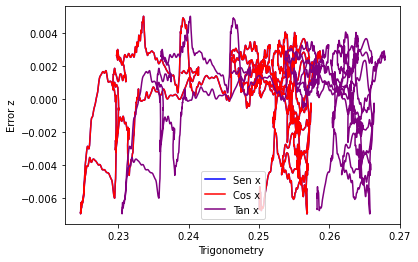

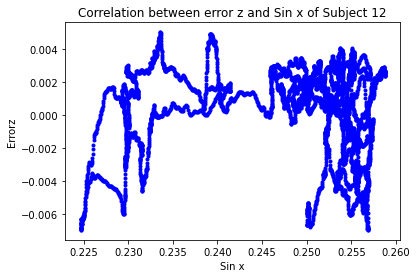

[[1.        0.0121659]
 [0.0121659 1.       ]]


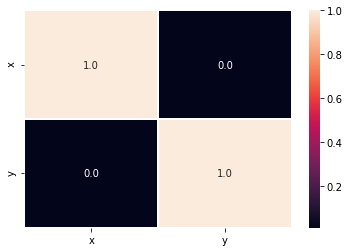

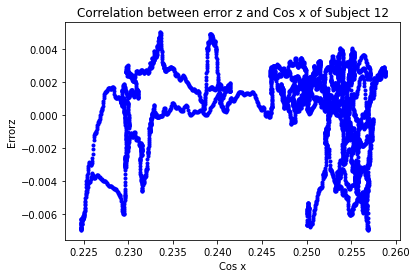

[[1.        0.0121659]
 [0.0121659 1.       ]]


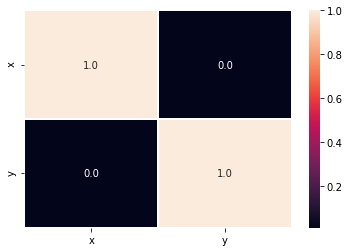

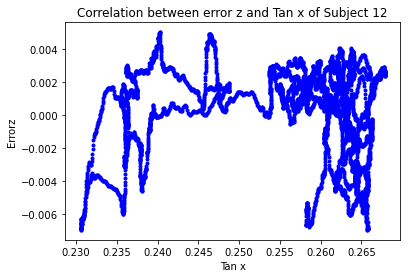

[[1.         0.01105827]
 [0.01105827 1.        ]]


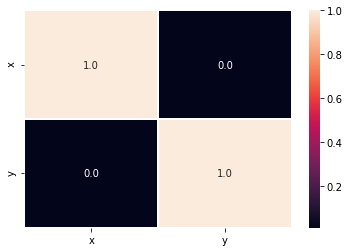

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


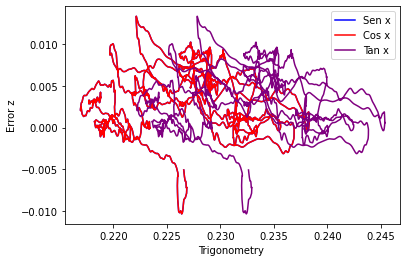

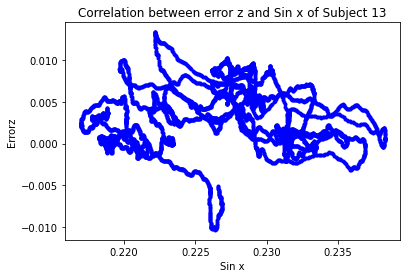

[[ 1.         -0.00119522]
 [-0.00119522  1.        ]]


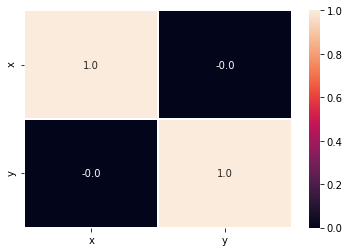

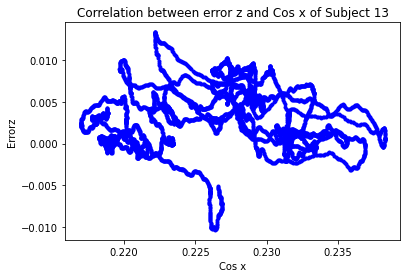

[[ 1.         -0.00119522]
 [-0.00119522  1.        ]]


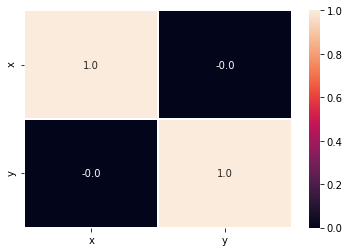

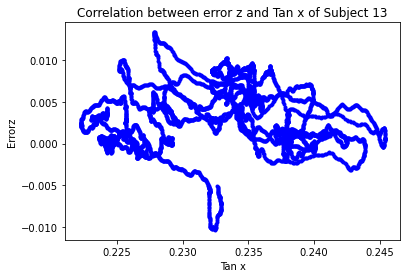

[[ 1.         -0.00173567]
 [-0.00173567  1.        ]]


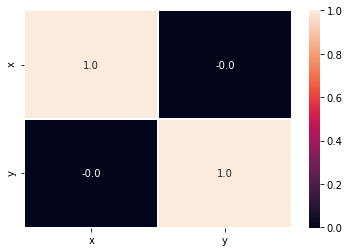

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


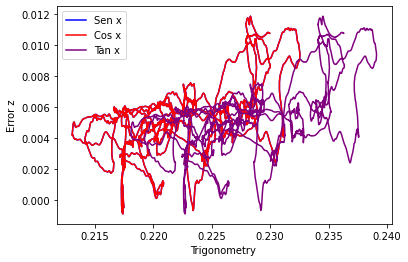

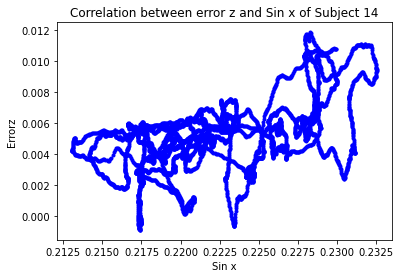

[[1.         0.52729238]
 [0.52729238 1.        ]]


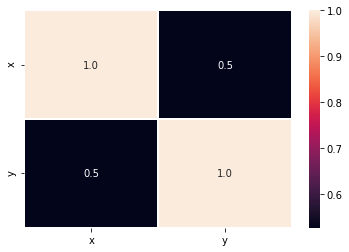

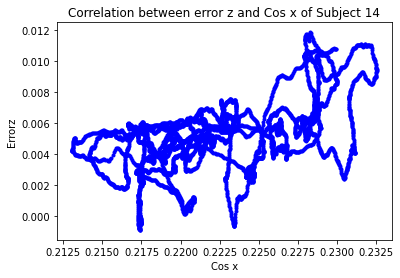

[[1.         0.52729238]
 [0.52729238 1.        ]]


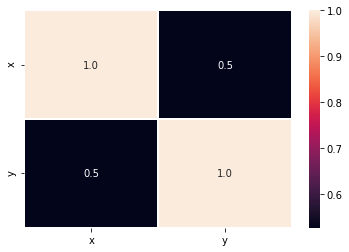

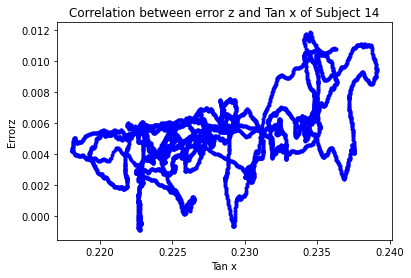

[[1.         0.52759313]
 [0.52759313 1.        ]]


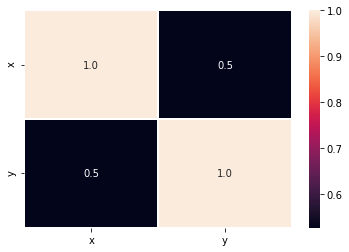

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


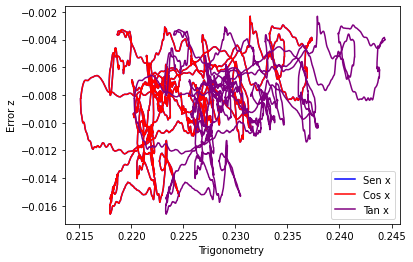

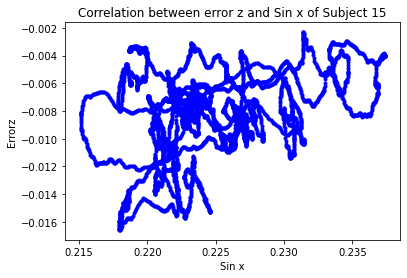

[[1.         0.37613936]
 [0.37613936 1.        ]]


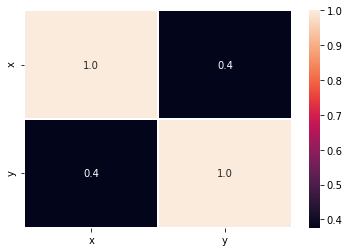

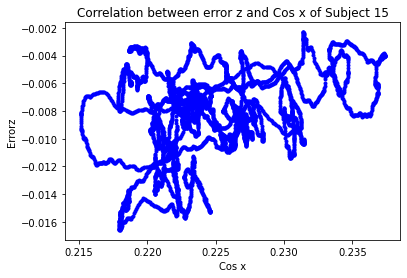

[[1.         0.37613936]
 [0.37613936 1.        ]]


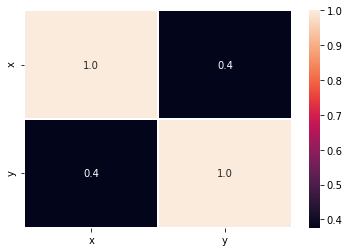

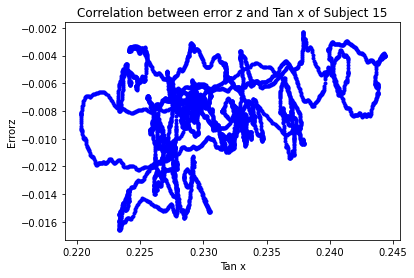

[[1.         0.37618727]
 [0.37618727 1.        ]]


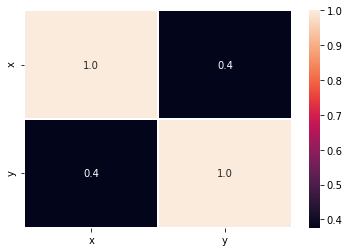

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


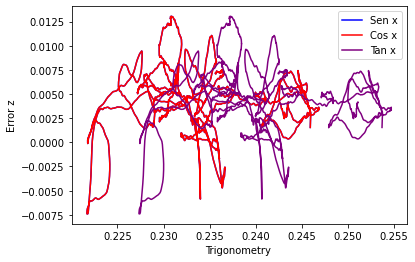

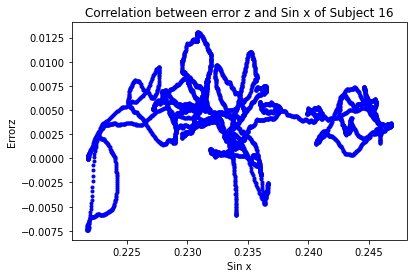

[[ 1.00000000e+00 -2.46124901e-04]
 [-2.46124901e-04  1.00000000e+00]]


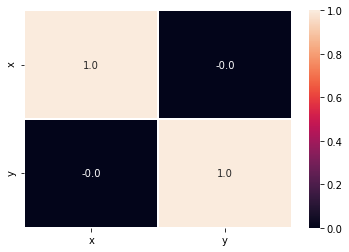

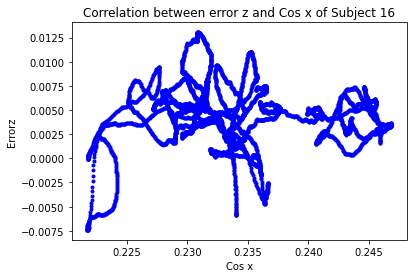

[[ 1.00000000e+00 -2.46124901e-04]
 [-2.46124901e-04  1.00000000e+00]]


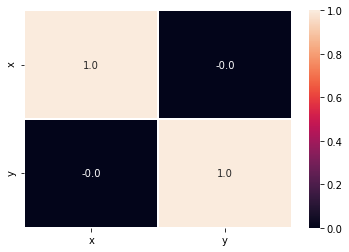

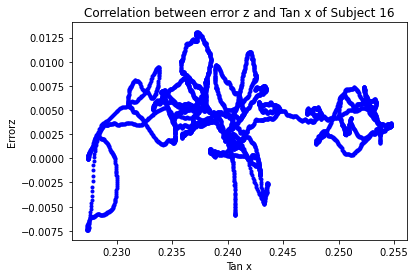

[[ 1.00000000e+00 -7.48401328e-04]
 [-7.48401328e-04  1.00000000e+00]]


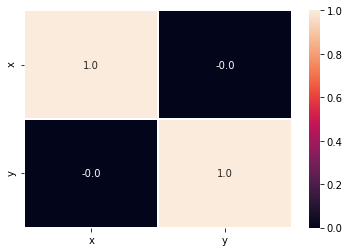

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


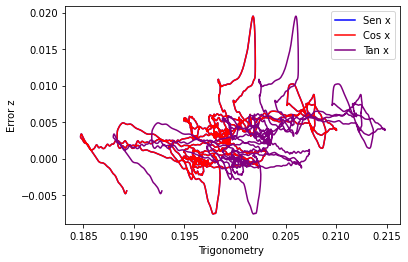

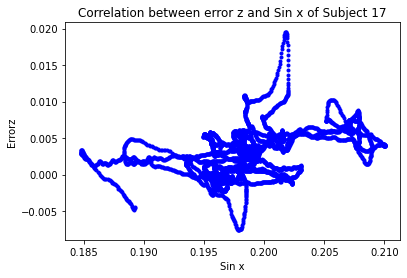

[[1.         0.39392511]
 [0.39392511 1.        ]]


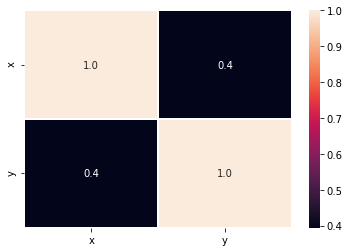

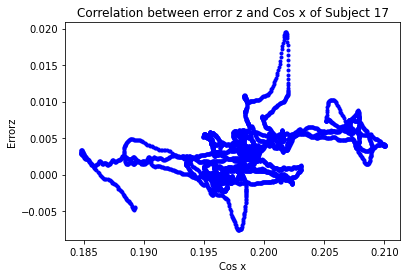

[[1.         0.39392511]
 [0.39392511 1.        ]]


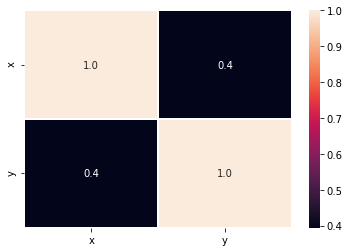

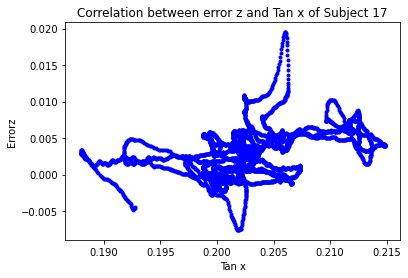

[[1.         0.39417585]
 [0.39417585 1.        ]]


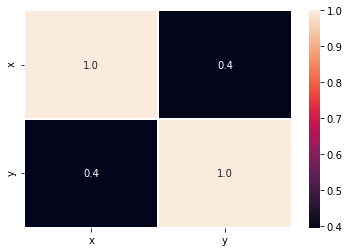

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


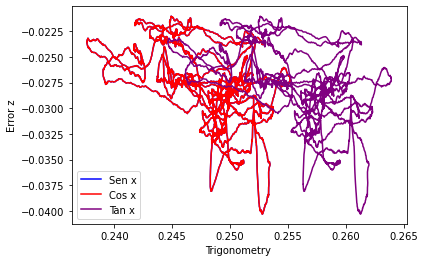

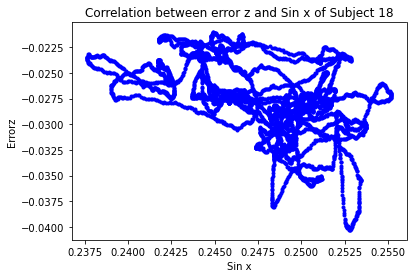

[[ 1.         -0.49838744]
 [-0.49838744  1.        ]]


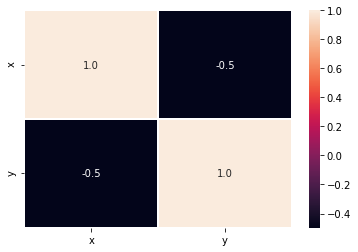

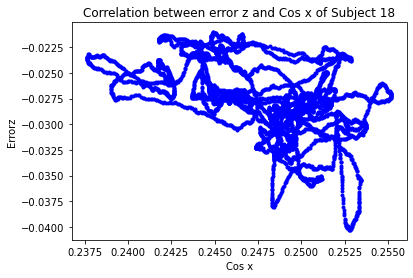

[[ 1.         -0.49838744]
 [-0.49838744  1.        ]]


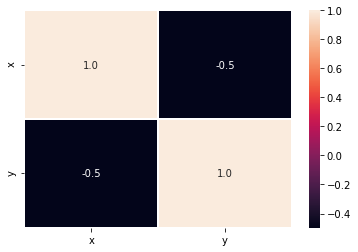

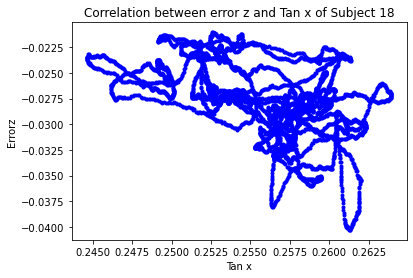

[[ 1.         -0.49832693]
 [-0.49832693  1.        ]]


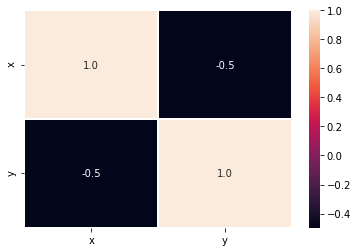

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


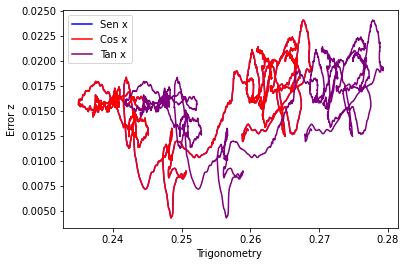

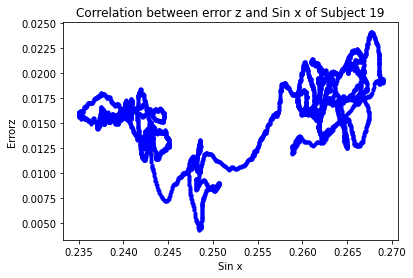

[[1.         0.46818868]
 [0.46818868 1.        ]]


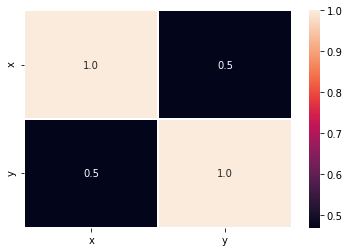

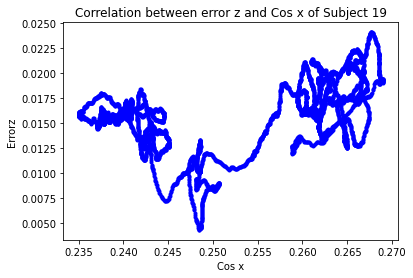

[[1.         0.46818868]
 [0.46818868 1.        ]]


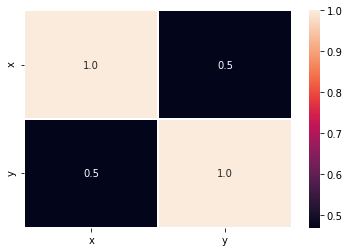

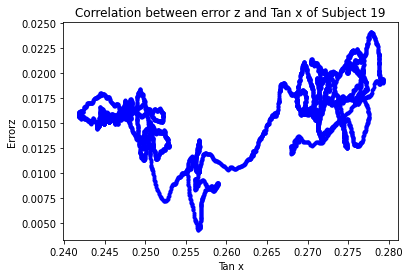

[[1.         0.46950413]
 [0.46950413 1.        ]]


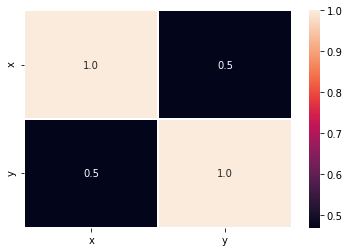

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


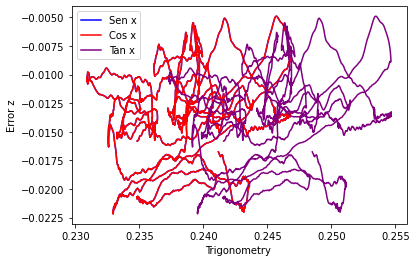

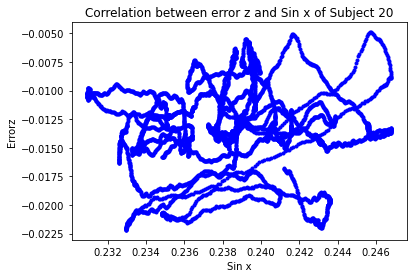

[[1.         0.06688866]
 [0.06688866 1.        ]]


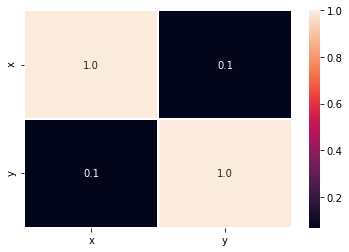

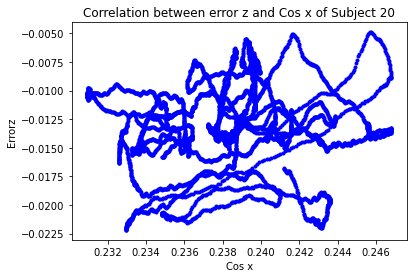

[[1.         0.06688866]
 [0.06688866 1.        ]]


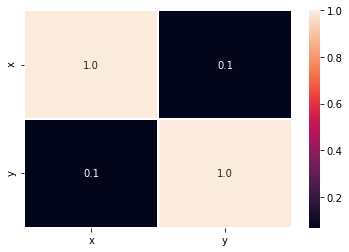

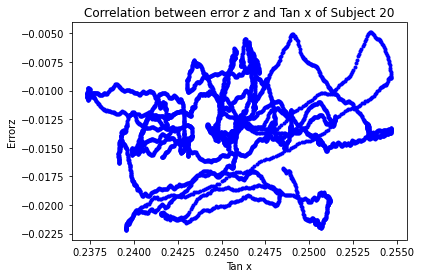

[[1.         0.06675442]
 [0.06675442 1.        ]]


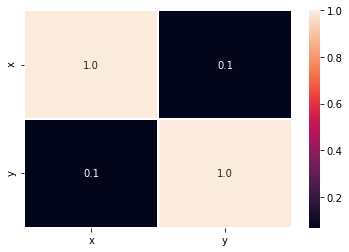

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


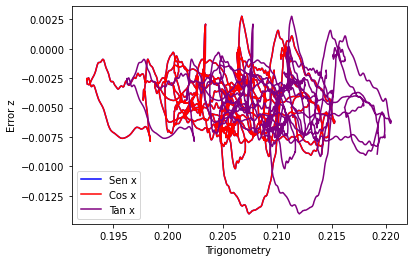

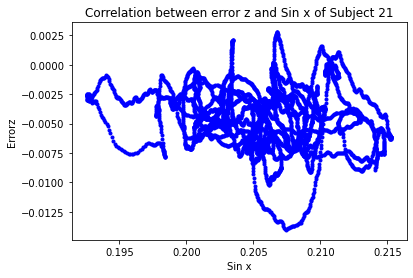

[[ 1.         -0.13843662]
 [-0.13843662  1.        ]]


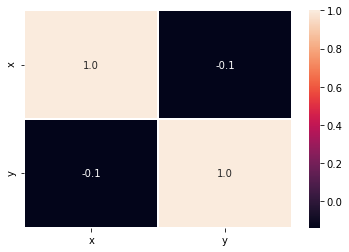

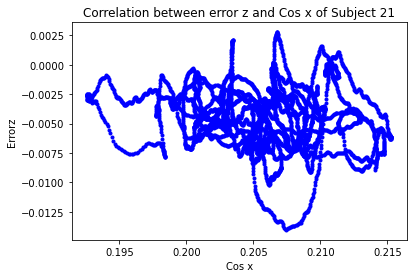

[[ 1.         -0.13843662]
 [-0.13843662  1.        ]]


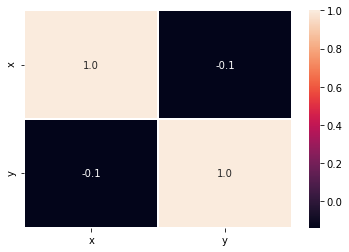

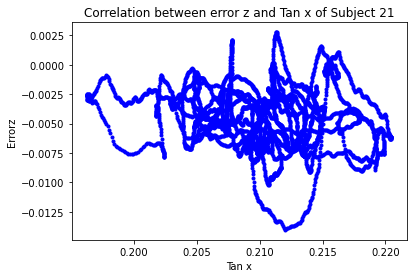

[[ 1.         -0.13831807]
 [-0.13831807  1.        ]]


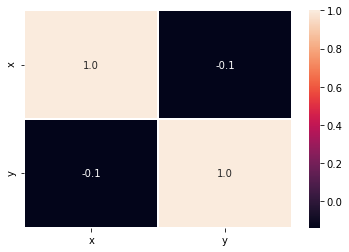

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


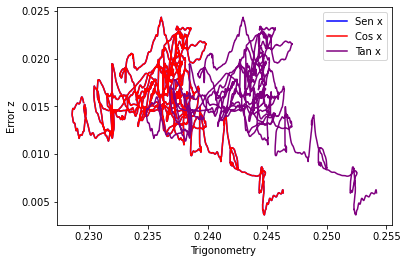

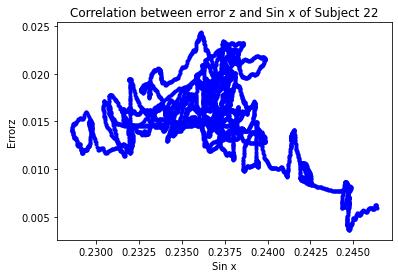

[[ 1.         -0.33430853]
 [-0.33430853  1.        ]]


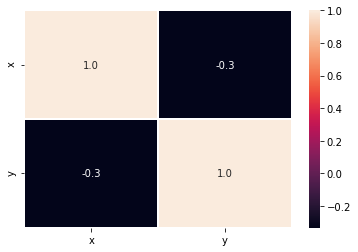

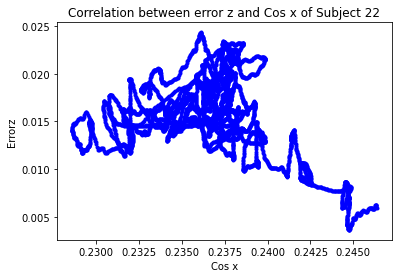

[[ 1.         -0.33430853]
 [-0.33430853  1.        ]]


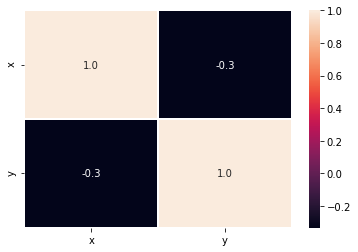

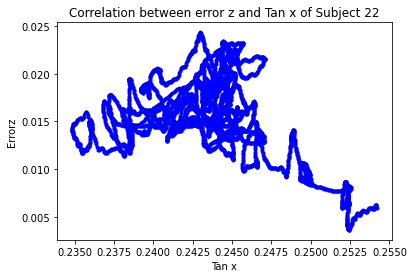

[[ 1.         -0.33552361]
 [-0.33552361  1.        ]]


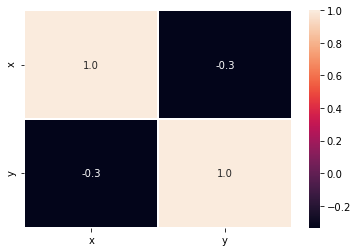

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


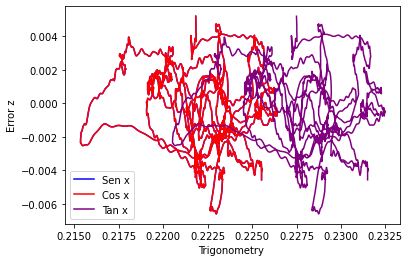

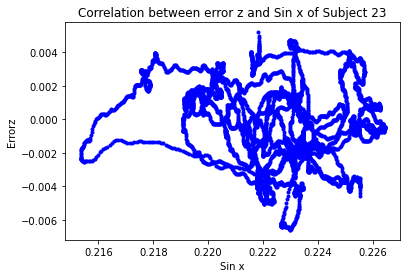

[[ 1.         -0.17761228]
 [-0.17761228  1.        ]]


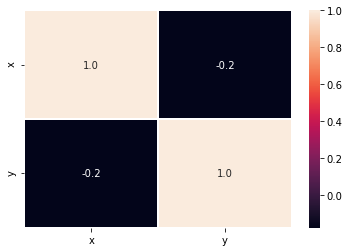

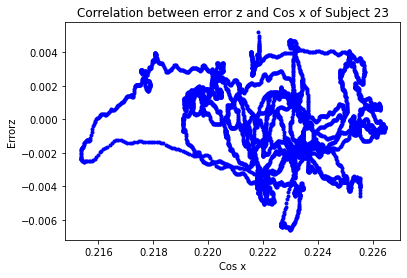

[[ 1.         -0.17761228]
 [-0.17761228  1.        ]]


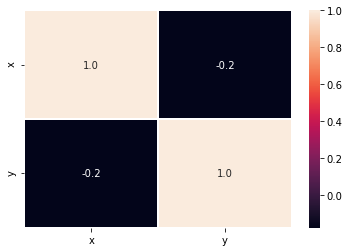

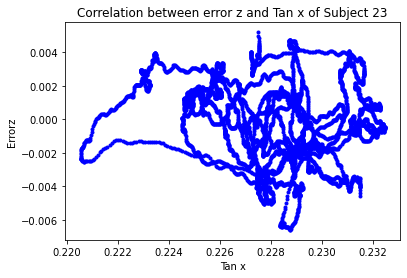

[[ 1.        -0.1774484]
 [-0.1774484  1.       ]]


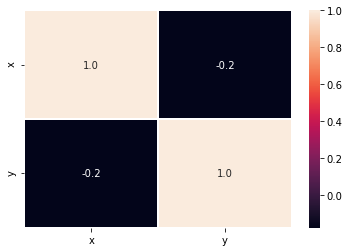

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


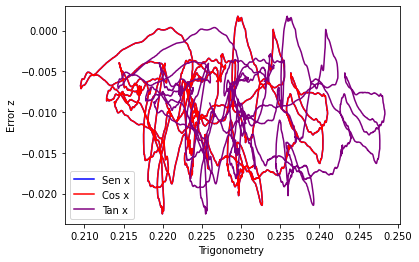

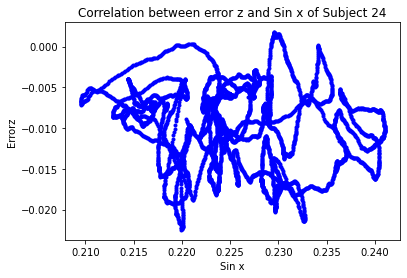

[[ 1.        -0.1359518]
 [-0.1359518  1.       ]]


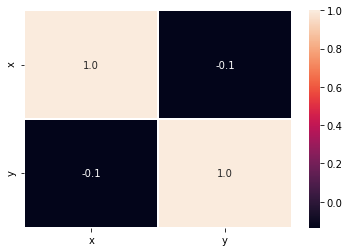

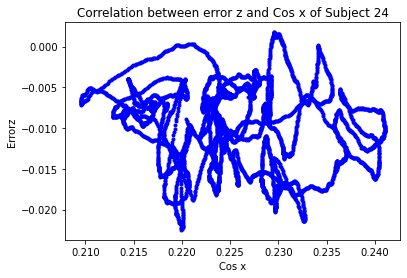

[[ 1.        -0.1359518]
 [-0.1359518  1.       ]]


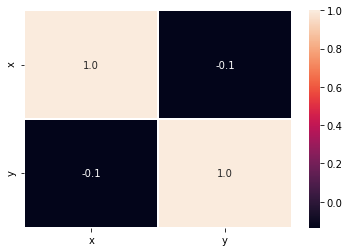

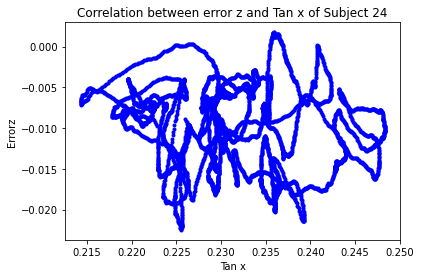

[[ 1.         -0.13567091]
 [-0.13567091  1.        ]]


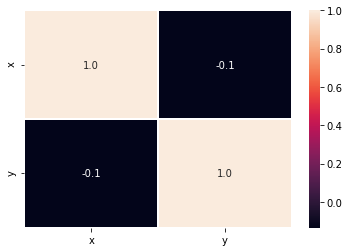

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


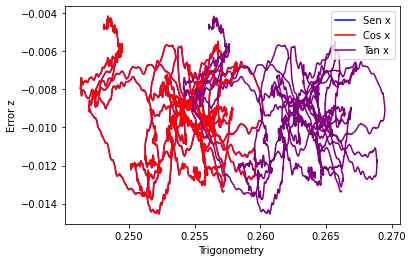

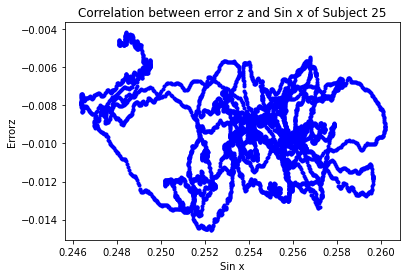

[[ 1.         -0.19085105]
 [-0.19085105  1.        ]]


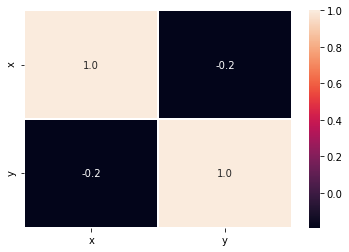

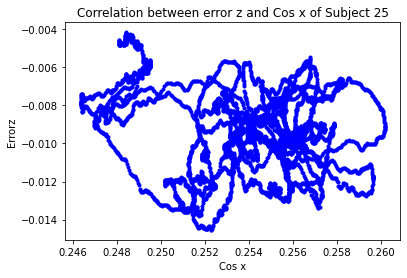

[[ 1.         -0.19085105]
 [-0.19085105  1.        ]]


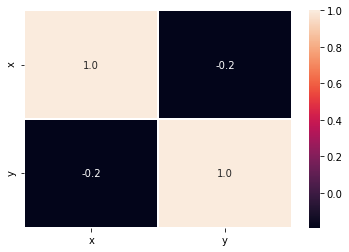

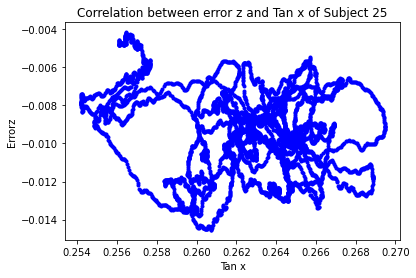

[[ 1.         -0.19050981]
 [-0.19050981  1.        ]]


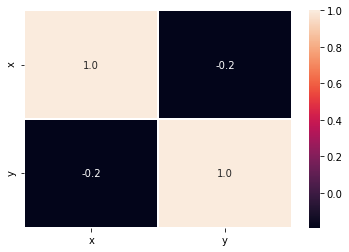

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


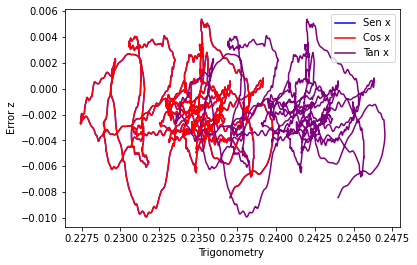

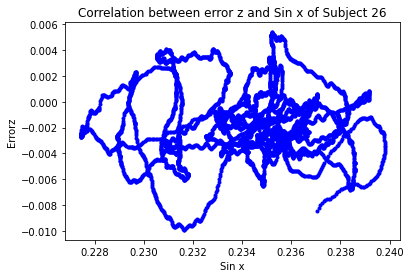

[[ 1.         -0.00419806]
 [-0.00419806  1.        ]]


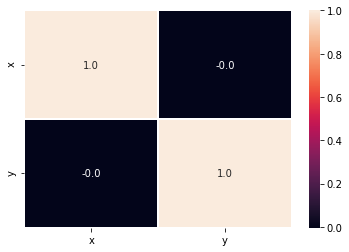

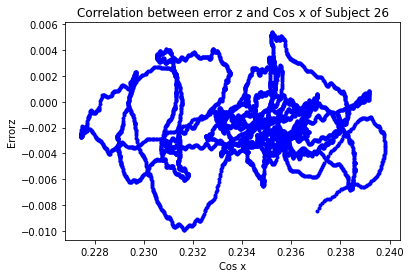

[[ 1.         -0.00419806]
 [-0.00419806  1.        ]]


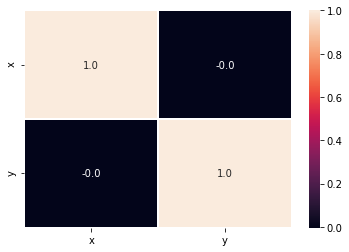

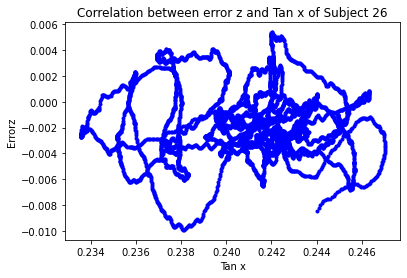

[[ 1.        -0.0043147]
 [-0.0043147  1.       ]]


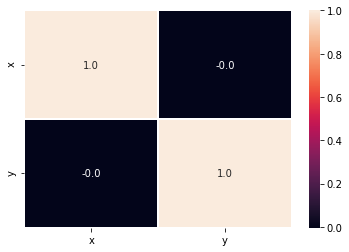

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


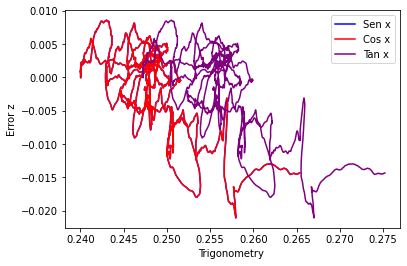

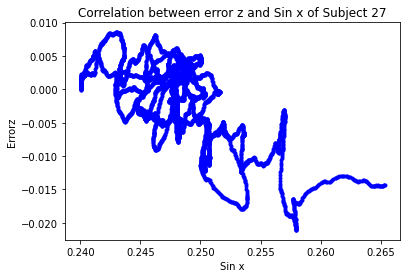

[[ 1.         -0.65888702]
 [-0.65888702  1.        ]]


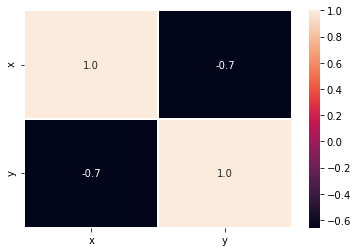

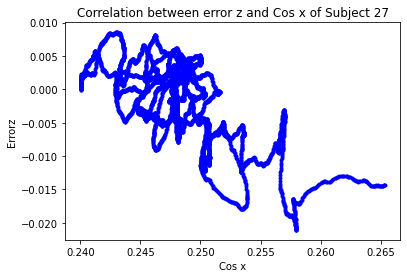

[[ 1.         -0.65888702]
 [-0.65888702  1.        ]]


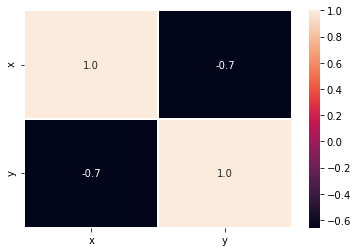

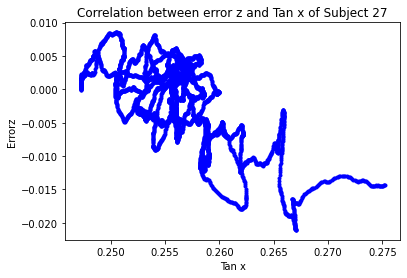

[[ 1.         -0.65928566]
 [-0.65928566  1.        ]]


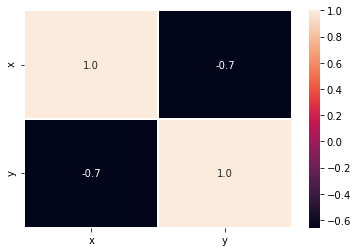

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


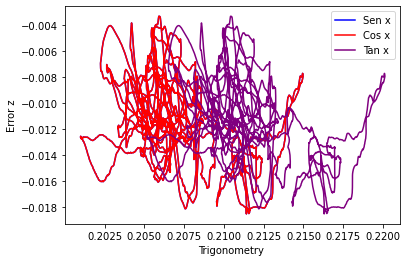

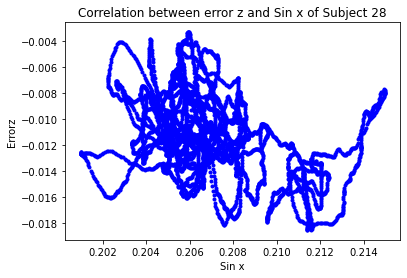

[[ 1.         -0.38350744]
 [-0.38350744  1.        ]]


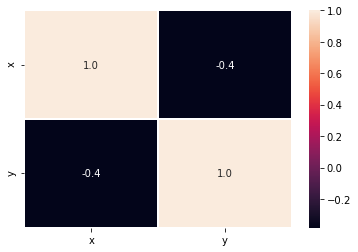

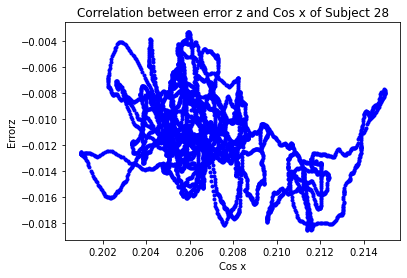

[[ 1.         -0.38350744]
 [-0.38350744  1.        ]]


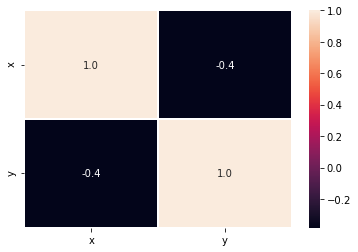

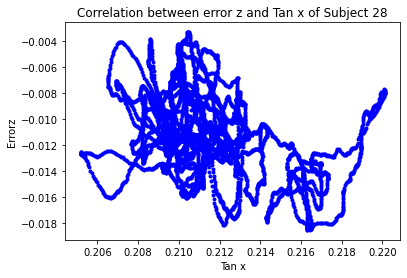

[[ 1.         -0.38348202]
 [-0.38348202  1.        ]]


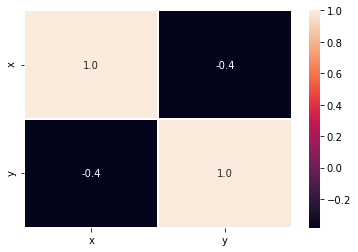

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


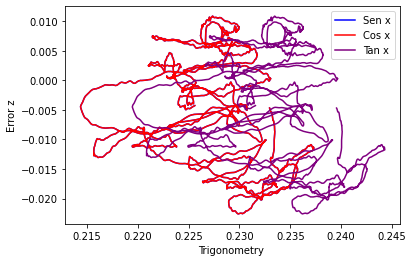

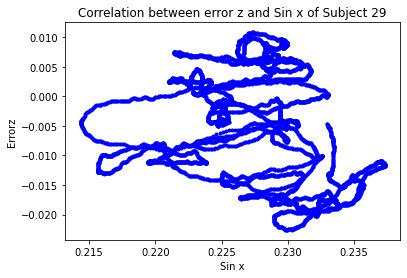

[[ 1.         -0.21109073]
 [-0.21109073  1.        ]]


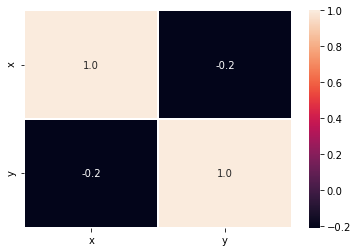

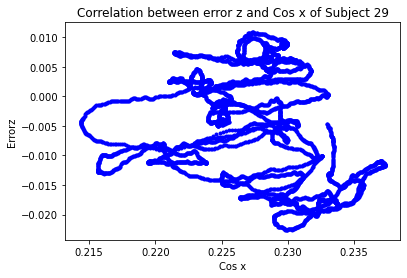

[[ 1.         -0.21109073]
 [-0.21109073  1.        ]]


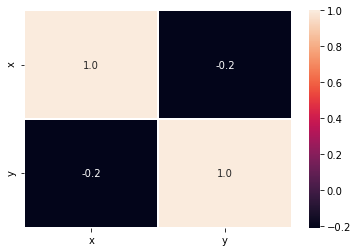

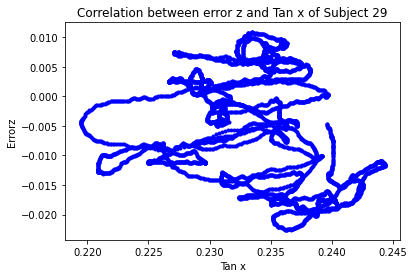

[[ 1.         -0.21192457]
 [-0.21192457  1.        ]]


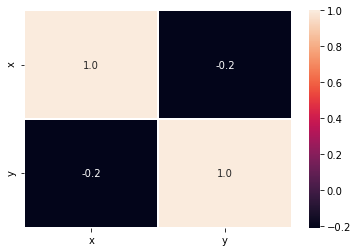

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


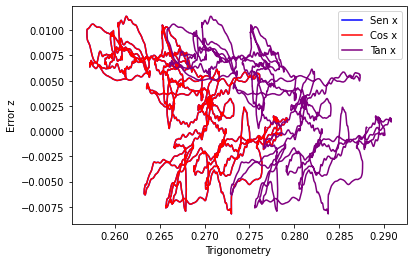

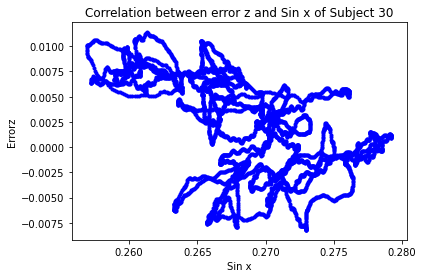

[[ 1.         -0.56144168]
 [-0.56144168  1.        ]]


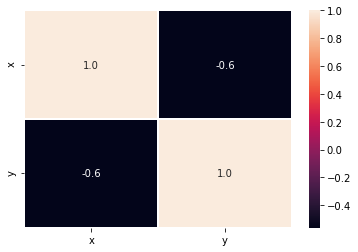

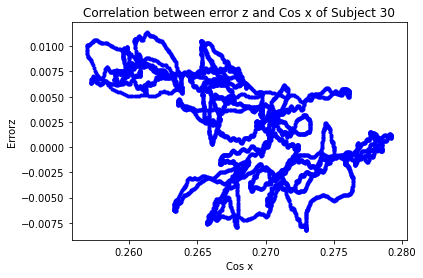

[[ 1.         -0.56144168]
 [-0.56144168  1.        ]]


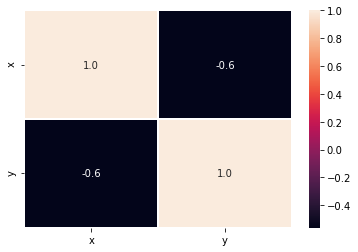

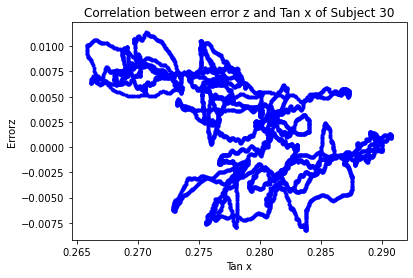

[[ 1.         -0.56088945]
 [-0.56088945  1.        ]]


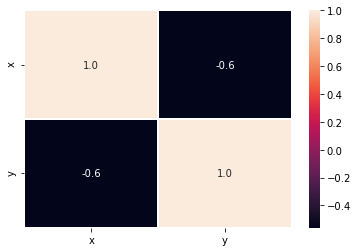

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


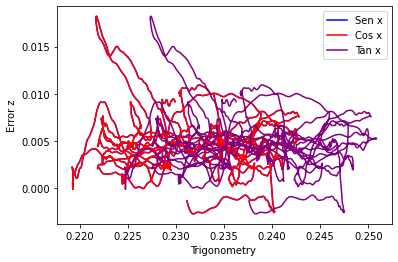

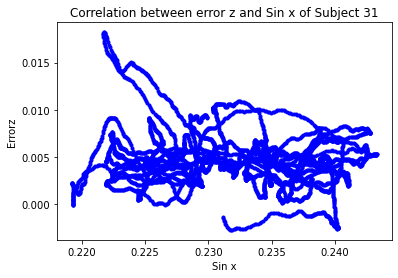

[[ 1.        -0.1435676]
 [-0.1435676  1.       ]]


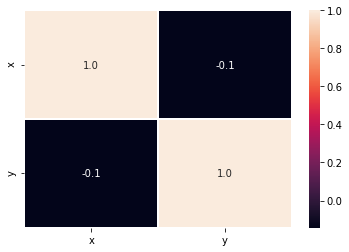

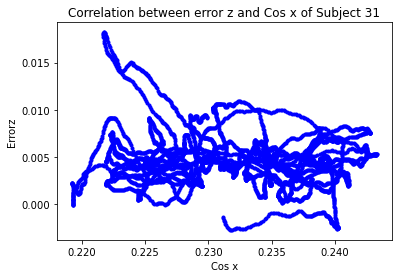

[[ 1.        -0.1435676]
 [-0.1435676  1.       ]]


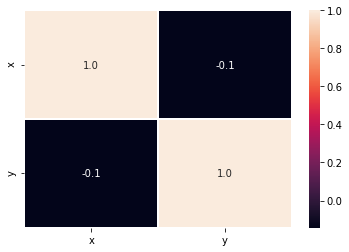

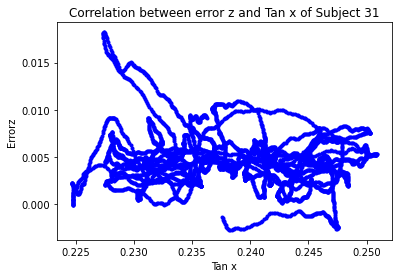

[[ 1.         -0.14356963]
 [-0.14356963  1.        ]]


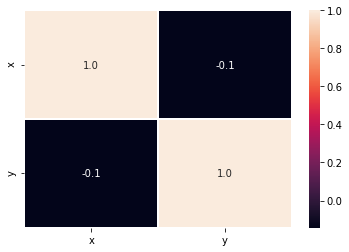

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


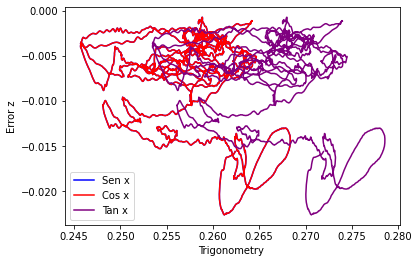

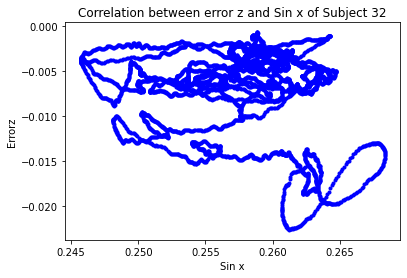

[[ 1.         -0.13737296]
 [-0.13737296  1.        ]]


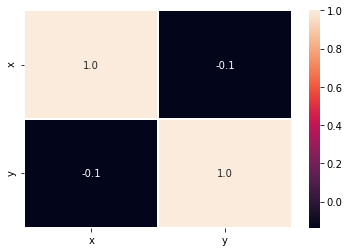

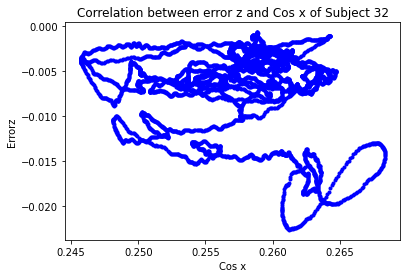

[[ 1.         -0.13737296]
 [-0.13737296  1.        ]]


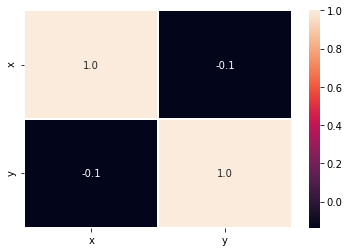

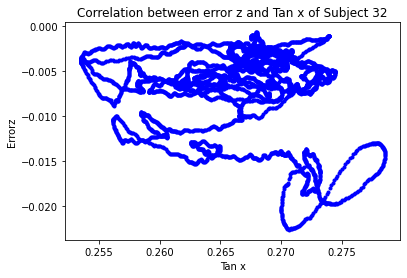

[[ 1.         -0.13788737]
 [-0.13788737  1.        ]]


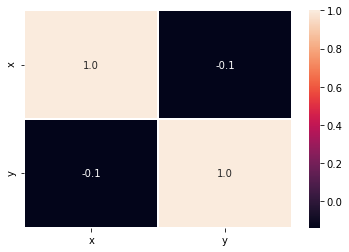

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


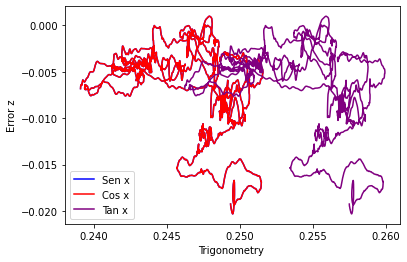

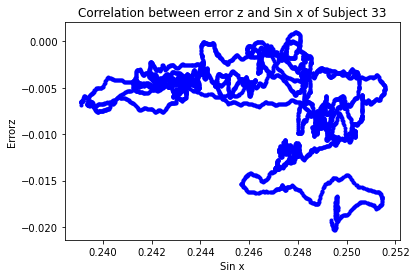

[[ 1.         -0.36887935]
 [-0.36887935  1.        ]]


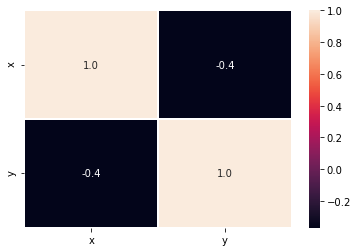

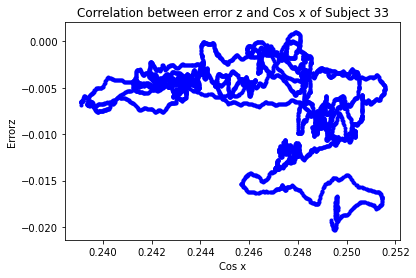

[[ 1.         -0.36887935]
 [-0.36887935  1.        ]]


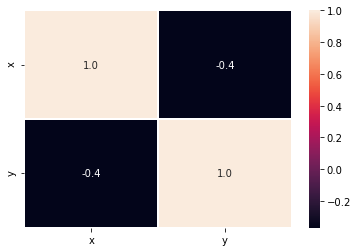

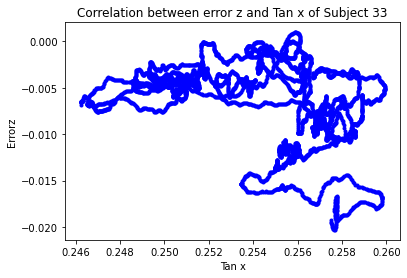

[[ 1.         -0.36910443]
 [-0.36910443  1.        ]]


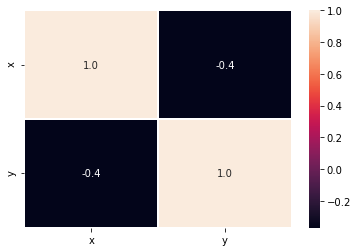

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


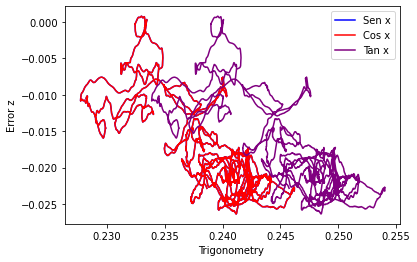

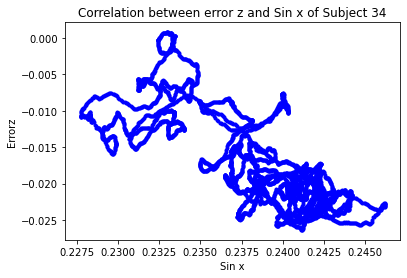

[[ 1.         -0.75411708]
 [-0.75411708  1.        ]]


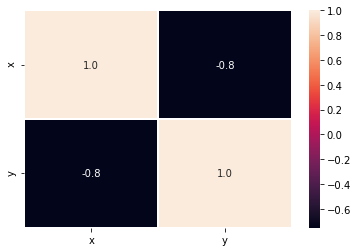

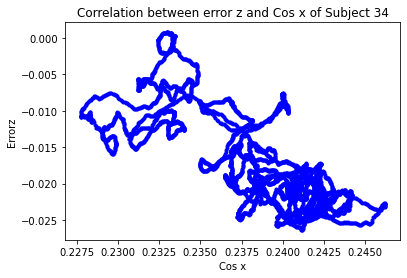

[[ 1.         -0.75411708]
 [-0.75411708  1.        ]]


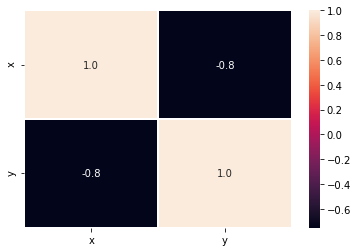

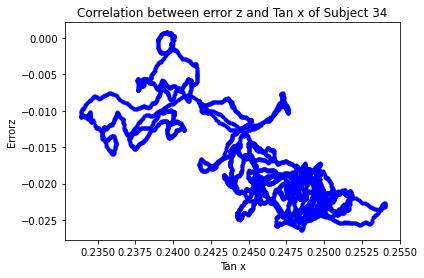

[[ 1.         -0.75421285]
 [-0.75421285  1.        ]]


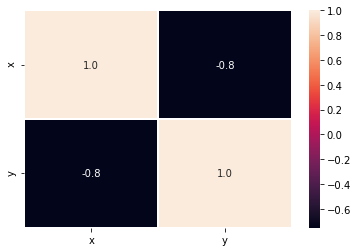

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


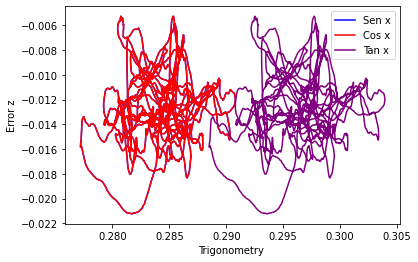

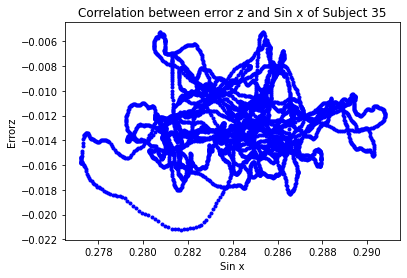

[[1.         0.07298302]
 [0.07298302 1.        ]]


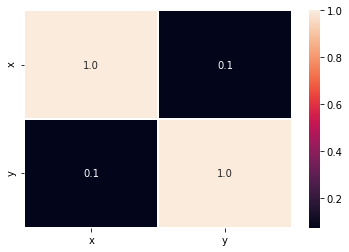

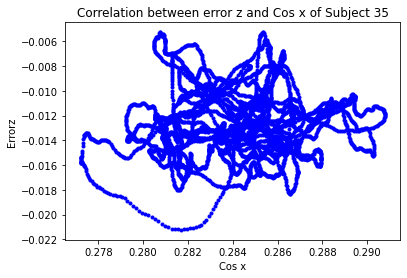

[[1.         0.07298302]
 [0.07298302 1.        ]]


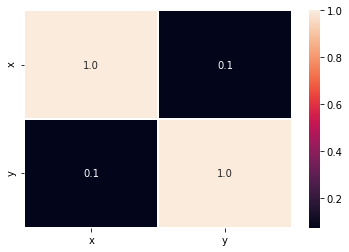

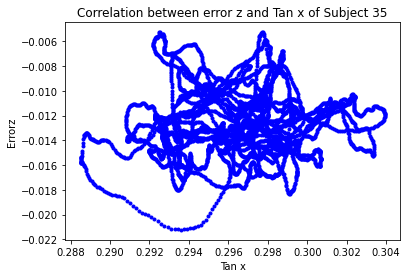

[[1.         0.07284485]
 [0.07284485 1.        ]]


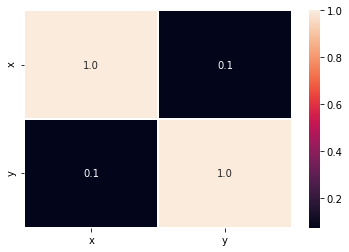

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


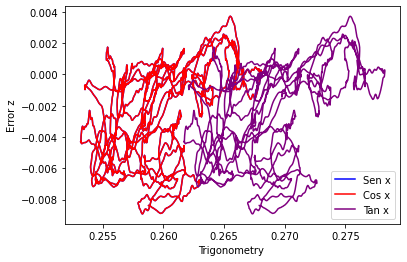

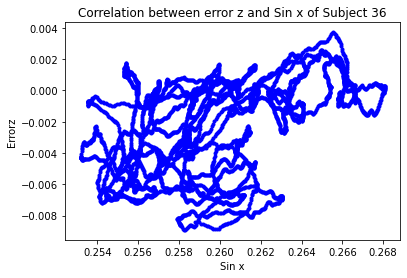

[[1.         0.44103773]
 [0.44103773 1.        ]]


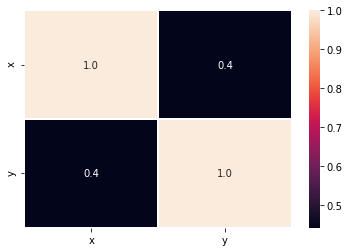

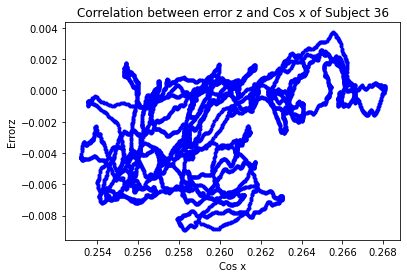

[[1.         0.44103773]
 [0.44103773 1.        ]]


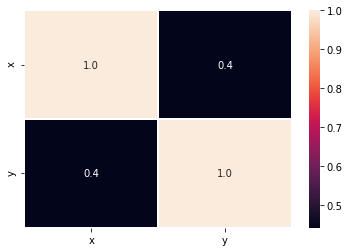

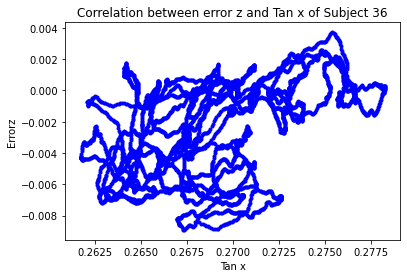

[[1.         0.44121933]
 [0.44121933 1.        ]]


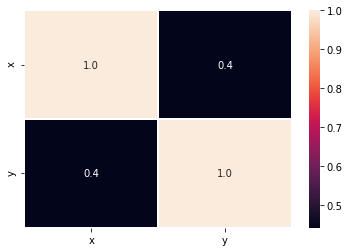

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


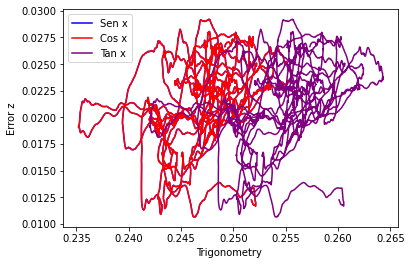

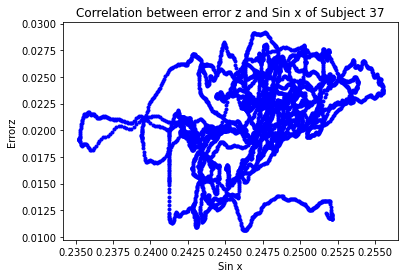

[[1.       0.369035]
 [0.369035 1.      ]]


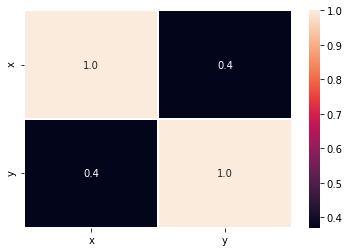

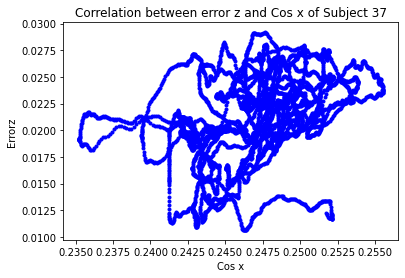

[[1.       0.369035]
 [0.369035 1.      ]]


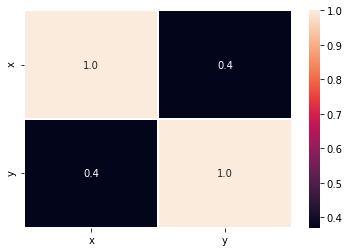

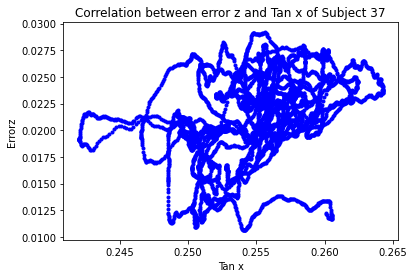

[[1.         0.36918389]
 [0.36918389 1.        ]]


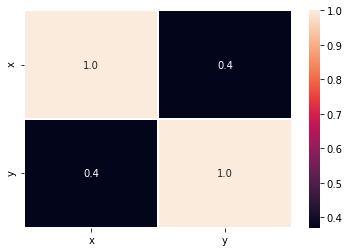

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


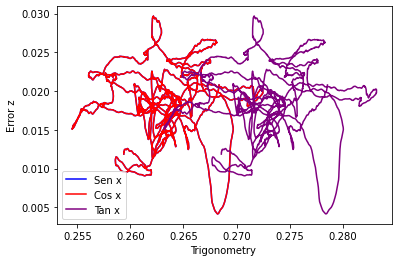

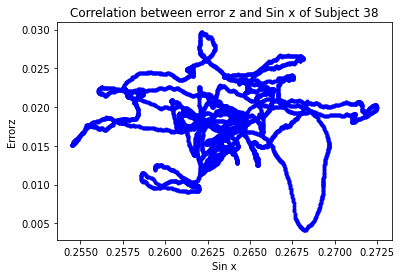

[[1.         0.04878183]
 [0.04878183 1.        ]]


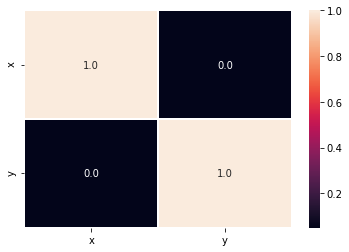

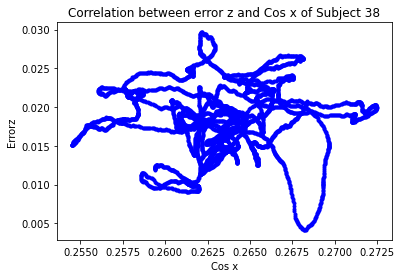

[[1.         0.04878183]
 [0.04878183 1.        ]]


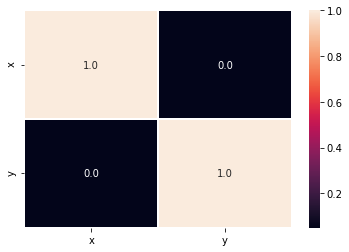

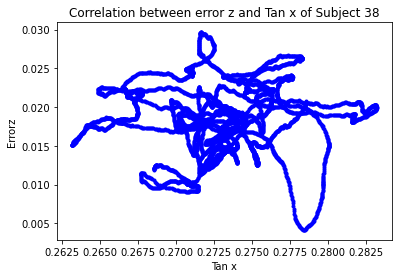

[[1.         0.04887267]
 [0.04887267 1.        ]]


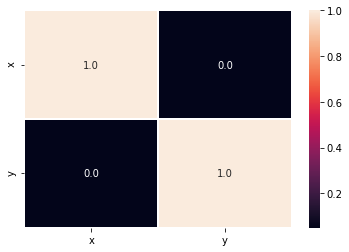

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


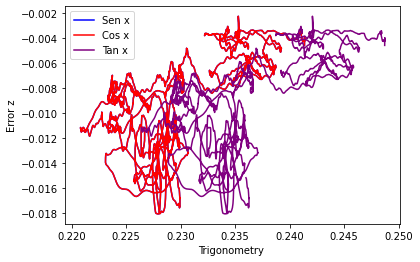

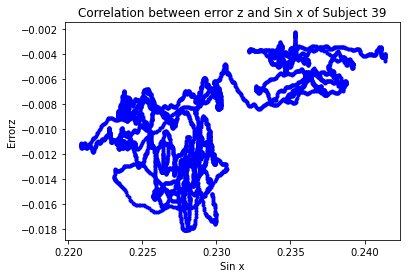

[[1.         0.60516464]
 [0.60516464 1.        ]]


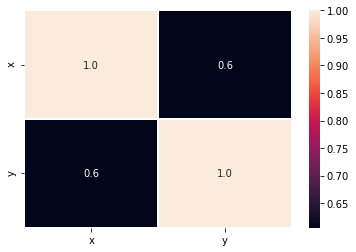

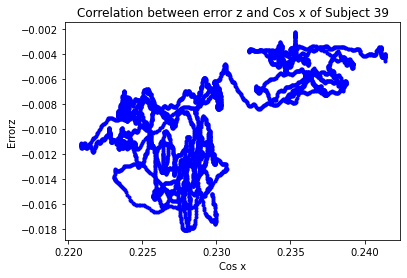

[[1.         0.60516464]
 [0.60516464 1.        ]]


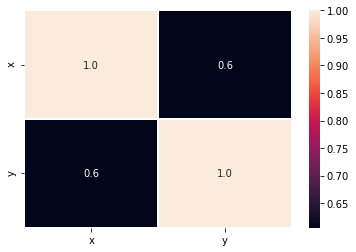

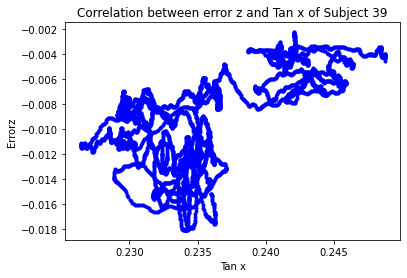

[[1.         0.60559317]
 [0.60559317 1.        ]]


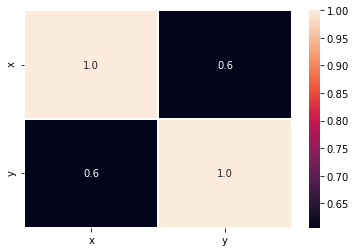

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


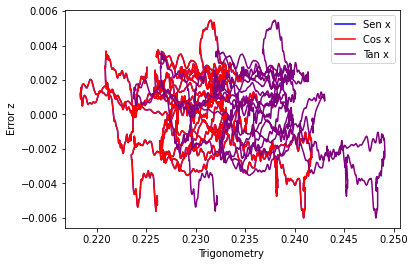

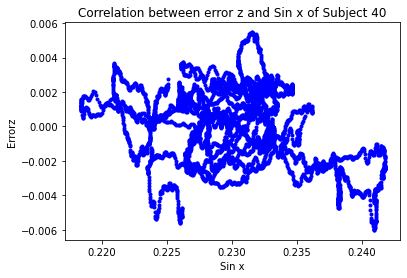

[[ 1.         -0.33151906]
 [-0.33151906  1.        ]]


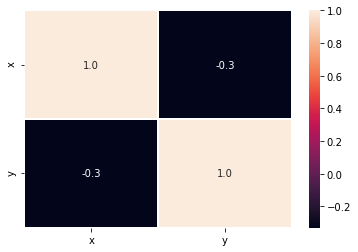

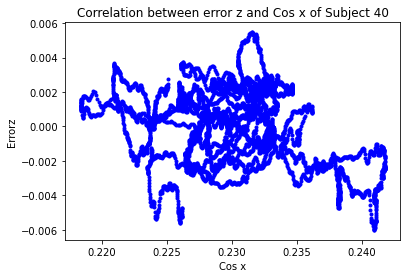

[[ 1.         -0.33151906]
 [-0.33151906  1.        ]]


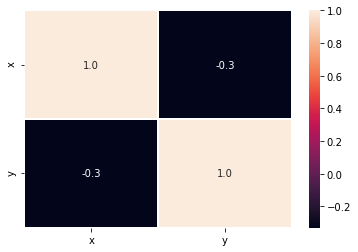

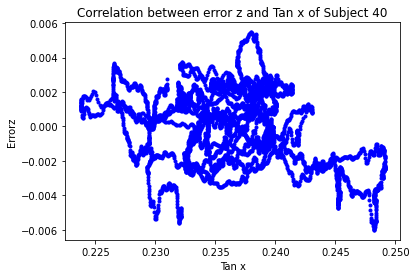

[[ 1.         -0.33222906]
 [-0.33222906  1.        ]]


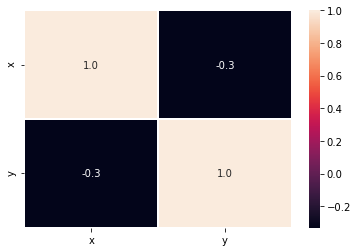

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


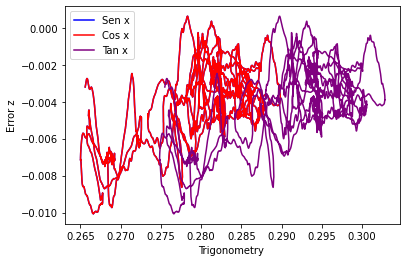

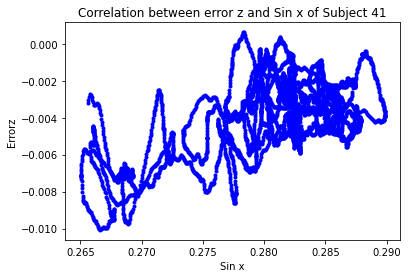

[[1.         0.59983303]
 [0.59983303 1.        ]]


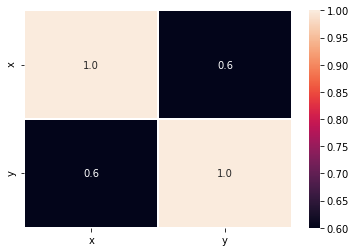

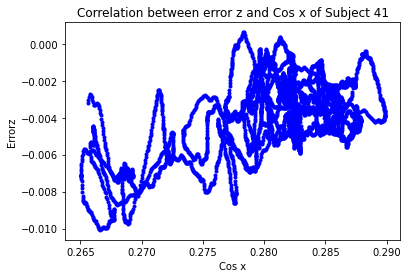

[[1.         0.59983303]
 [0.59983303 1.        ]]


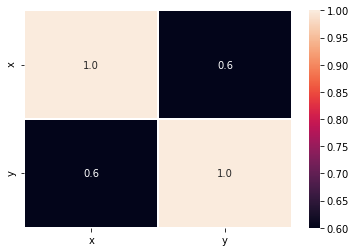

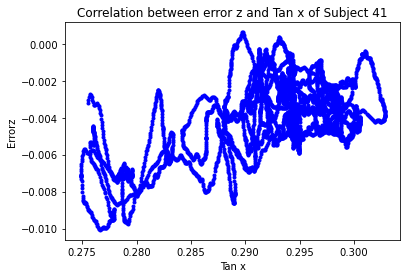

[[1.        0.5991714]
 [0.5991714 1.       ]]


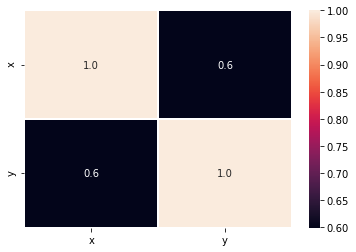

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


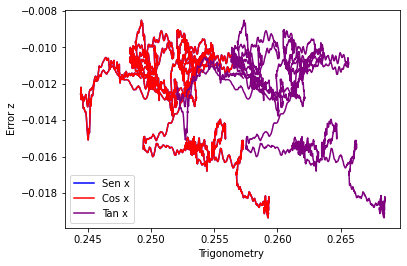

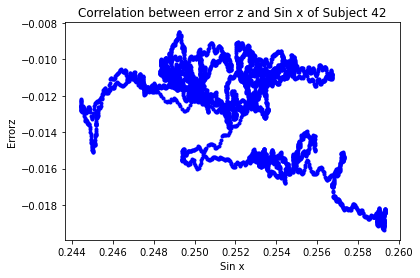

[[ 1.         -0.53674138]
 [-0.53674138  1.        ]]


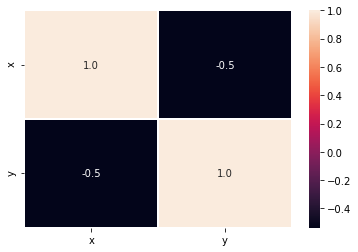

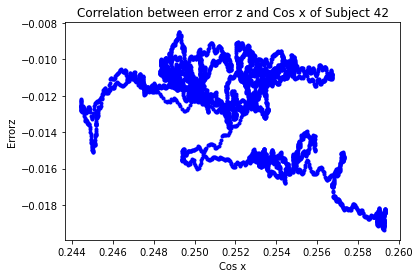

[[ 1.         -0.53674138]
 [-0.53674138  1.        ]]


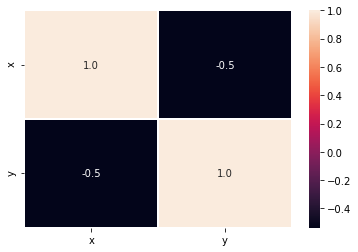

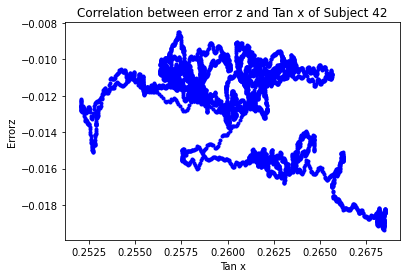

[[ 1.         -0.53745106]
 [-0.53745106  1.        ]]


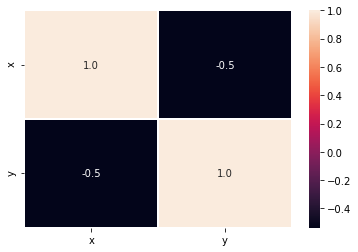

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


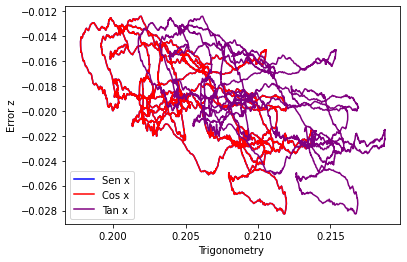

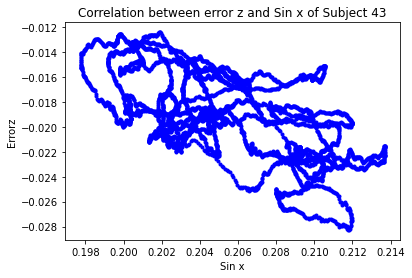

[[ 1.         -0.60510839]
 [-0.60510839  1.        ]]


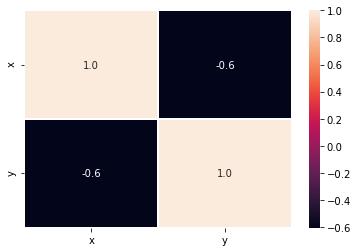

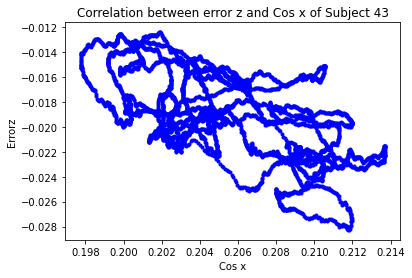

[[ 1.         -0.60510839]
 [-0.60510839  1.        ]]


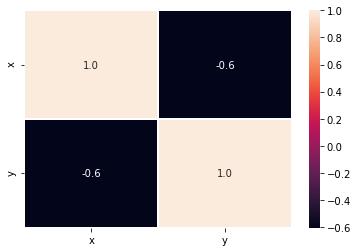

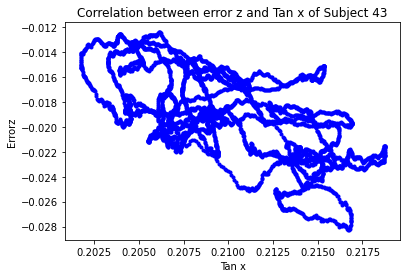

[[ 1.         -0.60514043]
 [-0.60514043  1.        ]]


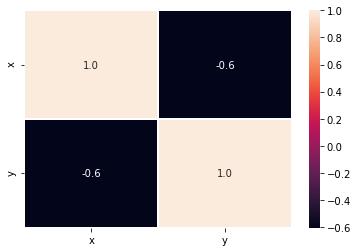

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


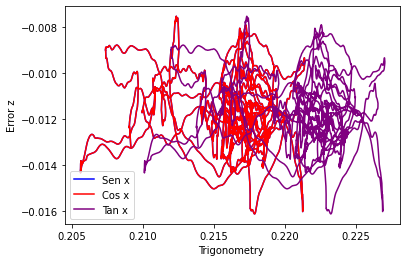

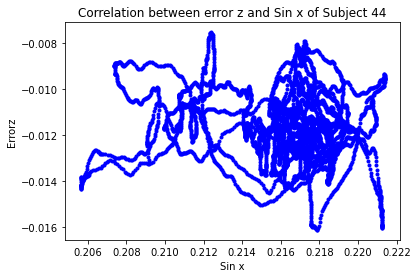

[[ 1.         -0.14646909]
 [-0.14646909  1.        ]]


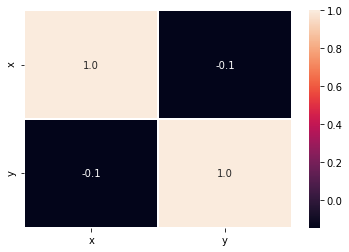

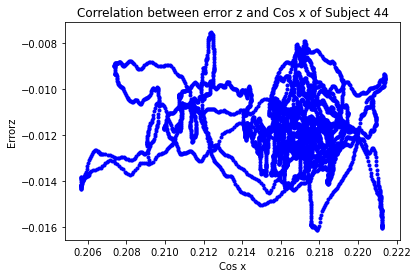

[[ 1.         -0.14646909]
 [-0.14646909  1.        ]]


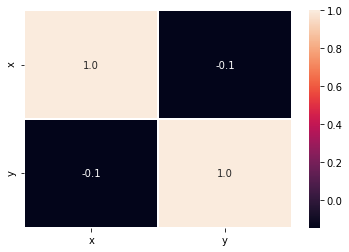

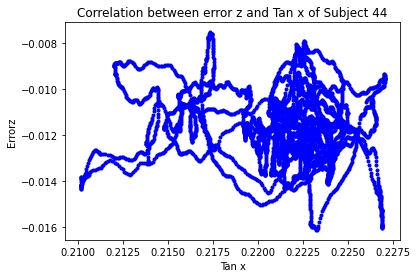

[[ 1.        -0.1466164]
 [-0.1466164  1.       ]]


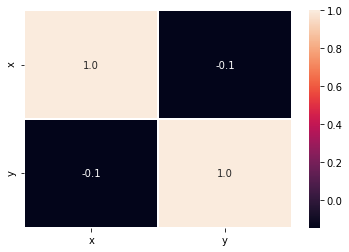

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


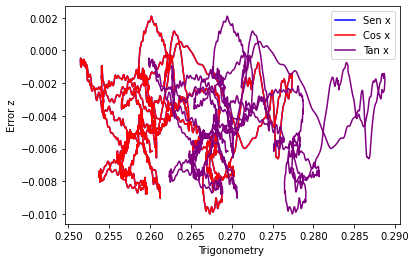

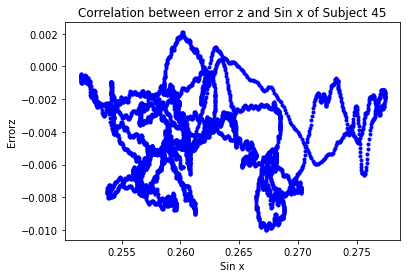

[[ 1.       -0.066204]
 [-0.066204  1.      ]]


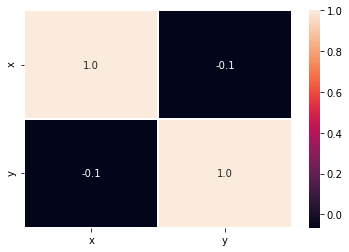

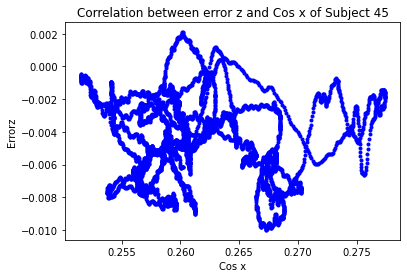

[[ 1.       -0.066204]
 [-0.066204  1.      ]]


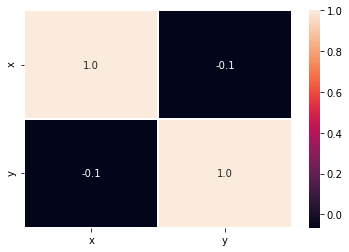

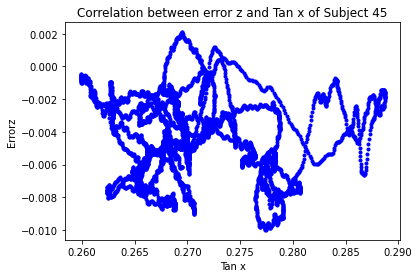

[[ 1.         -0.06572742]
 [-0.06572742  1.        ]]


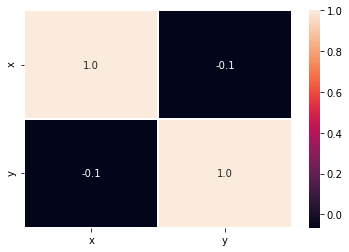

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


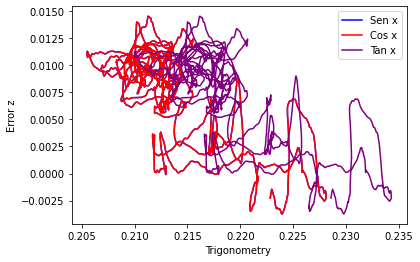

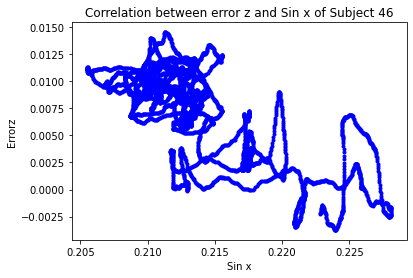

[[ 1.        -0.7325738]
 [-0.7325738  1.       ]]


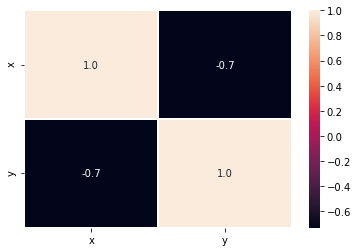

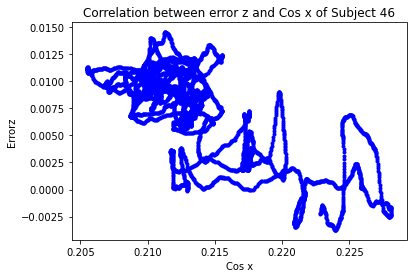

[[ 1.        -0.7325738]
 [-0.7325738  1.       ]]


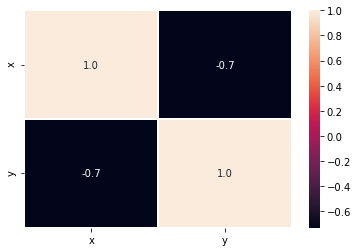

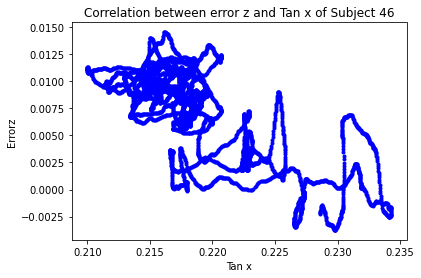

[[ 1.         -0.73253733]
 [-0.73253733  1.        ]]


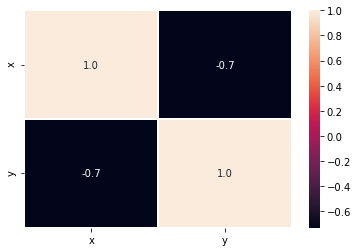

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


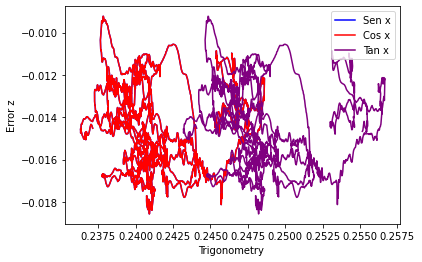

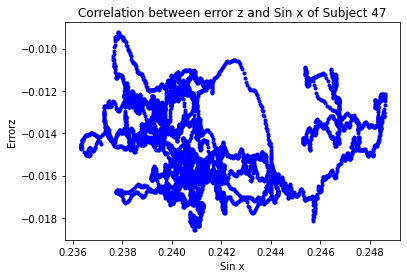

[[ 1.         -0.10972804]
 [-0.10972804  1.        ]]


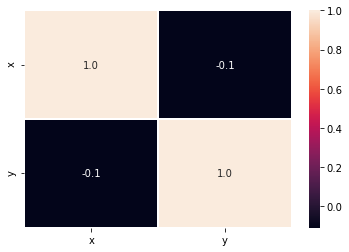

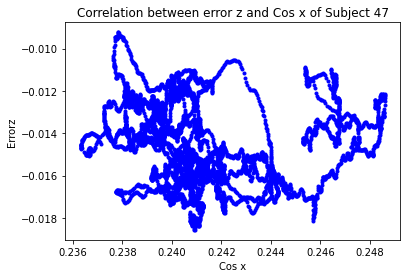

[[ 1.         -0.10972804]
 [-0.10972804  1.        ]]


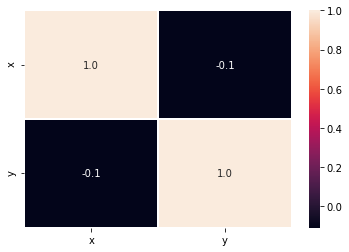

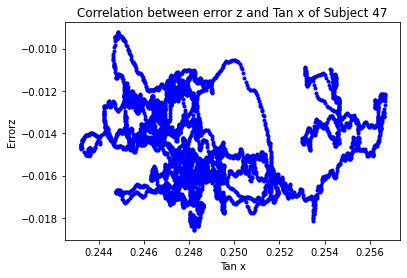

[[ 1.         -0.10927372]
 [-0.10927372  1.        ]]


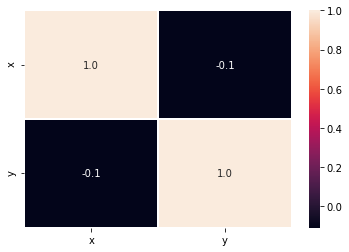

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


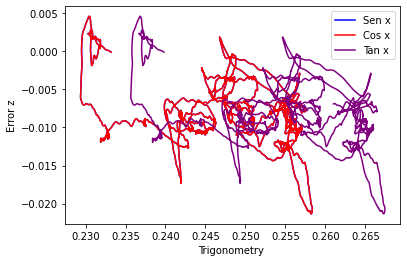

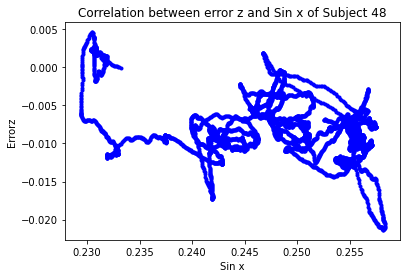

[[ 1.         -0.35143925]
 [-0.35143925  1.        ]]


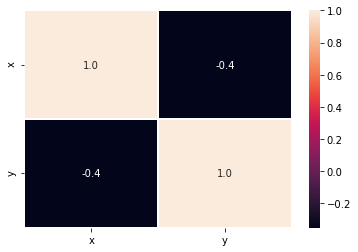

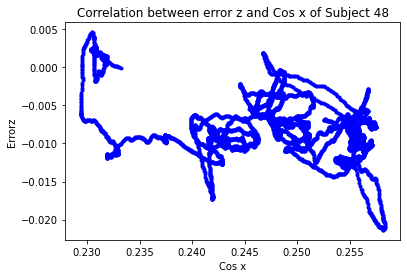

[[ 1.         -0.35143925]
 [-0.35143925  1.        ]]


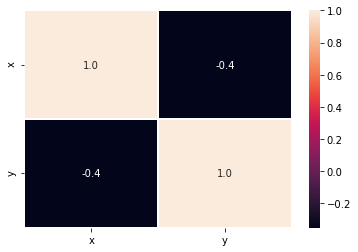

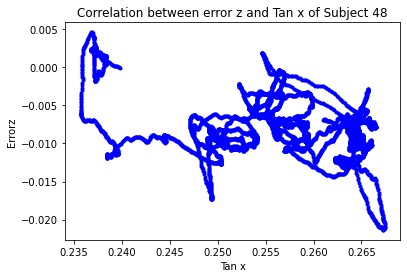

[[ 1.         -0.35128562]
 [-0.35128562  1.        ]]


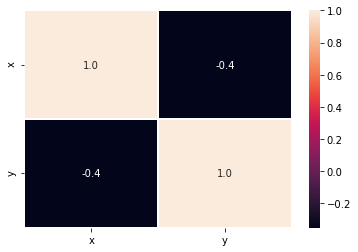

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


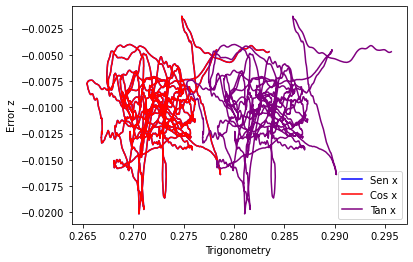

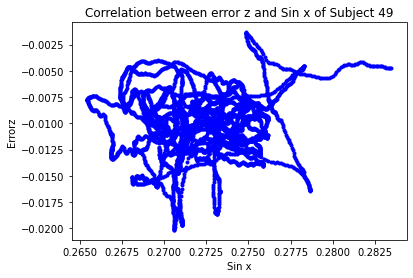

[[1.         0.09817977]
 [0.09817977 1.        ]]


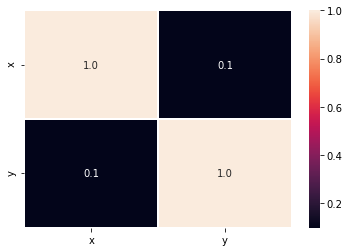

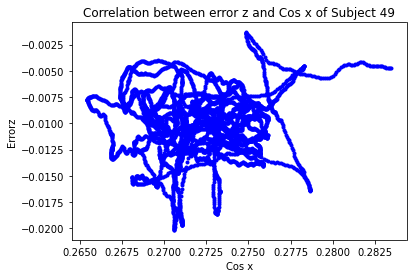

[[1.         0.09817977]
 [0.09817977 1.        ]]


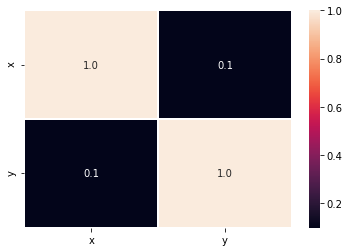

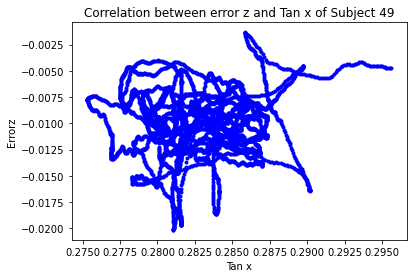

[[1.         0.09851587]
 [0.09851587 1.        ]]


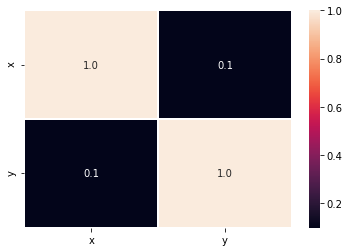

In [11]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(sinx[30:],errorz,color='blue',label='Sen x')
    plt.plot(cosx[30:],errorz,color='red',label='Cos x')
    plt.plot(tanx[30:],errorz,color='purple',label='Tan x')
    plt.xlabel("Trigonometry ")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()
    data={'x':sinx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Sin x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Sin x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(sinx[30:],errorz)
    print(r)
    plt.figure()
    data={'x':sinx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':cosx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Cos x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Cos x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(cosx[30:],errorz)
    print(r)
    plt.figure()
    data={'x':cosx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':tanx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Tan x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Tan x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(tanx[30:],errorz)
    print(r)
    plt.figure()
    data={'x':tanx[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between errorz and sen,cos and tan of z

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


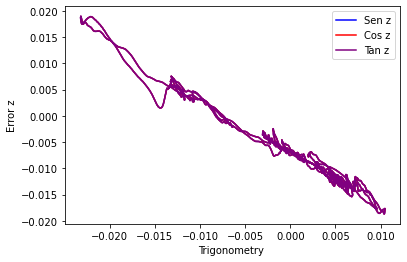

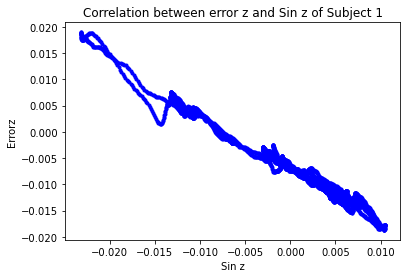

[[ 1.         -0.99246256]
 [-0.99246256  1.        ]]


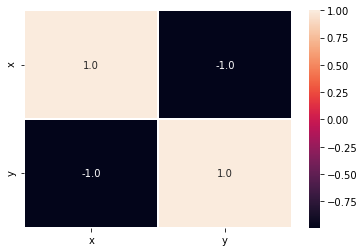

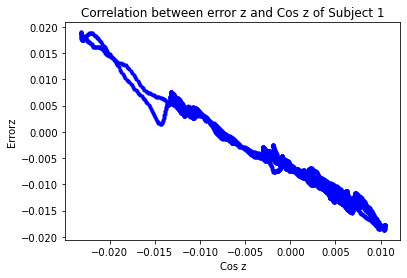

[[ 1.         -0.99246256]
 [-0.99246256  1.        ]]


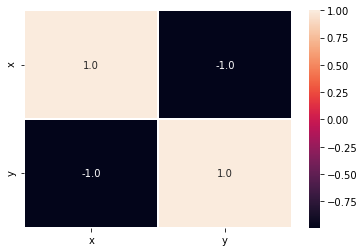

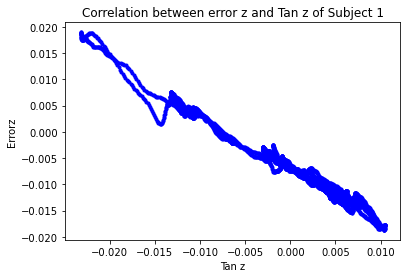

[[ 1.         -0.99246594]
 [-0.99246594  1.        ]]


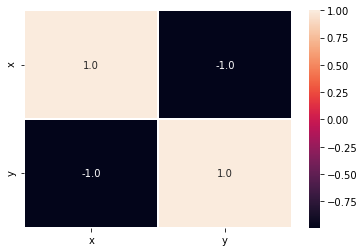

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


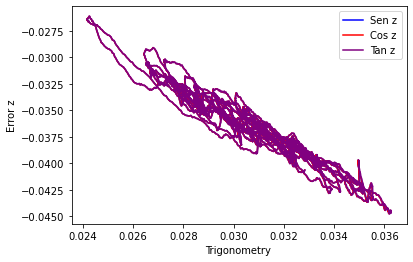

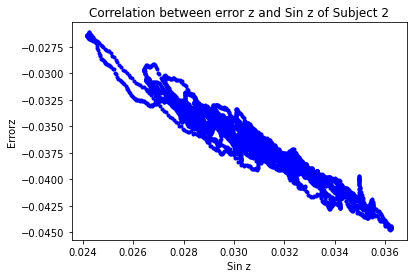

[[ 1.         -0.96765215]
 [-0.96765215  1.        ]]


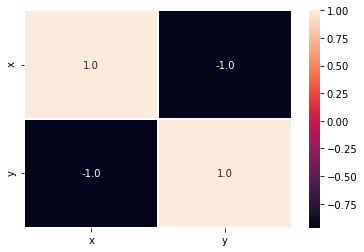

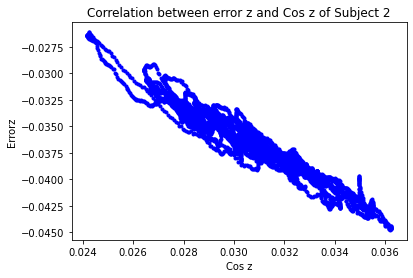

[[ 1.         -0.96765215]
 [-0.96765215  1.        ]]


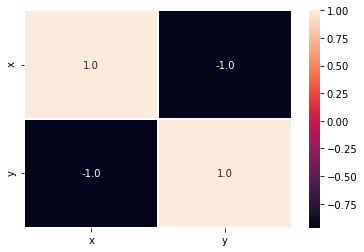

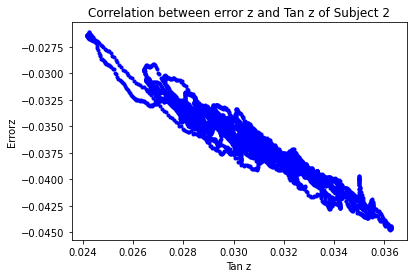

[[ 1.        -0.9676497]
 [-0.9676497  1.       ]]


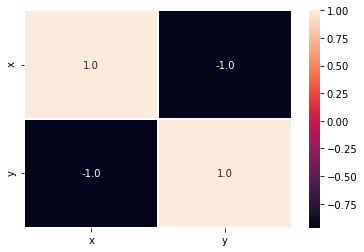

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


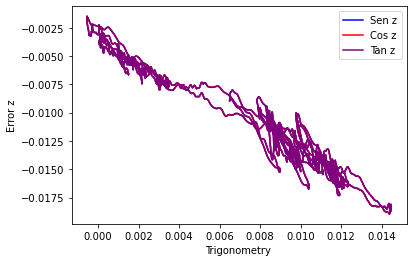

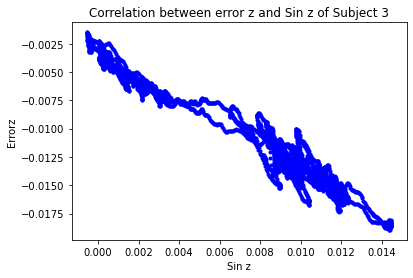

[[ 1.         -0.97900468]
 [-0.97900468  1.        ]]


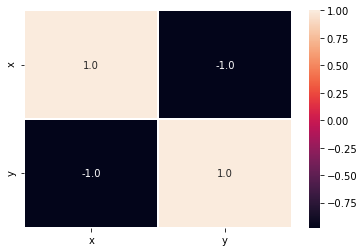

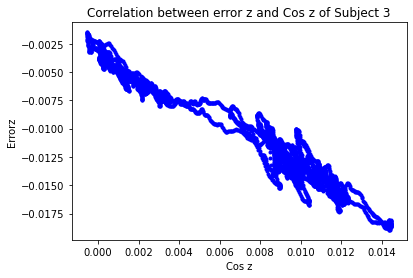

[[ 1.         -0.97900468]
 [-0.97900468  1.        ]]


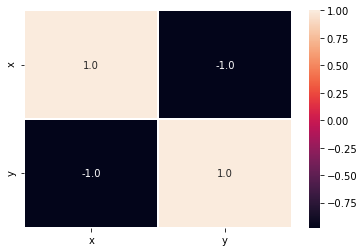

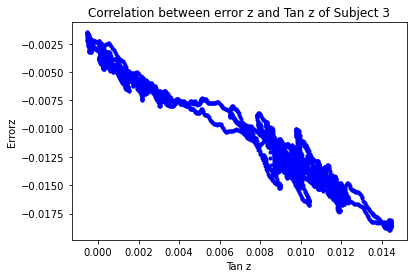

[[ 1.         -0.97900625]
 [-0.97900625  1.        ]]


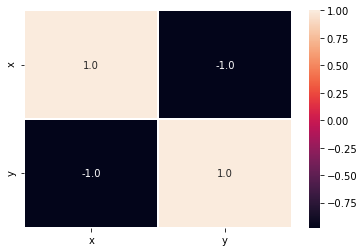

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


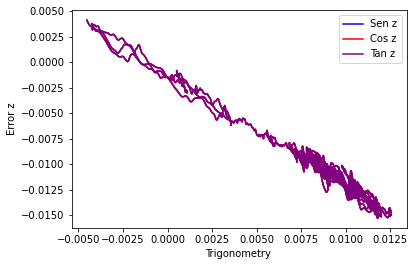

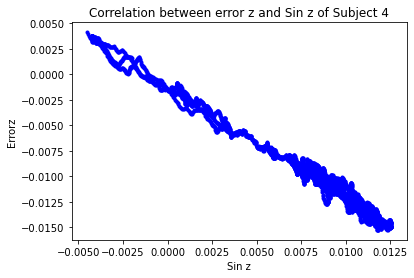

[[ 1.         -0.99196391]
 [-0.99196391  1.        ]]


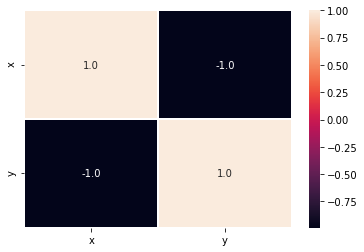

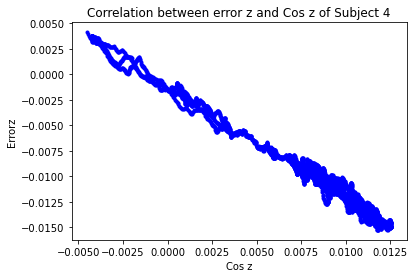

[[ 1.         -0.99196391]
 [-0.99196391  1.        ]]


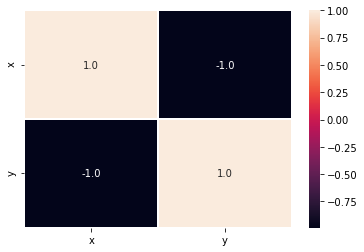

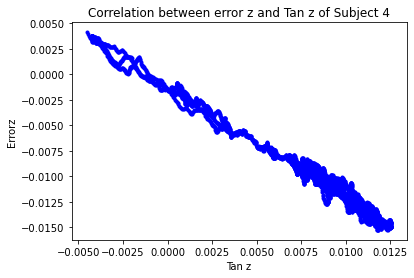

[[ 1.         -0.99196483]
 [-0.99196483  1.        ]]


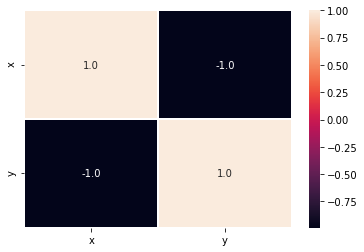

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


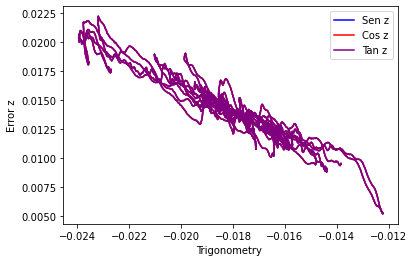

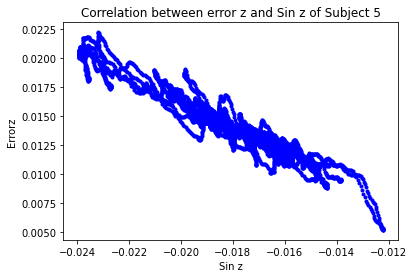

[[ 1.         -0.96213519]
 [-0.96213519  1.        ]]


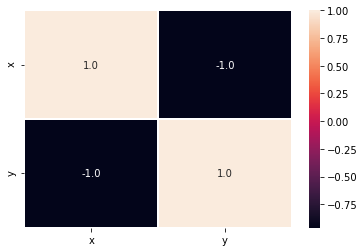

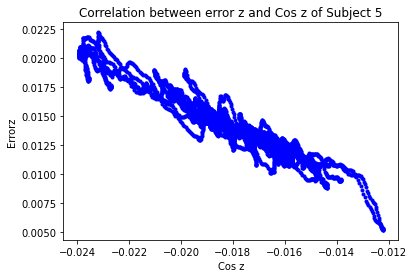

[[ 1.         -0.96213519]
 [-0.96213519  1.        ]]


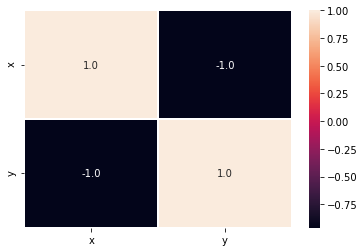

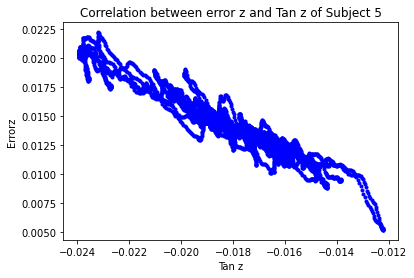

[[ 1.         -0.96213457]
 [-0.96213457  1.        ]]


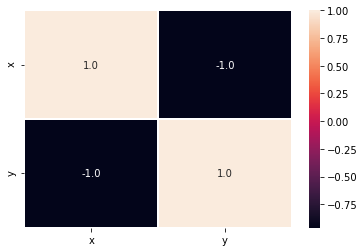

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


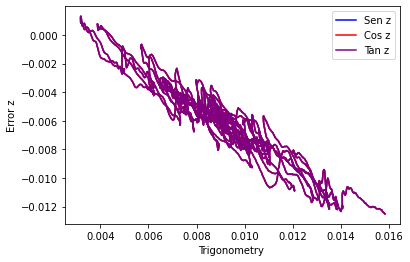

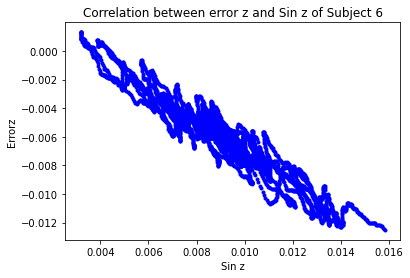

[[ 1.         -0.95844654]
 [-0.95844654  1.        ]]


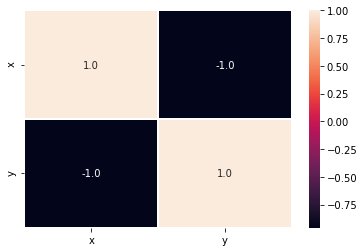

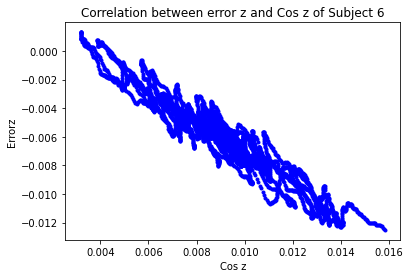

[[ 1.         -0.95844654]
 [-0.95844654  1.        ]]


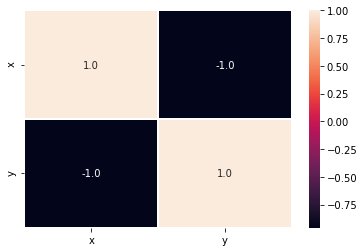

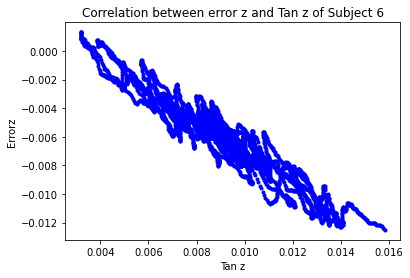

[[ 1.         -0.95844598]
 [-0.95844598  1.        ]]


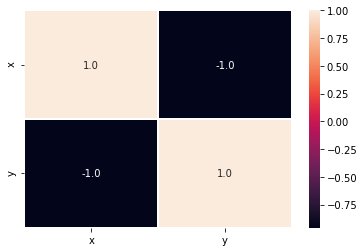

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


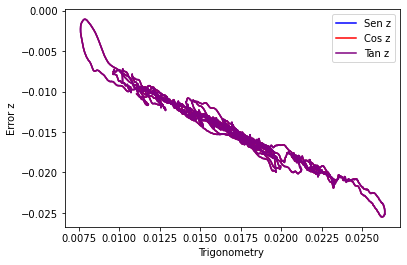

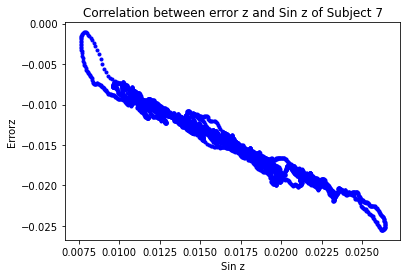

[[ 1.         -0.98433304]
 [-0.98433304  1.        ]]


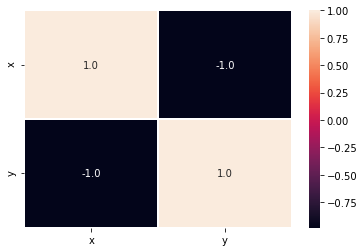

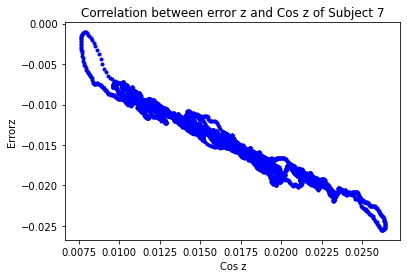

[[ 1.         -0.98433304]
 [-0.98433304  1.        ]]


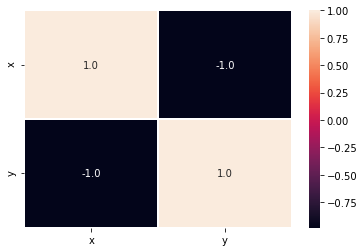

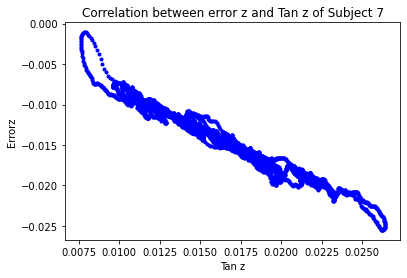

[[ 1.         -0.98432976]
 [-0.98432976  1.        ]]


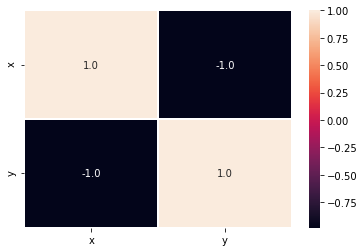

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


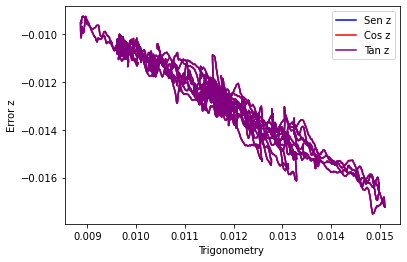

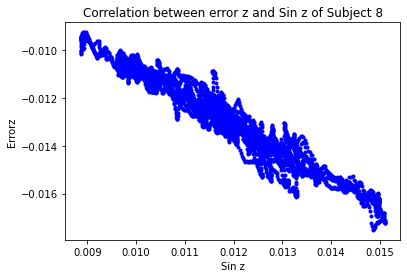

[[ 1.         -0.96871042]
 [-0.96871042  1.        ]]


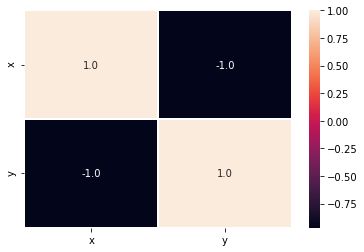

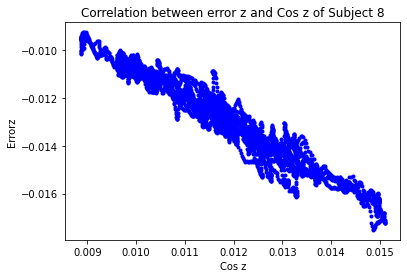

[[ 1.         -0.96871042]
 [-0.96871042  1.        ]]


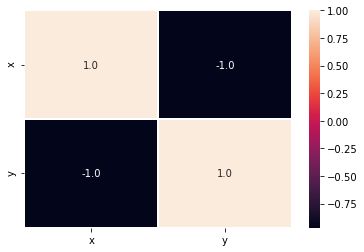

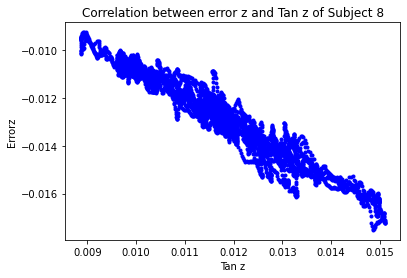

[[ 1.         -0.96871076]
 [-0.96871076  1.        ]]


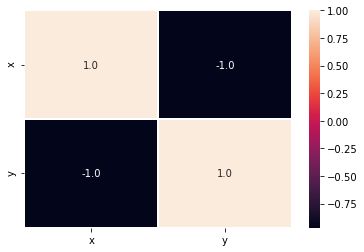

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


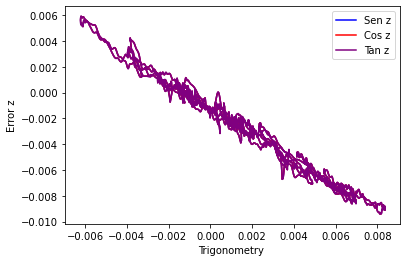

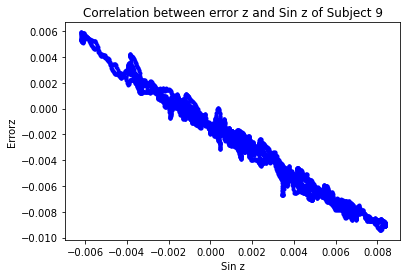

[[ 1.         -0.99081059]
 [-0.99081059  1.        ]]


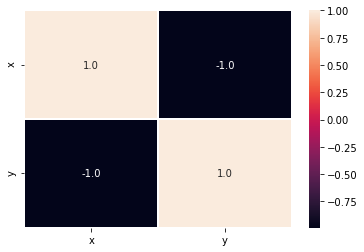

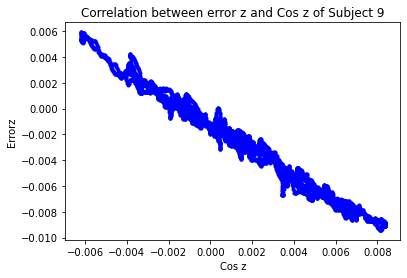

[[ 1.         -0.99081059]
 [-0.99081059  1.        ]]


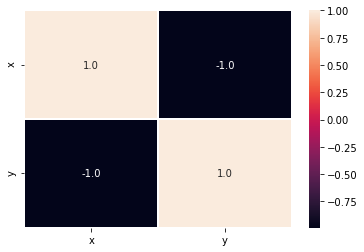

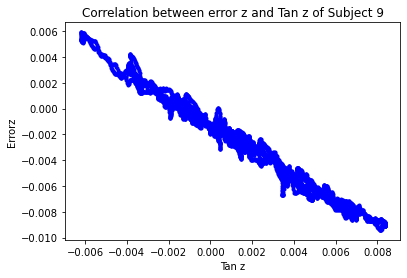

[[ 1.         -0.99081038]
 [-0.99081038  1.        ]]


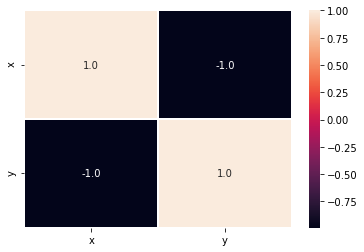

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


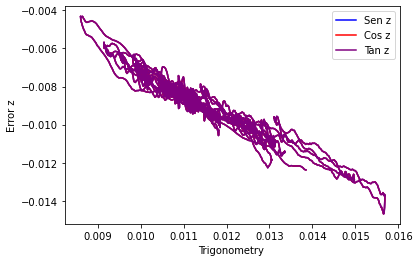

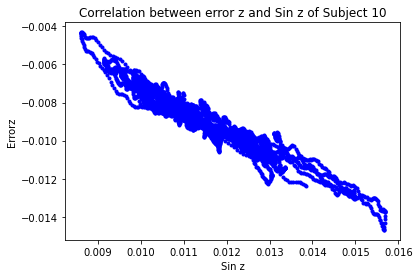

[[ 1.         -0.96551083]
 [-0.96551083  1.        ]]


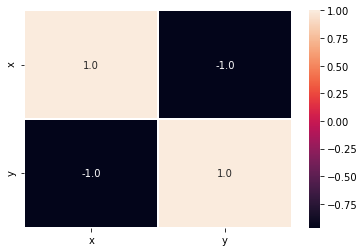

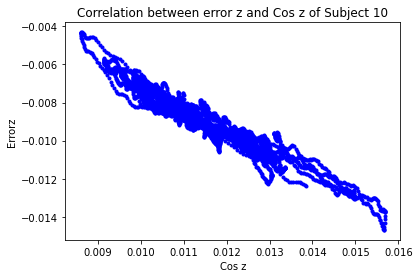

[[ 1.         -0.96551083]
 [-0.96551083  1.        ]]


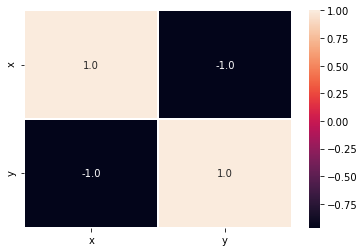

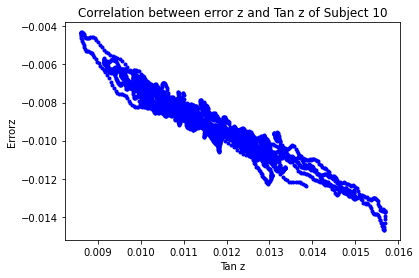

[[ 1.         -0.96550917]
 [-0.96550917  1.        ]]


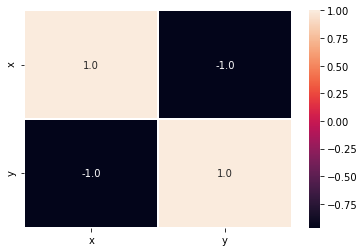

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


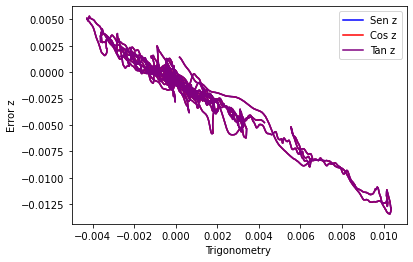

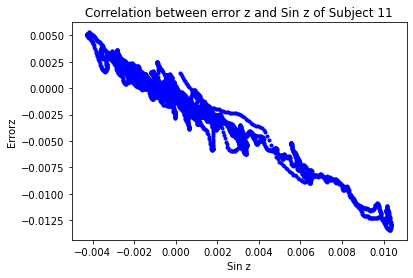

[[ 1.         -0.98116314]
 [-0.98116314  1.        ]]


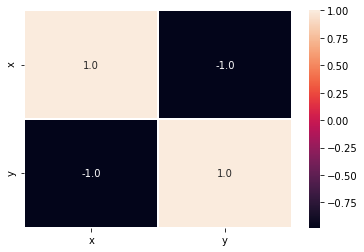

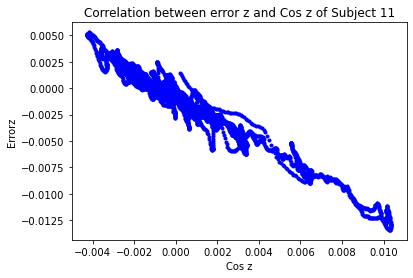

[[ 1.         -0.98116314]
 [-0.98116314  1.        ]]


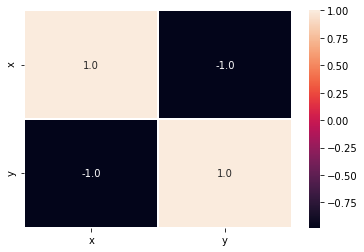

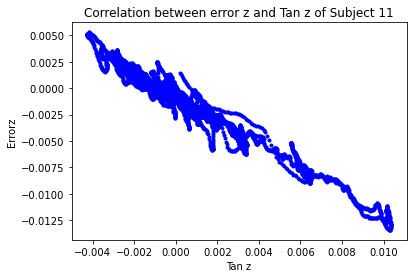

[[ 1.         -0.98116303]
 [-0.98116303  1.        ]]


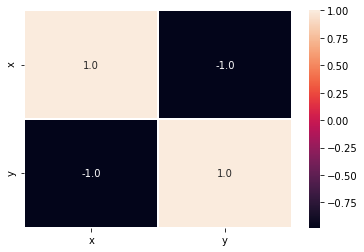

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


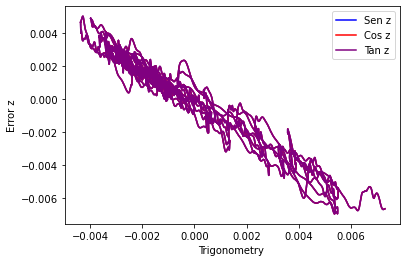

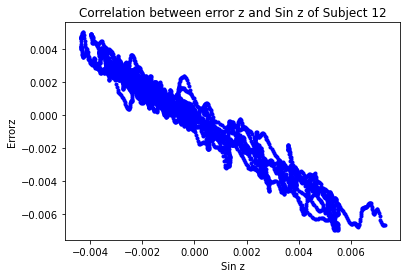

[[ 1.        -0.9765193]
 [-0.9765193  1.       ]]


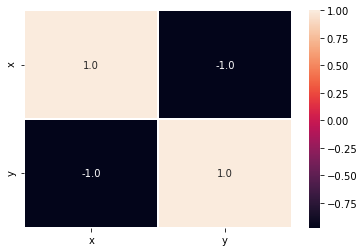

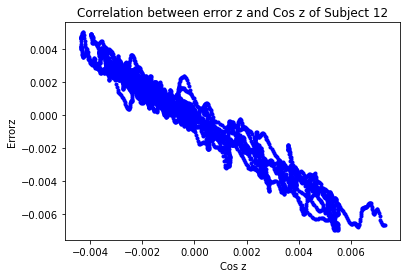

[[ 1.        -0.9765193]
 [-0.9765193  1.       ]]


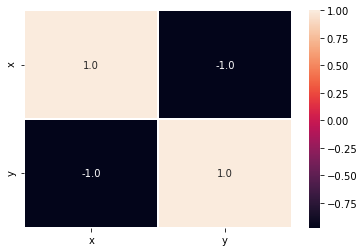

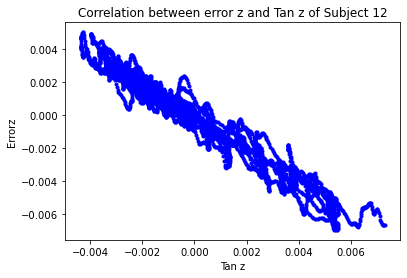

[[ 1.         -0.97651928]
 [-0.97651928  1.        ]]


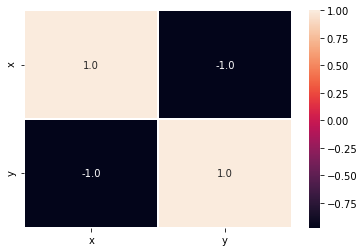

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


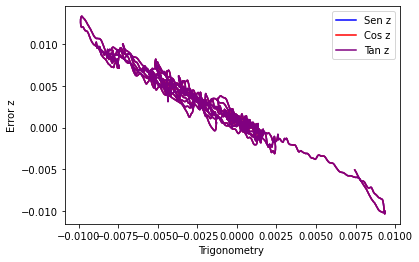

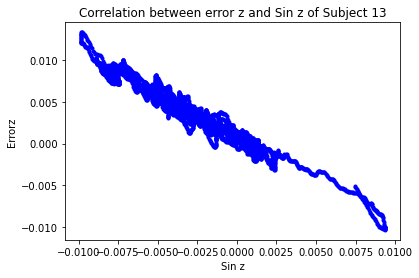

[[ 1.         -0.98140442]
 [-0.98140442  1.        ]]


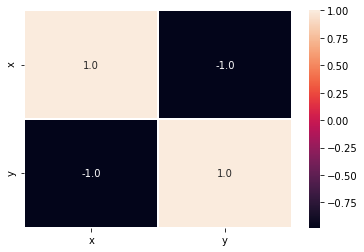

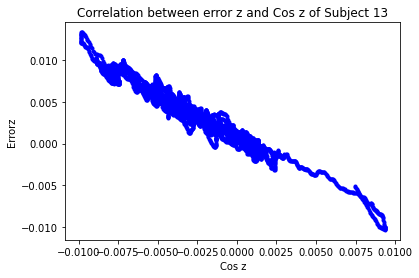

[[ 1.         -0.98140442]
 [-0.98140442  1.        ]]


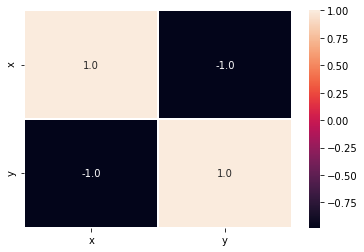

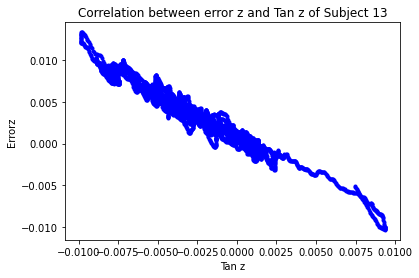

[[ 1.         -0.98140476]
 [-0.98140476  1.        ]]


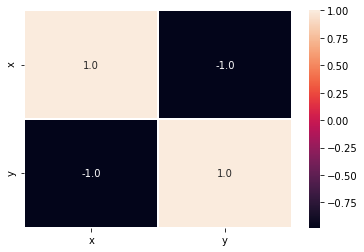

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


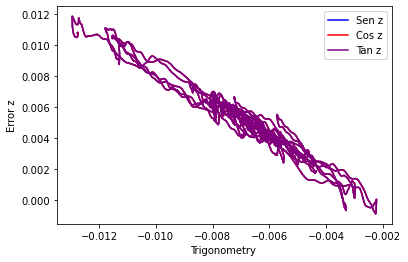

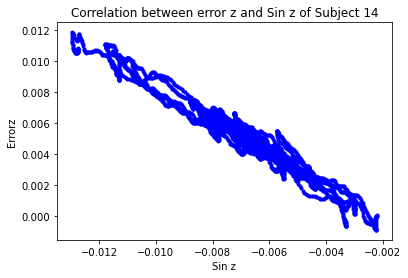

[[ 1.         -0.97821683]
 [-0.97821683  1.        ]]


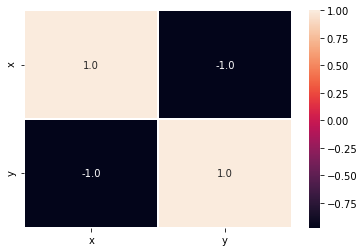

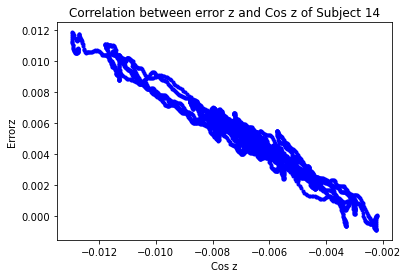

[[ 1.         -0.97821683]
 [-0.97821683  1.        ]]


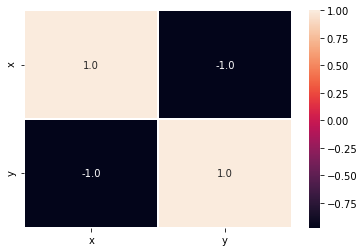

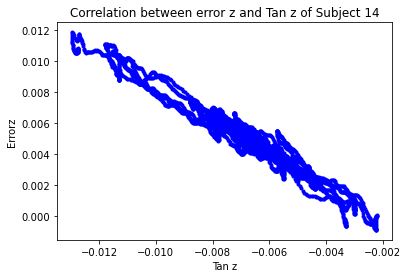

[[ 1.         -0.97821558]
 [-0.97821558  1.        ]]


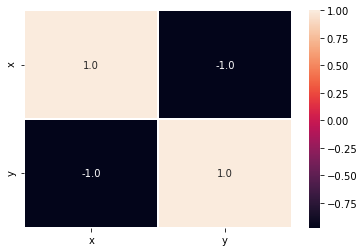

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


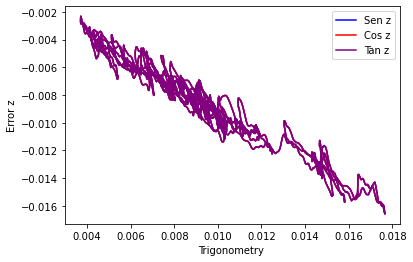

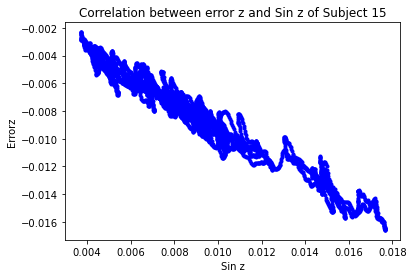

[[ 1.         -0.97576882]
 [-0.97576882  1.        ]]


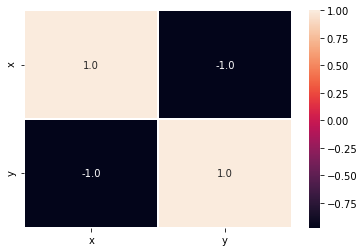

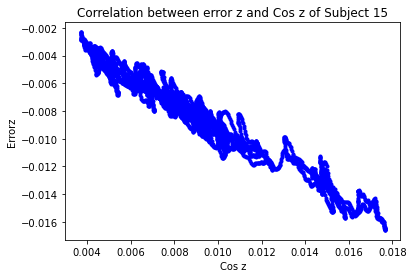

[[ 1.         -0.97576882]
 [-0.97576882  1.        ]]


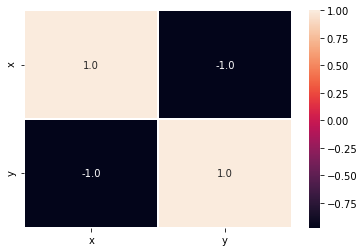

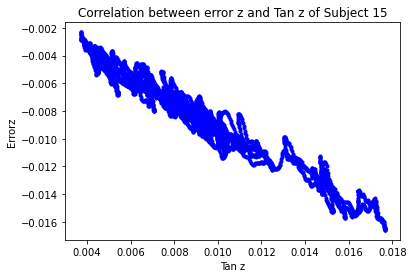

[[ 1.         -0.97576671]
 [-0.97576671  1.        ]]


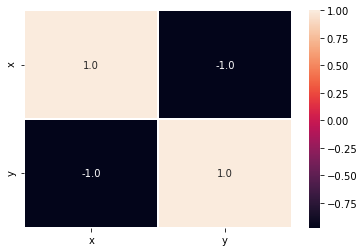

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


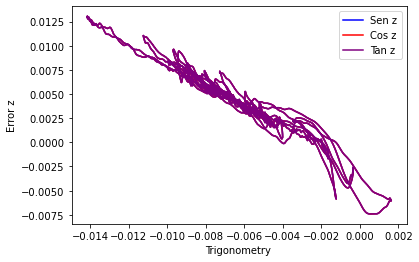

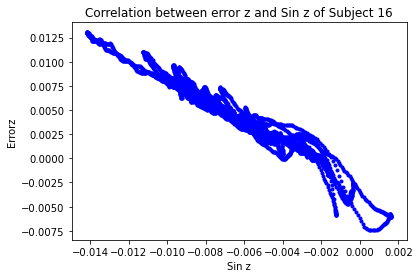

[[ 1.         -0.97370937]
 [-0.97370937  1.        ]]


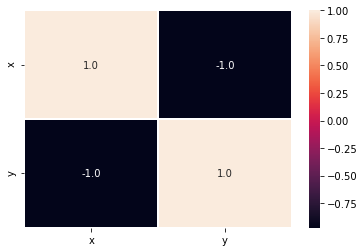

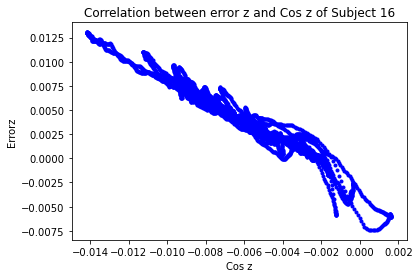

[[ 1.         -0.97370937]
 [-0.97370937  1.        ]]


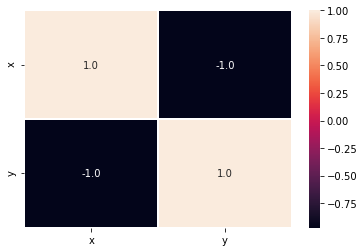

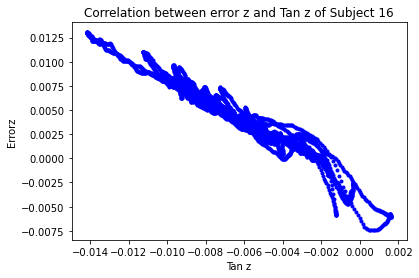

[[ 1.         -0.97370772]
 [-0.97370772  1.        ]]


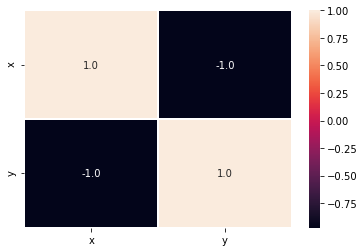

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


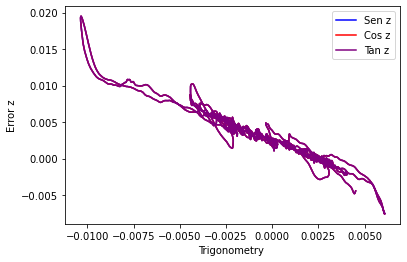

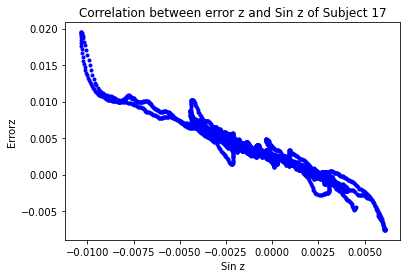

[[ 1.         -0.97439759]
 [-0.97439759  1.        ]]


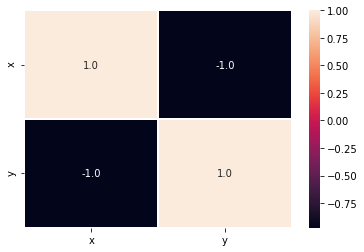

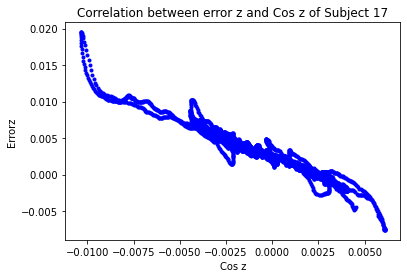

[[ 1.         -0.97439759]
 [-0.97439759  1.        ]]


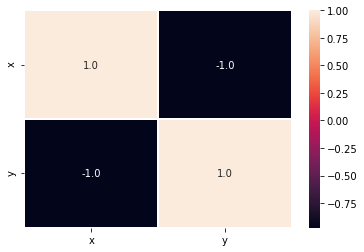

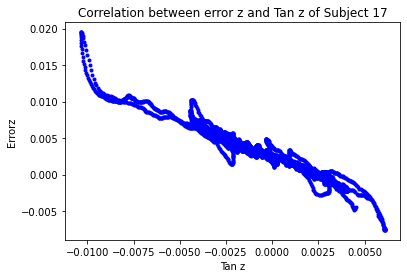

[[ 1.         -0.97439833]
 [-0.97439833  1.        ]]


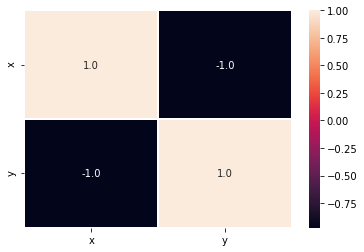

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


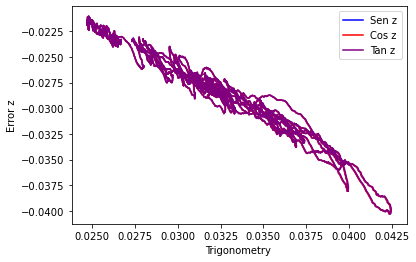

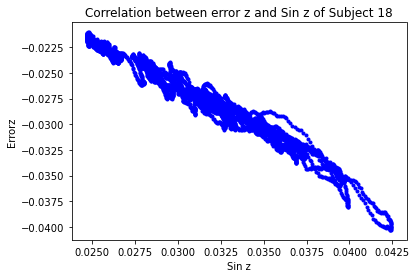

[[ 1.         -0.98245549]
 [-0.98245549  1.        ]]


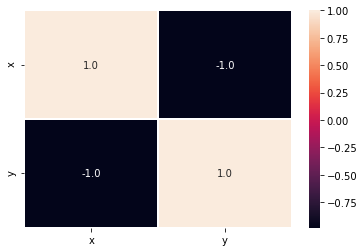

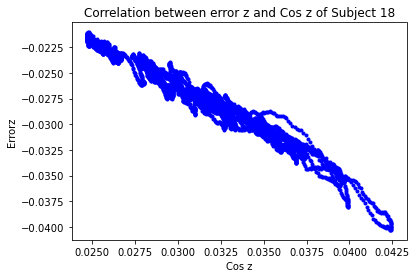

[[ 1.         -0.98245549]
 [-0.98245549  1.        ]]


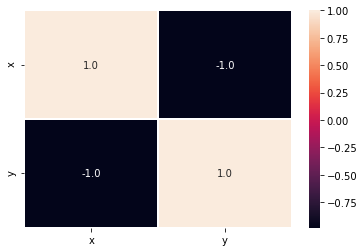

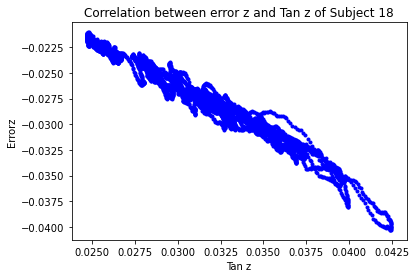

[[ 1.         -0.98246893]
 [-0.98246893  1.        ]]


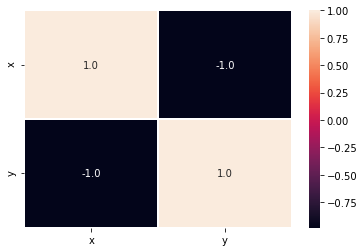

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


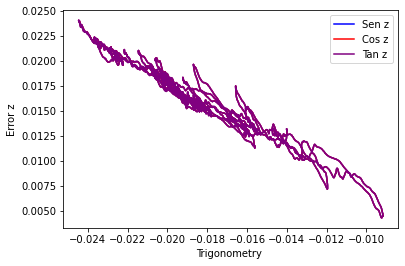

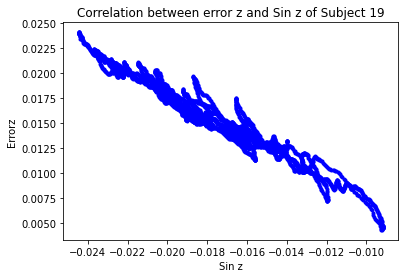

[[ 1.         -0.97500407]
 [-0.97500407  1.        ]]


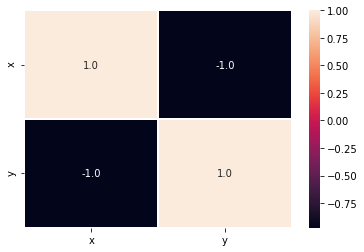

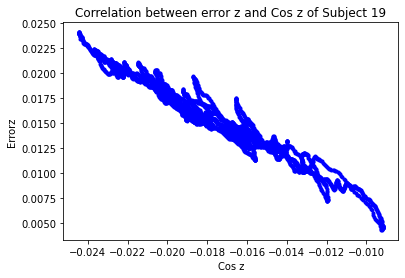

[[ 1.         -0.97500407]
 [-0.97500407  1.        ]]


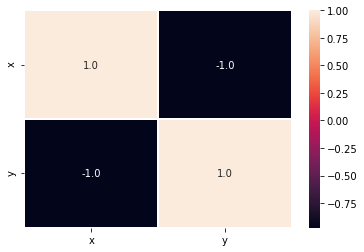

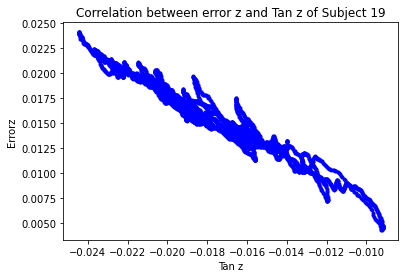

[[ 1.        -0.9750082]
 [-0.9750082  1.       ]]


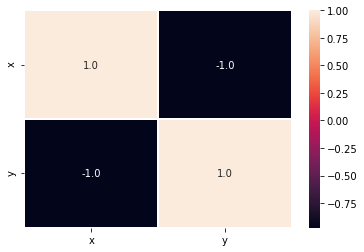

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


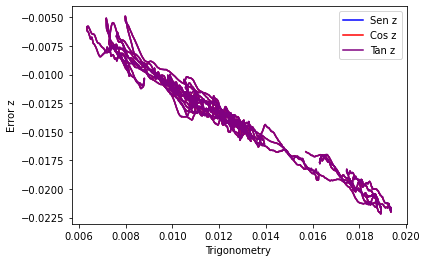

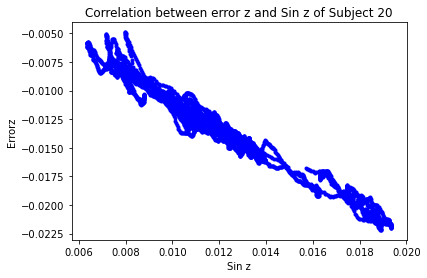

[[ 1.         -0.98338309]
 [-0.98338309  1.        ]]


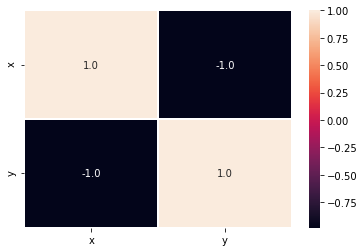

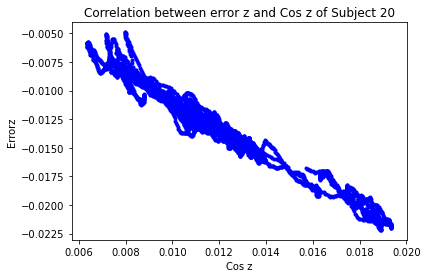

[[ 1.         -0.98338309]
 [-0.98338309  1.        ]]


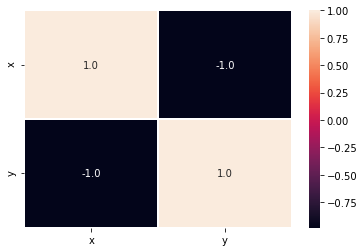

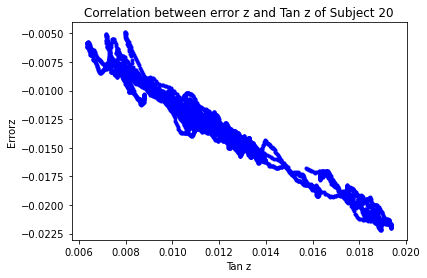

[[ 1.         -0.98337936]
 [-0.98337936  1.        ]]


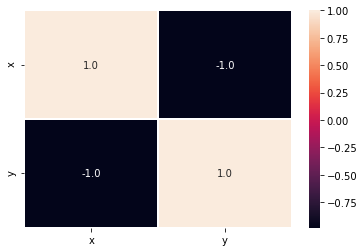

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


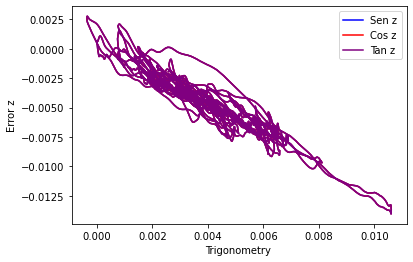

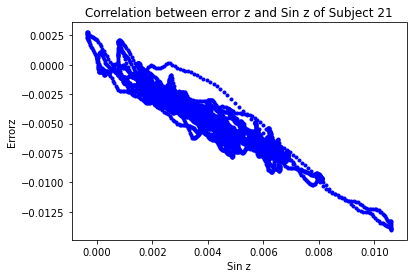

[[ 1.         -0.95236665]
 [-0.95236665  1.        ]]


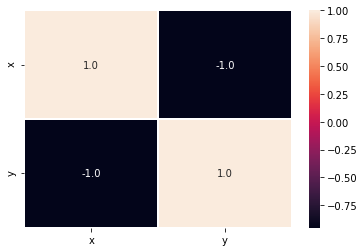

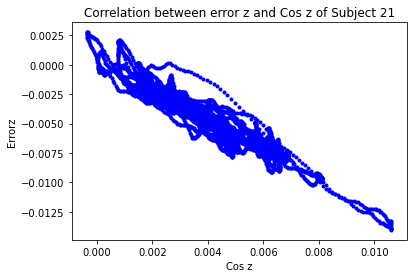

[[ 1.         -0.95236665]
 [-0.95236665  1.        ]]


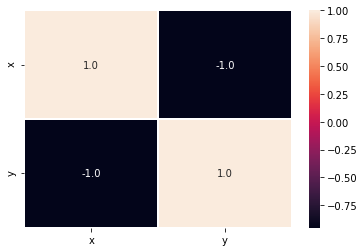

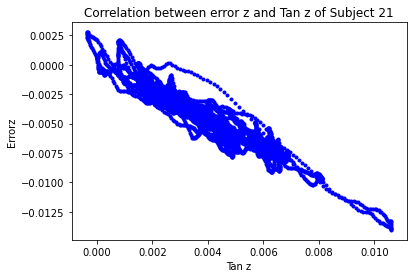

[[ 1.         -0.95236687]
 [-0.95236687  1.        ]]


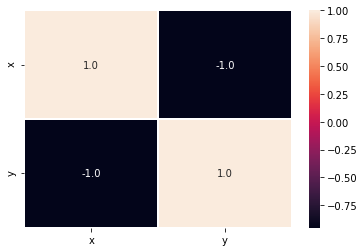

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


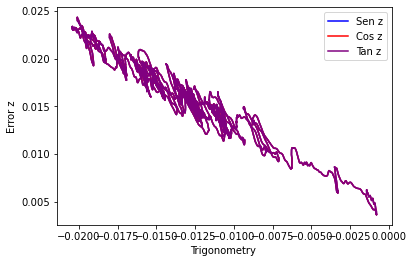

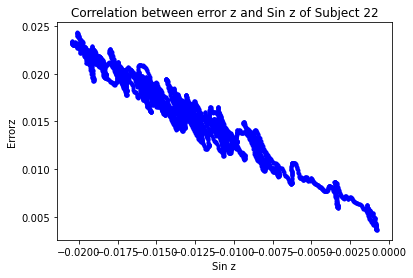

[[ 1.         -0.97284031]
 [-0.97284031  1.        ]]


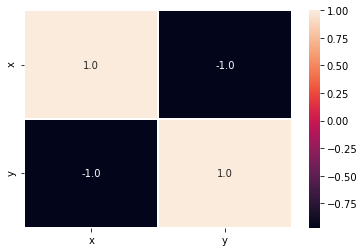

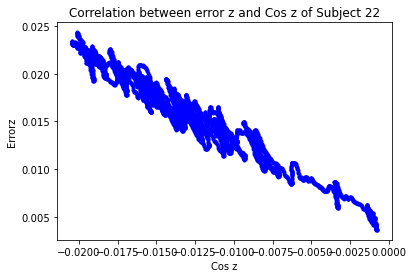

[[ 1.         -0.97284031]
 [-0.97284031  1.        ]]


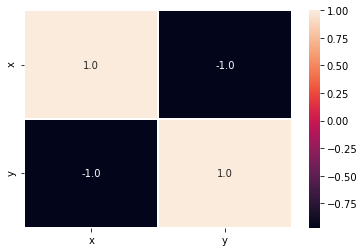

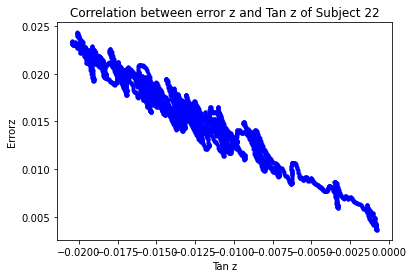

[[ 1.         -0.97284429]
 [-0.97284429  1.        ]]


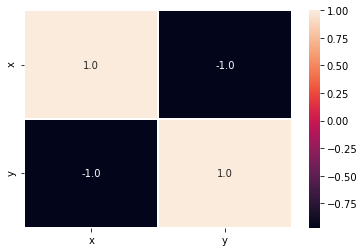

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


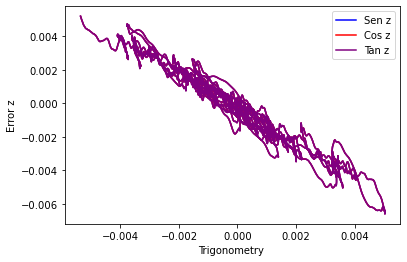

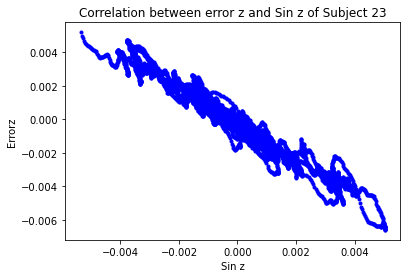

[[ 1.        -0.9791966]
 [-0.9791966  1.       ]]


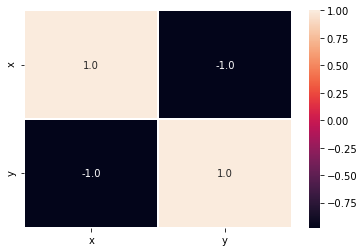

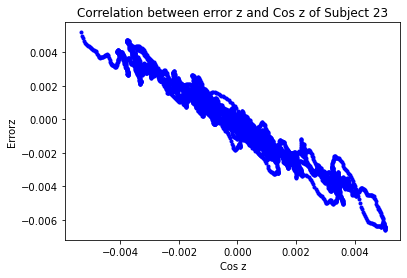

[[ 1.        -0.9791966]
 [-0.9791966  1.       ]]


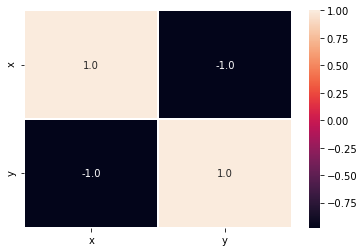

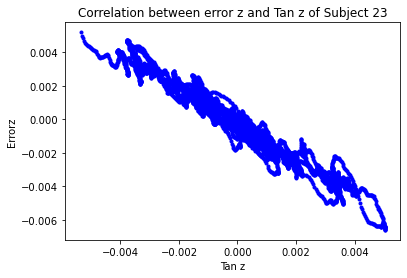

[[ 1.         -0.97919652]
 [-0.97919652  1.        ]]


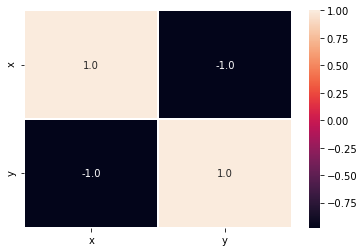

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


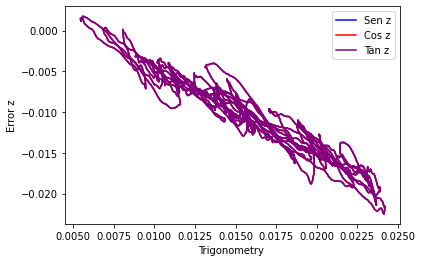

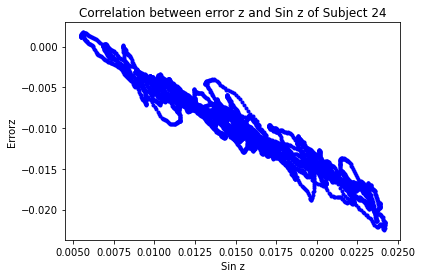

[[ 1.         -0.97046722]
 [-0.97046722  1.        ]]


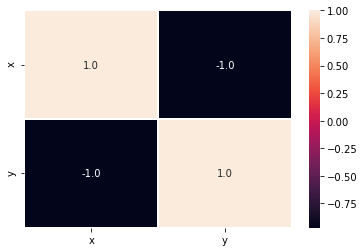

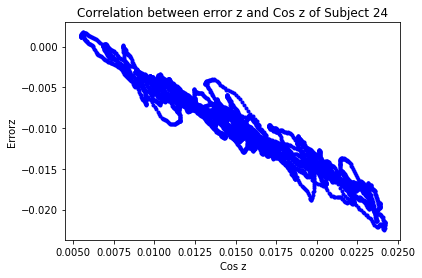

[[ 1.         -0.97046722]
 [-0.97046722  1.        ]]


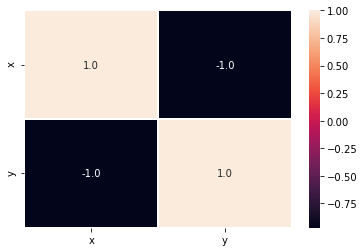

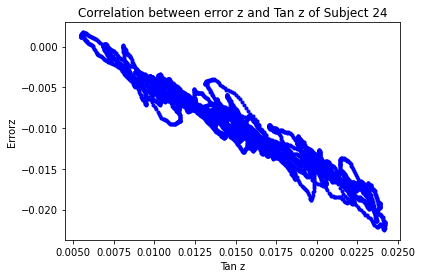

[[ 1.         -0.97046776]
 [-0.97046776  1.        ]]


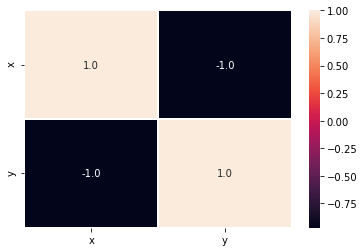

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


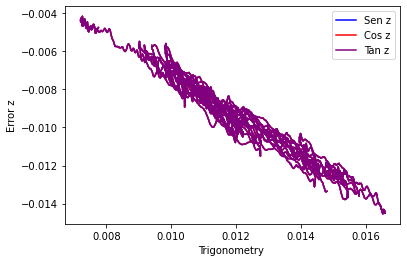

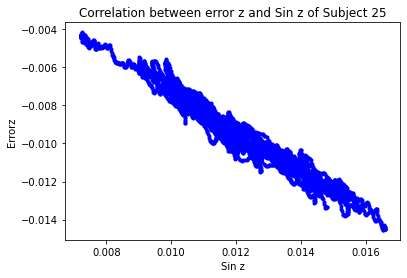

[[ 1.         -0.97984675]
 [-0.97984675  1.        ]]


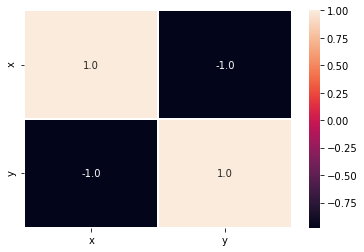

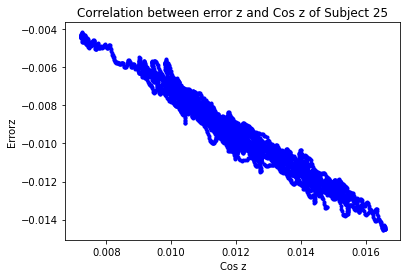

[[ 1.         -0.97984675]
 [-0.97984675  1.        ]]


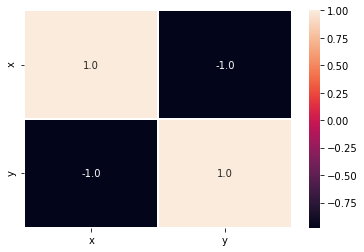

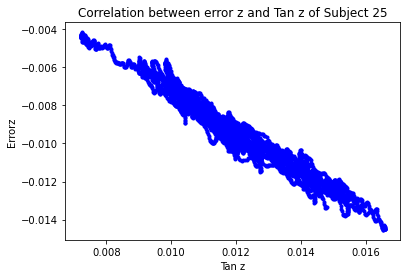

[[ 1.        -0.9798452]
 [-0.9798452  1.       ]]


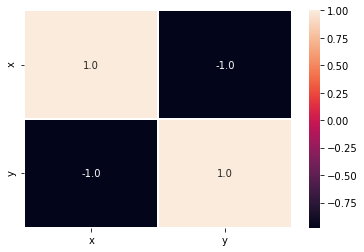

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


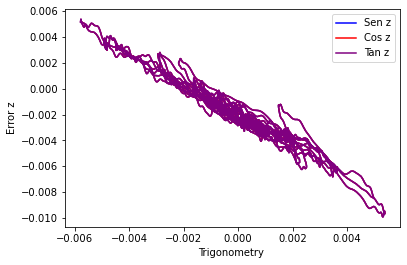

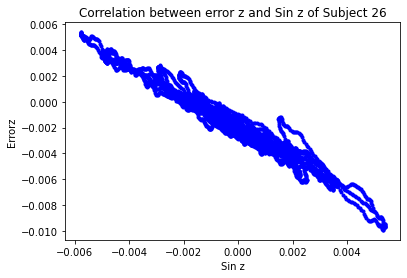

[[ 1.         -0.98014935]
 [-0.98014935  1.        ]]


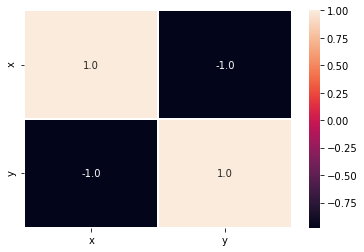

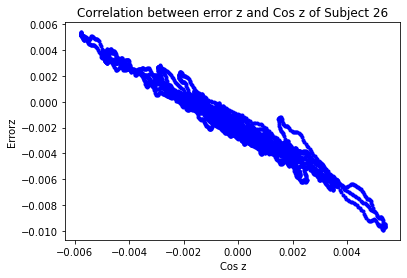

[[ 1.         -0.98014935]
 [-0.98014935  1.        ]]


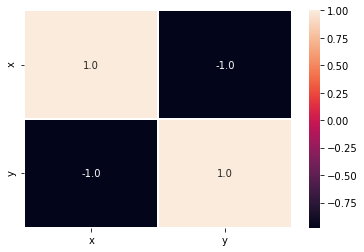

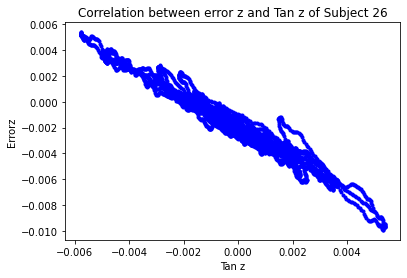

[[ 1.         -0.98014947]
 [-0.98014947  1.        ]]


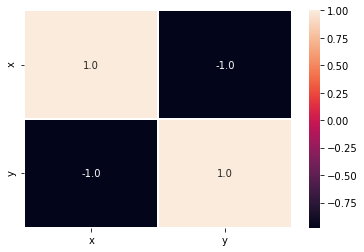

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


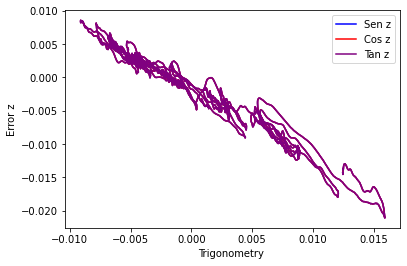

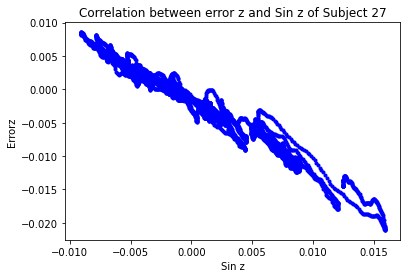

[[ 1.         -0.98478091]
 [-0.98478091  1.        ]]


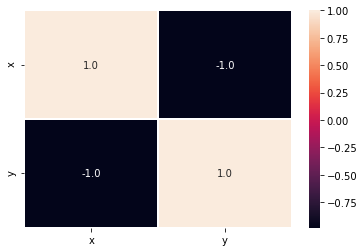

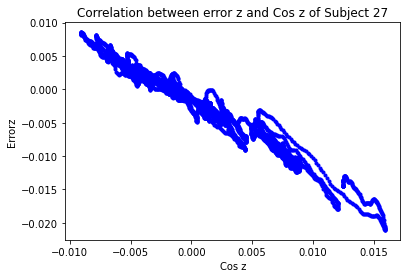

[[ 1.         -0.98478091]
 [-0.98478091  1.        ]]


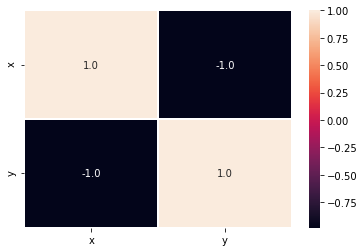

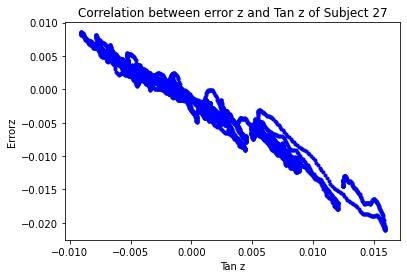

[[ 1.         -0.98478254]
 [-0.98478254  1.        ]]


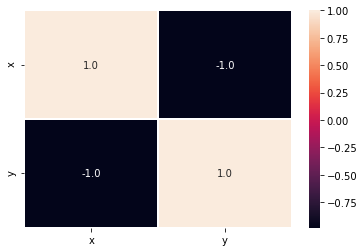

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


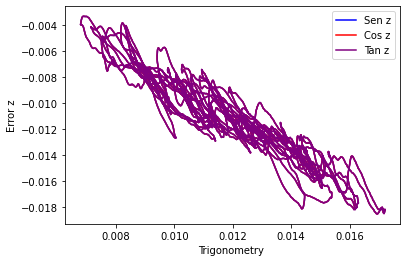

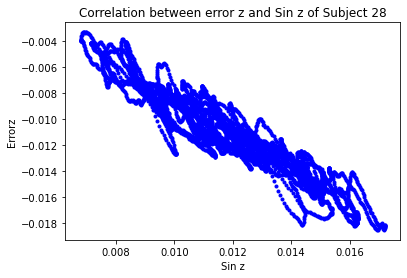

[[ 1.         -0.94109043]
 [-0.94109043  1.        ]]


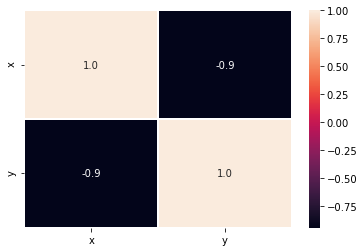

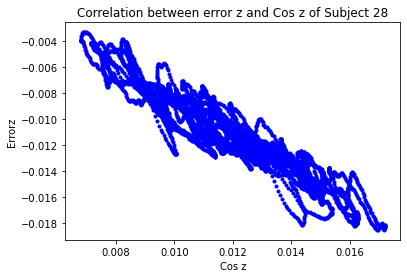

[[ 1.         -0.94109043]
 [-0.94109043  1.        ]]


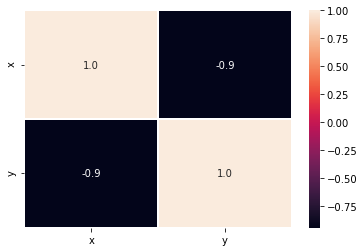

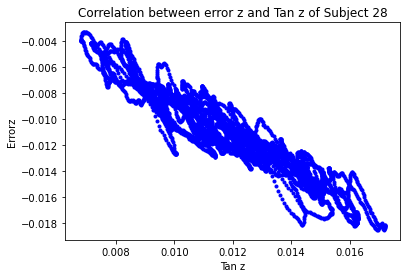

[[ 1.         -0.94108954]
 [-0.94108954  1.        ]]


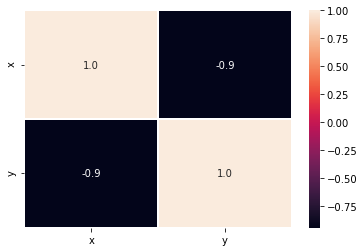

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


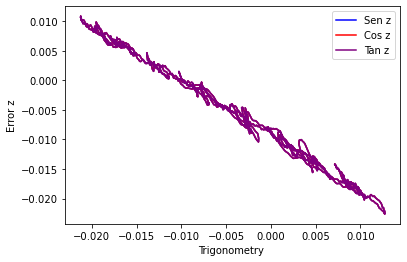

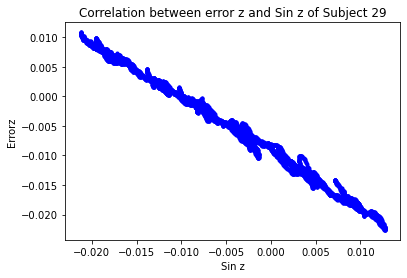

[[ 1.         -0.99716514]
 [-0.99716514  1.        ]]


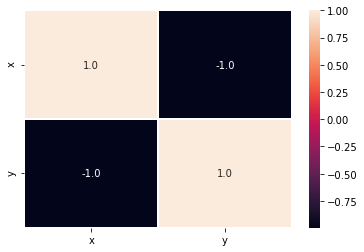

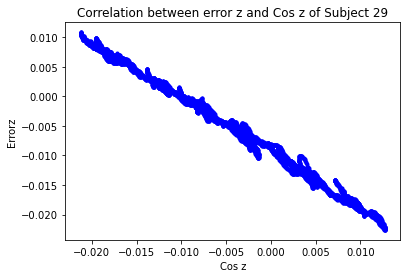

[[ 1.         -0.99716514]
 [-0.99716514  1.        ]]


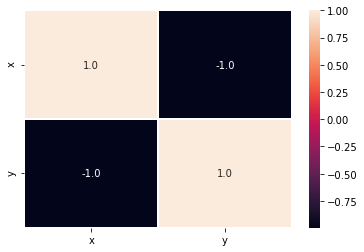

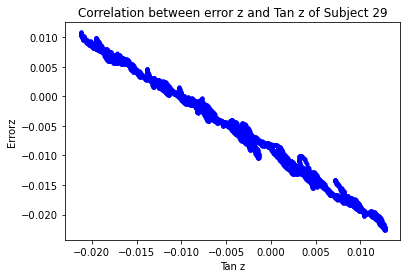

[[ 1.         -0.99716449]
 [-0.99716449  1.        ]]


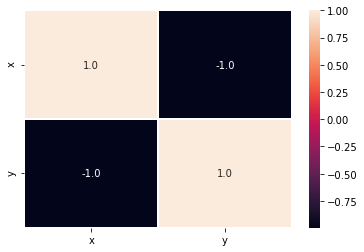

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


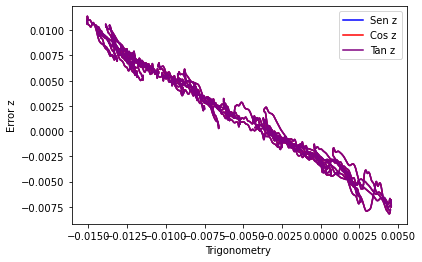

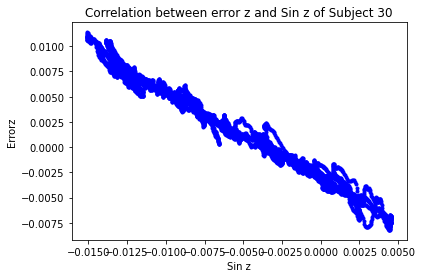

[[ 1.         -0.99061167]
 [-0.99061167  1.        ]]


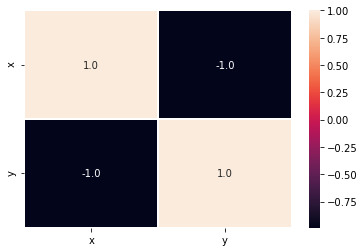

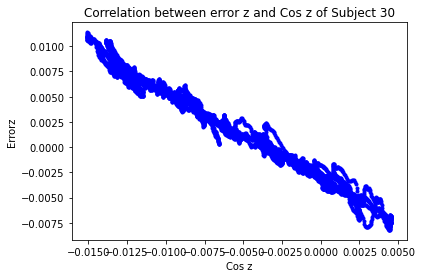

[[ 1.         -0.99061167]
 [-0.99061167  1.        ]]


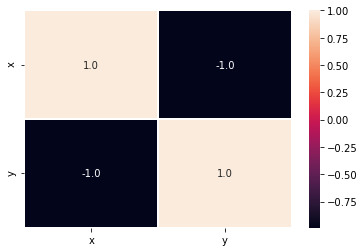

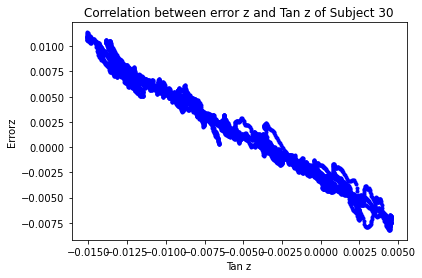

[[ 1.         -0.99061219]
 [-0.99061219  1.        ]]


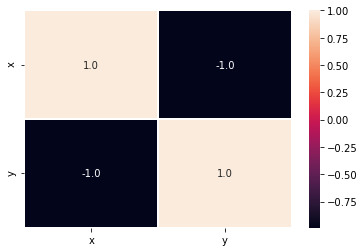

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


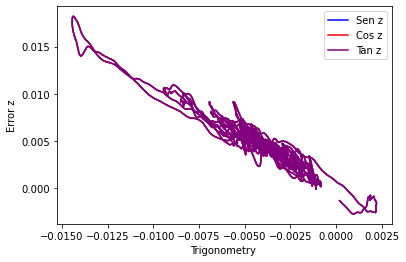

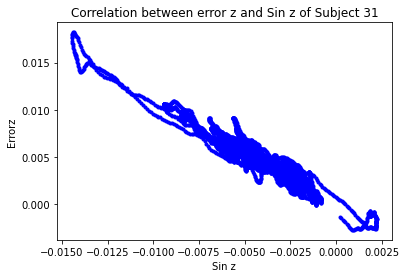

[[ 1.         -0.96430206]
 [-0.96430206  1.        ]]


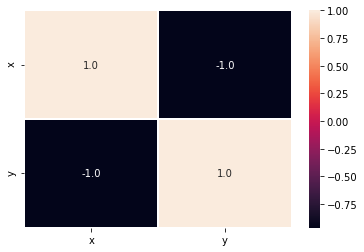

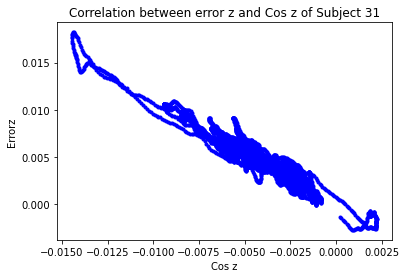

[[ 1.         -0.96430206]
 [-0.96430206  1.        ]]


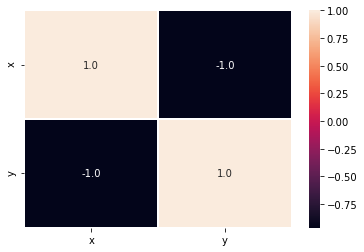

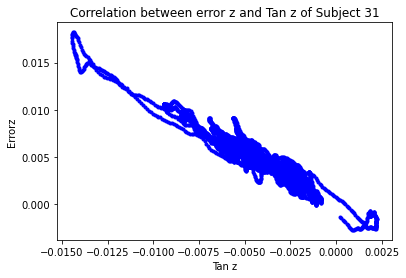

[[ 1.         -0.96430283]
 [-0.96430283  1.        ]]


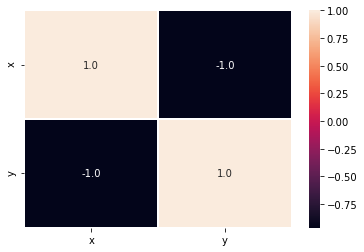

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


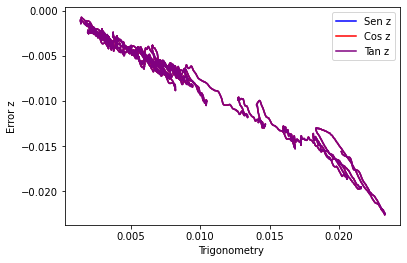

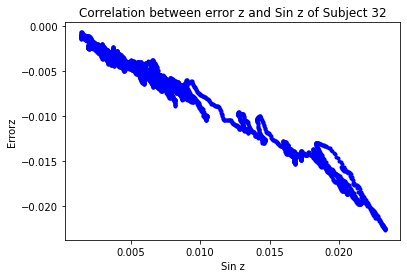

[[ 1.         -0.98905319]
 [-0.98905319  1.        ]]


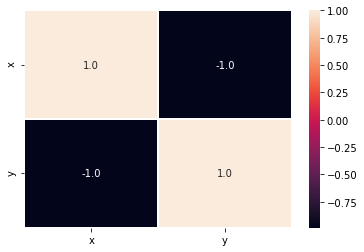

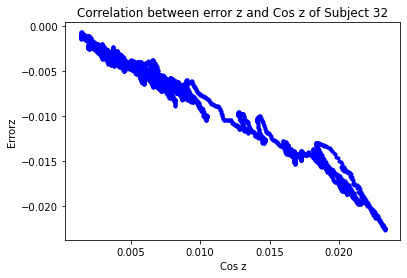

[[ 1.         -0.98905319]
 [-0.98905319  1.        ]]


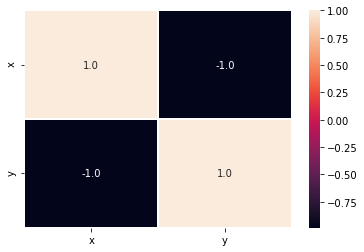

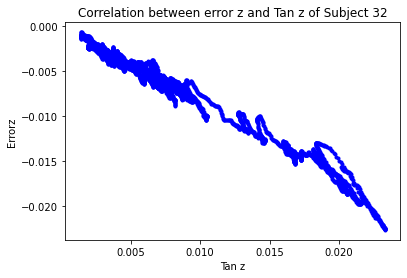

[[ 1.         -0.98905738]
 [-0.98905738  1.        ]]


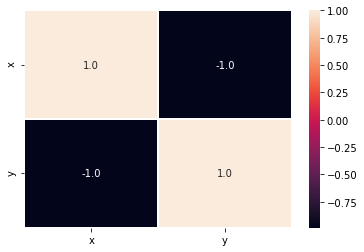

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


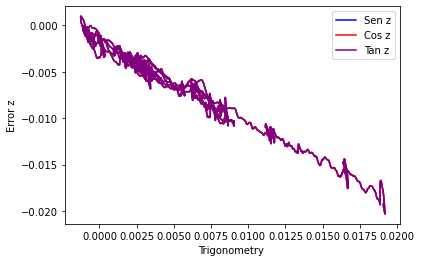

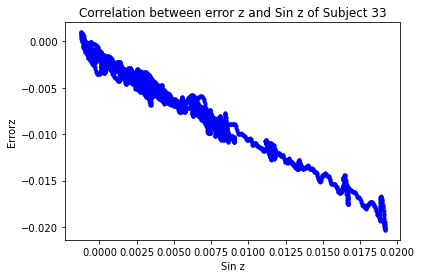

[[ 1.         -0.98988428]
 [-0.98988428  1.        ]]


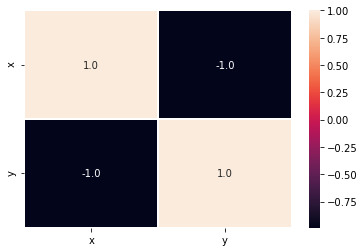

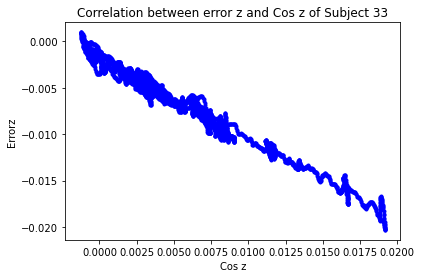

[[ 1.         -0.98988428]
 [-0.98988428  1.        ]]


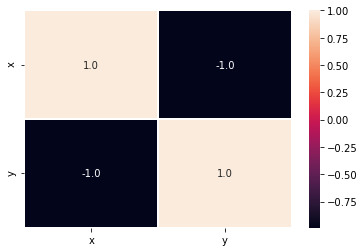

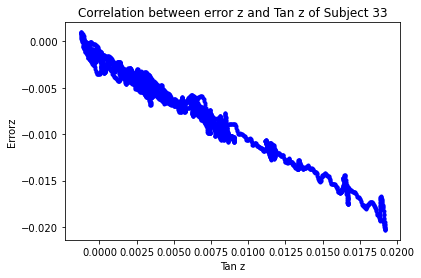

[[ 1.         -0.98988323]
 [-0.98988323  1.        ]]


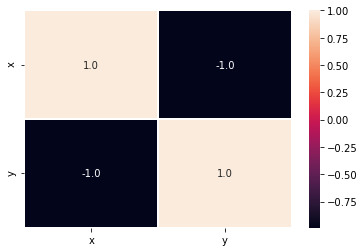

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


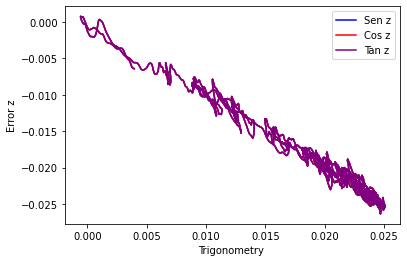

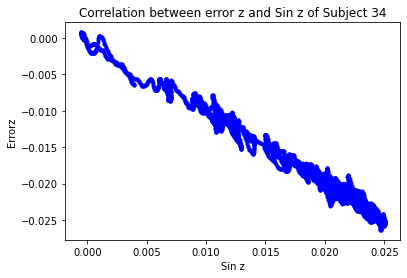

[[ 1.         -0.99138356]
 [-0.99138356  1.        ]]


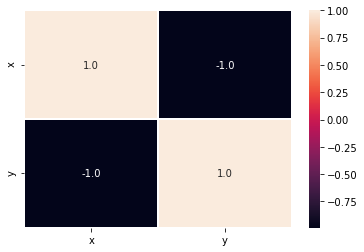

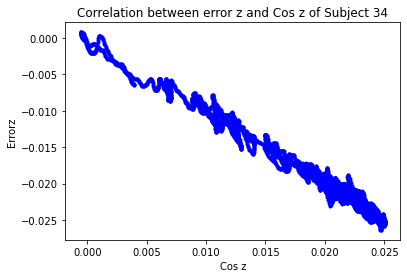

[[ 1.         -0.99138356]
 [-0.99138356  1.        ]]


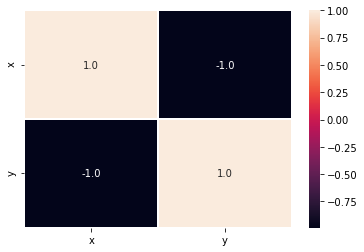

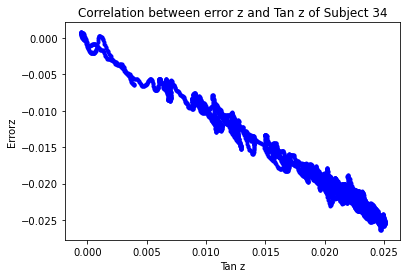

[[ 1.        -0.9913866]
 [-0.9913866  1.       ]]


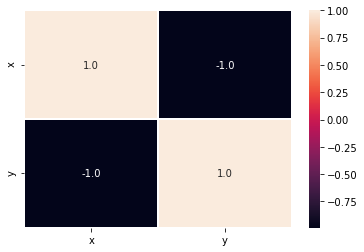

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


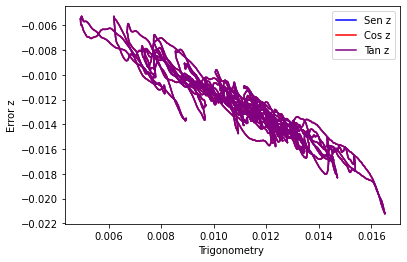

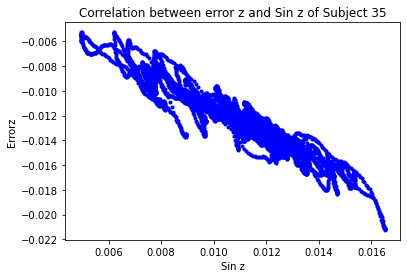

[[ 1.         -0.94972271]
 [-0.94972271  1.        ]]


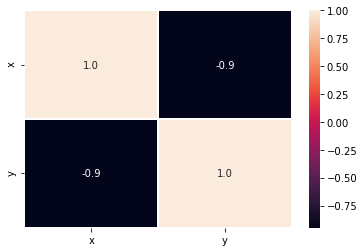

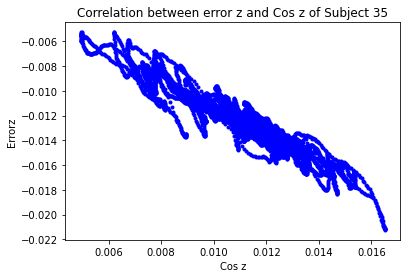

[[ 1.         -0.94972271]
 [-0.94972271  1.        ]]


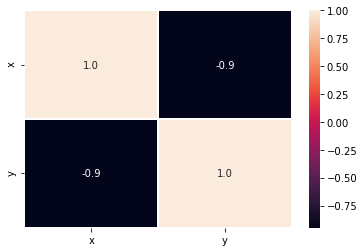

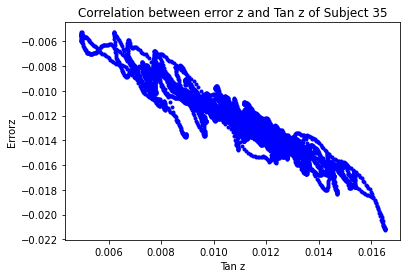

[[ 1.         -0.94972391]
 [-0.94972391  1.        ]]


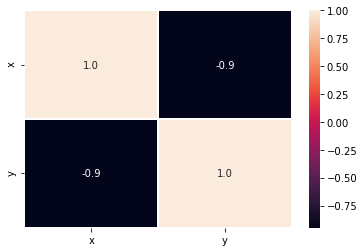

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


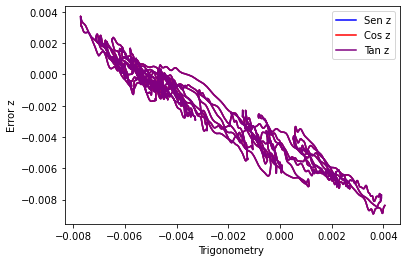

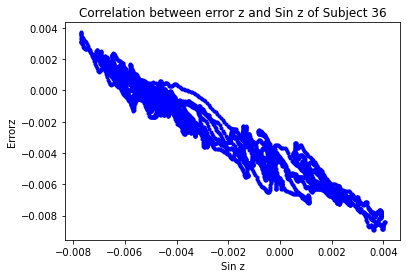

[[ 1.         -0.97495976]
 [-0.97495976  1.        ]]


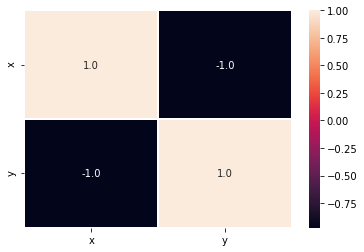

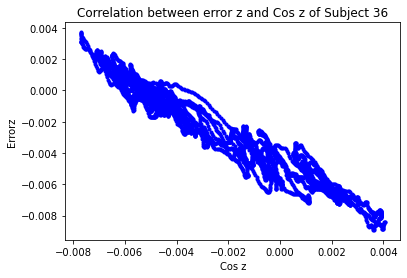

[[ 1.         -0.97495976]
 [-0.97495976  1.        ]]


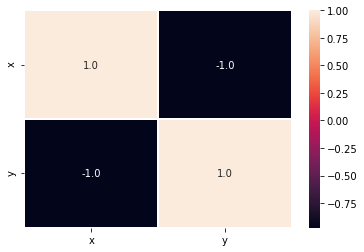

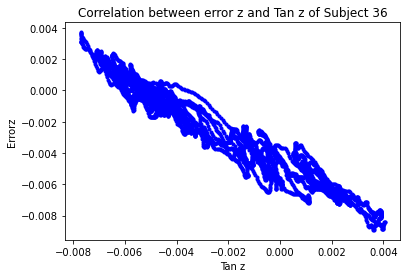

[[ 1.         -0.97496019]
 [-0.97496019  1.        ]]


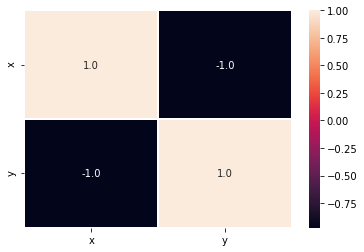

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


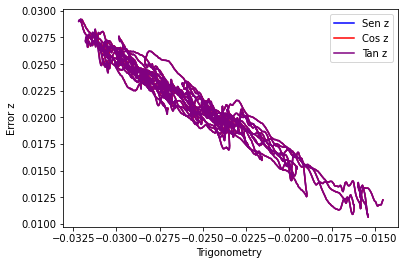

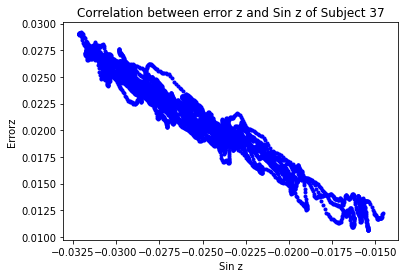

[[ 1.         -0.97587646]
 [-0.97587646  1.        ]]


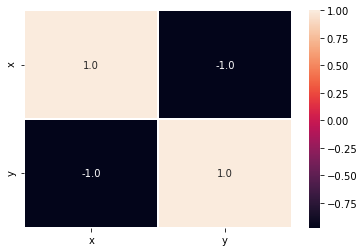

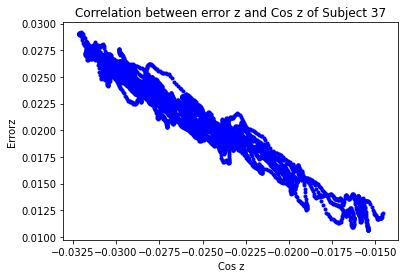

[[ 1.         -0.97587646]
 [-0.97587646  1.        ]]


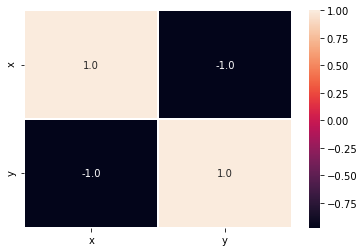

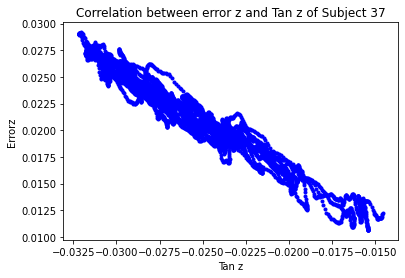

[[ 1.         -0.97588128]
 [-0.97588128  1.        ]]


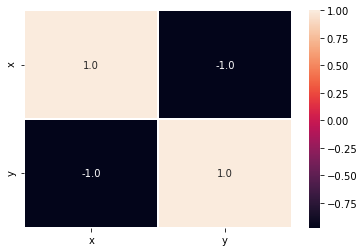

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


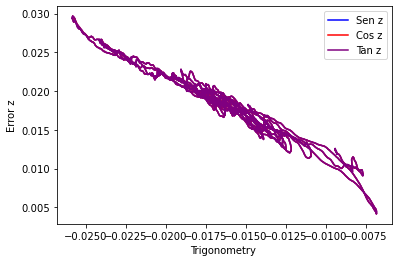

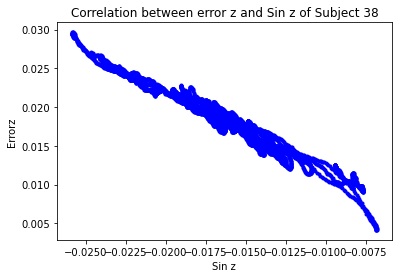

[[ 1.         -0.98401081]
 [-0.98401081  1.        ]]


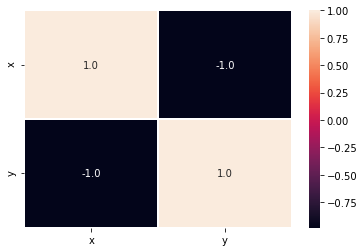

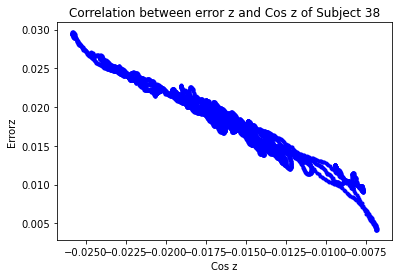

[[ 1.         -0.98401081]
 [-0.98401081  1.        ]]


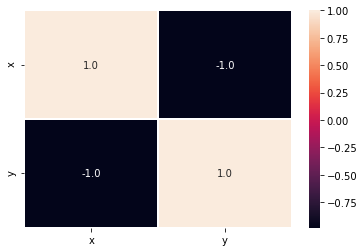

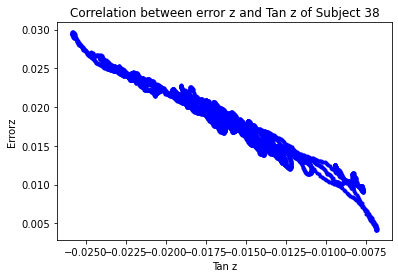

[[ 1.         -0.98400732]
 [-0.98400732  1.        ]]


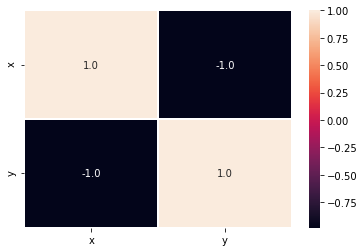

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


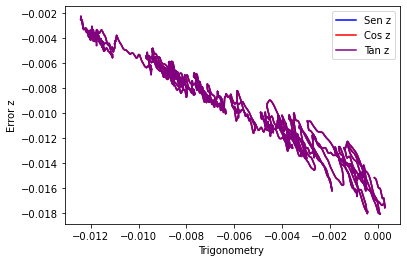

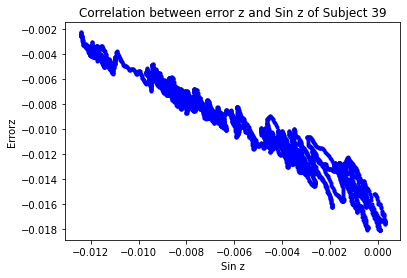

[[ 1.         -0.98121834]
 [-0.98121834  1.        ]]


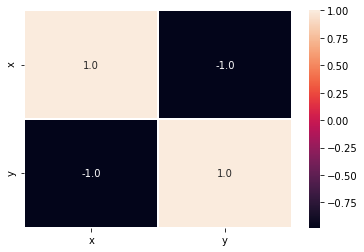

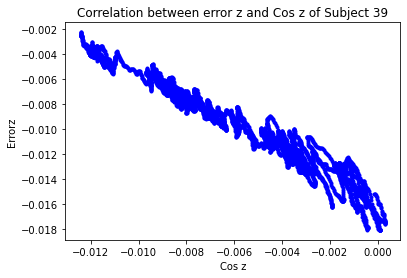

[[ 1.         -0.98121834]
 [-0.98121834  1.        ]]


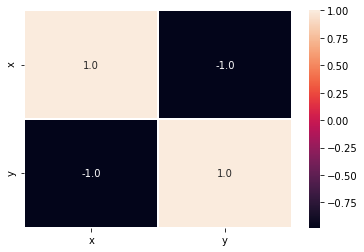

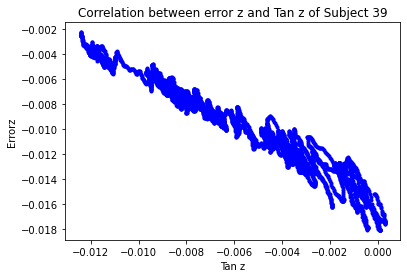

[[ 1.         -0.98121732]
 [-0.98121732  1.        ]]


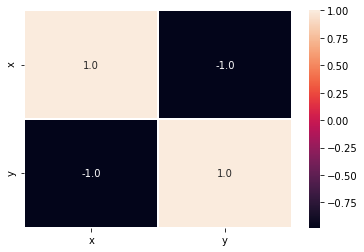

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


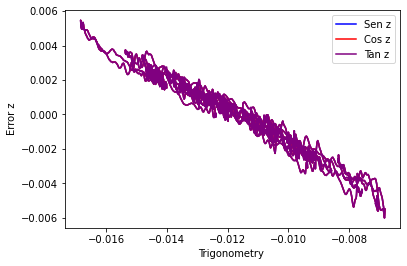

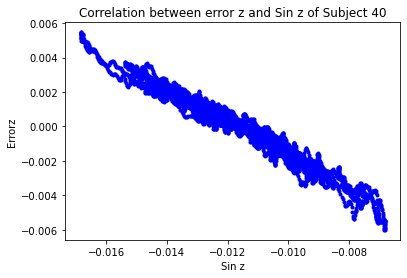

[[ 1.         -0.98311466]
 [-0.98311466  1.        ]]


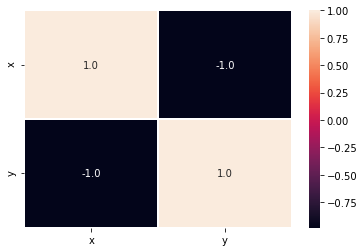

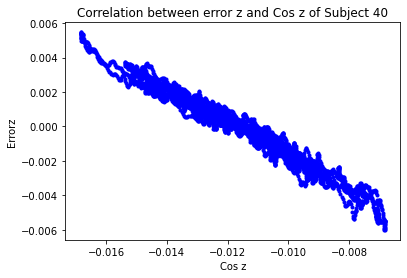

[[ 1.         -0.98311466]
 [-0.98311466  1.        ]]


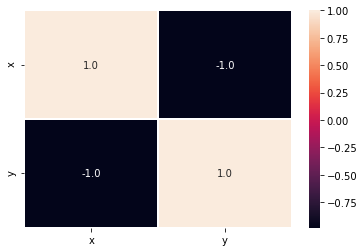

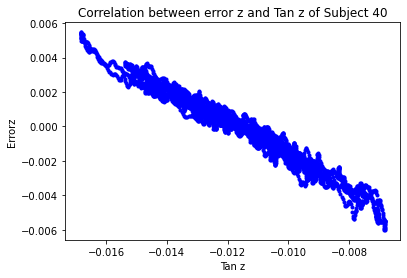

[[ 1.         -0.98311276]
 [-0.98311276  1.        ]]


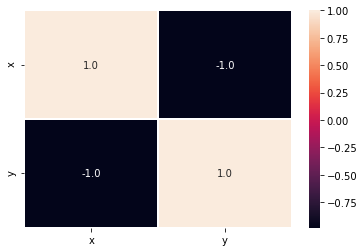

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


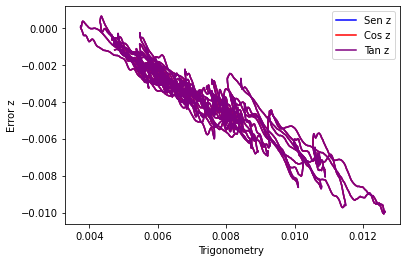

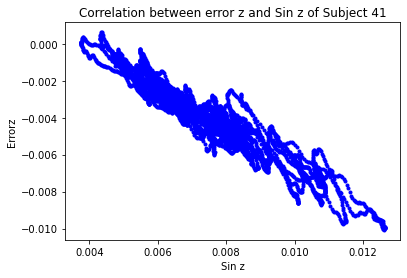

[[ 1.         -0.95495708]
 [-0.95495708  1.        ]]


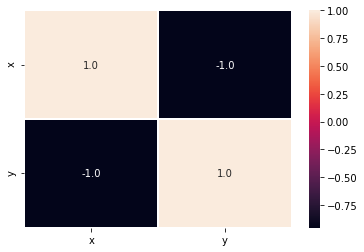

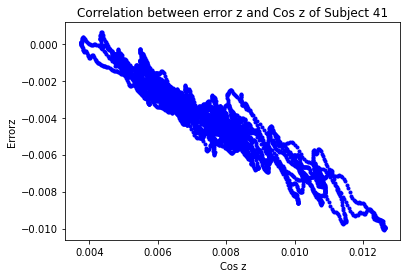

[[ 1.         -0.95495708]
 [-0.95495708  1.        ]]


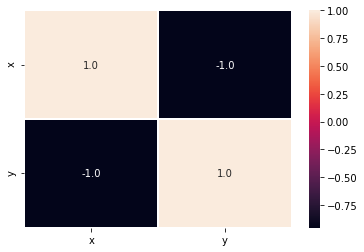

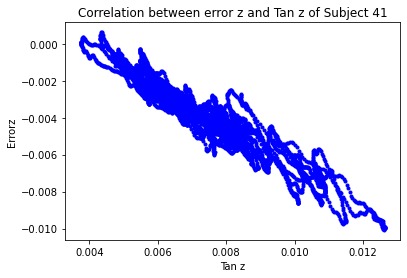

[[ 1.         -0.95495654]
 [-0.95495654  1.        ]]


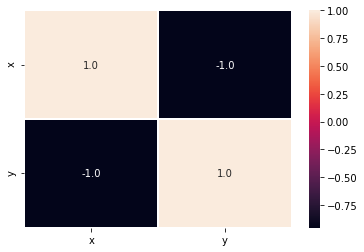

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


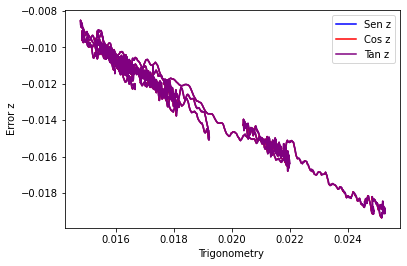

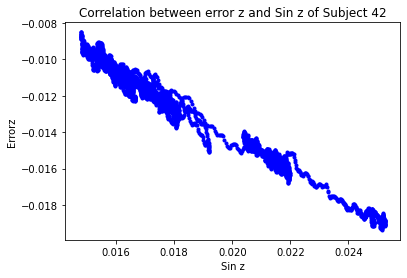

[[ 1.         -0.99044519]
 [-0.99044519  1.        ]]


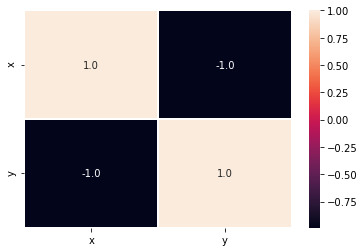

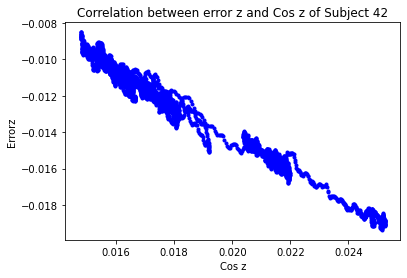

[[ 1.         -0.99044519]
 [-0.99044519  1.        ]]


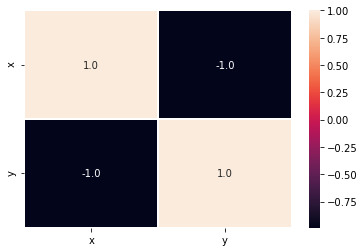

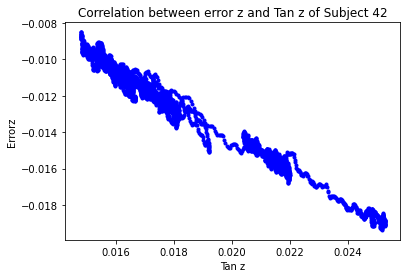

[[ 1.         -0.99044351]
 [-0.99044351  1.        ]]


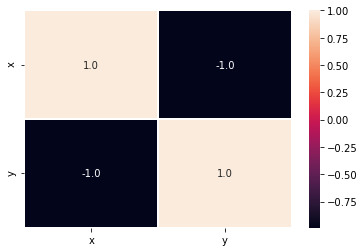

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


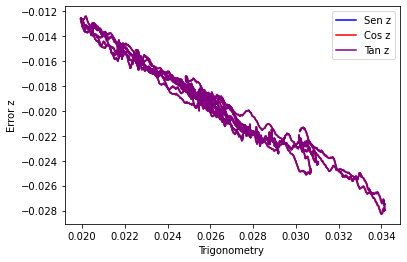

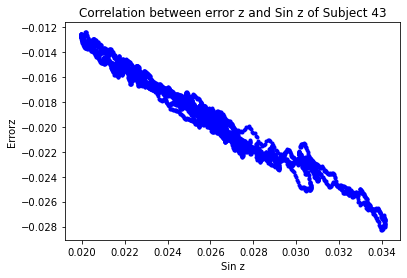

[[ 1.        -0.9861997]
 [-0.9861997  1.       ]]


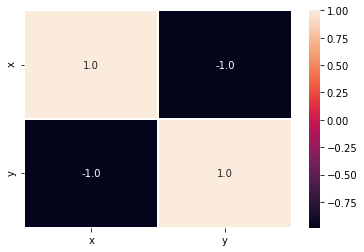

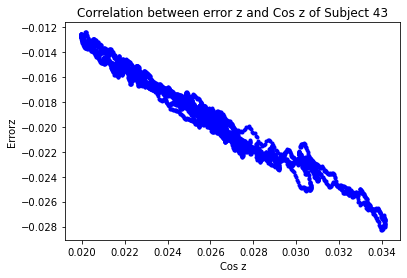

[[ 1.        -0.9861997]
 [-0.9861997  1.       ]]


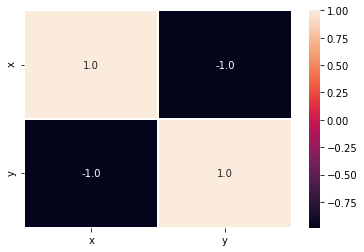

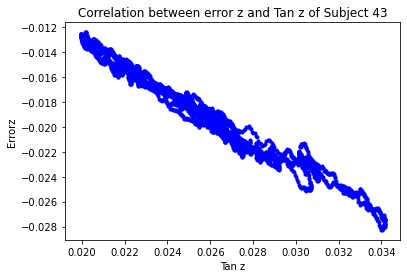

[[ 1.         -0.98619054]
 [-0.98619054  1.        ]]


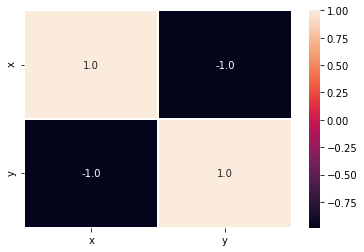

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


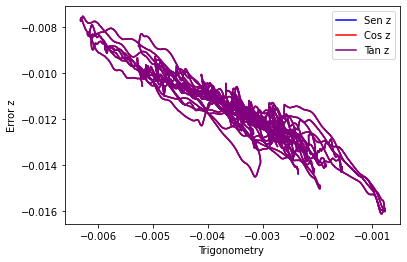

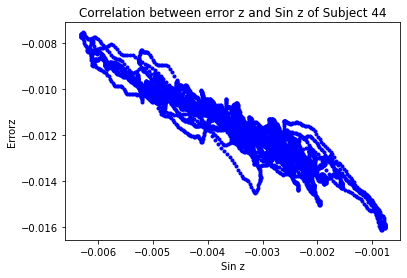

[[ 1.         -0.94082024]
 [-0.94082024  1.        ]]


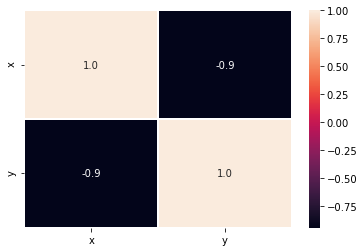

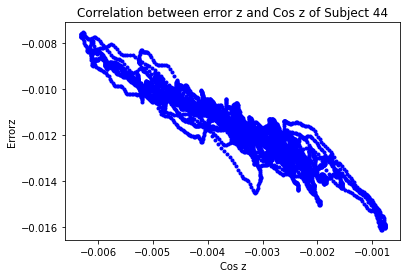

[[ 1.         -0.94082024]
 [-0.94082024  1.        ]]


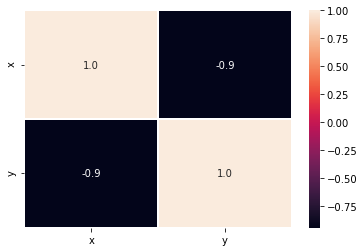

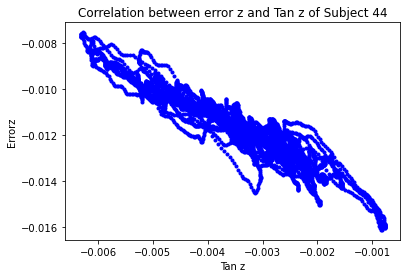

[[ 1.         -0.94082007]
 [-0.94082007  1.        ]]


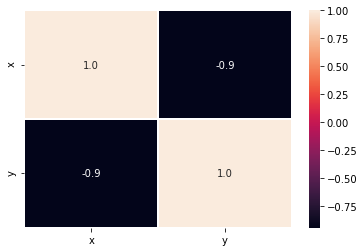

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


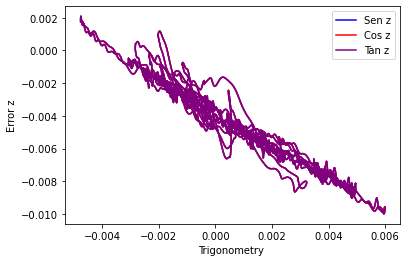

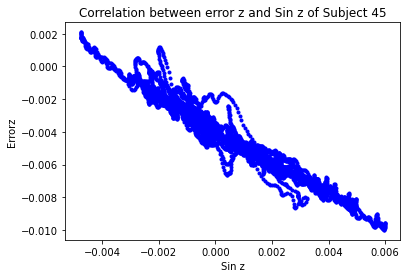

[[ 1.        -0.9755019]
 [-0.9755019  1.       ]]


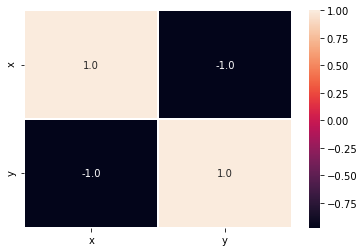

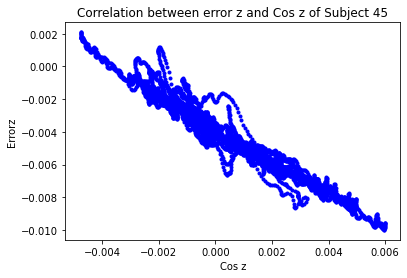

[[ 1.        -0.9755019]
 [-0.9755019  1.       ]]


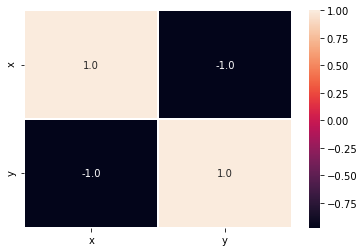

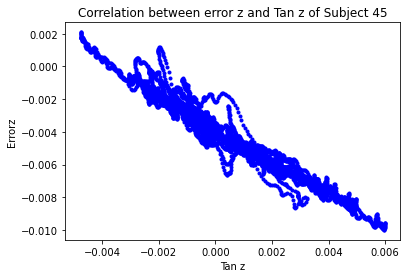

[[ 1.         -0.97550178]
 [-0.97550178  1.        ]]


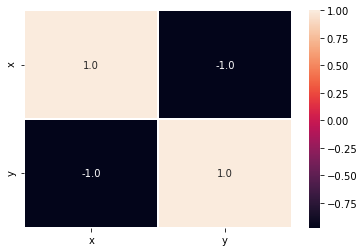

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


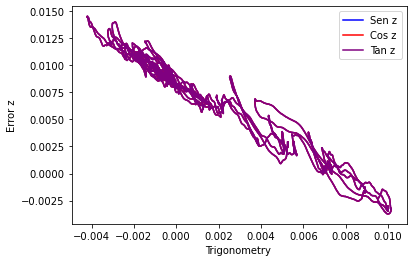

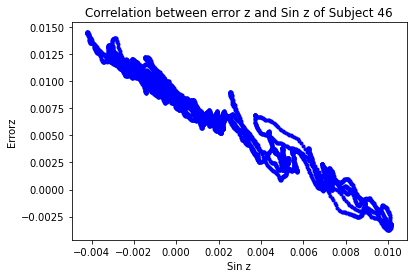

[[ 1.         -0.98410714]
 [-0.98410714  1.        ]]


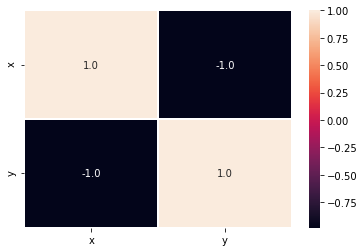

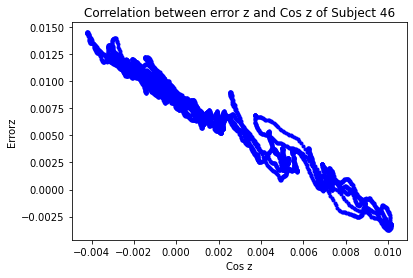

[[ 1.         -0.98410714]
 [-0.98410714  1.        ]]


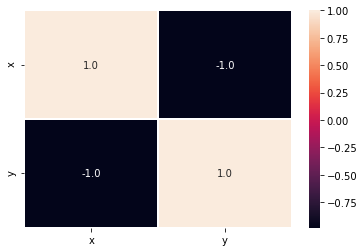

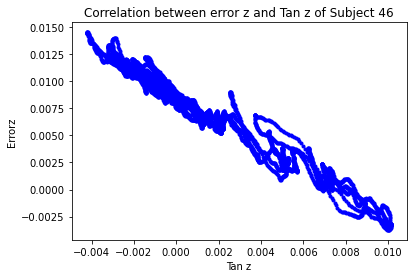

[[ 1.         -0.98410715]
 [-0.98410715  1.        ]]


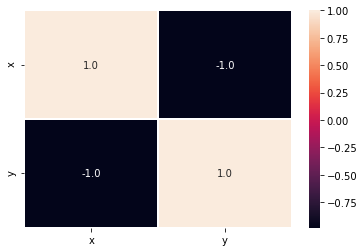

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


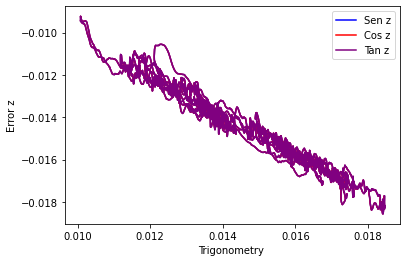

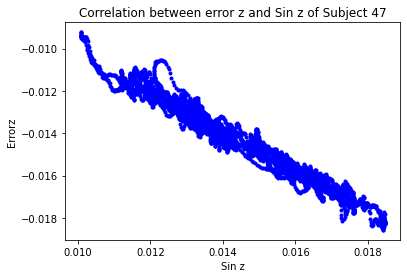

[[ 1.         -0.98337921]
 [-0.98337921  1.        ]]


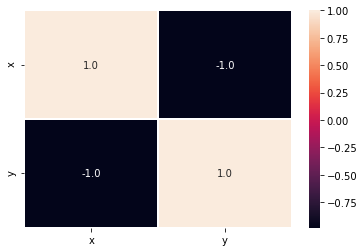

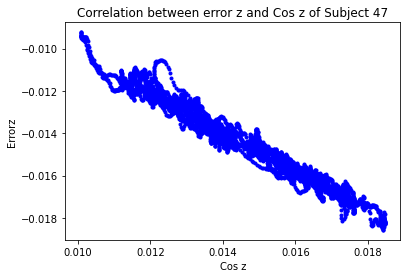

[[ 1.         -0.98337921]
 [-0.98337921  1.        ]]


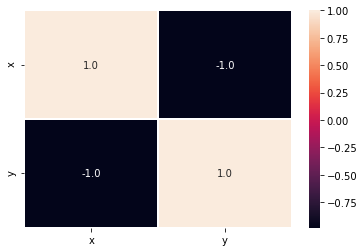

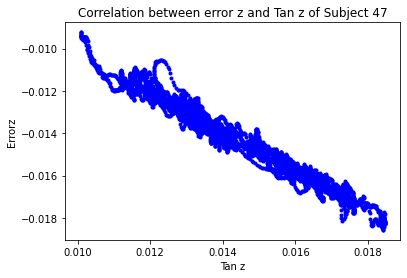

[[ 1.        -0.9833786]
 [-0.9833786  1.       ]]


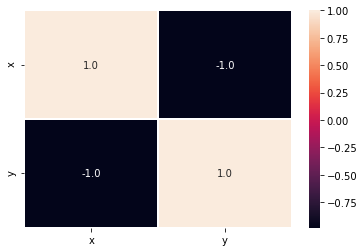

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


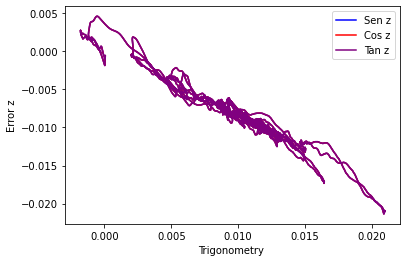

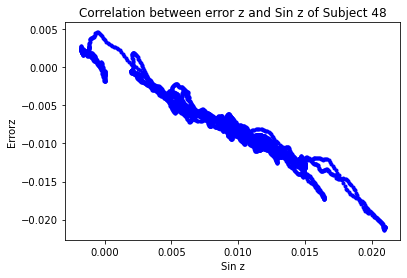

[[ 1.         -0.98112384]
 [-0.98112384  1.        ]]


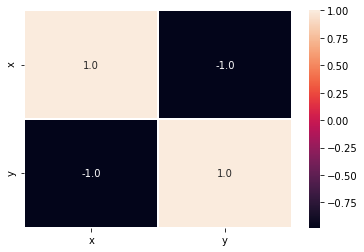

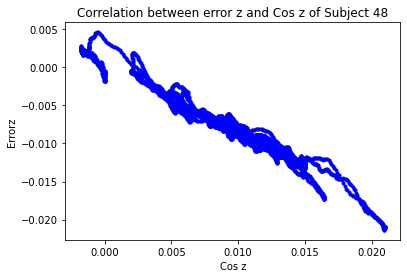

[[ 1.         -0.98112384]
 [-0.98112384  1.        ]]


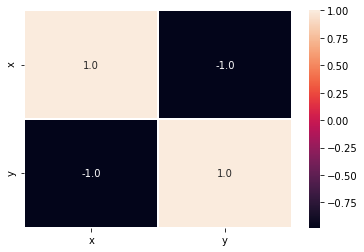

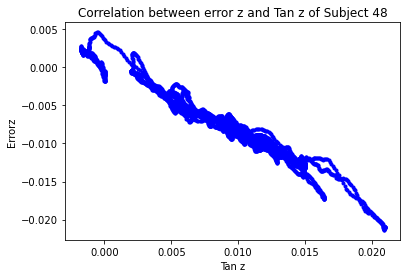

[[ 1.         -0.98112701]
 [-0.98112701  1.        ]]


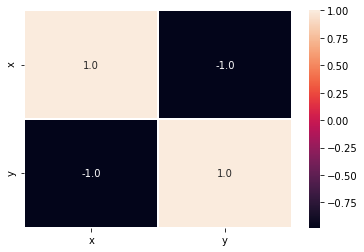

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


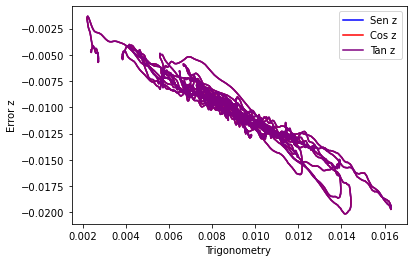

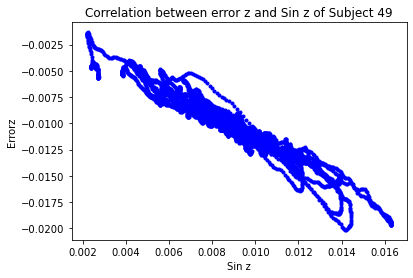

[[ 1.         -0.96609814]
 [-0.96609814  1.        ]]


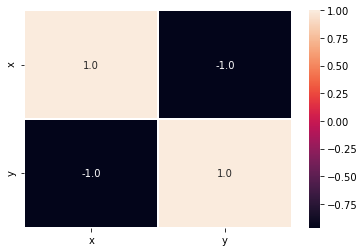

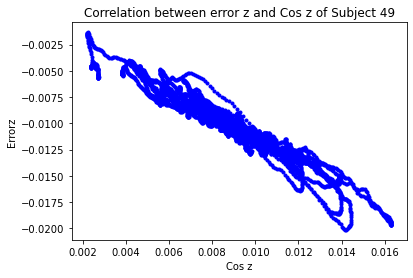

[[ 1.         -0.96609814]
 [-0.96609814  1.        ]]


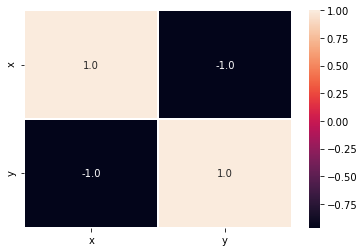

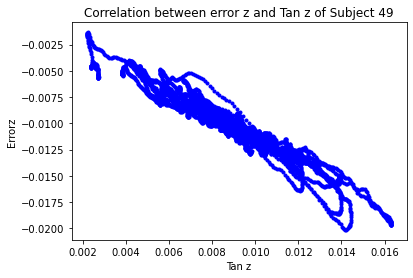

[[ 1.         -0.96610023]
 [-0.96610023  1.        ]]


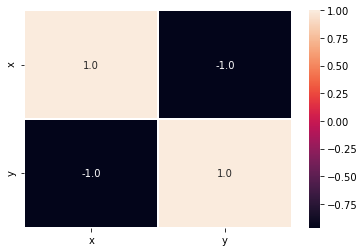

In [12]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(sinz[30:],errorz,color='blue',label='Sen z')
    plt.plot(cosz[30:],errorz,color='red',label='Cos z')
    plt.plot(tanz[30:],errorz,color='purple',label='Tan z')
    plt.xlabel("Trigonometry ")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()
    data={'x':sinz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Sin z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Sin z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(sinz[30:],errorz)
    print(r)
    plt.figure()
    data={'x':sinz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':cosz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Cos z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Cos z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(cosz[30:],errorz)
    print(r)
    plt.figure()
    data={'x':cosz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':tanz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Tan z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Tan z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(tanz[30:],errorz)
    print(r)
    plt.figure()
    data={'x':tanz[30:],
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

# Error x in function of derivatives

We are going to correlate the error found with the first and second. If the number is closer to 0 than to 1 or -1, the two variables dont correlate. From the graphics we can notice that the number of correlation approaches 0, indicating a lack of correlation betweem them, for the errorz and anglez and angle x for the first and second derivative.

## Correlation between errorz and first and second derivative of x

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


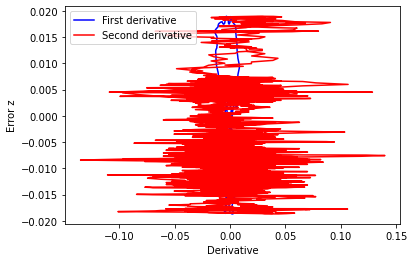

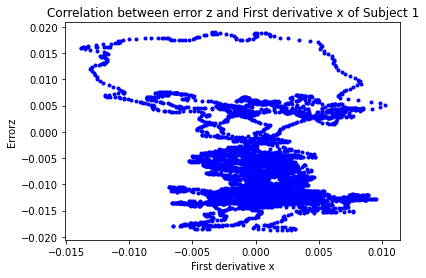

[[ 1.         -0.17680704]
 [-0.17680704  1.        ]]


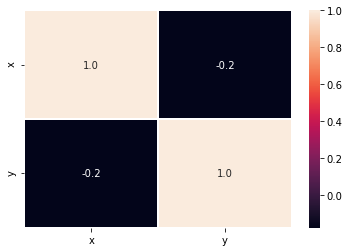

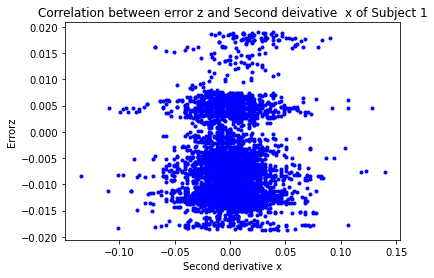

[[1.         0.02433829]
 [0.02433829 1.        ]]


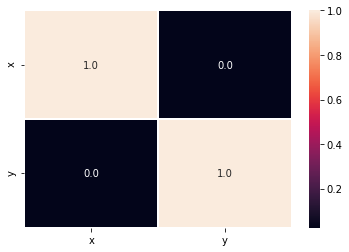

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


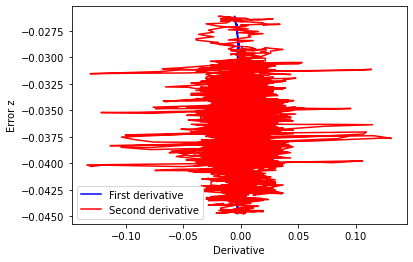

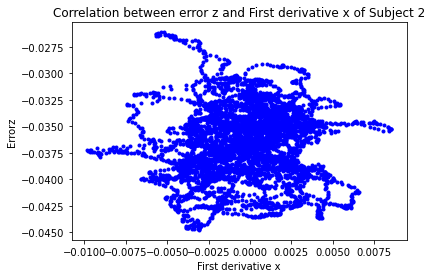

[[1.         0.05688263]
 [0.05688263 1.        ]]


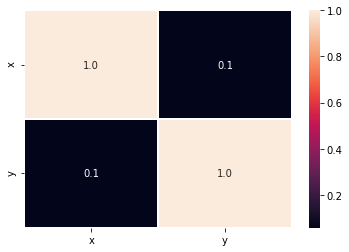

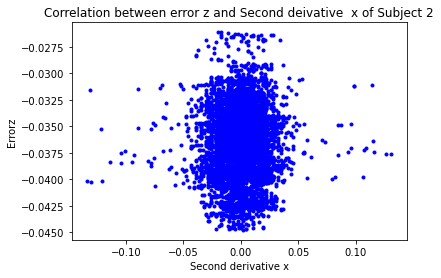

[[1.         0.00946784]
 [0.00946784 1.        ]]


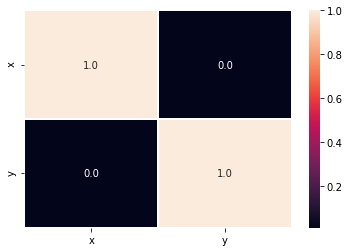

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


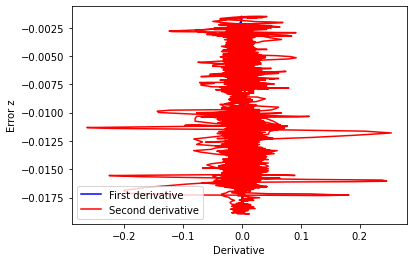

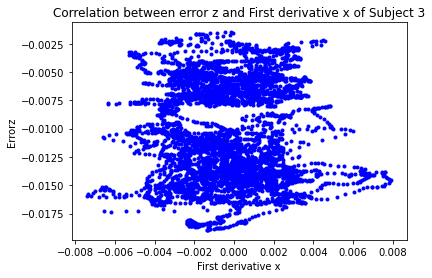

[[ 1.         -0.03149688]
 [-0.03149688  1.        ]]


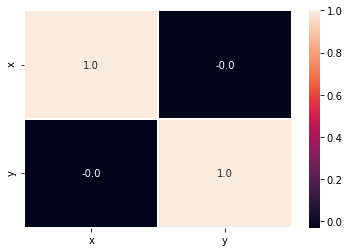

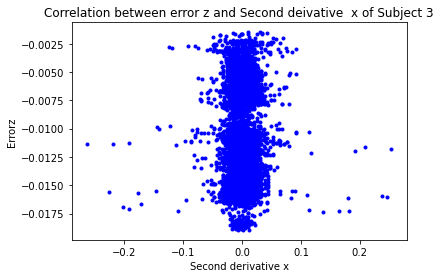

[[ 1.0000000e+00 -1.5560788e-04]
 [-1.5560788e-04  1.0000000e+00]]


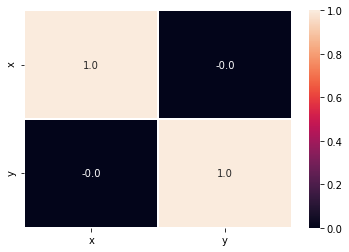

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


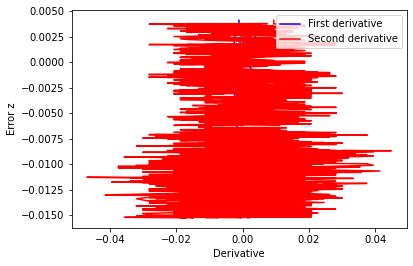

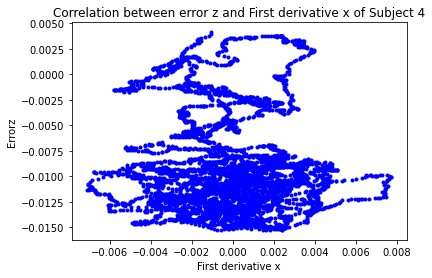

[[ 1.         -0.04696212]
 [-0.04696212  1.        ]]


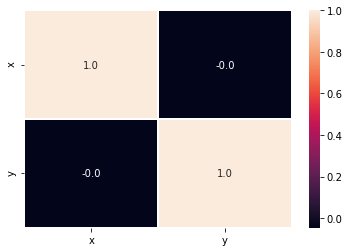

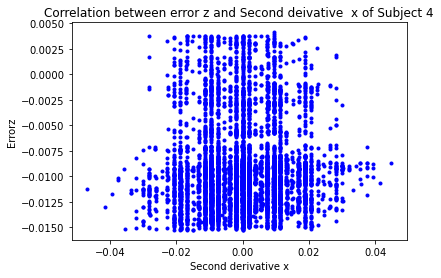

[[1.         0.02744807]
 [0.02744807 1.        ]]


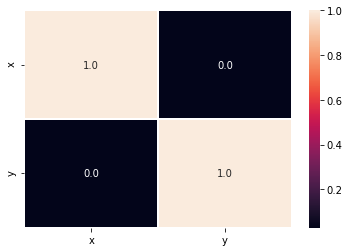

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


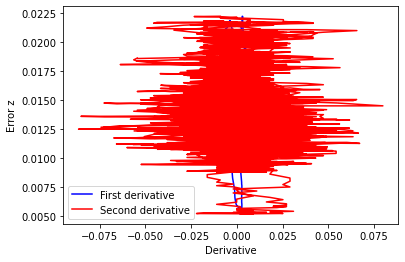

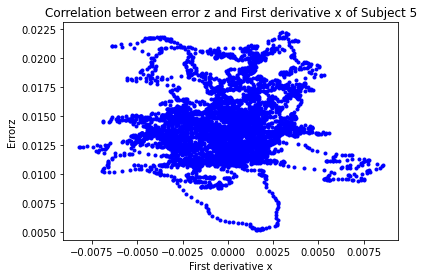

[[1.        0.0668088]
 [0.0668088 1.       ]]


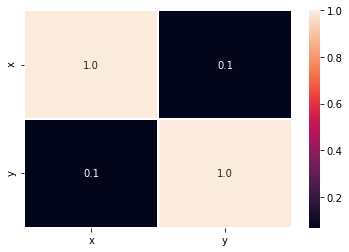

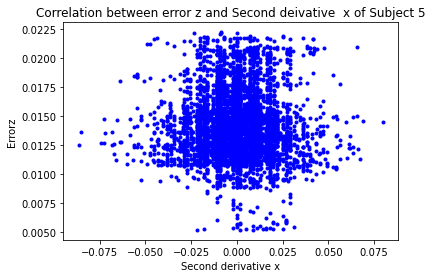

[[ 1.         -0.02837018]
 [-0.02837018  1.        ]]


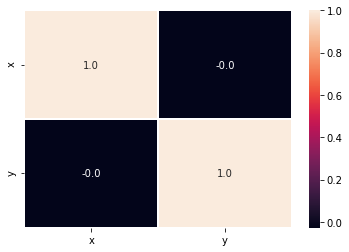

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


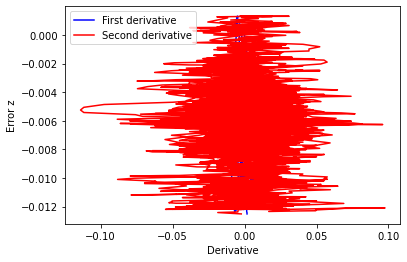

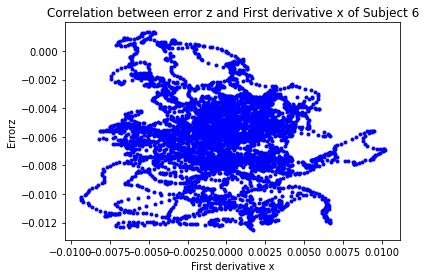

[[ 1.         -0.12633125]
 [-0.12633125  1.        ]]


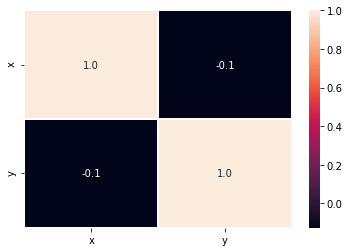

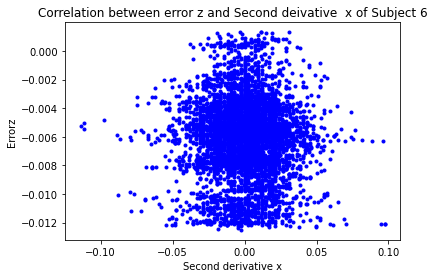

[[ 1.        -0.0228716]
 [-0.0228716  1.       ]]


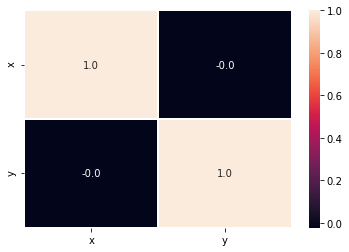

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


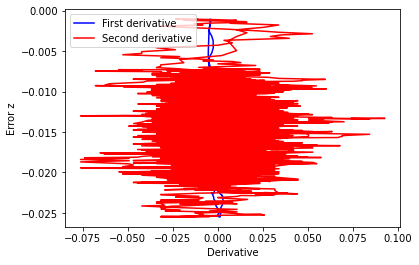

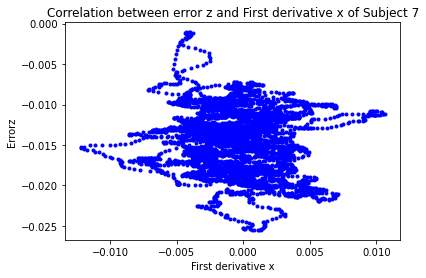

[[ 1.         -0.11232745]
 [-0.11232745  1.        ]]


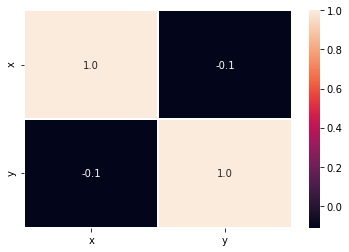

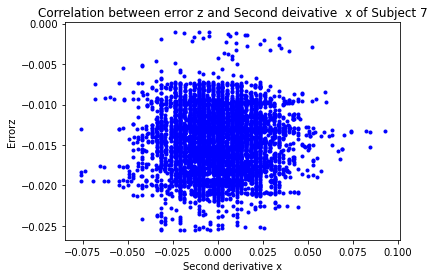

[[1.        0.0149978]
 [0.0149978 1.       ]]


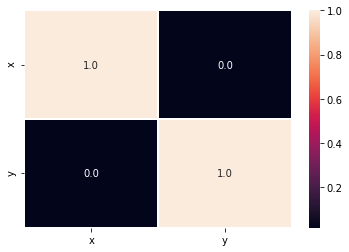

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


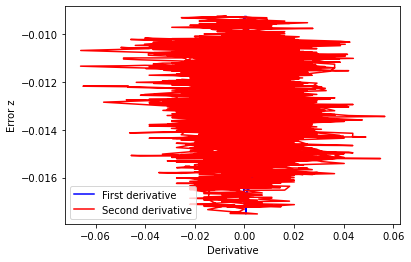

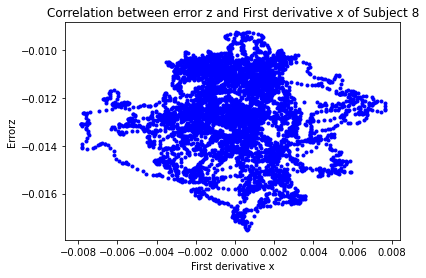

[[ 1.         -0.05512188]
 [-0.05512188  1.        ]]


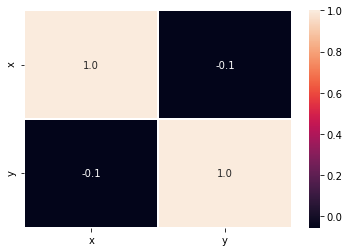

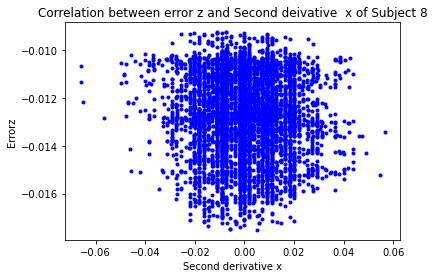

[[ 1.         -0.04613874]
 [-0.04613874  1.        ]]


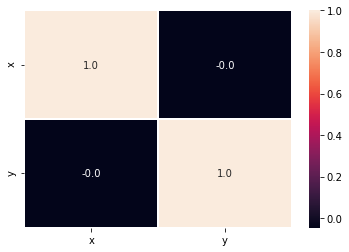

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


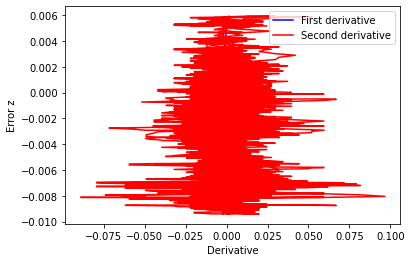

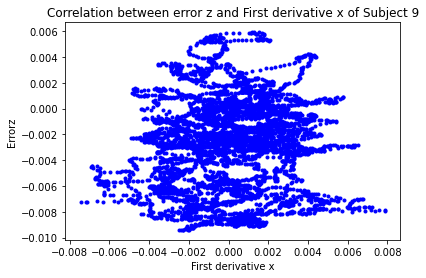

[[1.         0.07022032]
 [0.07022032 1.        ]]


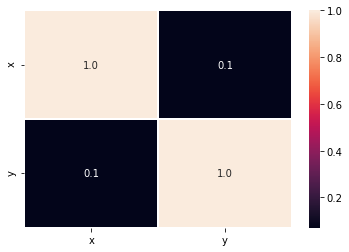

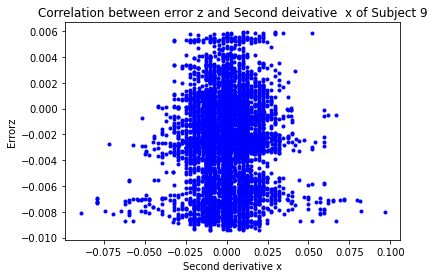

[[1.         0.01484368]
 [0.01484368 1.        ]]


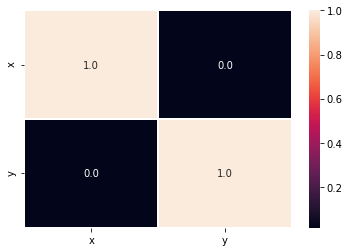

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


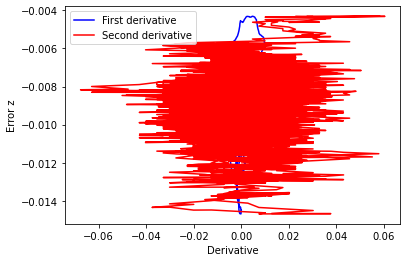

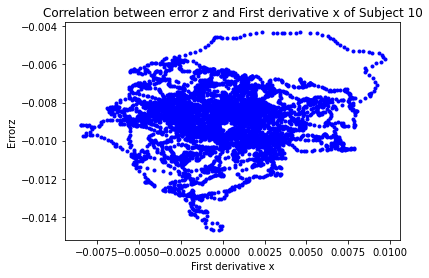

[[1.         0.02300504]
 [0.02300504 1.        ]]


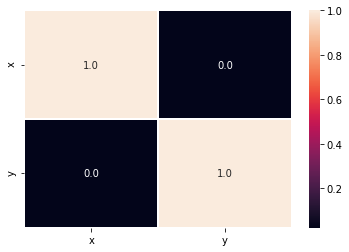

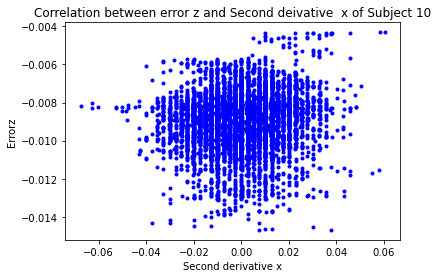

[[1.         0.09103444]
 [0.09103444 1.        ]]


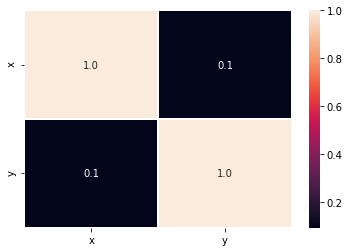

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


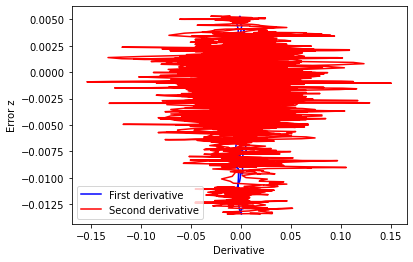

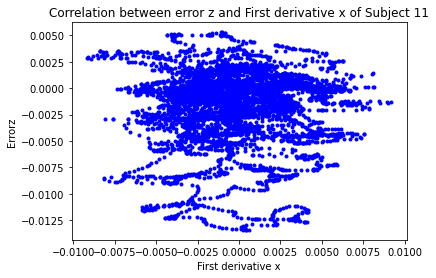

[[1.         0.01685871]
 [0.01685871 1.        ]]


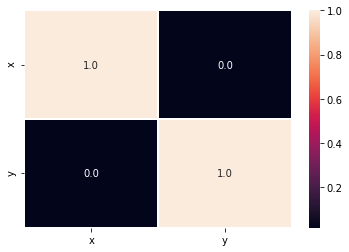

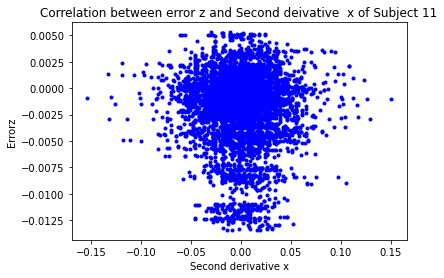

[[ 1.         -0.01240456]
 [-0.01240456  1.        ]]


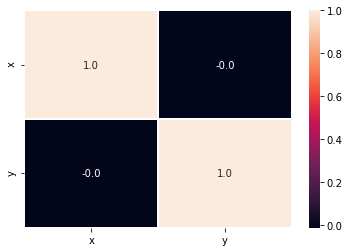

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


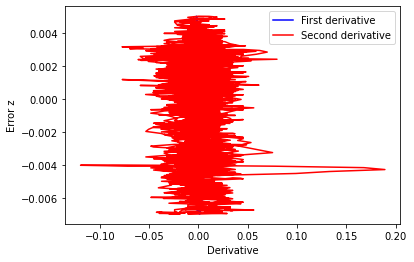

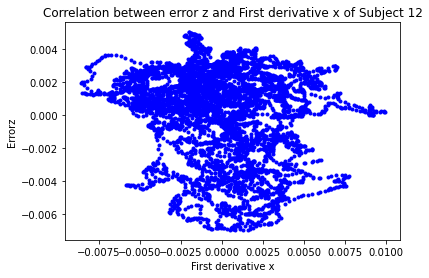

[[ 1.         -0.20060588]
 [-0.20060588  1.        ]]


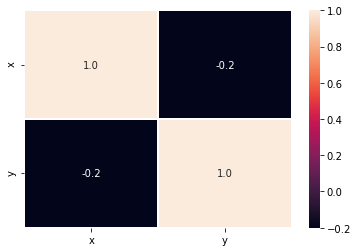

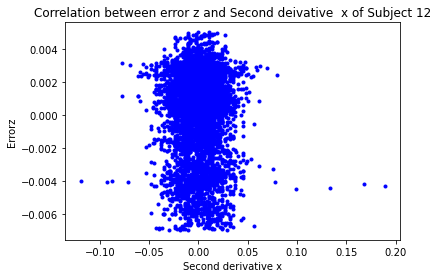

[[ 1.         -0.02424793]
 [-0.02424793  1.        ]]


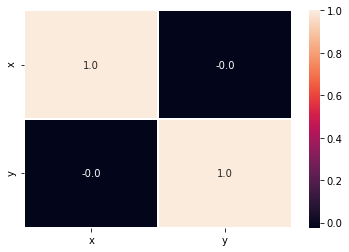

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


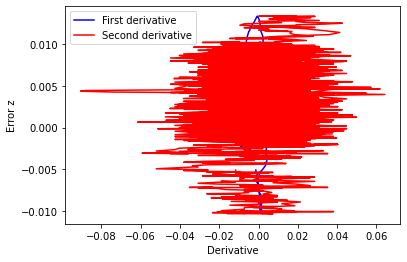

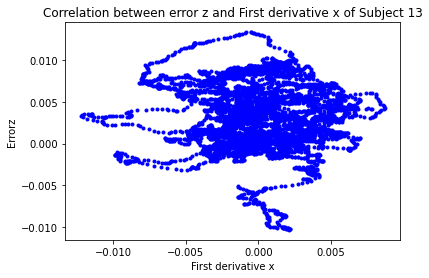

[[ 1.         -0.04286472]
 [-0.04286472  1.        ]]


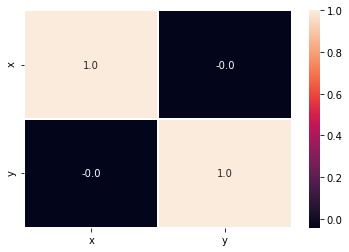

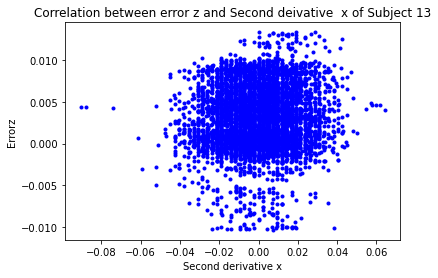

[[1.         0.06585265]
 [0.06585265 1.        ]]


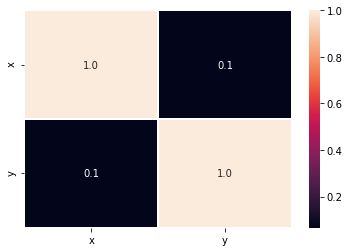

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


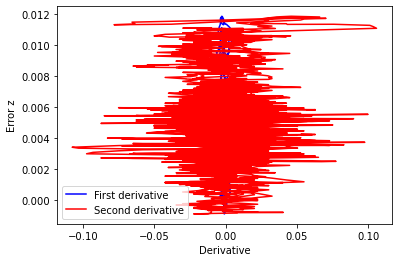

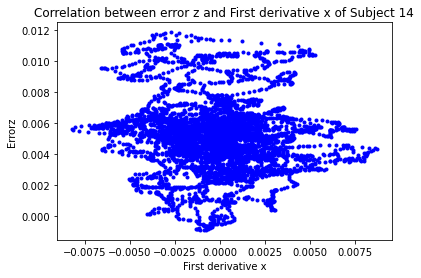

[[ 1.         -0.11405186]
 [-0.11405186  1.        ]]


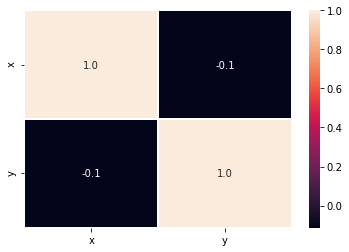

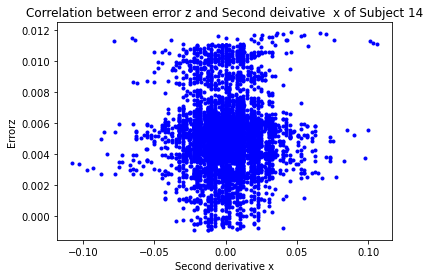

[[1.00000000e+00 1.95921378e-04]
 [1.95921378e-04 1.00000000e+00]]


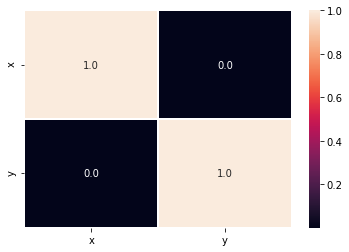

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


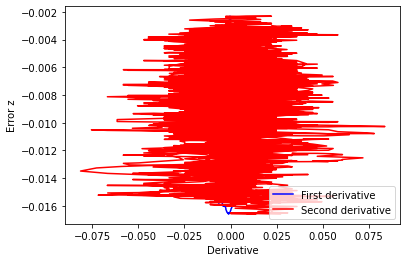

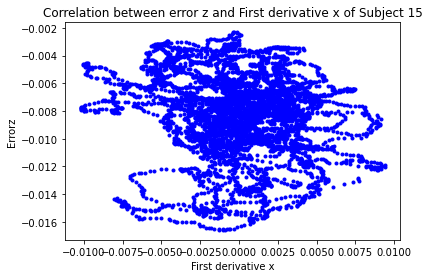

[[ 1.         -0.14685969]
 [-0.14685969  1.        ]]


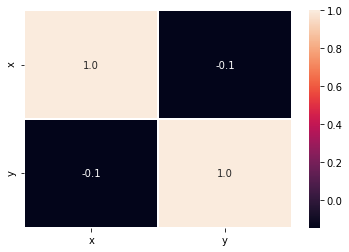

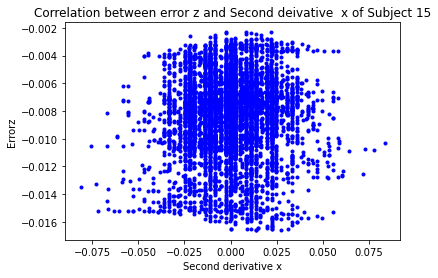

[[1.         0.05217613]
 [0.05217613 1.        ]]


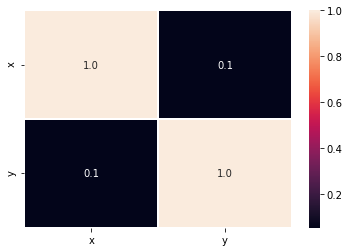

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


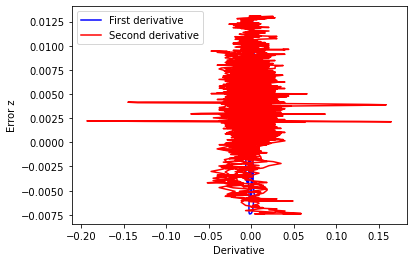

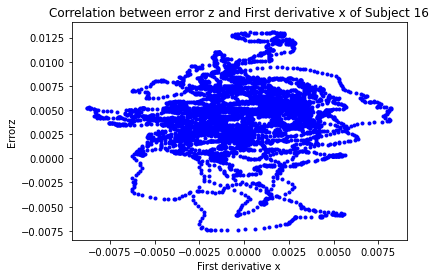

[[1.         0.06146875]
 [0.06146875 1.        ]]


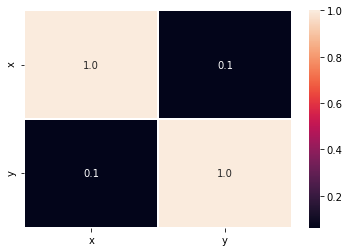

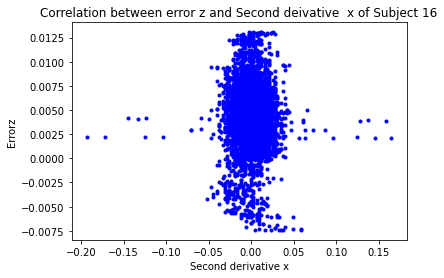

[[ 1.00000000e+00 -1.92581249e-04]
 [-1.92581249e-04  1.00000000e+00]]


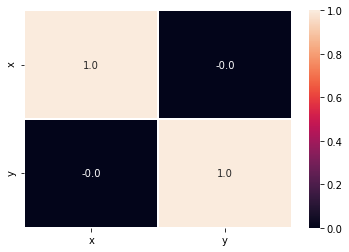

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


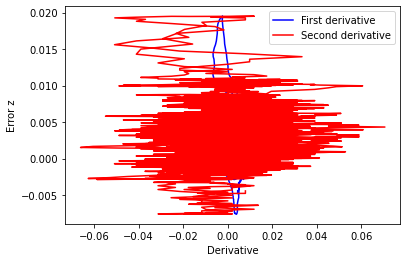

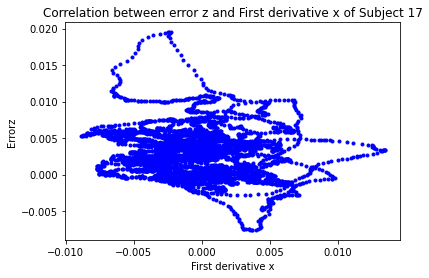

[[ 1.        -0.1404569]
 [-0.1404569  1.       ]]


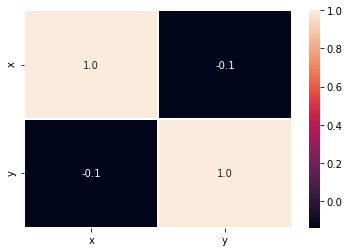

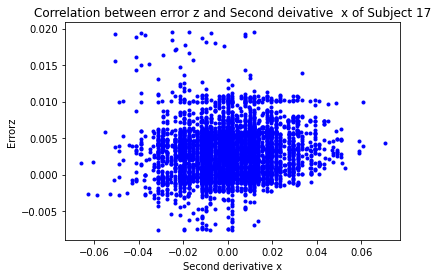

[[1.         0.07529921]
 [0.07529921 1.        ]]


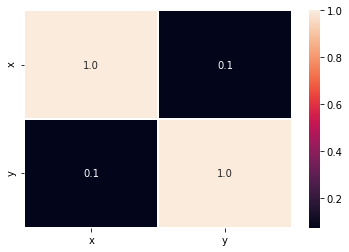

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


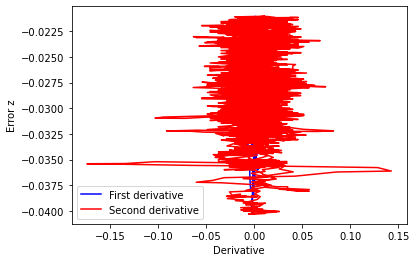

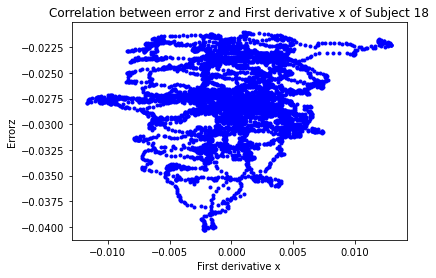

[[1.        0.0911891]
 [0.0911891 1.       ]]


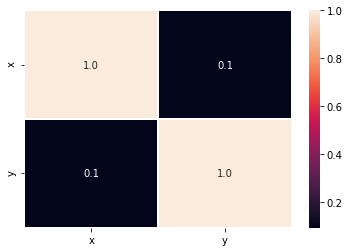

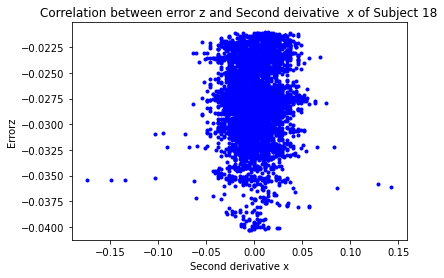

[[1.         0.02673983]
 [0.02673983 1.        ]]


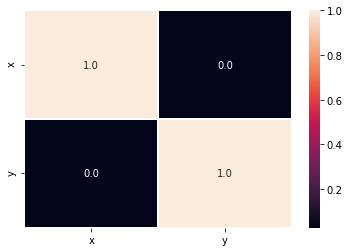

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


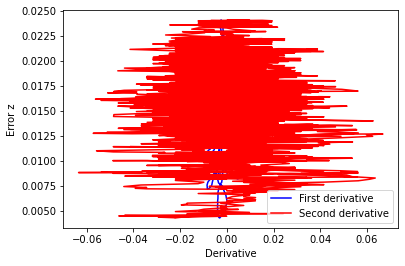

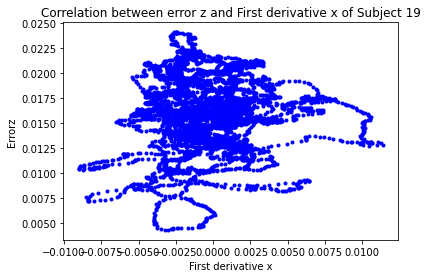

[[1.         0.05162096]
 [0.05162096 1.        ]]


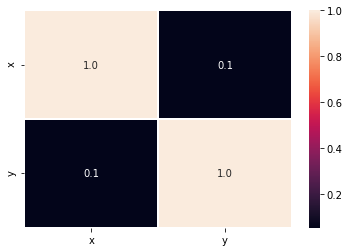

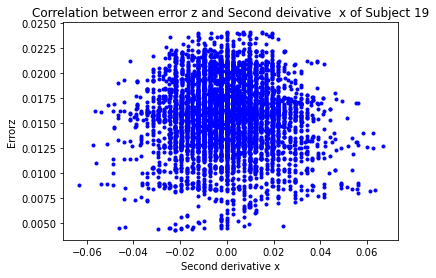

[[ 1.         -0.02957029]
 [-0.02957029  1.        ]]


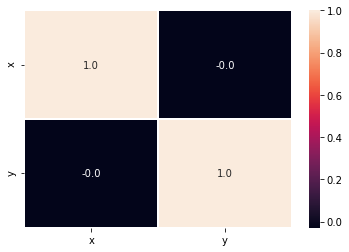

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


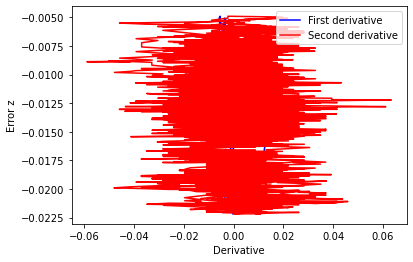

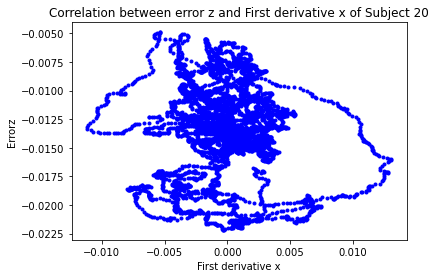

[[ 1.        -0.0839664]
 [-0.0839664  1.       ]]


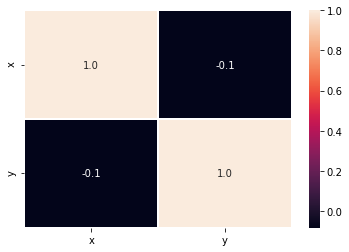

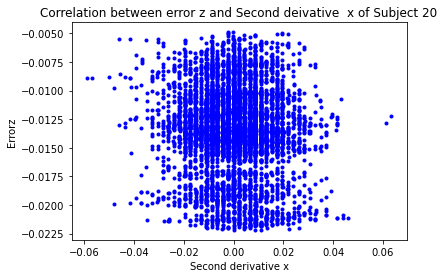

[[ 1.         -0.07056755]
 [-0.07056755  1.        ]]


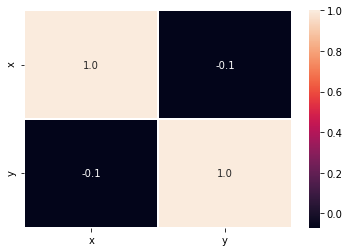

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


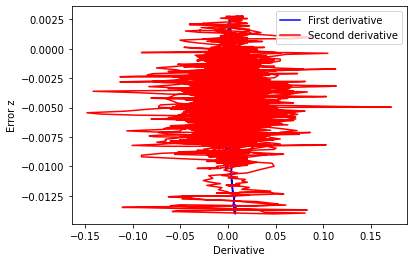

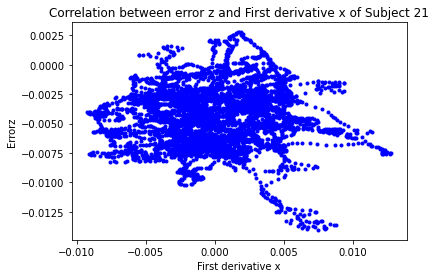

[[1.         0.00527112]
 [0.00527112 1.        ]]


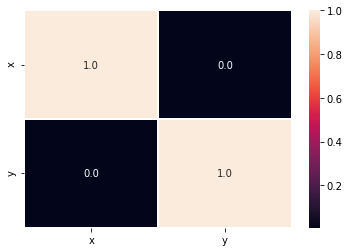

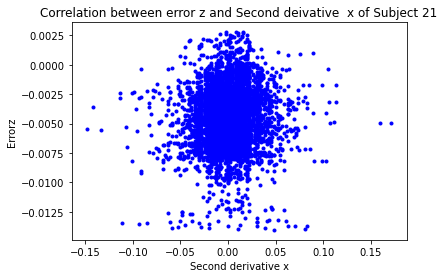

[[1.         0.05842685]
 [0.05842685 1.        ]]


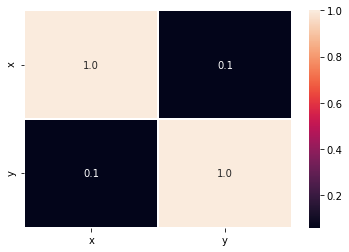

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


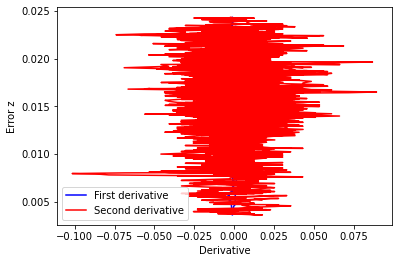

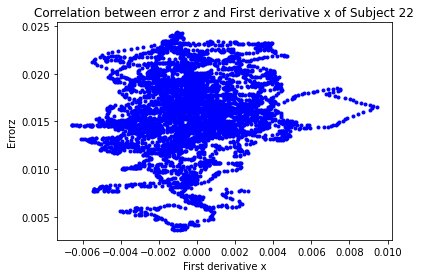

[[1.         0.14611469]
 [0.14611469 1.        ]]


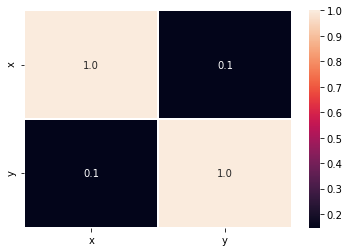

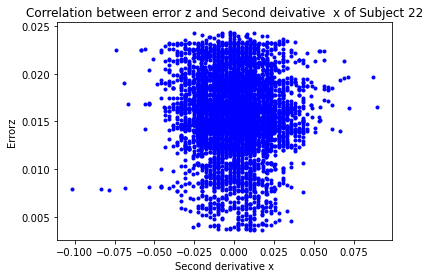

[[ 1.         -0.02601329]
 [-0.02601329  1.        ]]


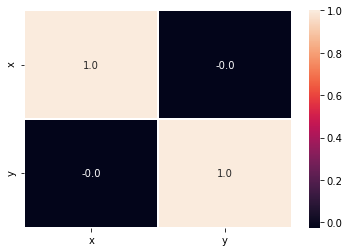

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


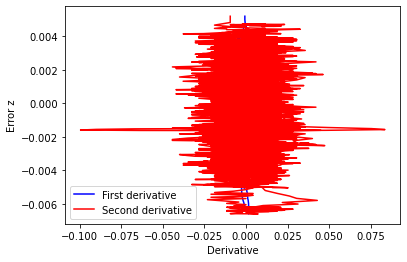

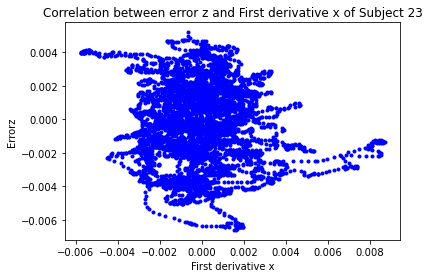

[[ 1.         -0.09199154]
 [-0.09199154  1.        ]]


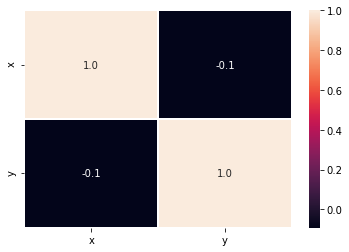

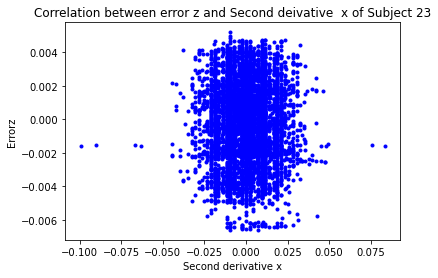

[[1.         0.00644951]
 [0.00644951 1.        ]]


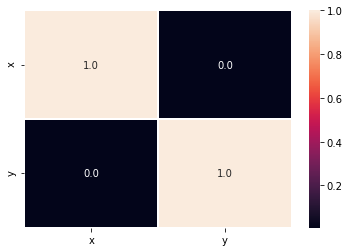

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


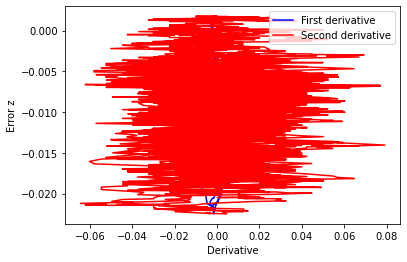

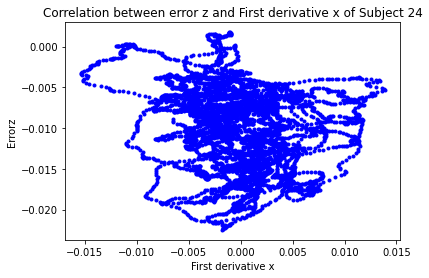

[[ 1.         -0.18619631]
 [-0.18619631  1.        ]]


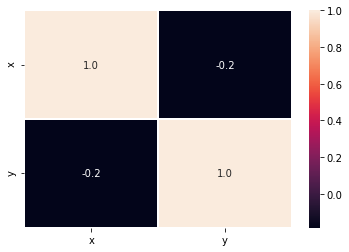

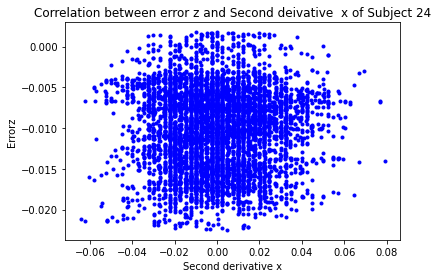

[[1.         0.01617526]
 [0.01617526 1.        ]]


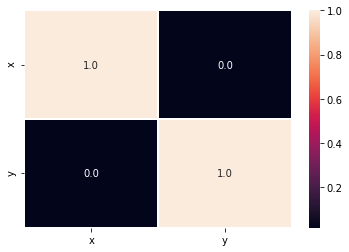

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


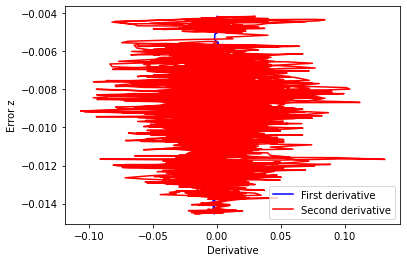

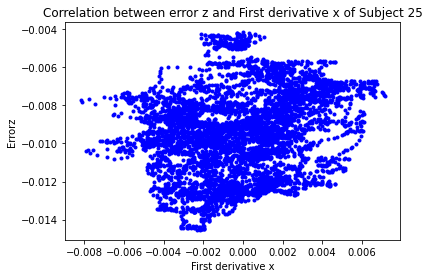

[[1.         0.21759412]
 [0.21759412 1.        ]]


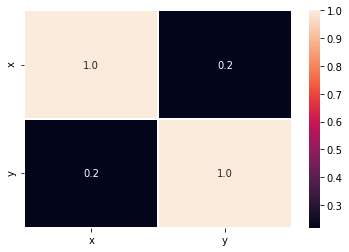

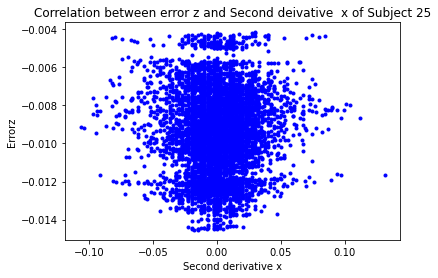

[[1.         0.01690338]
 [0.01690338 1.        ]]


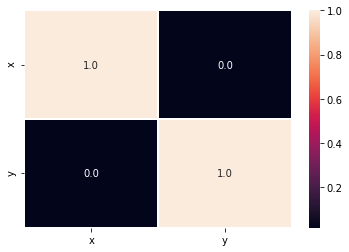

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


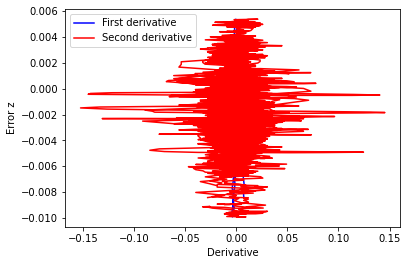

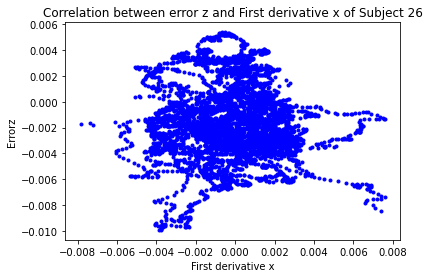

[[ 1.        -0.0460383]
 [-0.0460383  1.       ]]


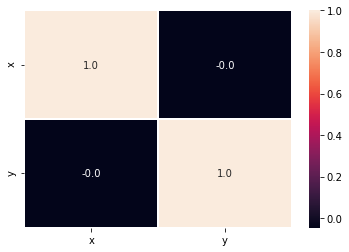

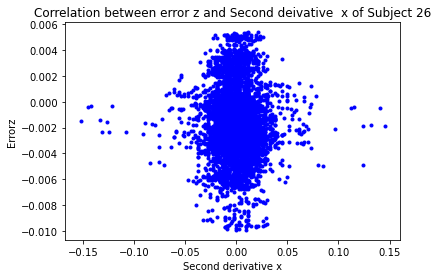

[[ 1.         -0.02847369]
 [-0.02847369  1.        ]]


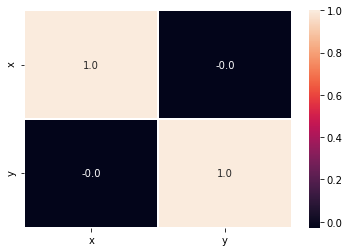

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


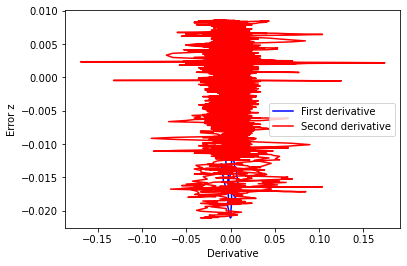

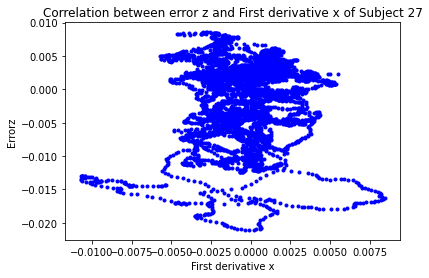

[[1.        0.1040248]
 [0.1040248 1.       ]]


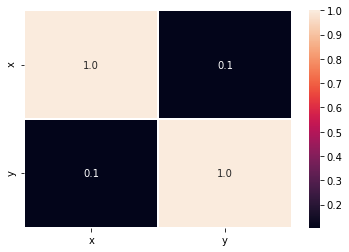

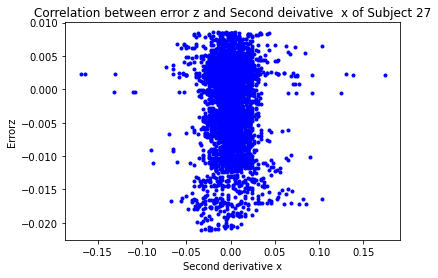

[[ 1.         -0.02568094]
 [-0.02568094  1.        ]]


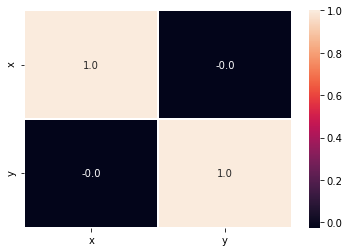

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


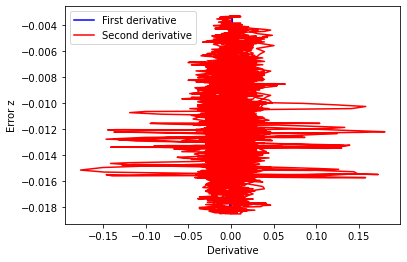

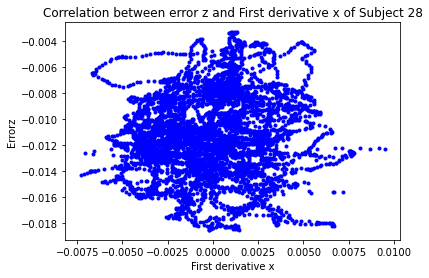

[[1.        0.0716626]
 [0.0716626 1.       ]]


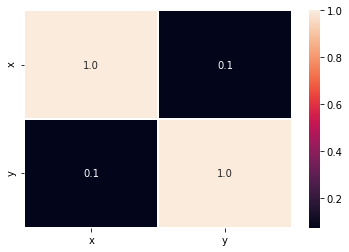

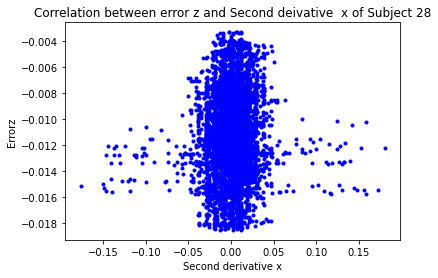

[[1.         0.05039674]
 [0.05039674 1.        ]]


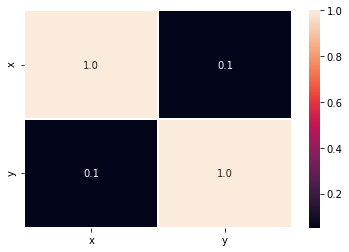

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


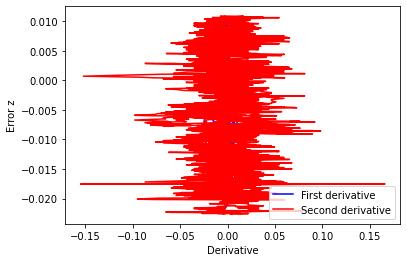

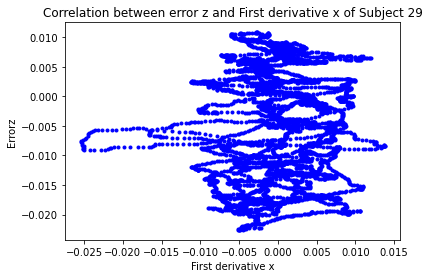

[[1.         0.05731089]
 [0.05731089 1.        ]]


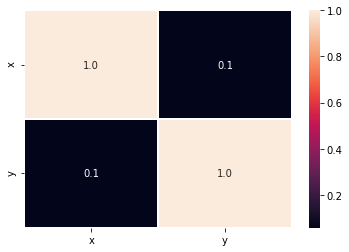

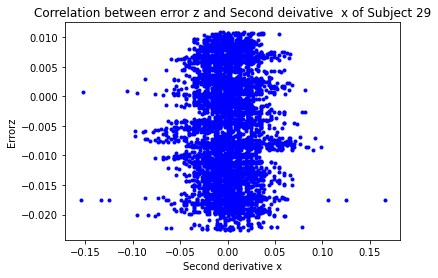

[[ 1.         -0.02236179]
 [-0.02236179  1.        ]]


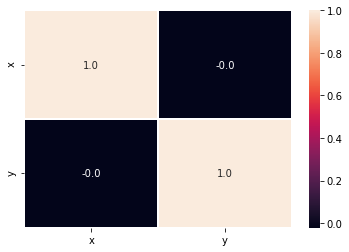

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


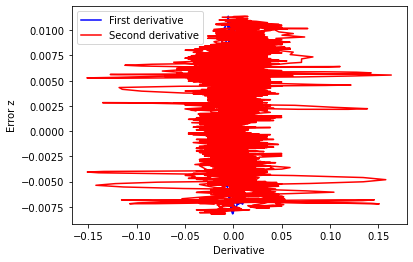

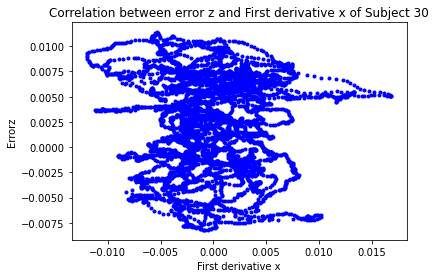

[[1.        0.0127115]
 [0.0127115 1.       ]]


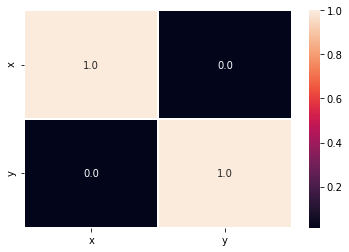

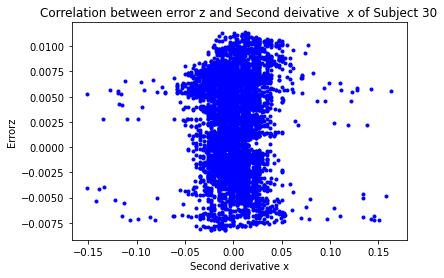

[[1.         0.00139681]
 [0.00139681 1.        ]]


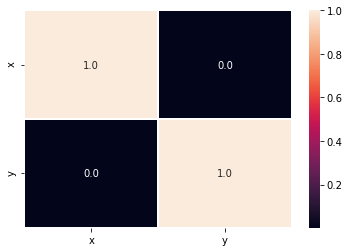

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


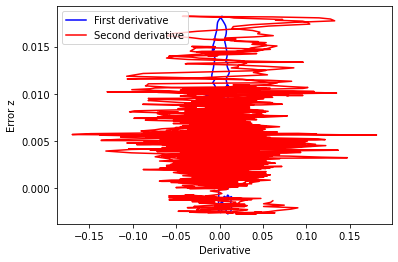

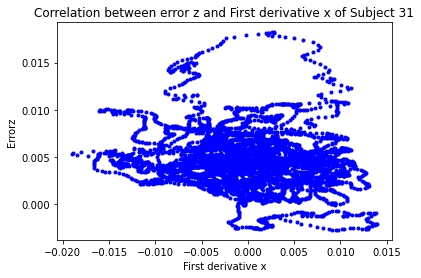

[[ 1.         -0.14020482]
 [-0.14020482  1.        ]]


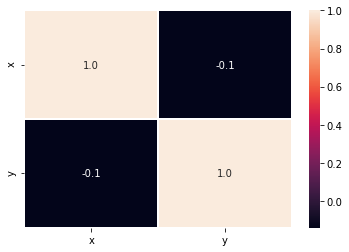

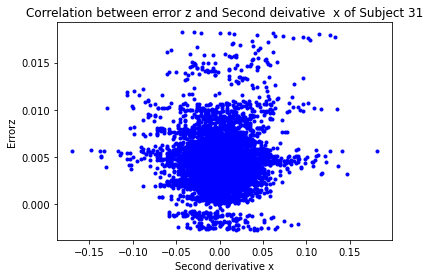

[[1.         0.04176338]
 [0.04176338 1.        ]]


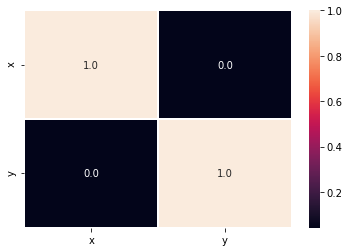

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


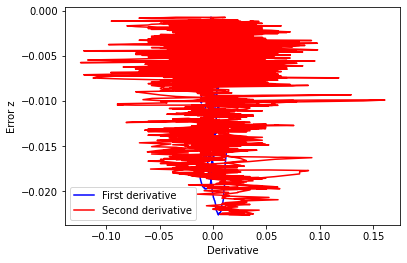

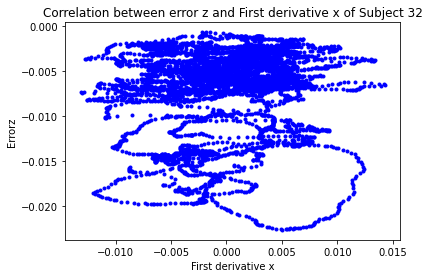

[[1.         0.10316795]
 [0.10316795 1.        ]]


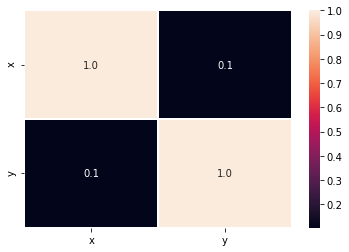

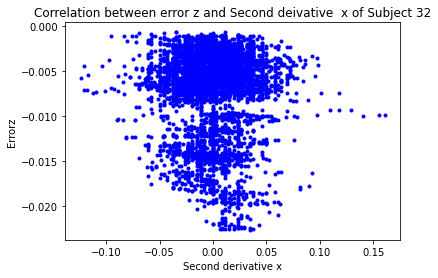

[[ 1.         -0.02683094]
 [-0.02683094  1.        ]]


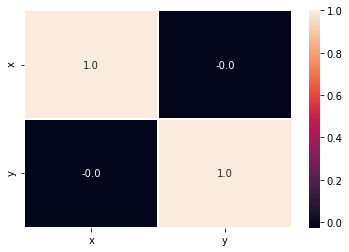

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


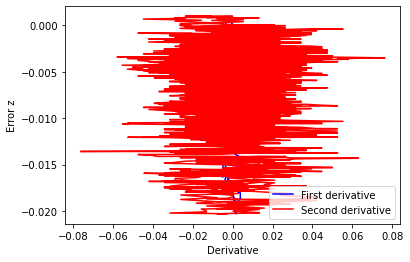

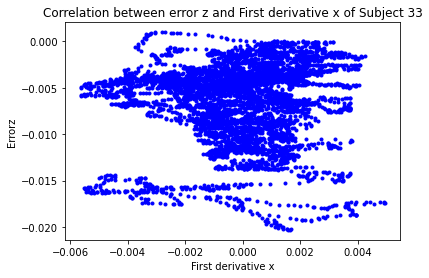

[[1.         0.02246216]
 [0.02246216 1.        ]]


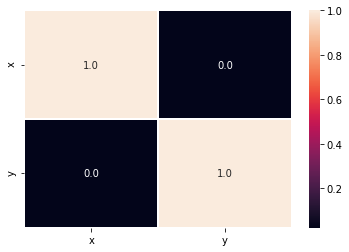

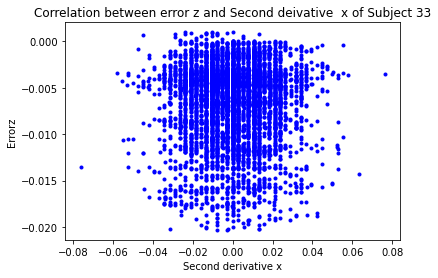

[[ 1.         -0.00287864]
 [-0.00287864  1.        ]]


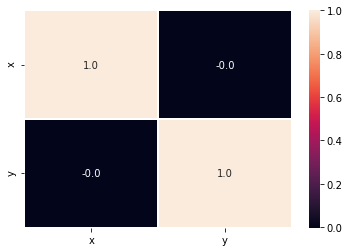

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


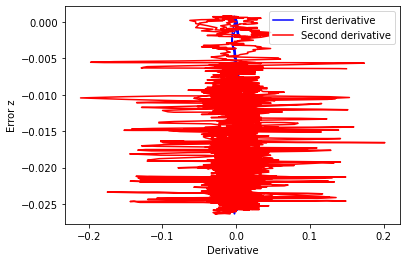

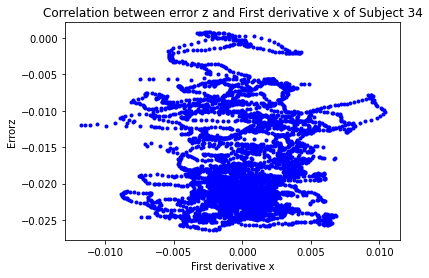

[[ 1.         -0.01638087]
 [-0.01638087  1.        ]]


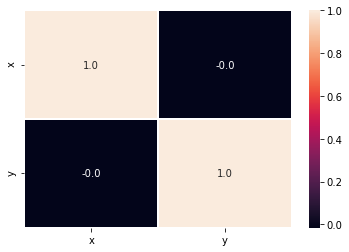

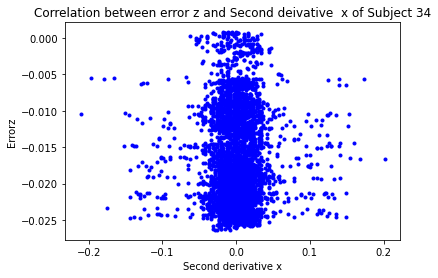

[[ 1.         -0.00352884]
 [-0.00352884  1.        ]]


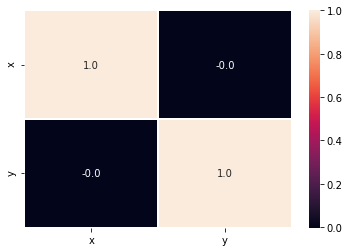

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


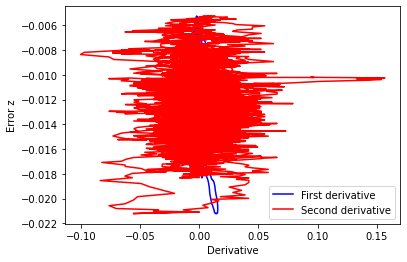

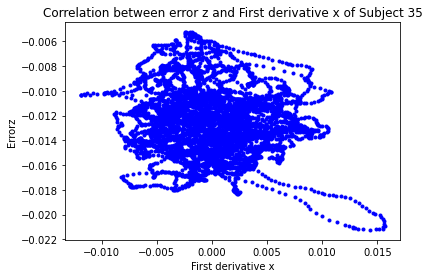

[[ 1.         -0.12591654]
 [-0.12591654  1.        ]]


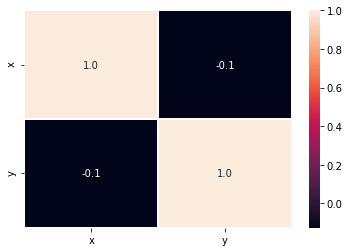

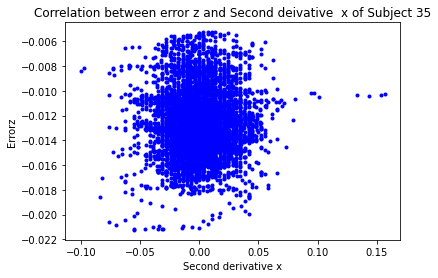

[[1.        0.0134588]
 [0.0134588 1.       ]]


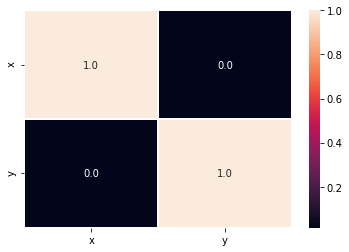

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


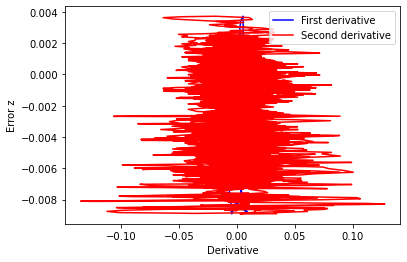

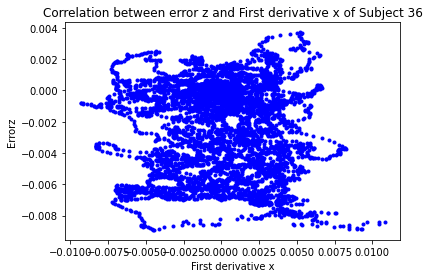

[[ 1.         -0.05916365]
 [-0.05916365  1.        ]]


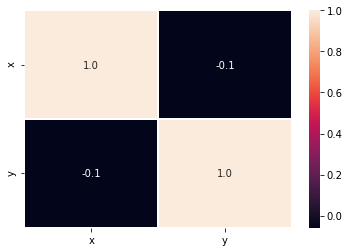

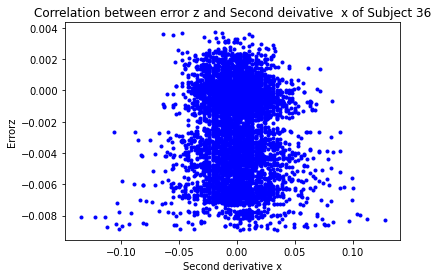

[[ 1.         -0.04208511]
 [-0.04208511  1.        ]]


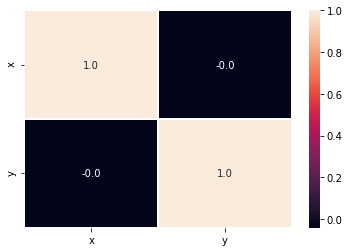

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


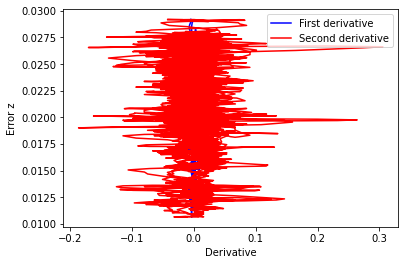

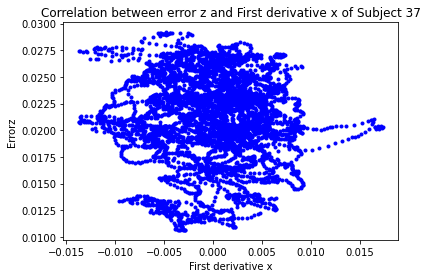

[[ 1.         -0.02762366]
 [-0.02762366  1.        ]]


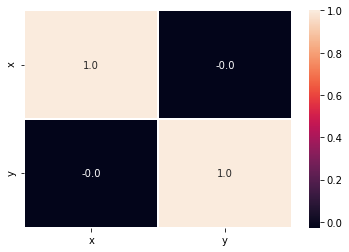

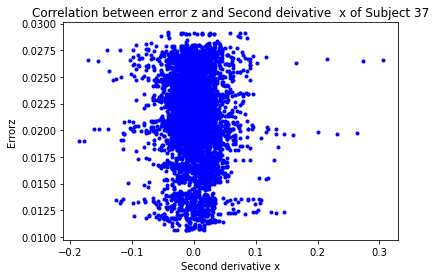

[[ 1.         -0.05319106]
 [-0.05319106  1.        ]]


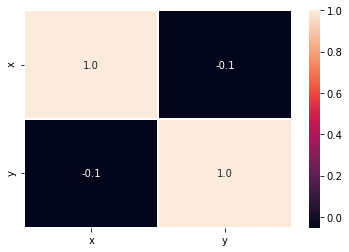

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


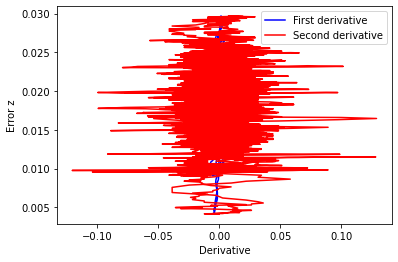

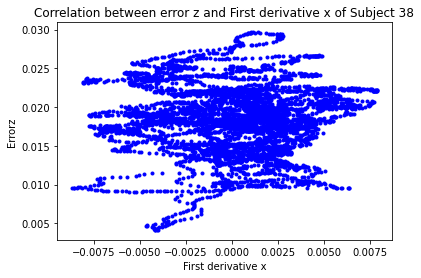

[[ 1.         -0.00158575]
 [-0.00158575  1.        ]]


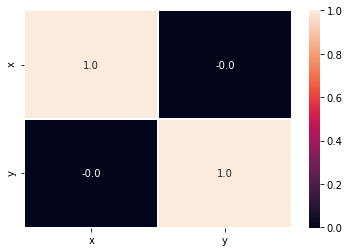

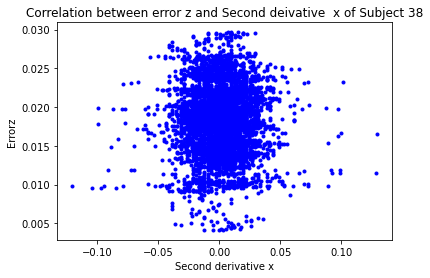

[[1.         0.00209314]
 [0.00209314 1.        ]]


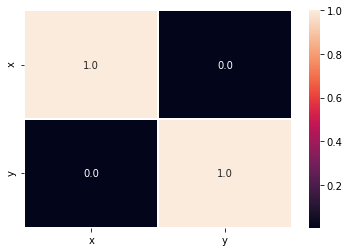

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


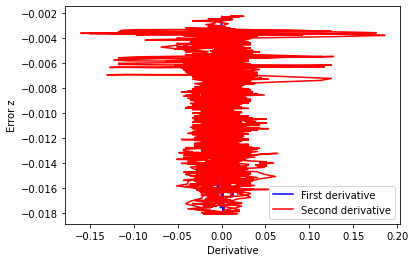

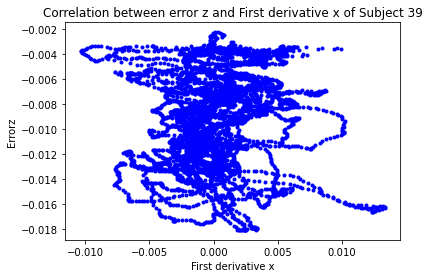

[[1.         0.04808486]
 [0.04808486 1.        ]]


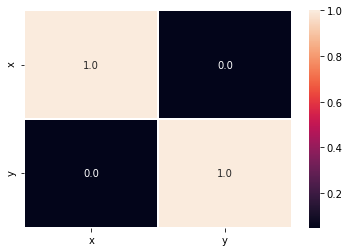

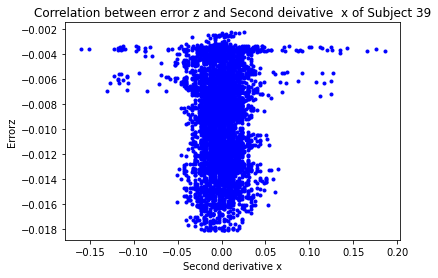

[[ 1.         -0.00266228]
 [-0.00266228  1.        ]]


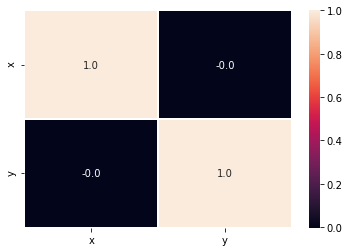

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


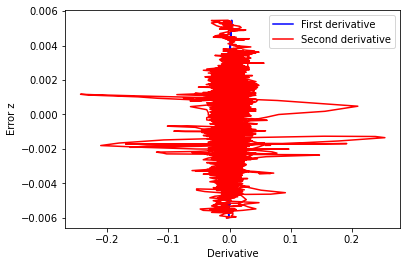

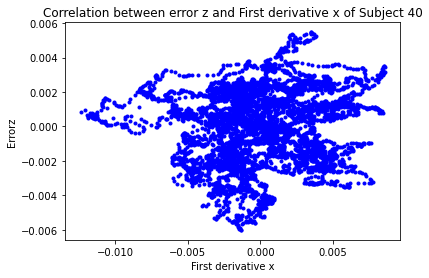

[[1.         0.08374387]
 [0.08374387 1.        ]]


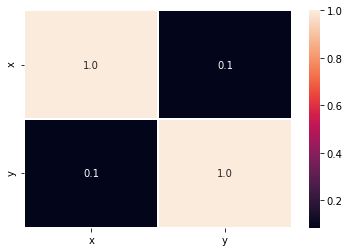

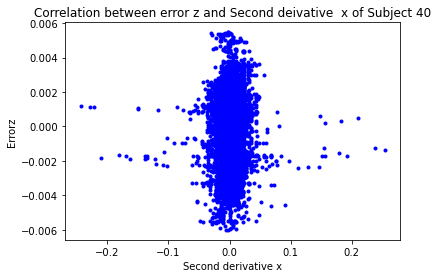

[[1.         0.00216964]
 [0.00216964 1.        ]]


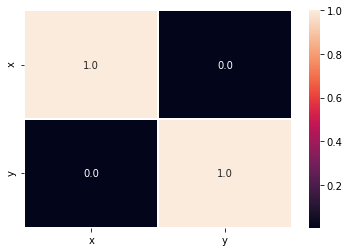

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


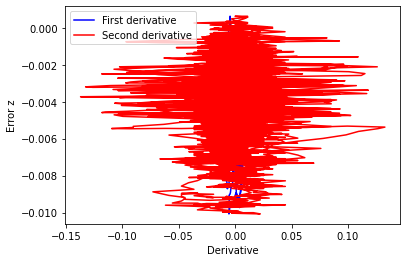

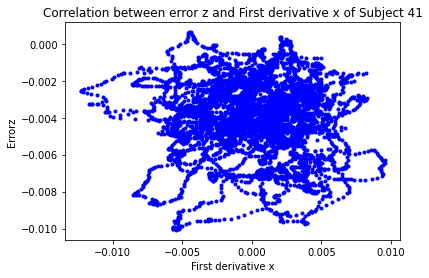

[[ 1.         -0.04565074]
 [-0.04565074  1.        ]]


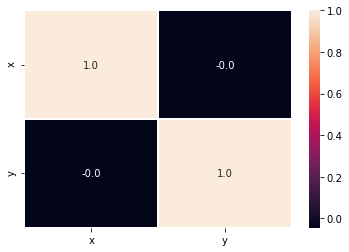

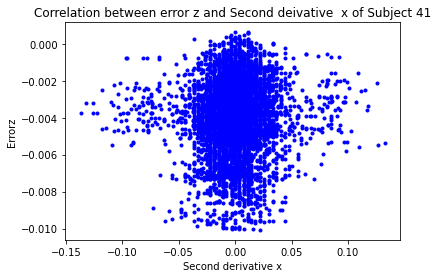

[[1.         0.04485297]
 [0.04485297 1.        ]]


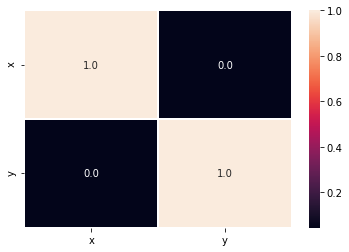

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


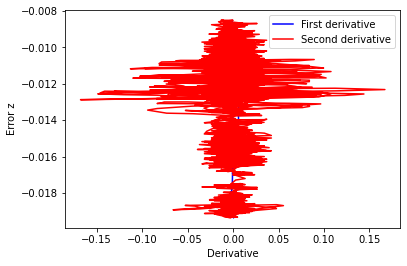

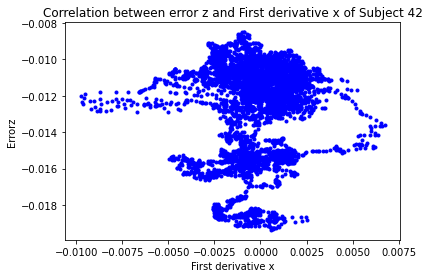

[[1.         0.08572381]
 [0.08572381 1.        ]]


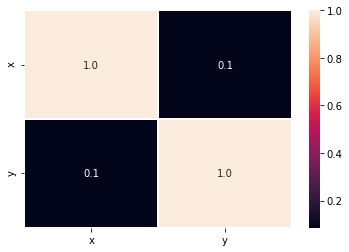

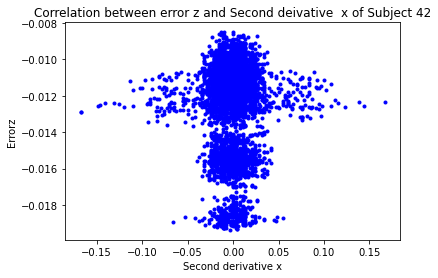

[[1.         0.00377299]
 [0.00377299 1.        ]]


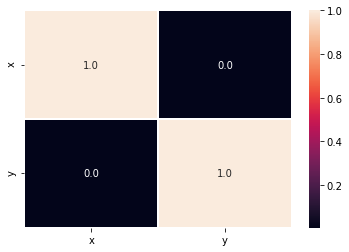

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


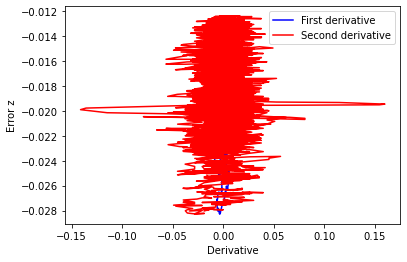

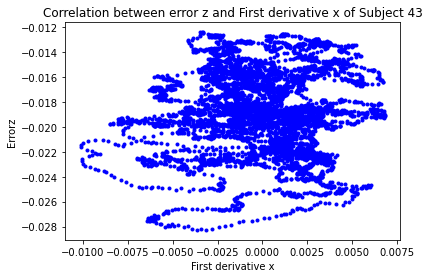

[[1.         0.05226641]
 [0.05226641 1.        ]]


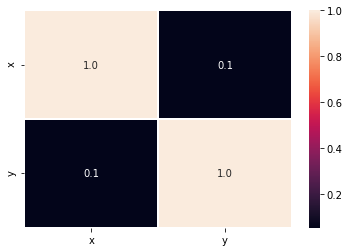

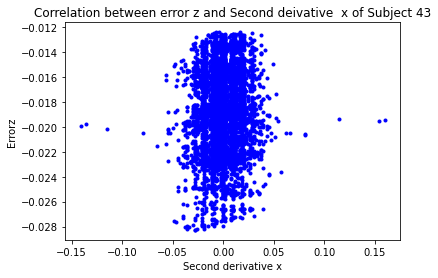

[[1.         0.05415614]
 [0.05415614 1.        ]]


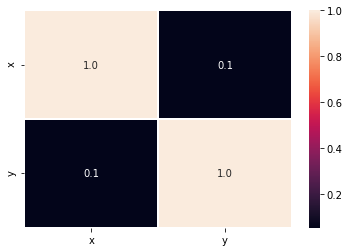

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


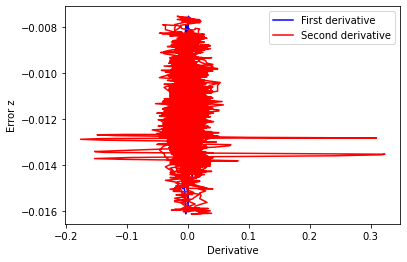

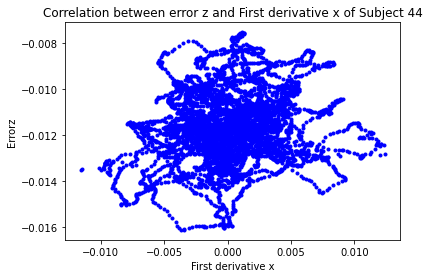

[[1.         0.15562318]
 [0.15562318 1.        ]]


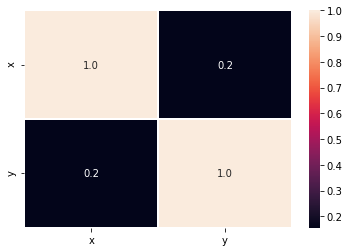

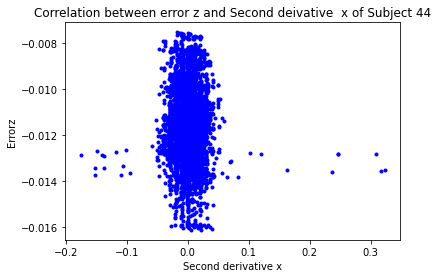

[[ 1.        -0.0089097]
 [-0.0089097  1.       ]]


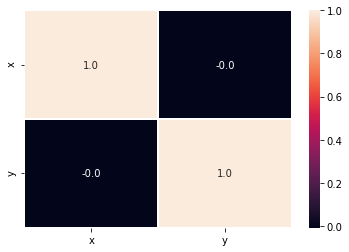

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


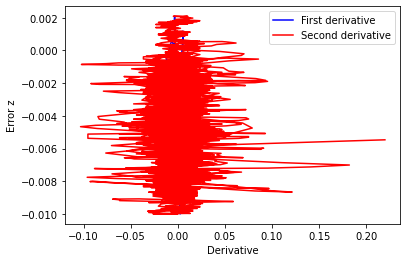

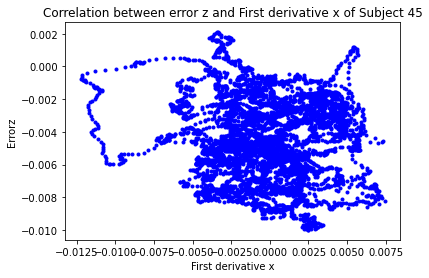

[[ 1.         -0.08385619]
 [-0.08385619  1.        ]]


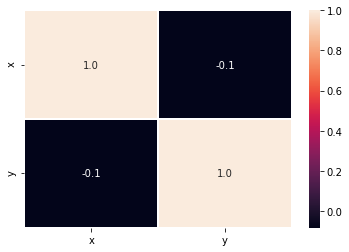

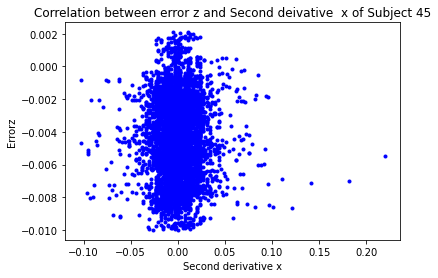

[[1.         0.00746645]
 [0.00746645 1.        ]]


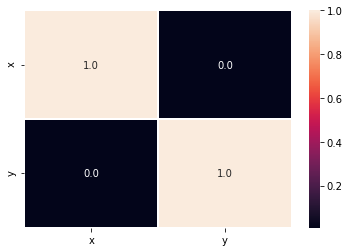

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


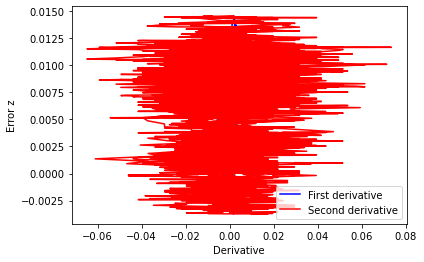

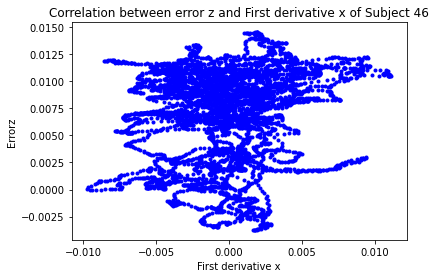

[[1.         0.14256315]
 [0.14256315 1.        ]]


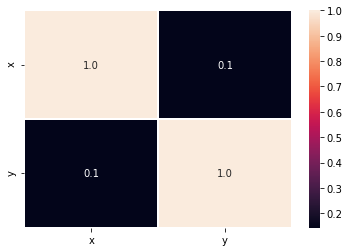

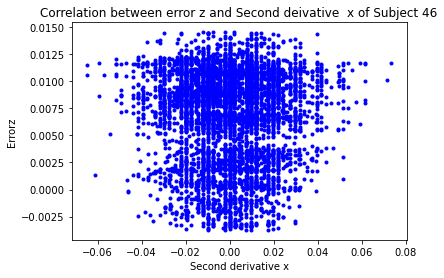

[[ 1.         -0.00732388]
 [-0.00732388  1.        ]]


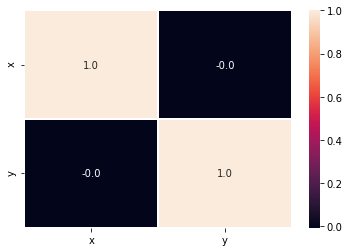

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


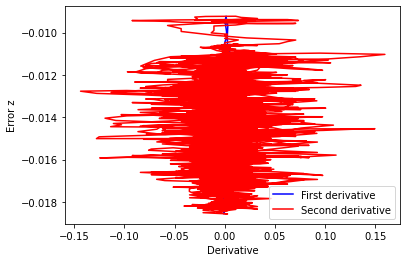

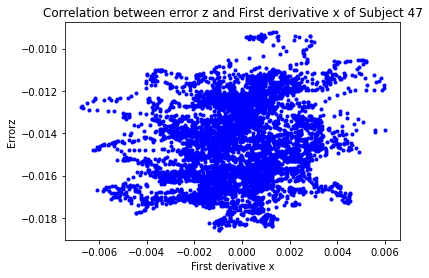

[[1.         0.17616119]
 [0.17616119 1.        ]]


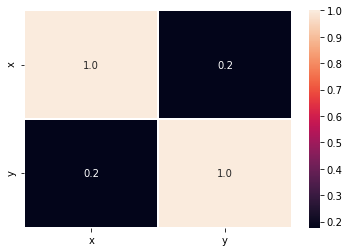

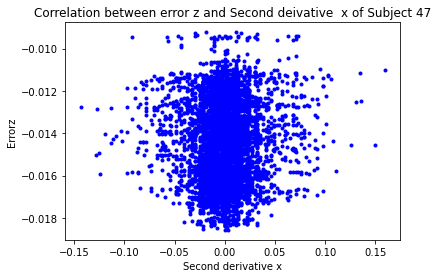

[[1.         0.02346829]
 [0.02346829 1.        ]]


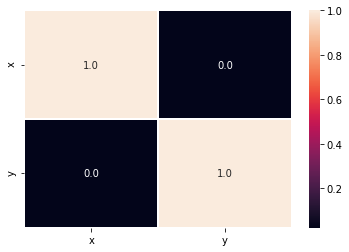

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


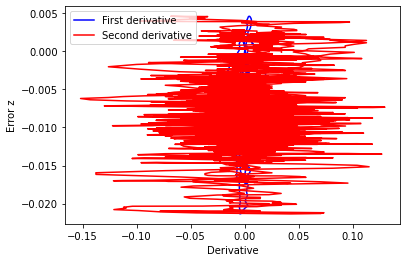

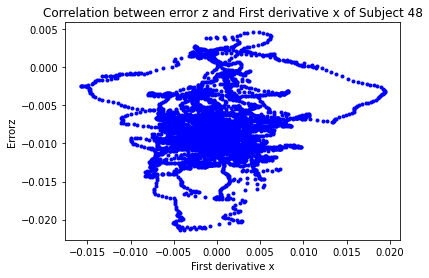

[[1.         0.07984929]
 [0.07984929 1.        ]]


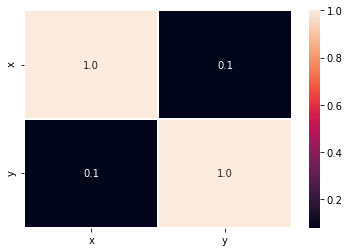

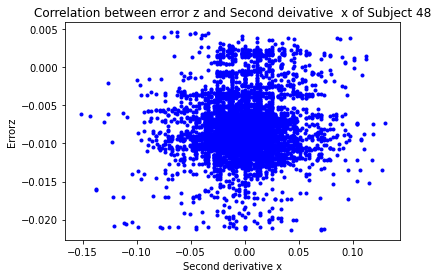

[[1.         0.05843924]
 [0.05843924 1.        ]]


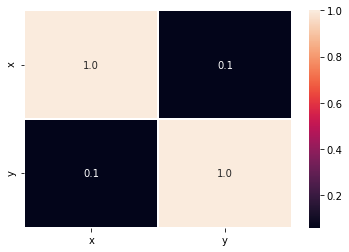

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


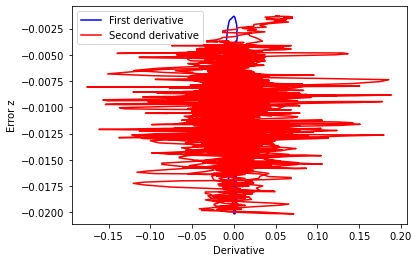

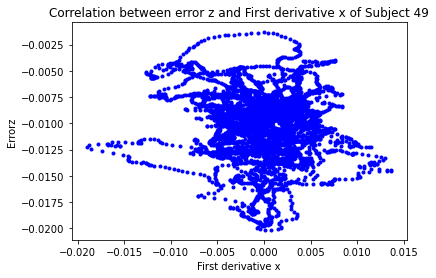

[[ 1.         -0.10376279]
 [-0.10376279  1.        ]]


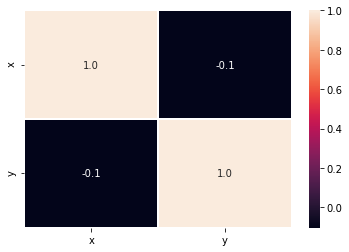

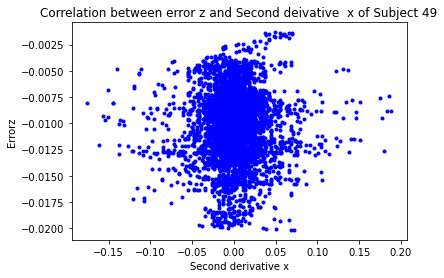

[[1.         0.01510767]
 [0.01510767 1.        ]]


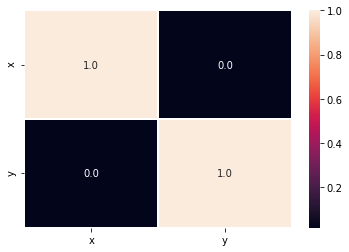

In [13]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(d1x,errorz,color='blue',label='First derivative')
    plt.plot(d2x,errorz,color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()
    data={'x':d1x,
         'y': errorz,
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("First derivative x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and First derivative x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d1x,errorz)
    print(r)
    plt.figure()
    data={'x':d1x,
         'y': errorz,
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':d2x,
         'y': errorz,
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Second derivative x")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Second deivative  x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d2x,errorz)
    print(r)
    plt.figure()
    data={'x':d2x,
         'y': errorz,
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between errorz and first and second derivative of z

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


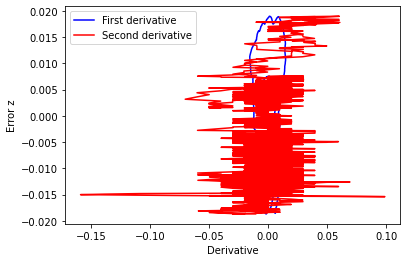

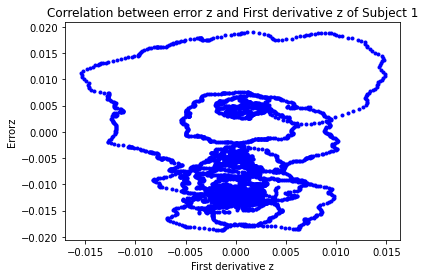

[[ 1.         -0.01124933]
 [-0.01124933  1.        ]]


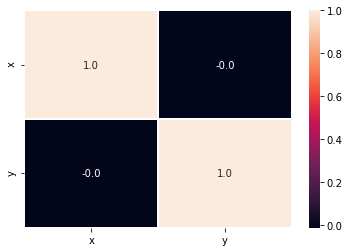

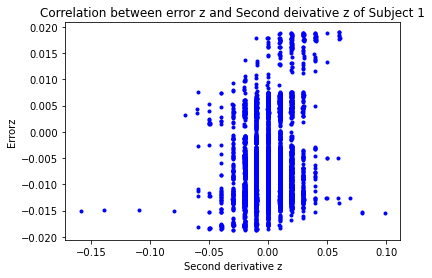

[[1.        0.1747635]
 [0.1747635 1.       ]]


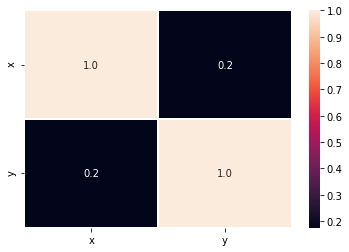

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


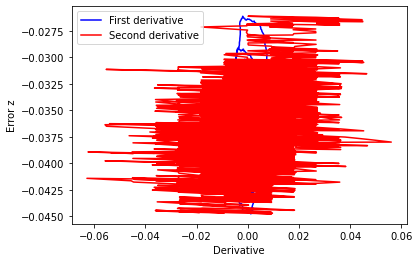

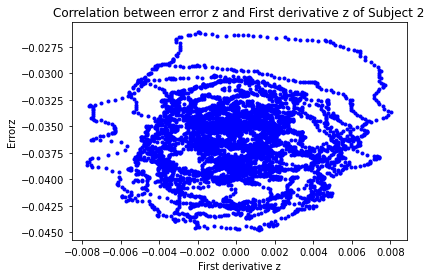

[[ 1.         -0.00998595]
 [-0.00998595  1.        ]]


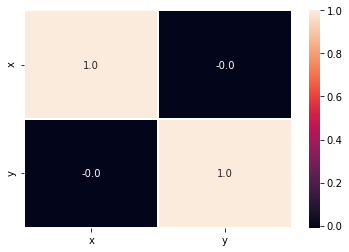

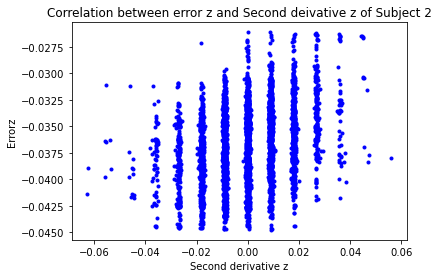

[[1.         0.29423845]
 [0.29423845 1.        ]]


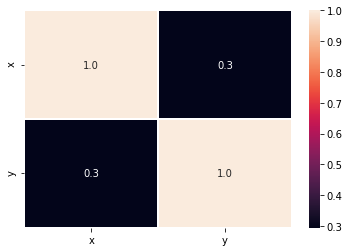

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


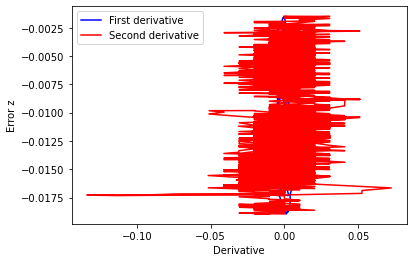

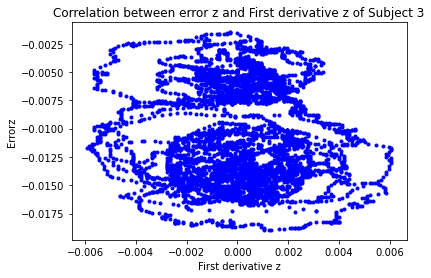

[[ 1.        -0.0399617]
 [-0.0399617  1.       ]]


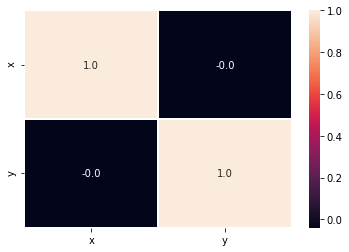

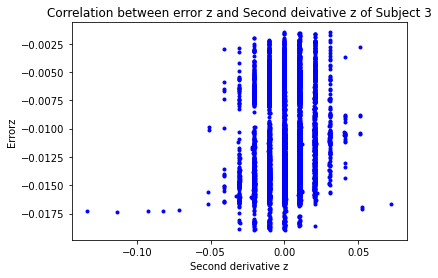

[[1.         0.14321194]
 [0.14321194 1.        ]]


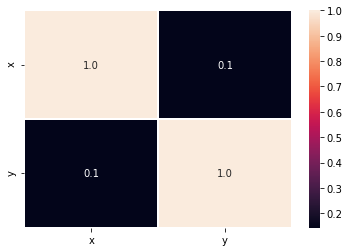

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


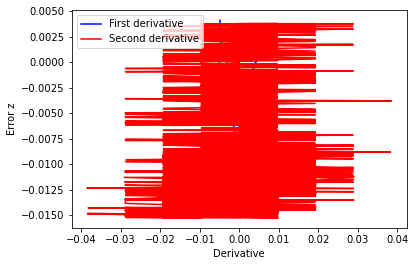

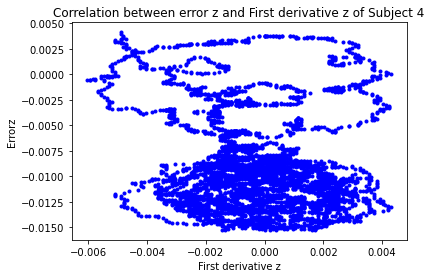

[[ 1.         -0.15795385]
 [-0.15795385  1.        ]]


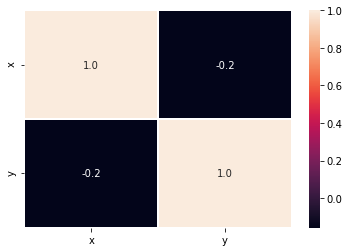

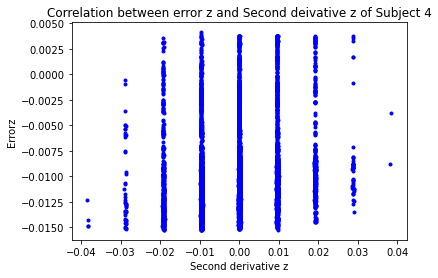

[[1.         0.10822014]
 [0.10822014 1.        ]]


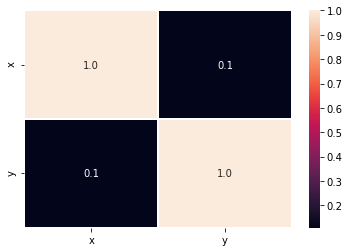

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


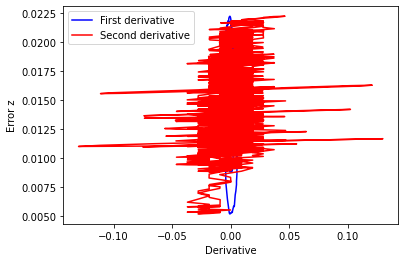

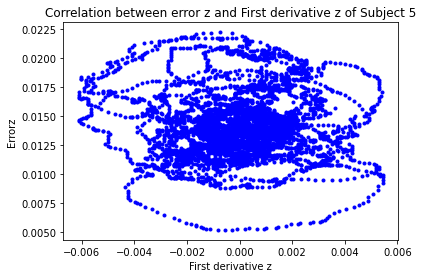

[[1.         0.01159279]
 [0.01159279 1.        ]]


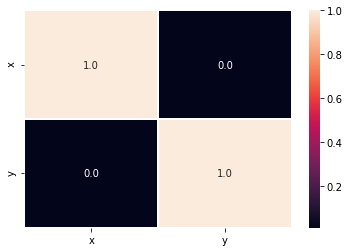

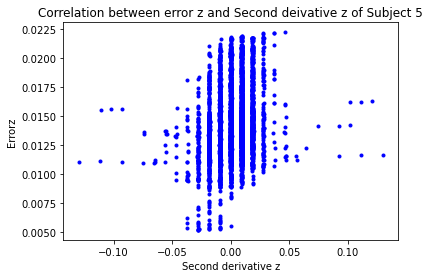

[[1.         0.22329878]
 [0.22329878 1.        ]]


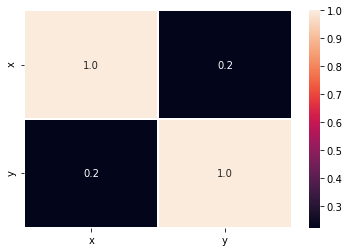

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


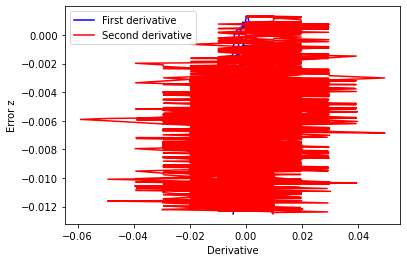

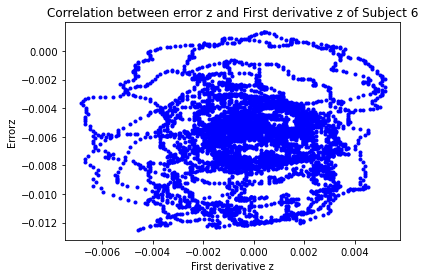

[[1.         0.03837107]
 [0.03837107 1.        ]]


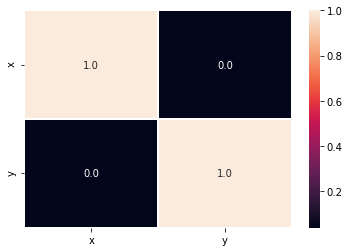

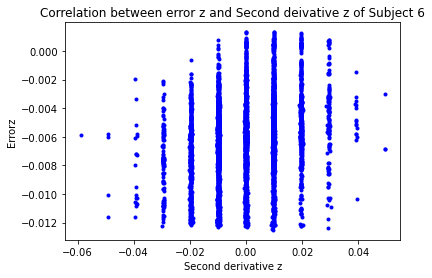

[[1.         0.24550219]
 [0.24550219 1.        ]]


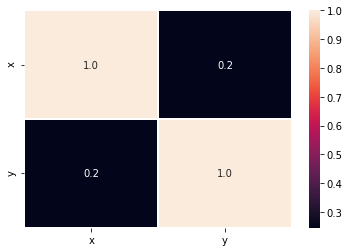

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


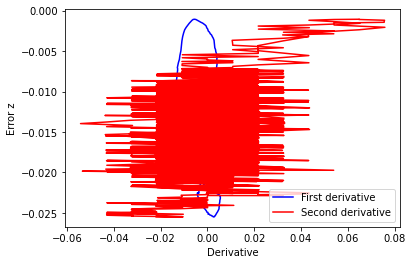

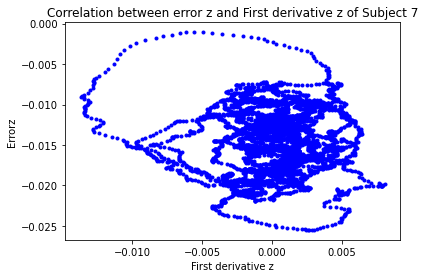

[[ 1.         -0.00964788]
 [-0.00964788  1.        ]]


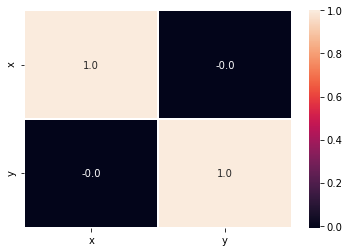

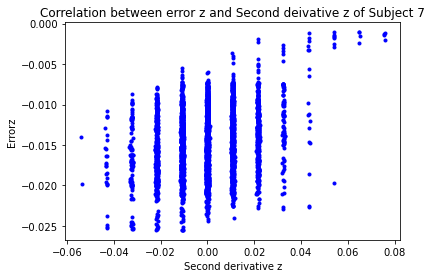

[[1.         0.22946282]
 [0.22946282 1.        ]]


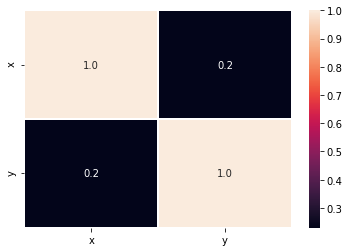

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


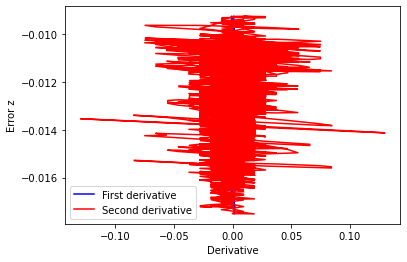

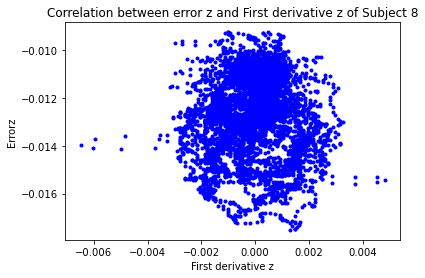

[[ 1.         -0.00155999]
 [-0.00155999  1.        ]]


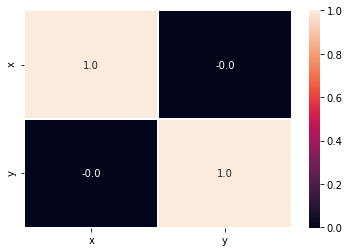

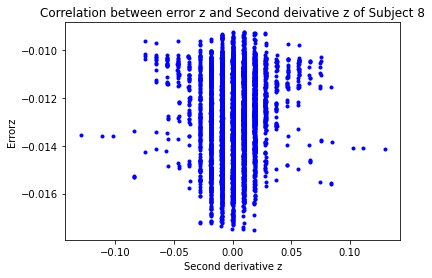

[[1.         0.06917387]
 [0.06917387 1.        ]]


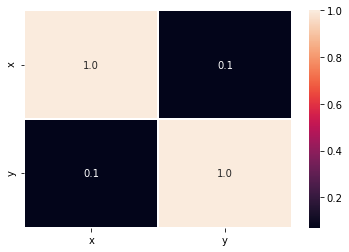

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


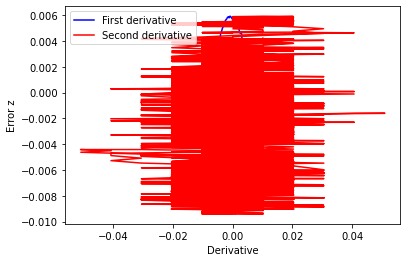

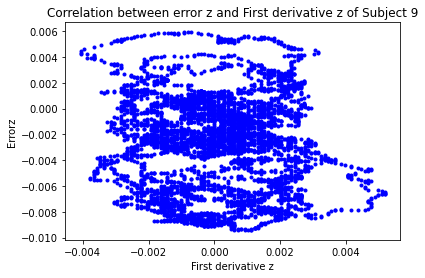

[[ 1.         -0.04827056]
 [-0.04827056  1.        ]]


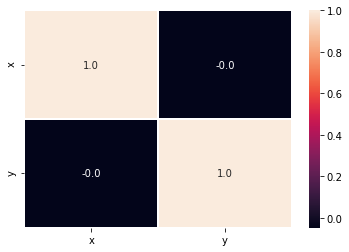

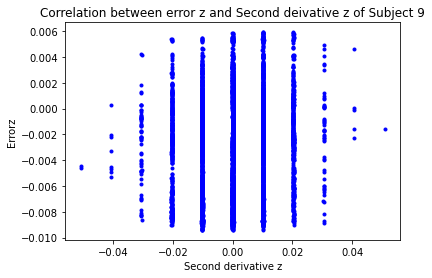

[[1.         0.09069274]
 [0.09069274 1.        ]]


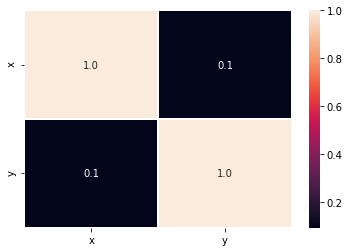

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


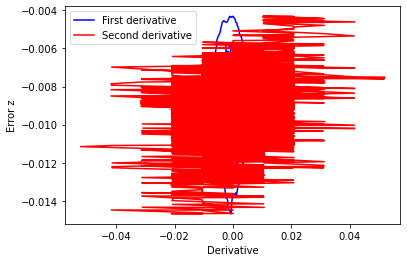

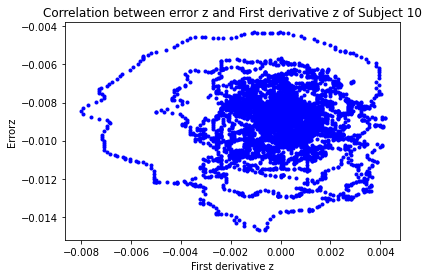

[[ 1.         -0.01408967]
 [-0.01408967  1.        ]]


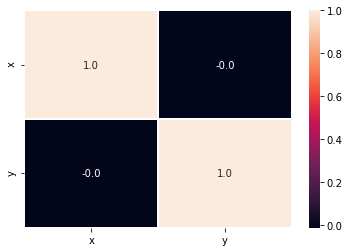

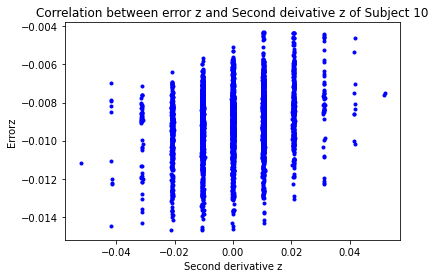

[[1.       0.218305]
 [0.218305 1.      ]]


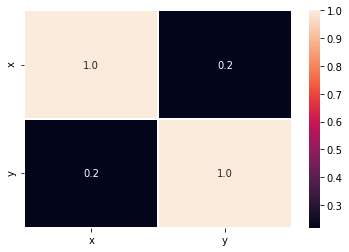

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


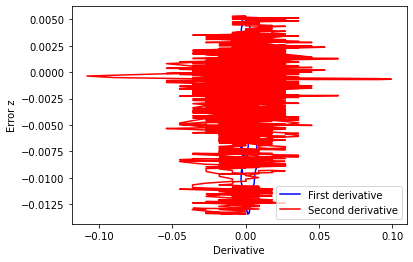

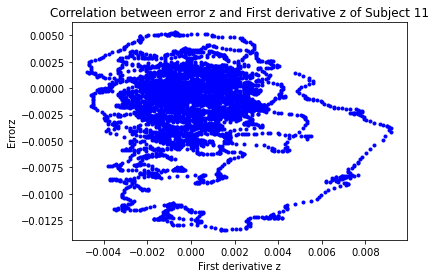

[[ 1.         -0.01551354]
 [-0.01551354  1.        ]]


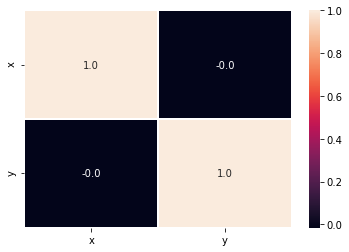

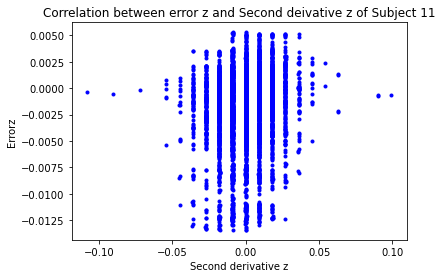

[[1.         0.12501356]
 [0.12501356 1.        ]]


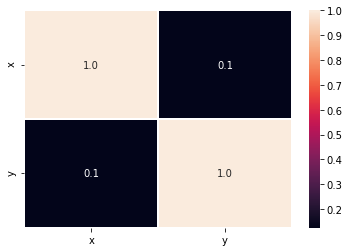

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


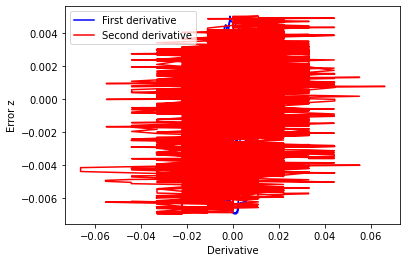

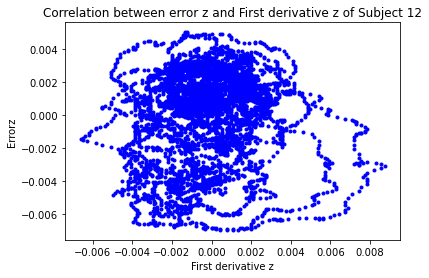

[[1.         0.06857312]
 [0.06857312 1.        ]]


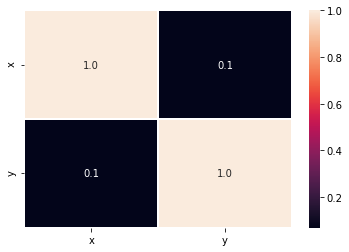

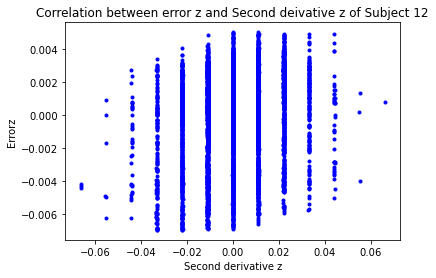

[[1.         0.17714753]
 [0.17714753 1.        ]]


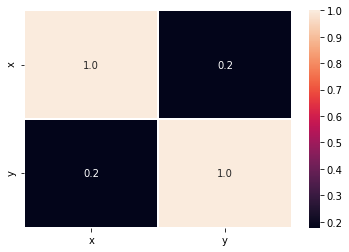

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


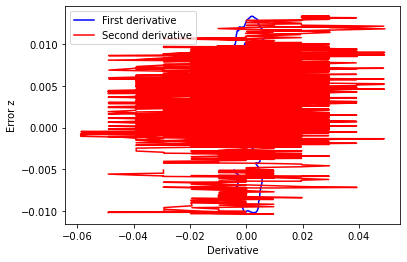

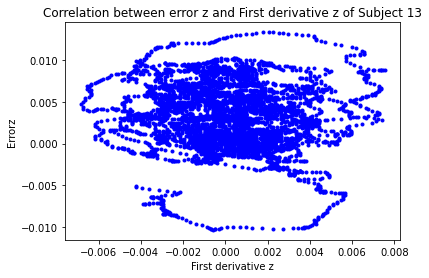

[[ 1.         -0.09183307]
 [-0.09183307  1.        ]]


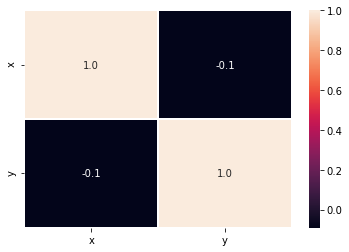

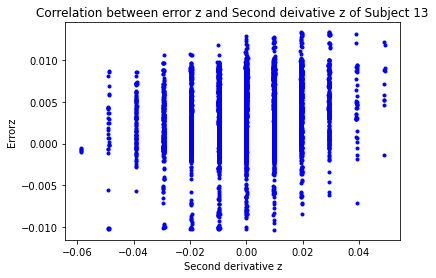

[[1.        0.1718675]
 [0.1718675 1.       ]]


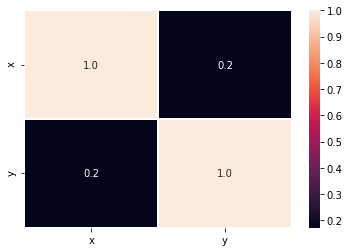

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


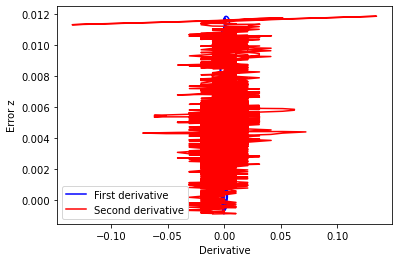

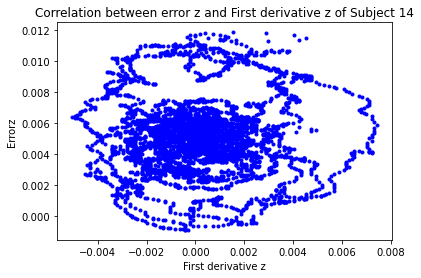

[[1.         0.03909772]
 [0.03909772 1.        ]]


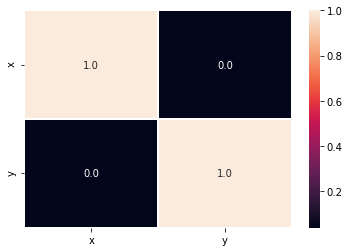

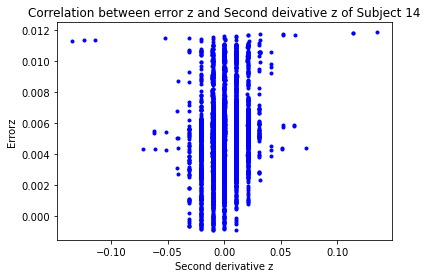

[[1.         0.19729067]
 [0.19729067 1.        ]]


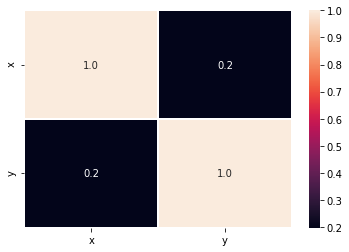

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


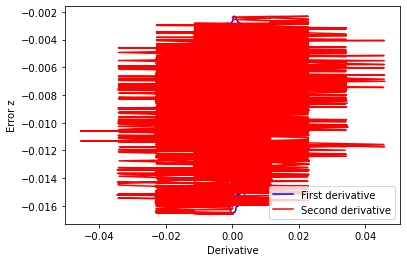

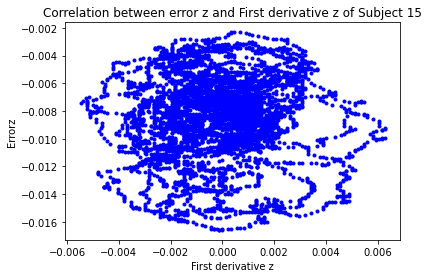

[[1.         0.01494918]
 [0.01494918 1.        ]]


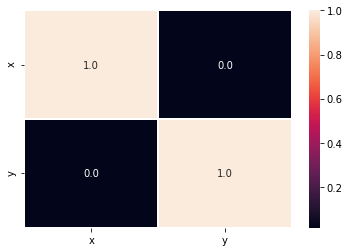

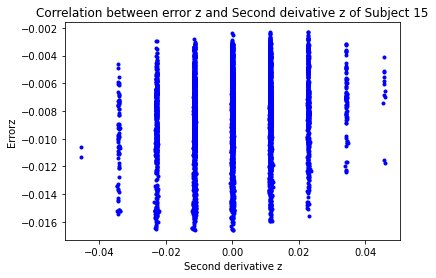

[[1.         0.18718754]
 [0.18718754 1.        ]]


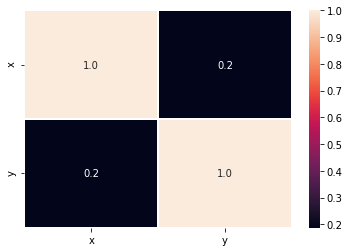

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


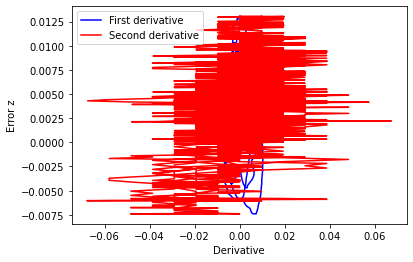

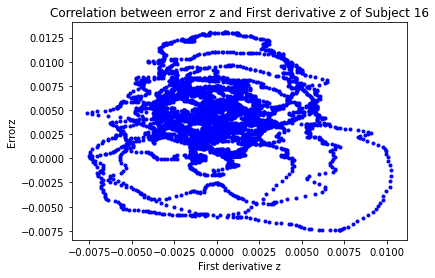

[[ 1.         -0.01119711]
 [-0.01119711  1.        ]]


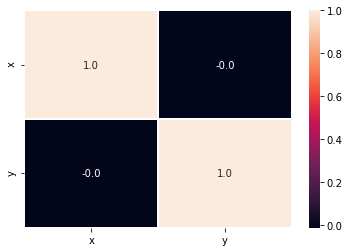

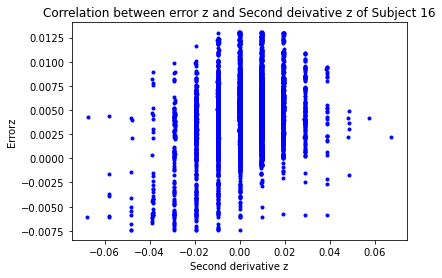

[[1.         0.28494531]
 [0.28494531 1.        ]]


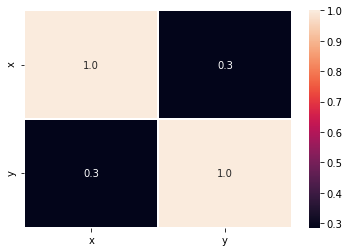

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


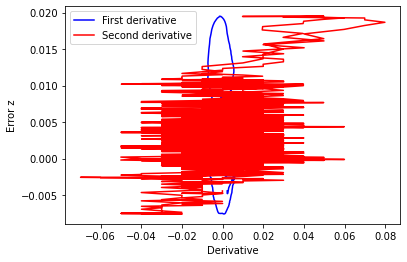

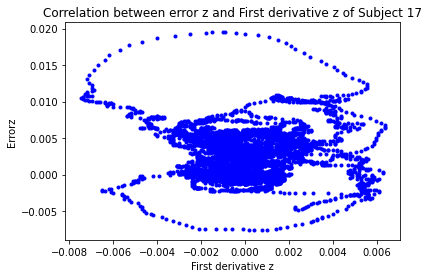

[[ 1.         -0.04300968]
 [-0.04300968  1.        ]]


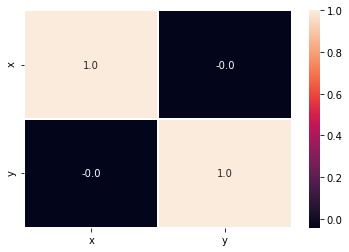

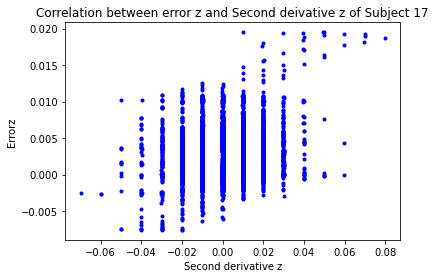

[[1.         0.18432437]
 [0.18432437 1.        ]]


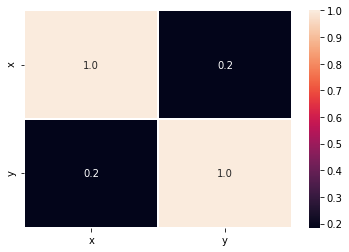

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


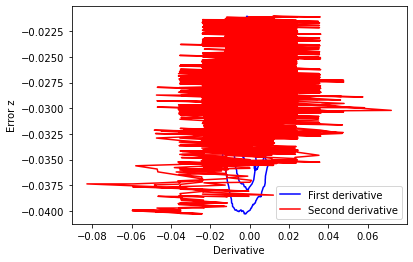

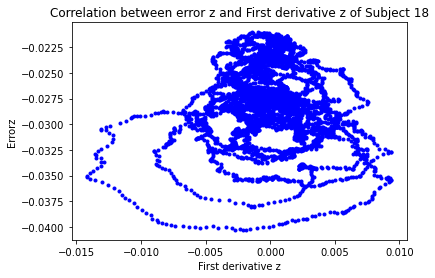

[[ 1.         -0.04318447]
 [-0.04318447  1.        ]]


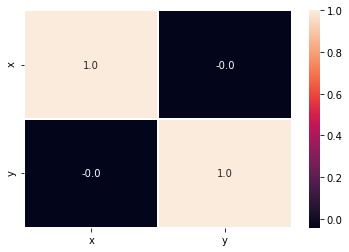

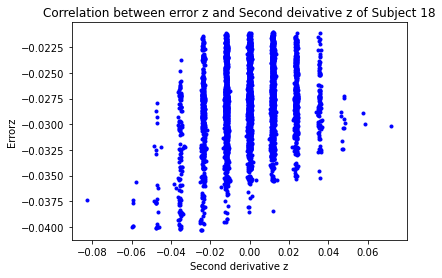

[[1.         0.22226801]
 [0.22226801 1.        ]]


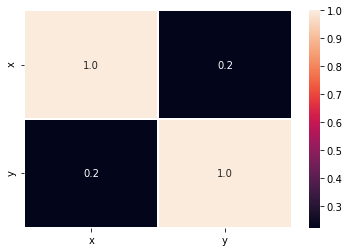

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


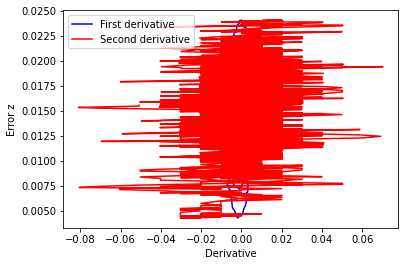

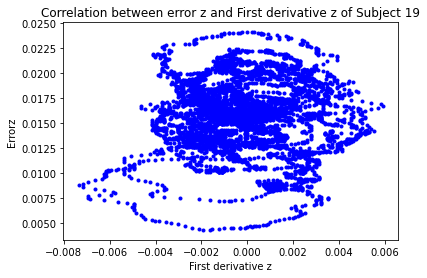

[[1.         0.00176273]
 [0.00176273 1.        ]]


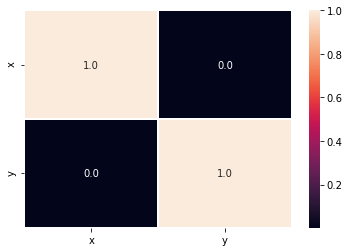

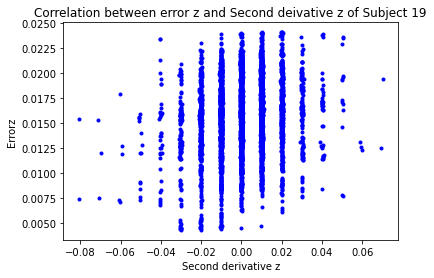

[[1.         0.15987344]
 [0.15987344 1.        ]]


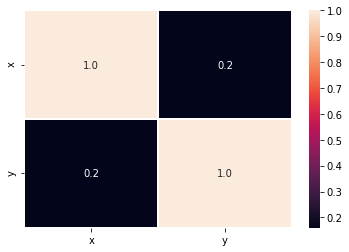

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


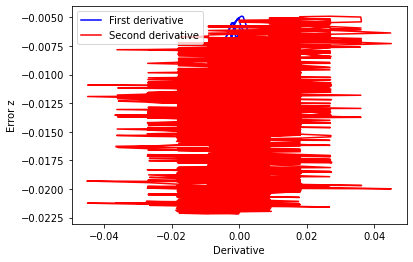

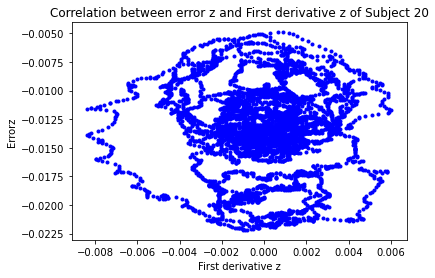

[[ 1.         -0.00493421]
 [-0.00493421  1.        ]]


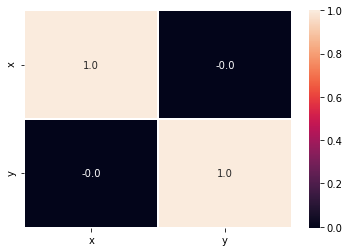

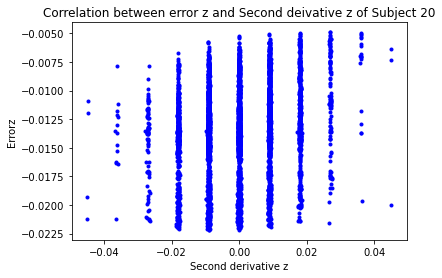

[[1.         0.20175817]
 [0.20175817 1.        ]]


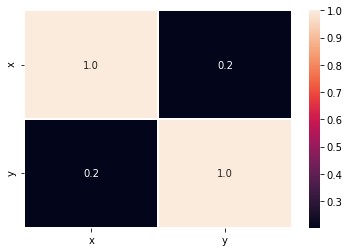

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


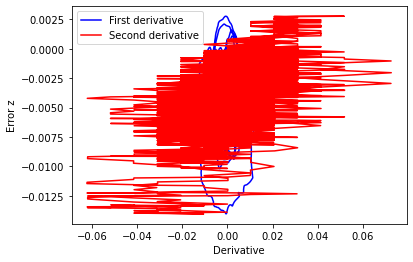

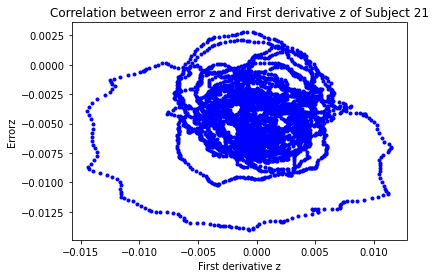

[[ 1.         -0.03404609]
 [-0.03404609  1.        ]]


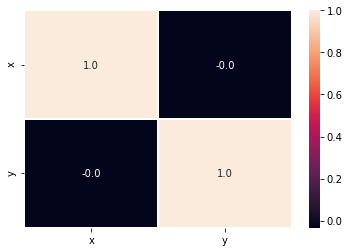

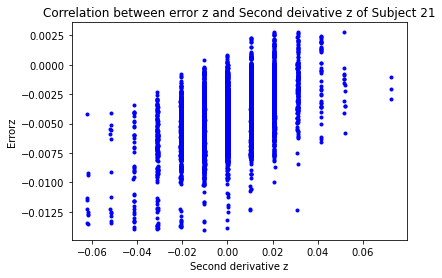

[[1.         0.47603074]
 [0.47603074 1.        ]]


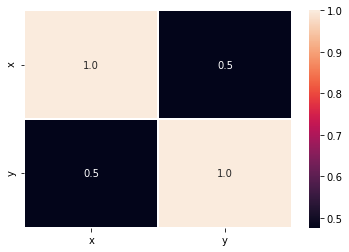

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


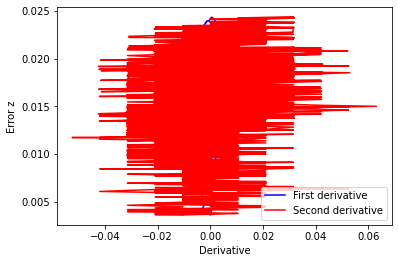

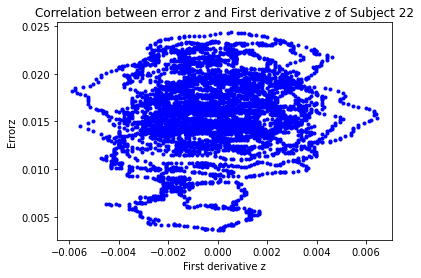

[[1.         0.11124048]
 [0.11124048 1.        ]]


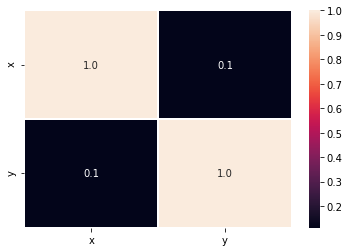

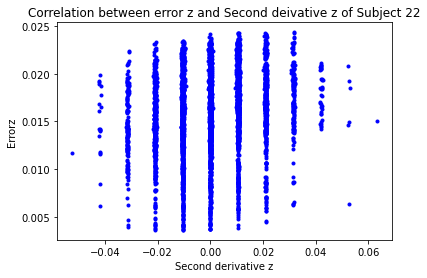

[[1.         0.18930826]
 [0.18930826 1.        ]]


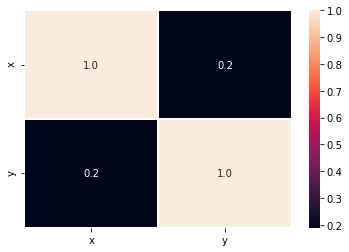

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


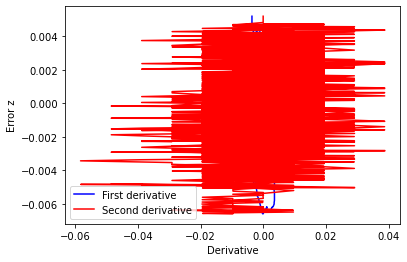

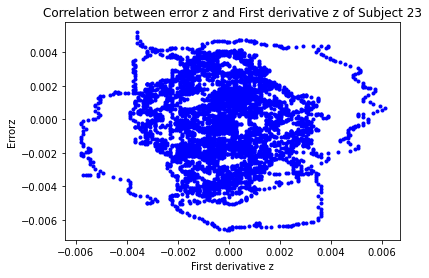

[[ 1.         -0.03171671]
 [-0.03171671  1.        ]]


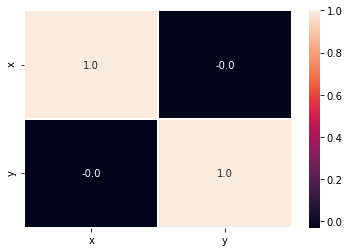

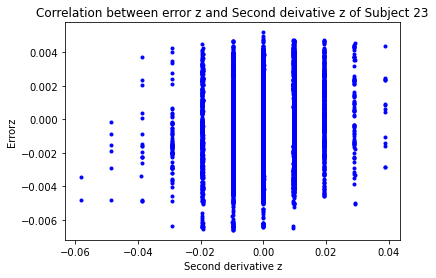

[[1.         0.16232158]
 [0.16232158 1.        ]]


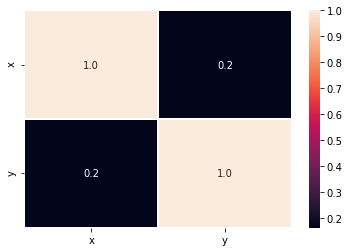

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


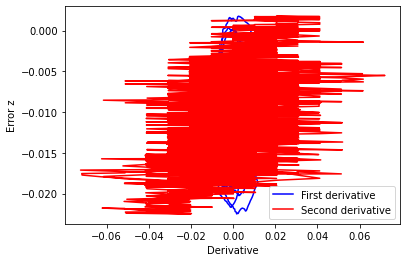

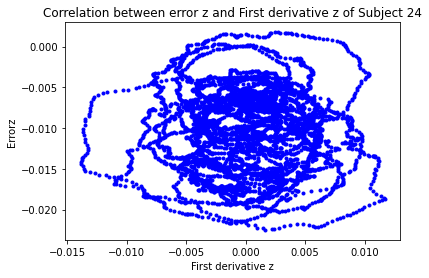

[[ 1.         -0.00667278]
 [-0.00667278  1.        ]]


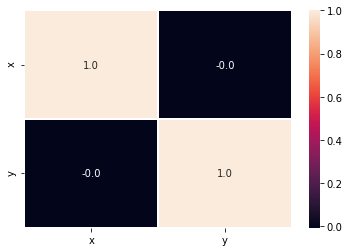

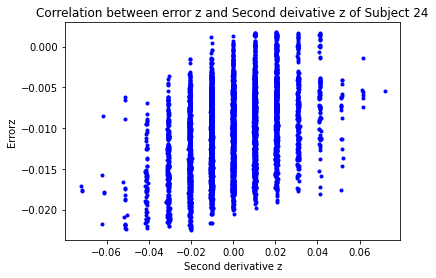

[[1.         0.35780176]
 [0.35780176 1.        ]]


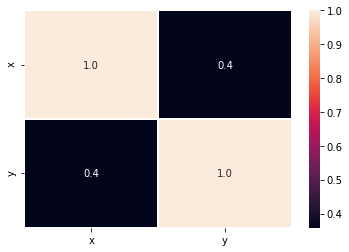

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


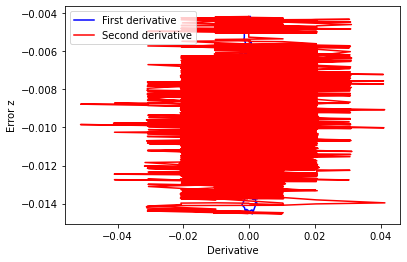

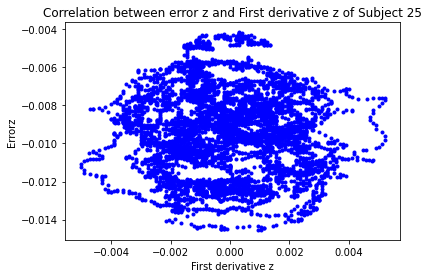

[[ 1.         -0.04696105]
 [-0.04696105  1.        ]]


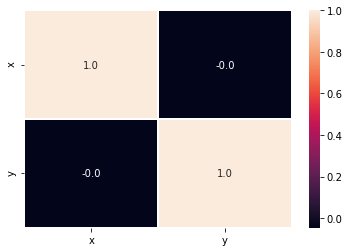

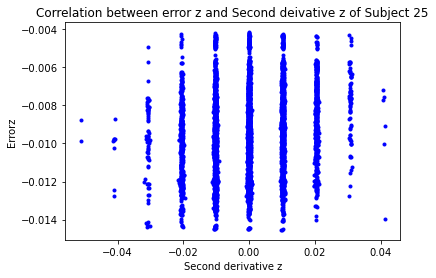

[[1.         0.17376204]
 [0.17376204 1.        ]]


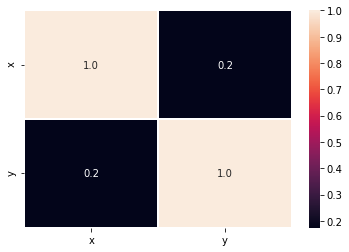

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


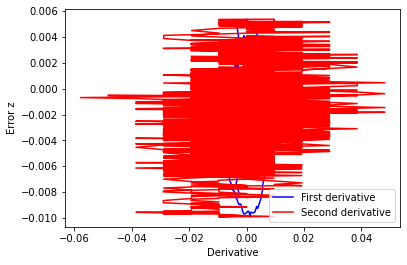

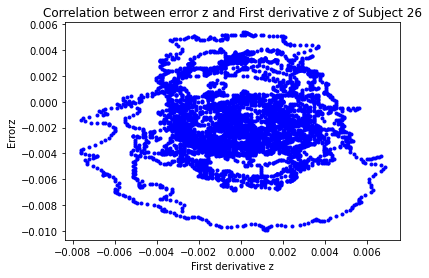

[[1.         0.00629041]
 [0.00629041 1.        ]]


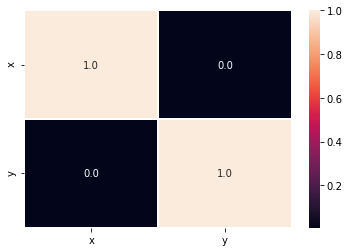

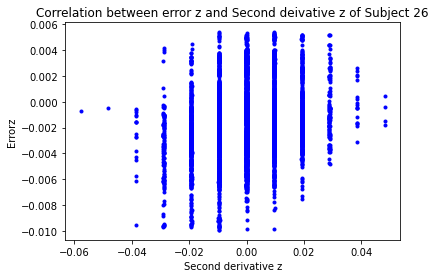

[[1.         0.25062487]
 [0.25062487 1.        ]]


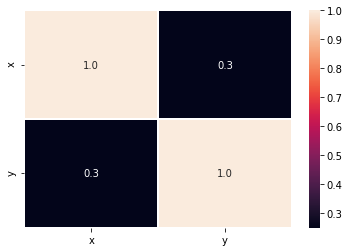

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


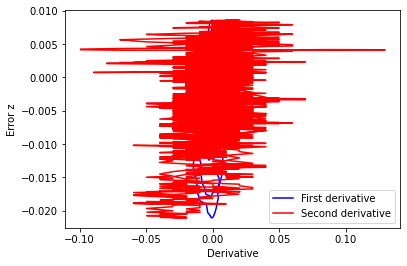

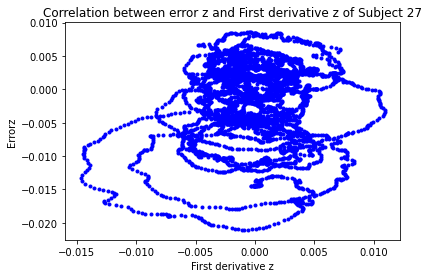

[[1.         0.05399117]
 [0.05399117 1.        ]]


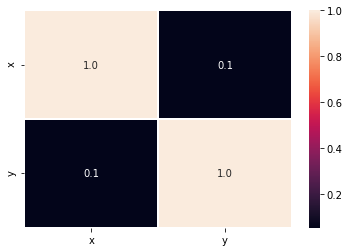

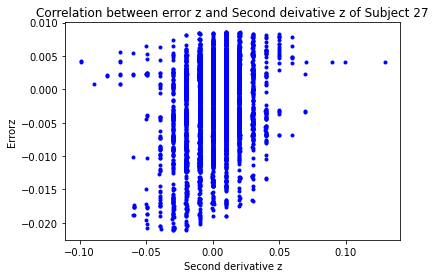

[[1.         0.22247554]
 [0.22247554 1.        ]]


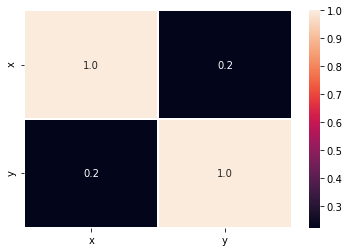

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


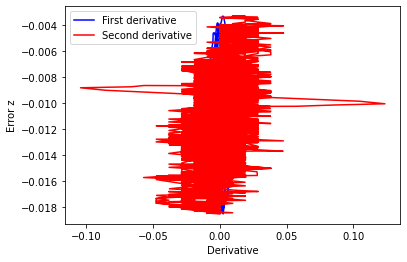

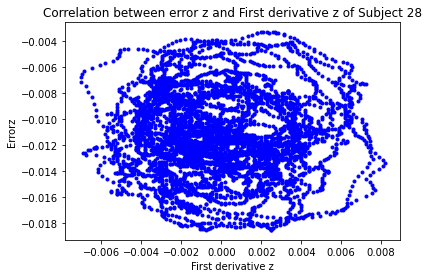

[[ 1.         -0.02956891]
 [-0.02956891  1.        ]]


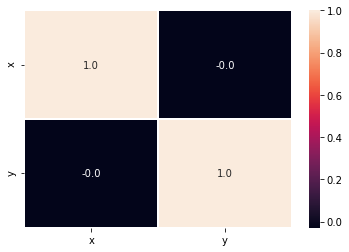

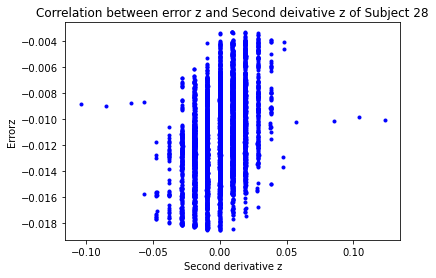

[[1.         0.39284048]
 [0.39284048 1.        ]]


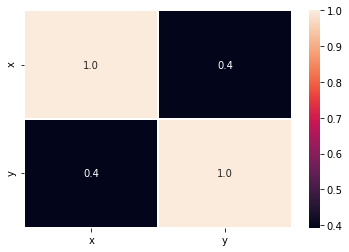

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


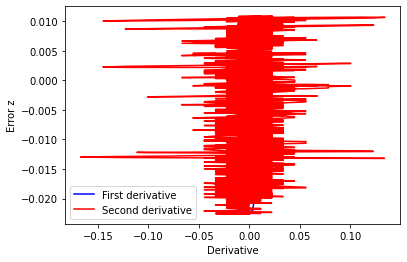

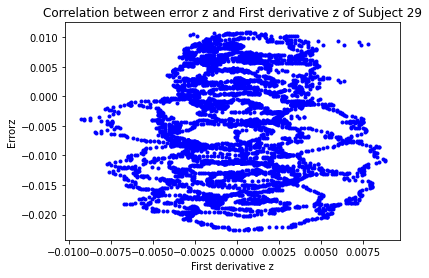

[[ 1.         -0.00776969]
 [-0.00776969  1.        ]]


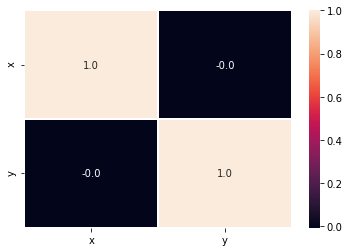

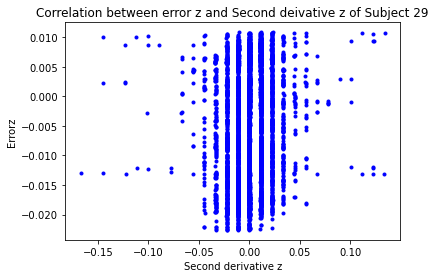

[[1.         0.07368083]
 [0.07368083 1.        ]]


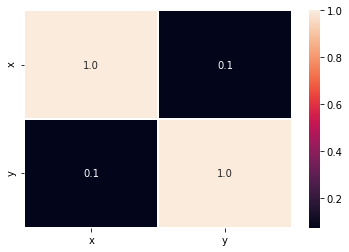

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


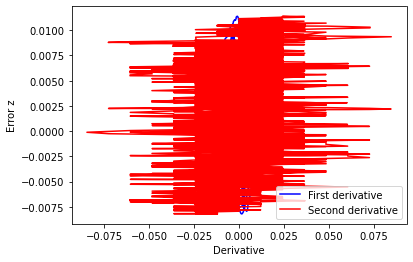

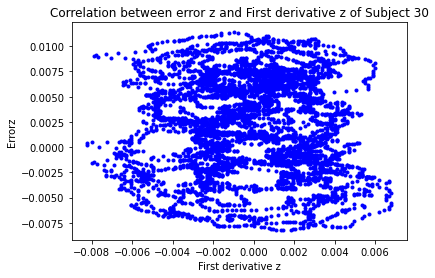

[[ 1.       -0.024872]
 [-0.024872  1.      ]]


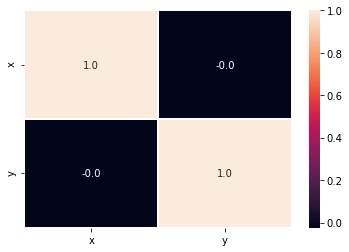

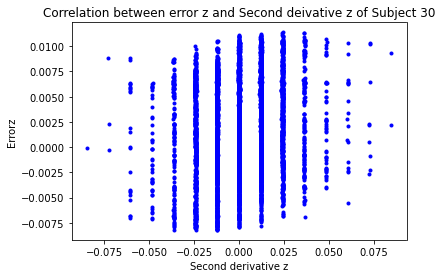

[[1.         0.13607148]
 [0.13607148 1.        ]]


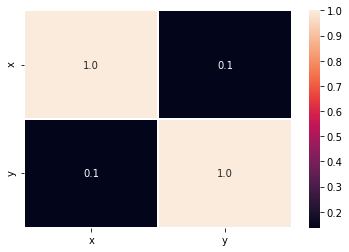

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


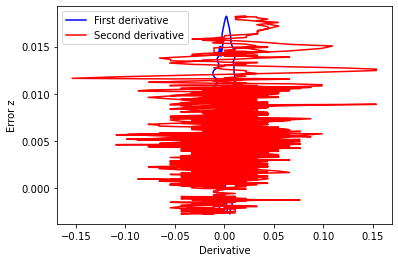

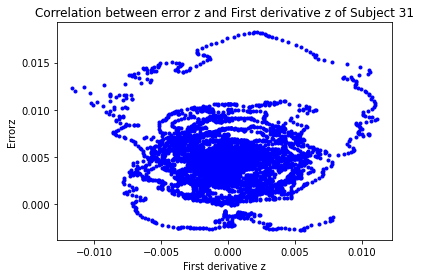

[[ 1.         -0.02578385]
 [-0.02578385  1.        ]]


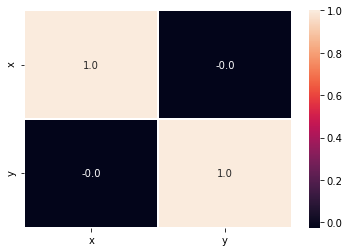

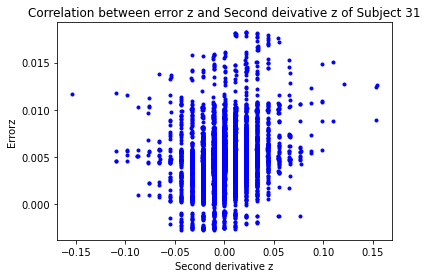

[[1.         0.24132541]
 [0.24132541 1.        ]]


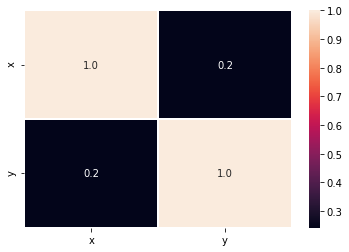

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


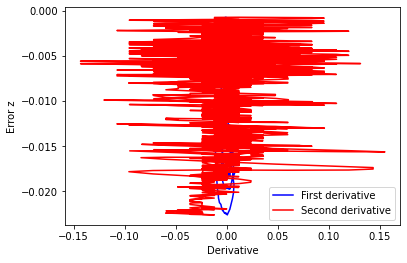

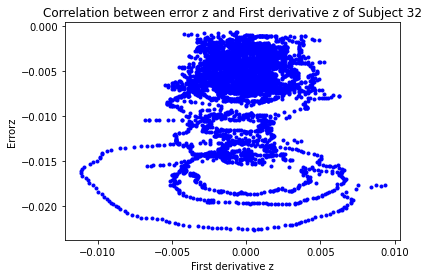

[[1.        0.0839564]
 [0.0839564 1.       ]]


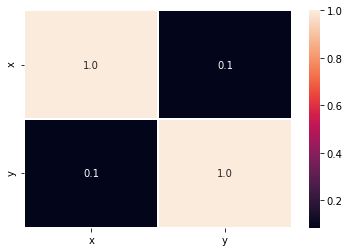

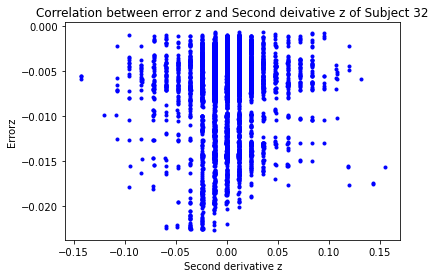

[[1.         0.07492568]
 [0.07492568 1.        ]]


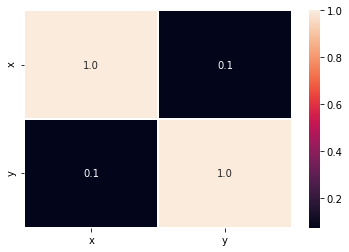

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


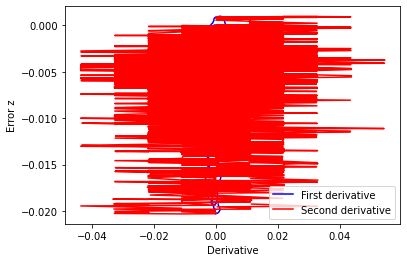

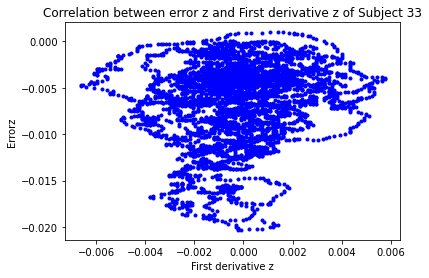

[[1.         0.16506278]
 [0.16506278 1.        ]]


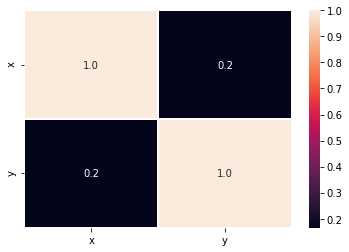

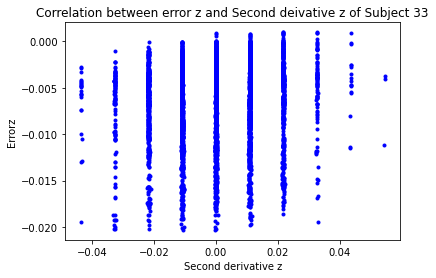

[[1.         0.10679782]
 [0.10679782 1.        ]]


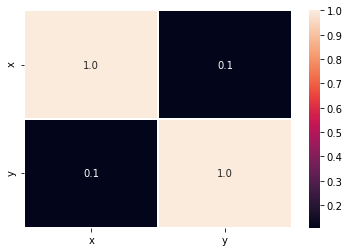

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


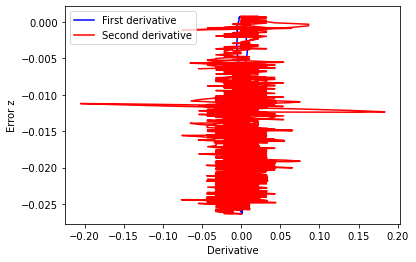

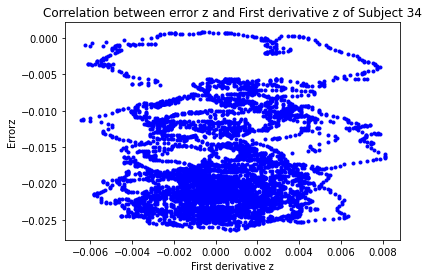

[[1.         0.08906202]
 [0.08906202 1.        ]]


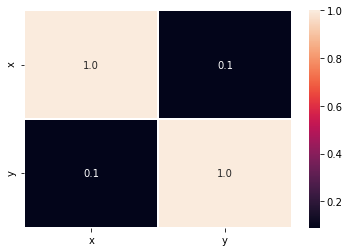

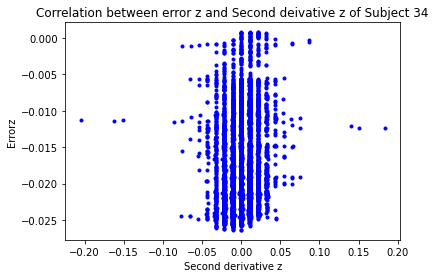

[[1.         0.11787494]
 [0.11787494 1.        ]]


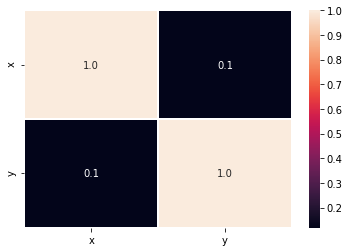

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


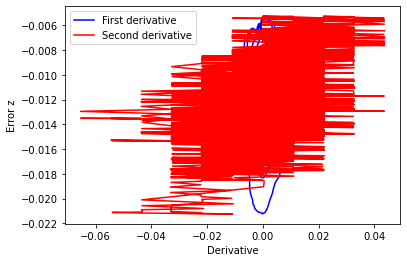

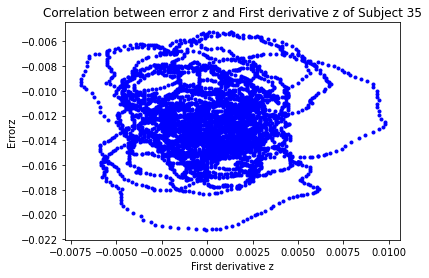

[[ 1.         -0.03533198]
 [-0.03533198  1.        ]]


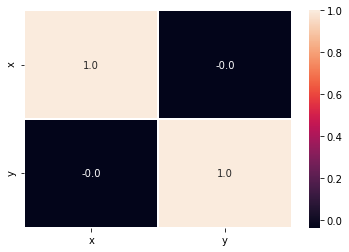

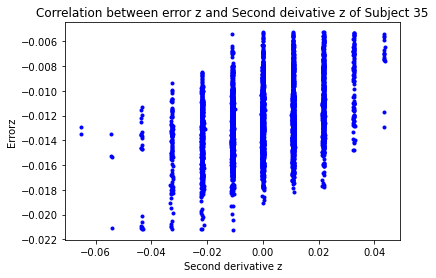

[[1.         0.35478983]
 [0.35478983 1.        ]]


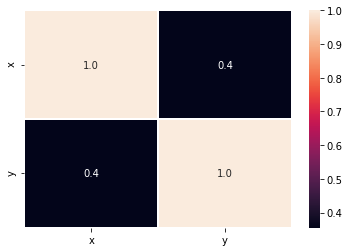

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


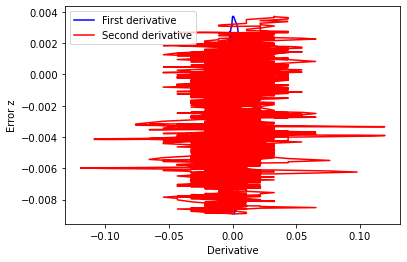

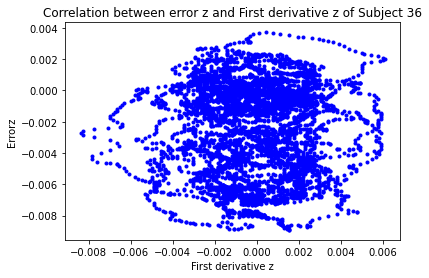

[[1.         0.02918144]
 [0.02918144 1.        ]]


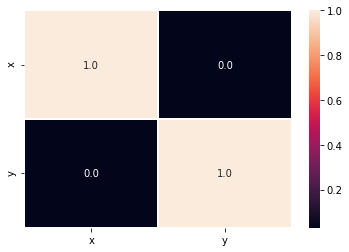

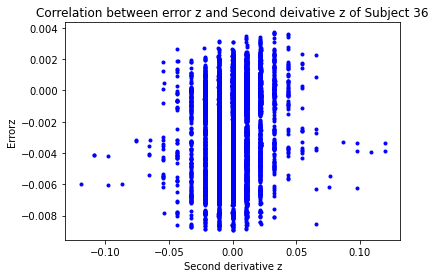

[[1.         0.14834419]
 [0.14834419 1.        ]]


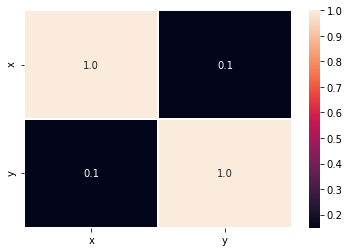

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


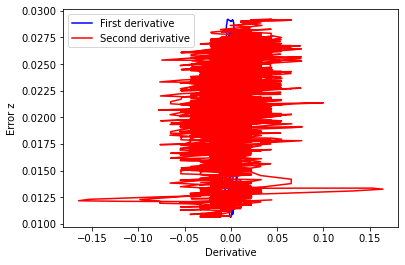

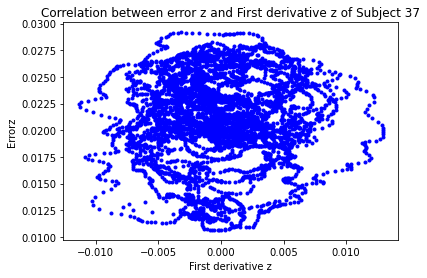

[[1.         0.02203675]
 [0.02203675 1.        ]]


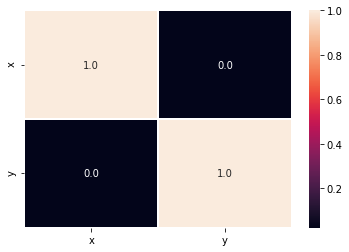

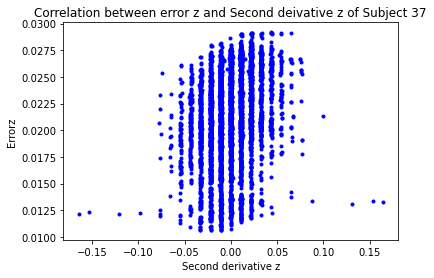

[[1.         0.26630182]
 [0.26630182 1.        ]]


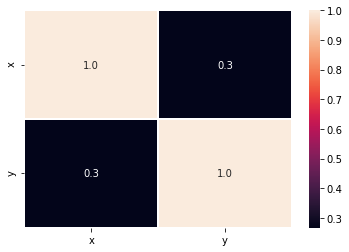

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


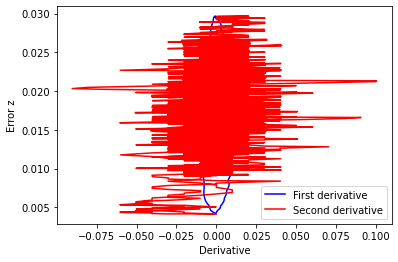

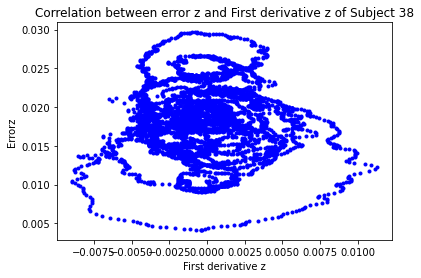

[[1.         0.01940502]
 [0.01940502 1.        ]]


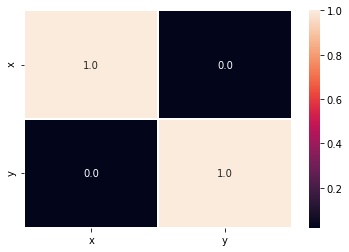

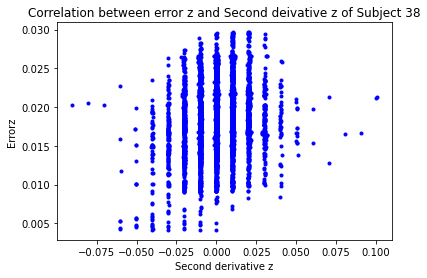

[[1.        0.2030046]
 [0.2030046 1.       ]]


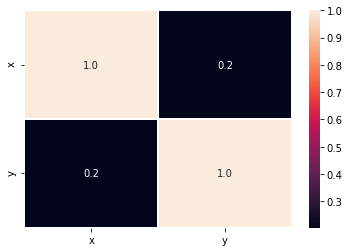

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


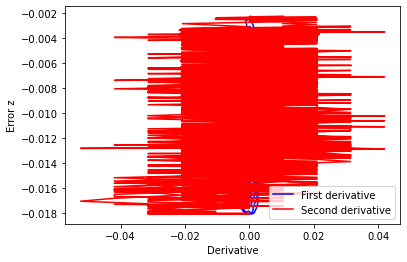

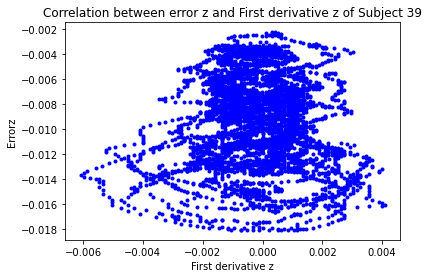

[[ 1.         -0.00189016]
 [-0.00189016  1.        ]]


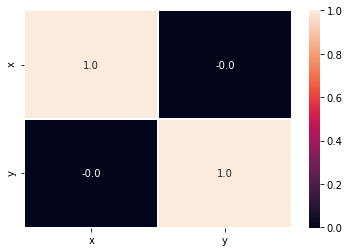

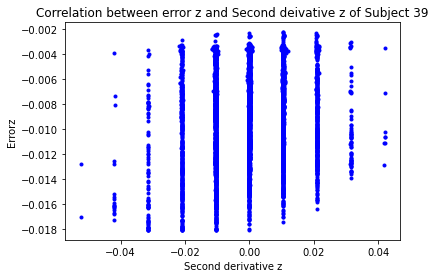

[[1.         0.14190069]
 [0.14190069 1.        ]]


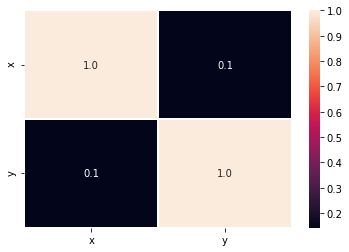

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


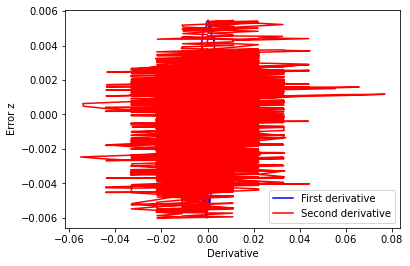

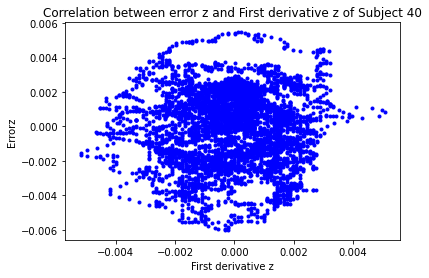

[[1.         0.03093262]
 [0.03093262 1.        ]]


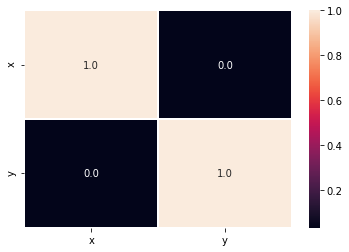

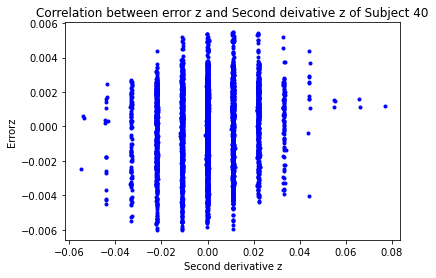

[[1.         0.11911335]
 [0.11911335 1.        ]]


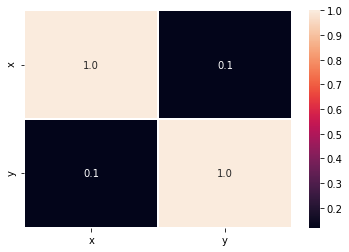

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


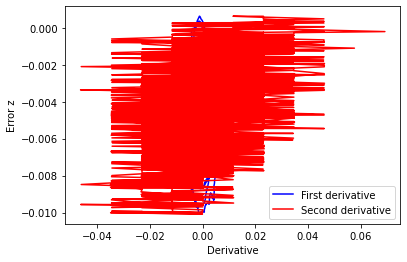

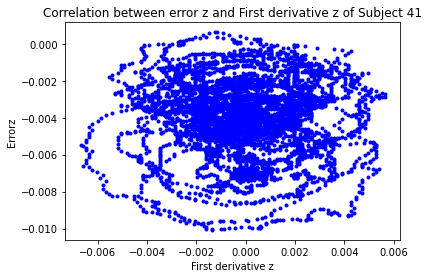

[[ 1.         -0.02828665]
 [-0.02828665  1.        ]]


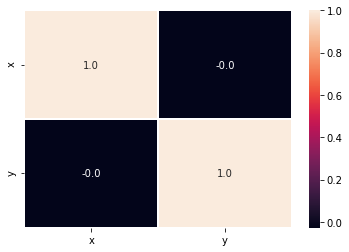

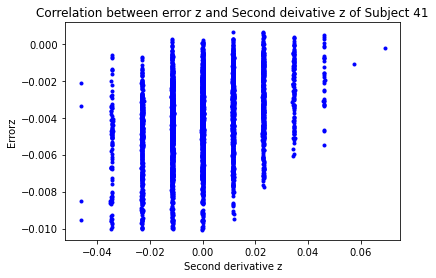

[[1.         0.29827084]
 [0.29827084 1.        ]]


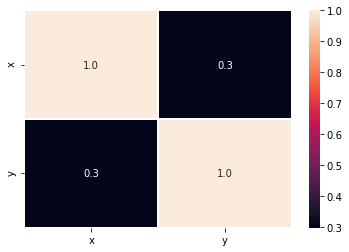

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


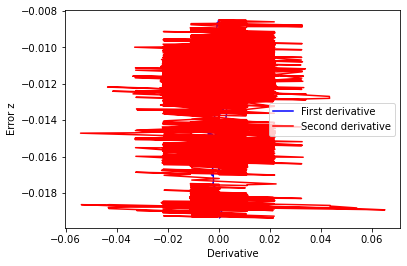

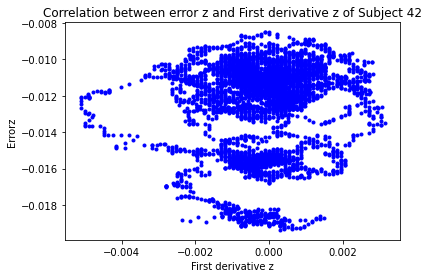

[[1.         0.11695915]
 [0.11695915 1.        ]]


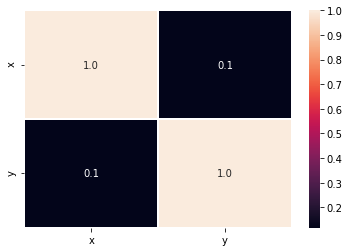

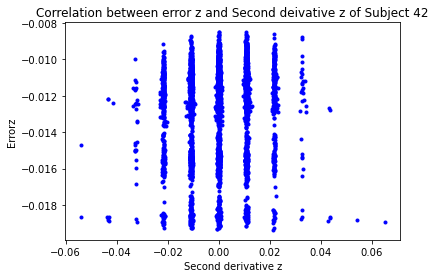

[[1.         0.06825502]
 [0.06825502 1.        ]]


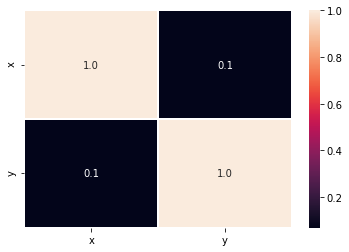

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


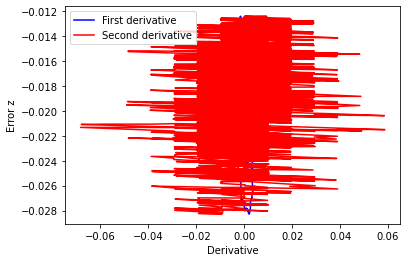

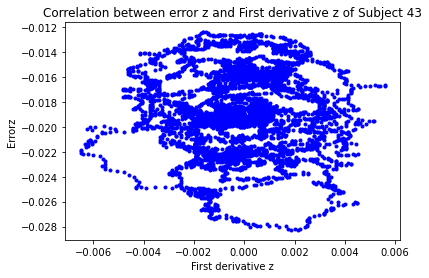

[[1.         0.00667237]
 [0.00667237 1.        ]]


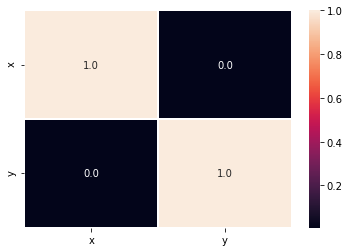

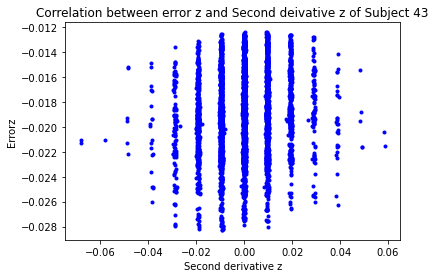

[[1.         0.11868289]
 [0.11868289 1.        ]]


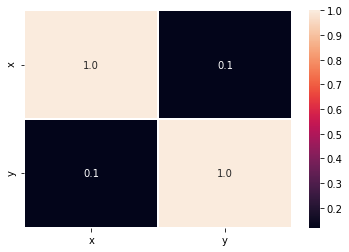

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


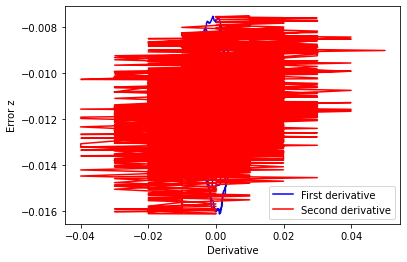

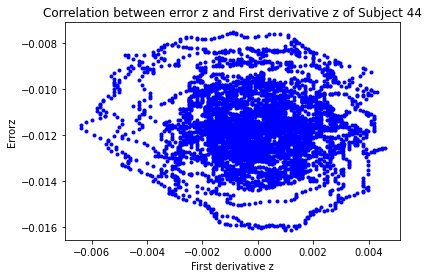

[[ 1.         -0.03846315]
 [-0.03846315  1.        ]]


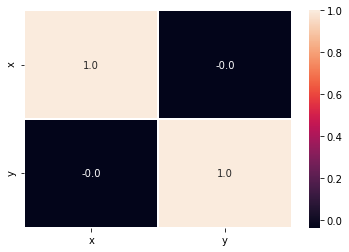

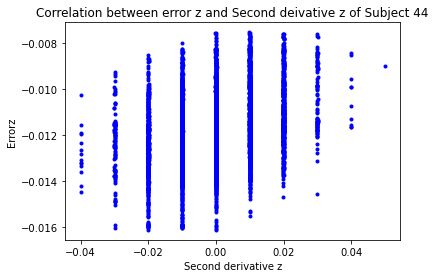

[[1.         0.30804913]
 [0.30804913 1.        ]]


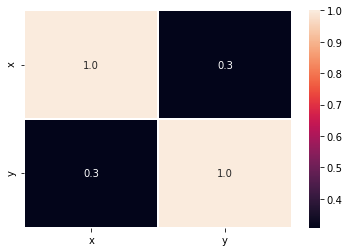

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


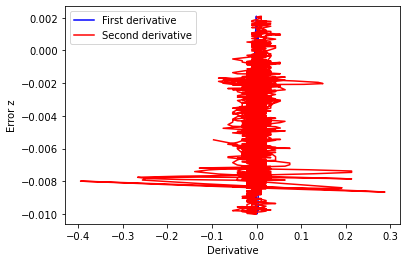

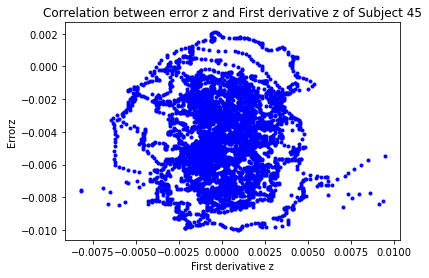

[[ 1.         -0.02771927]
 [-0.02771927  1.        ]]


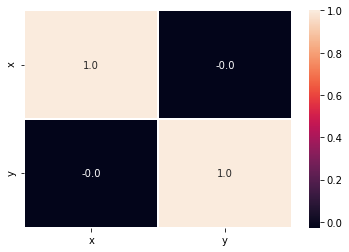

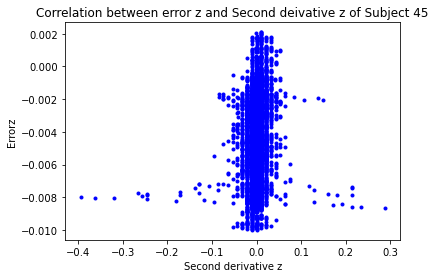

[[1.         0.11176298]
 [0.11176298 1.        ]]


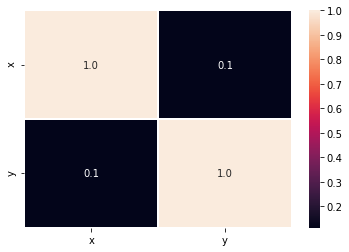

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


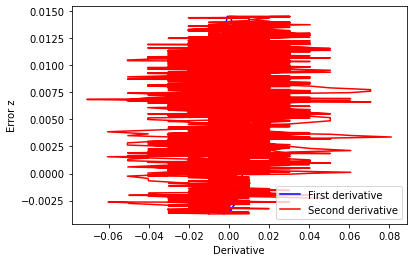

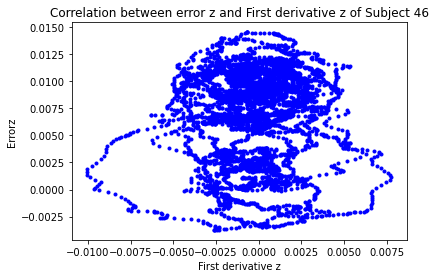

[[1.         0.05842521]
 [0.05842521 1.        ]]


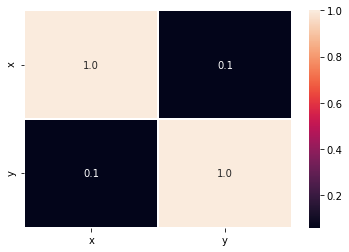

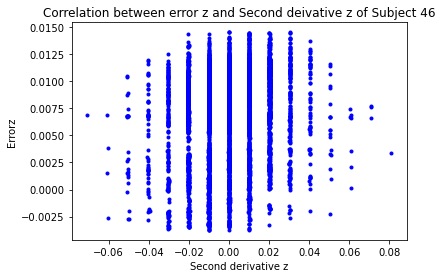

[[1.         0.15163091]
 [0.15163091 1.        ]]


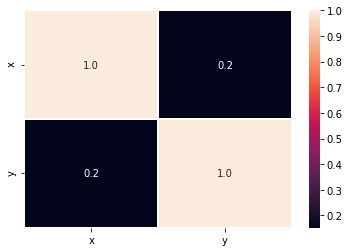

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


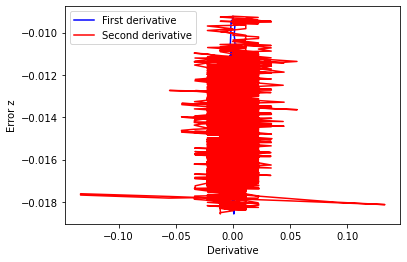

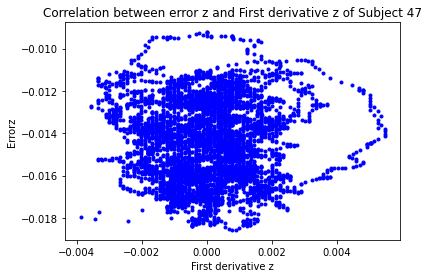

[[1.0000000e+00 4.4684679e-04]
 [4.4684679e-04 1.0000000e+00]]


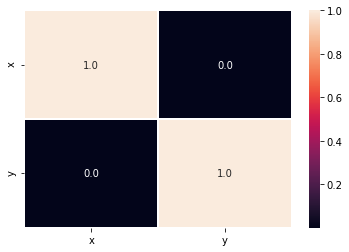

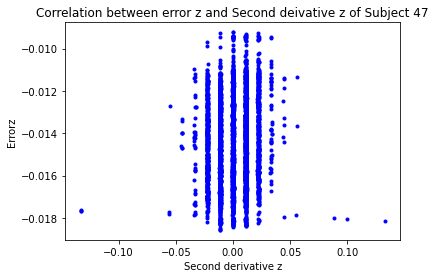

[[1.         0.09057408]
 [0.09057408 1.        ]]


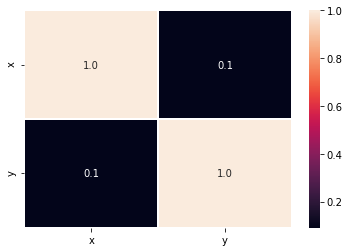

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


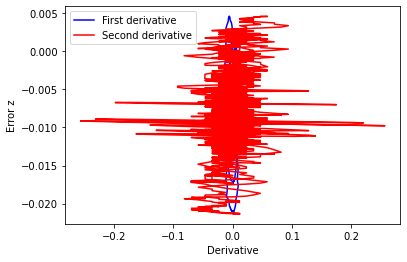

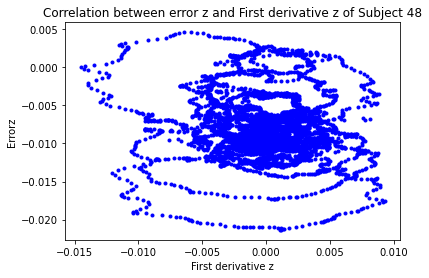

[[ 1.         -0.07130036]
 [-0.07130036  1.        ]]


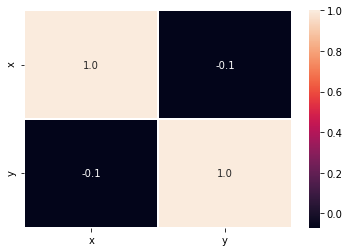

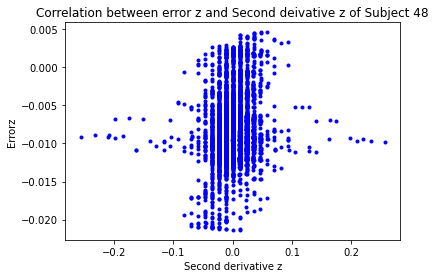

[[1.         0.16655999]
 [0.16655999 1.        ]]


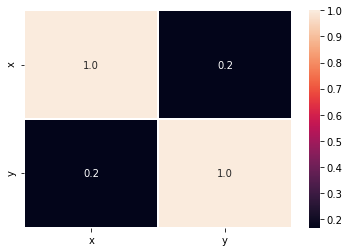

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


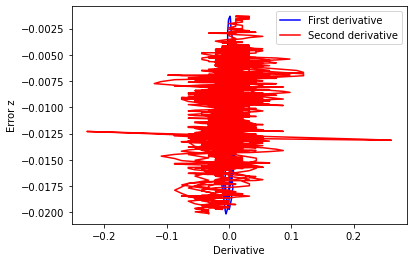

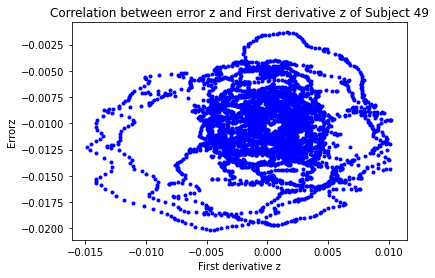

[[1.         0.02451172]
 [0.02451172 1.        ]]


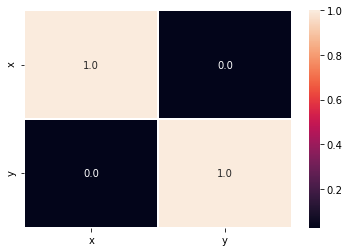

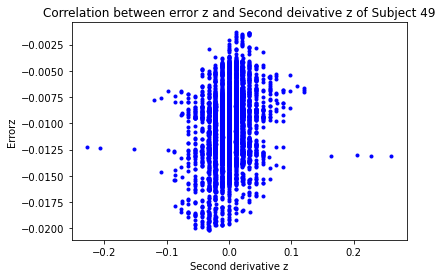

[[1.         0.25959753]
 [0.25959753 1.        ]]


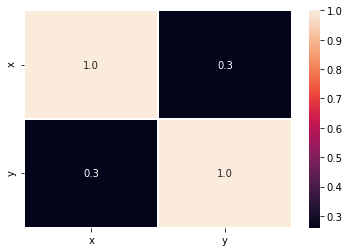

In [14]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(d1z,errorz,color='blue',label='First derivative')
    plt.plot(d2z,errorz,color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error z")
    plt.legend()
    plt.show()
    data={'x':d1z,
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("First derivative z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and First derivative z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d1z,errorz)
    print(r)
    plt.figure()
    data={'x':d1z,
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':d2z,
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Second derivative z")
    plt.ylabel("Errorz")
    plt.title("Correlation between error z and Second deivative z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d2z,errorz)
    print(r)
    plt.figure()
    data={'x':d2z,
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between errorz and Jb

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


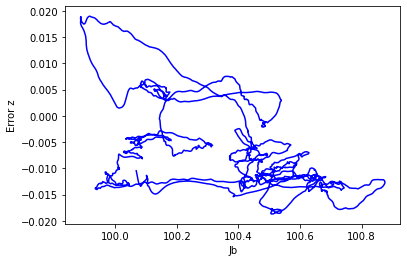

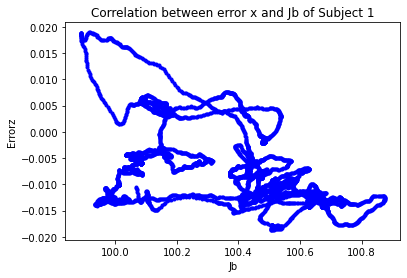

[[ 1.         -0.45900177]
 [-0.45900177  1.        ]]


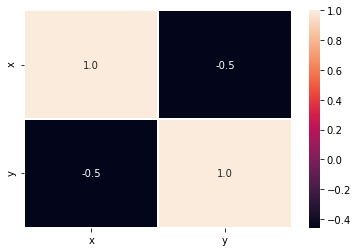

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


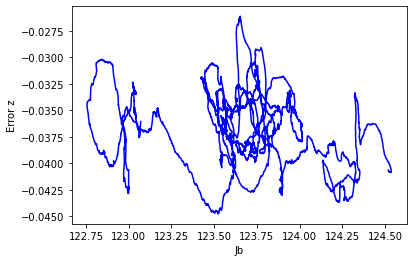

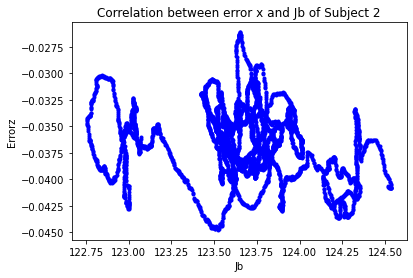

[[ 1.         -0.20859521]
 [-0.20859521  1.        ]]


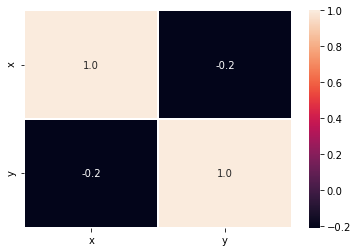

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


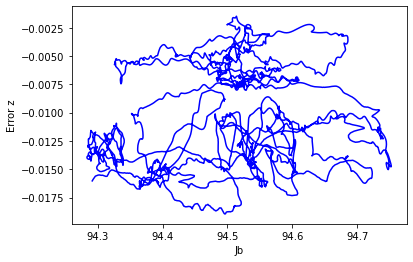

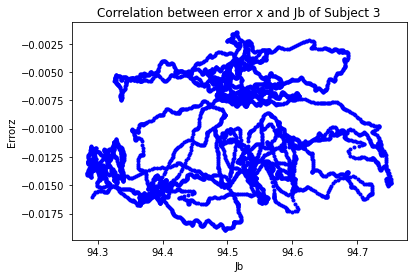

[[1.         0.19591884]
 [0.19591884 1.        ]]


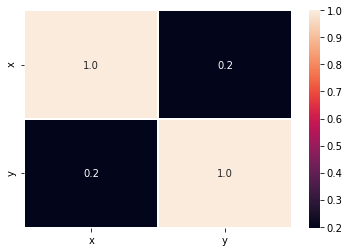

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


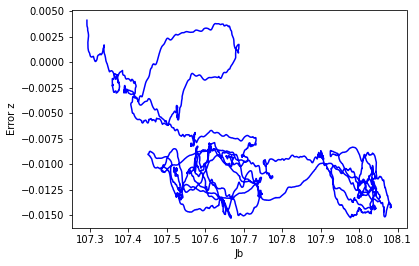

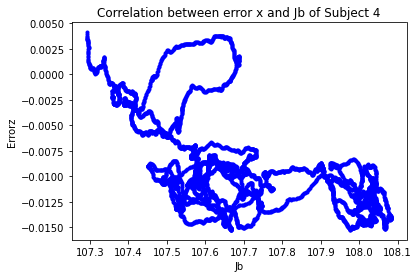

[[ 1.         -0.56280615]
 [-0.56280615  1.        ]]


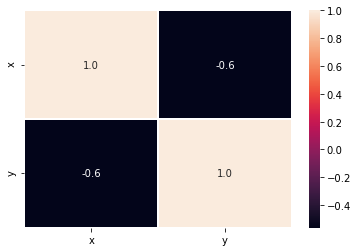

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


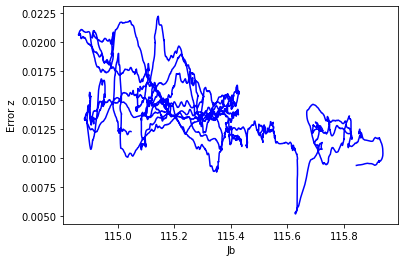

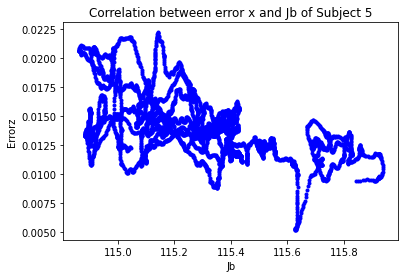

[[ 1.        -0.5779673]
 [-0.5779673  1.       ]]


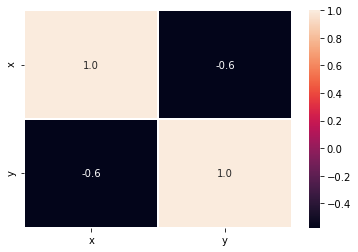

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


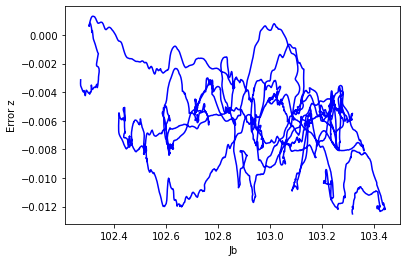

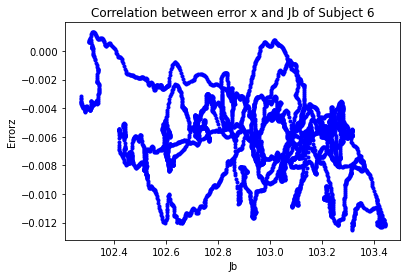

[[ 1.        -0.2456866]
 [-0.2456866  1.       ]]


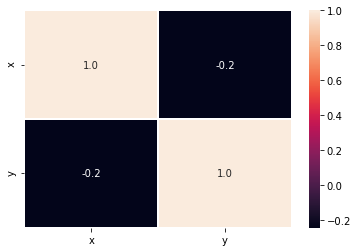

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


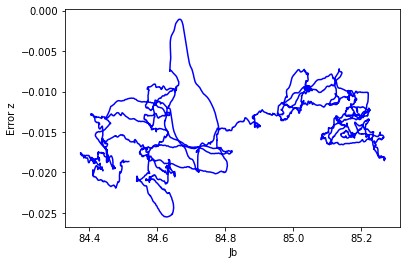

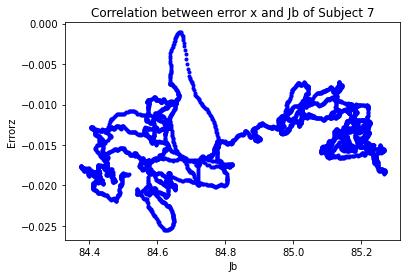

[[1.         0.41886834]
 [0.41886834 1.        ]]


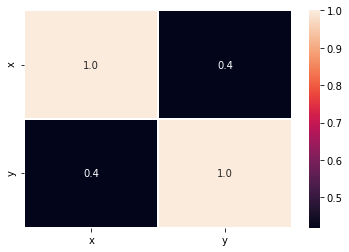

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


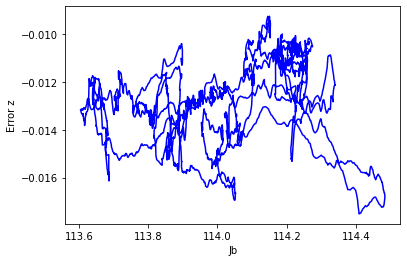

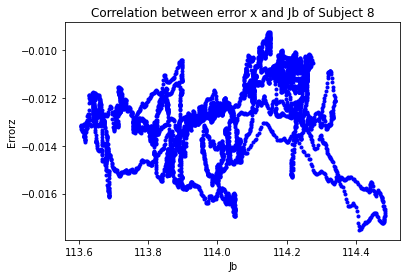

[[1.         0.30131343]
 [0.30131343 1.        ]]


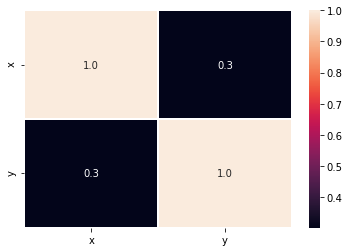

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


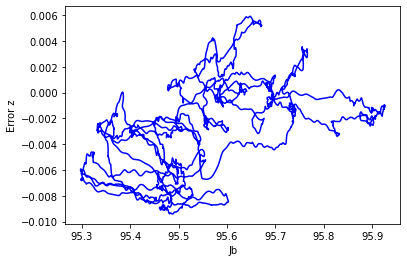

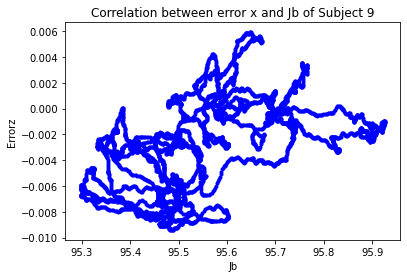

[[1.         0.49914595]
 [0.49914595 1.        ]]


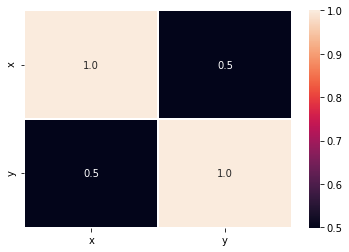

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


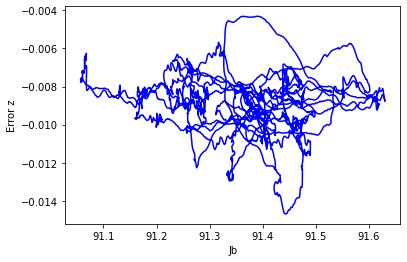

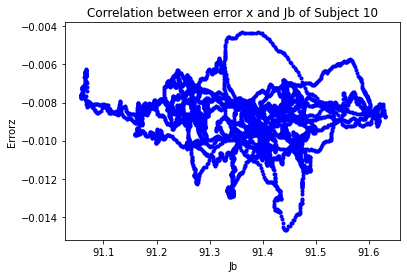

[[ 1.         -0.14645073]
 [-0.14645073  1.        ]]


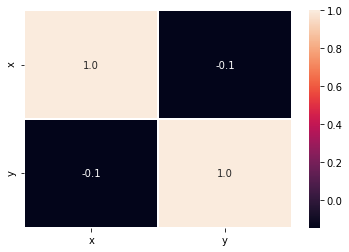

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


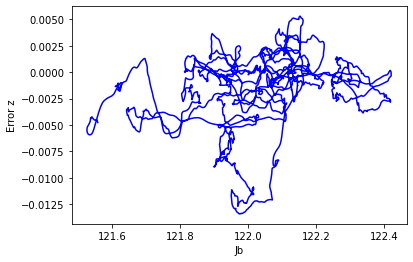

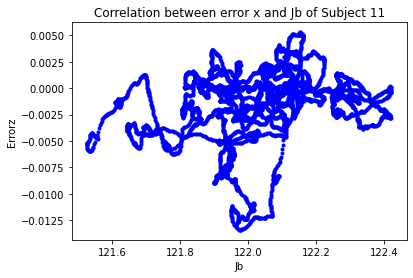

[[1.         0.25404261]
 [0.25404261 1.        ]]


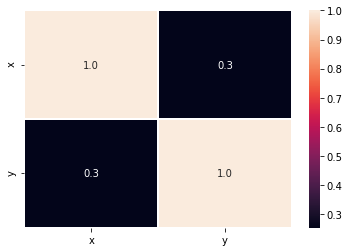

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


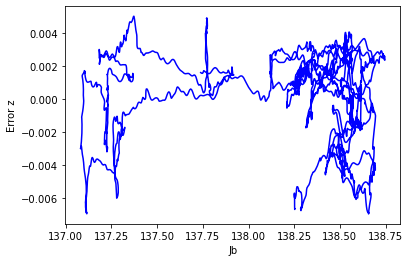

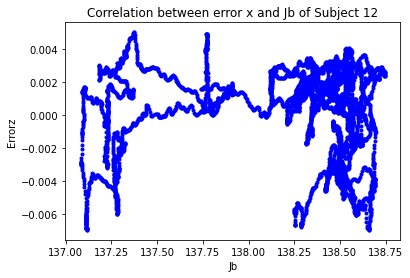

[[1.         0.02586789]
 [0.02586789 1.        ]]


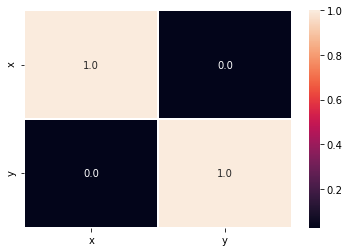

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


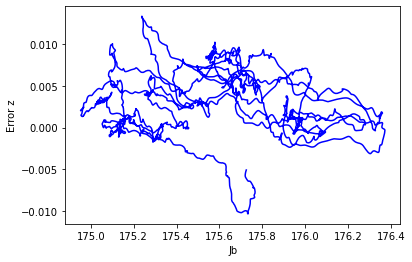

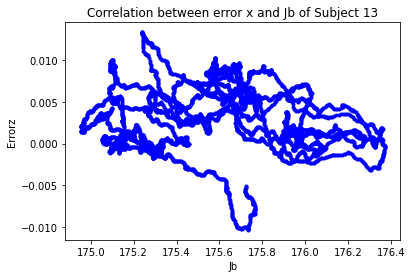

[[ 1.         -0.11708122]
 [-0.11708122  1.        ]]


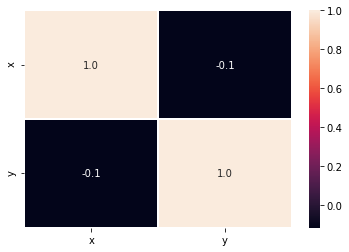

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


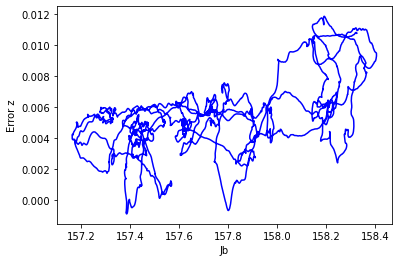

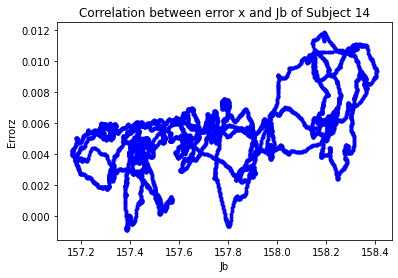

[[1.         0.53357671]
 [0.53357671 1.        ]]


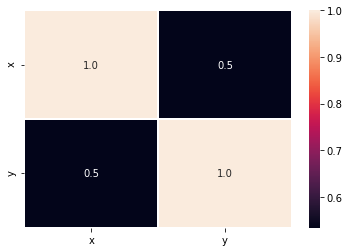

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


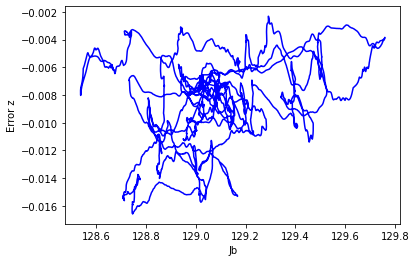

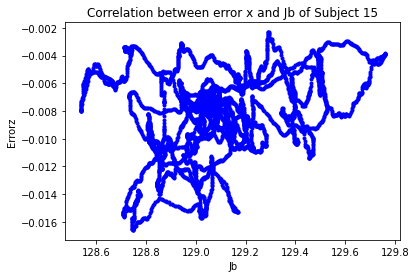

[[1.         0.29423608]
 [0.29423608 1.        ]]


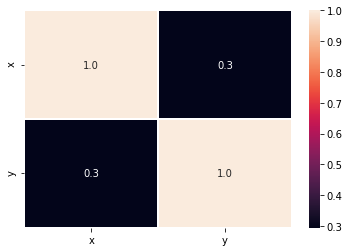

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


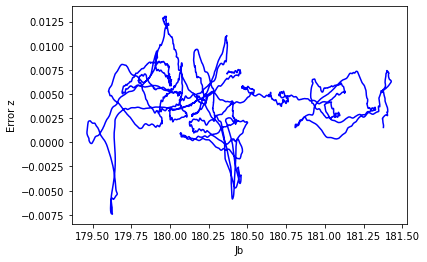

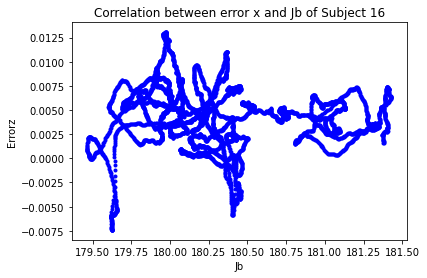

[[ 1.         -0.05674516]
 [-0.05674516  1.        ]]


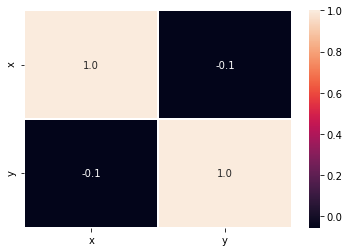

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


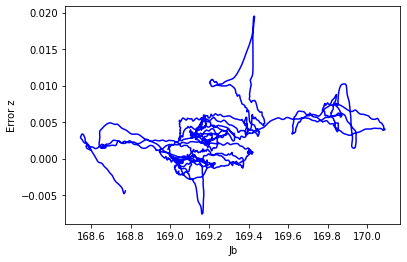

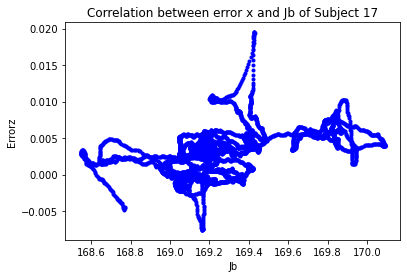

[[1.         0.46367986]
 [0.46367986 1.        ]]


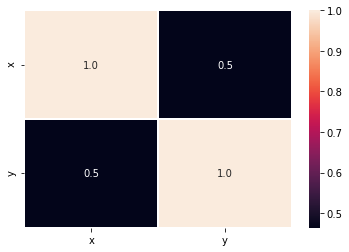

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


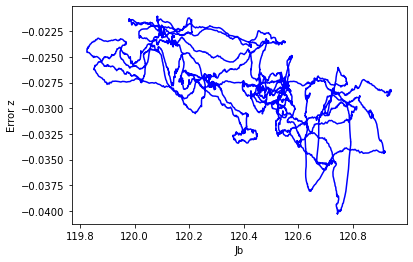

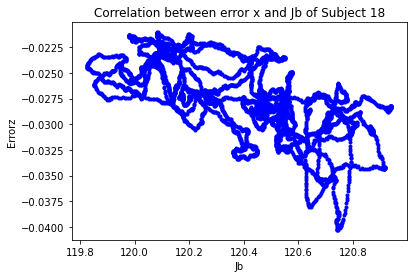

[[ 1.         -0.64930311]
 [-0.64930311  1.        ]]


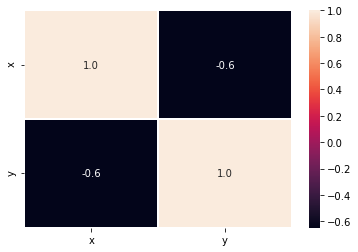

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


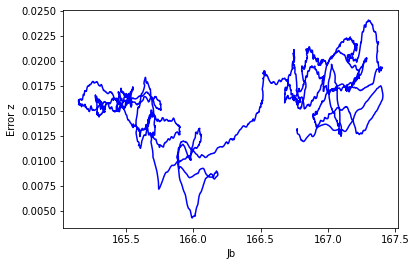

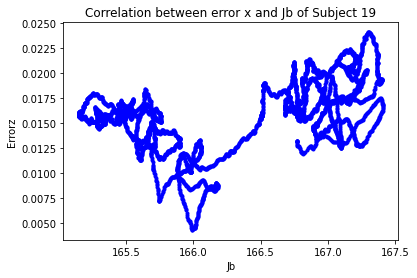

[[1.         0.46665318]
 [0.46665318 1.        ]]


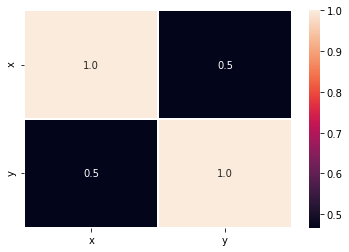

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


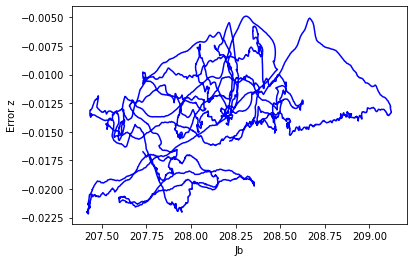

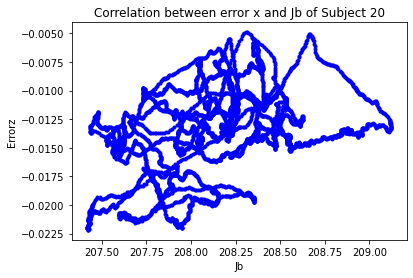

[[1.         0.36011793]
 [0.36011793 1.        ]]


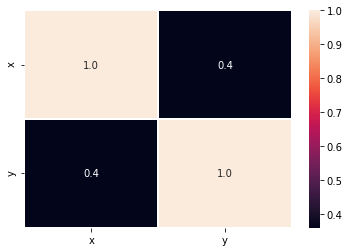

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


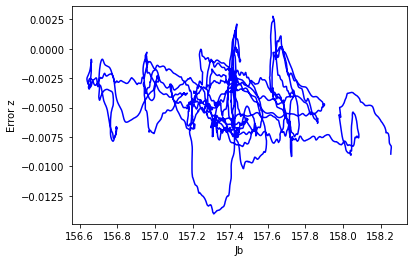

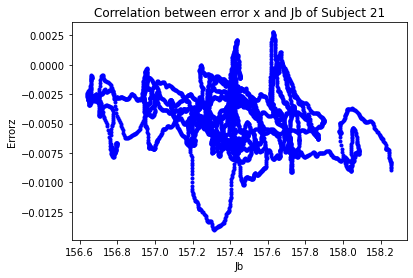

[[ 1.         -0.21607519]
 [-0.21607519  1.        ]]


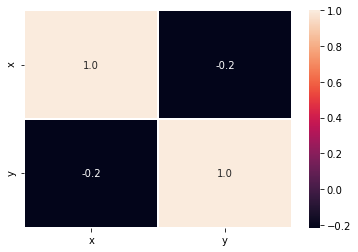

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


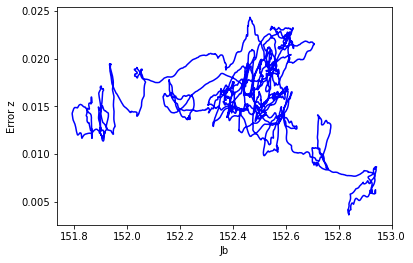

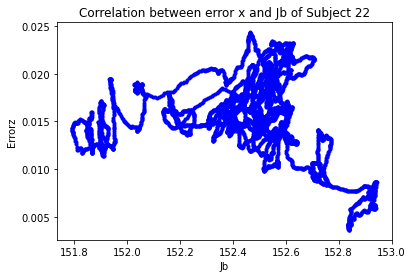

[[ 1.         -0.12601223]
 [-0.12601223  1.        ]]


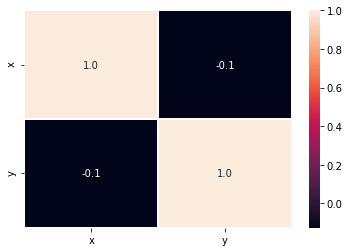

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


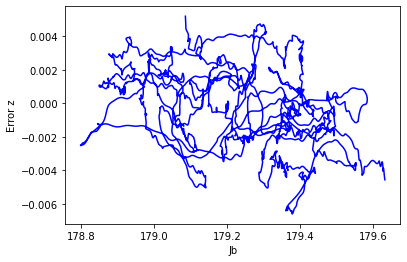

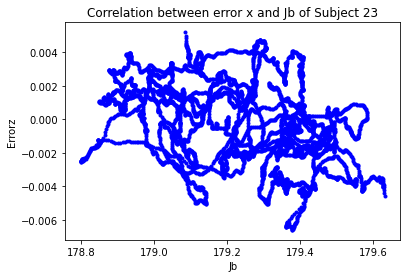

[[ 1.        -0.3641622]
 [-0.3641622  1.       ]]


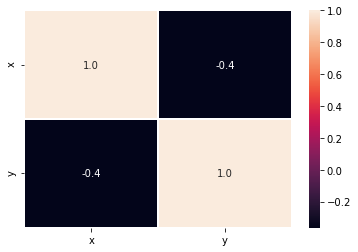

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


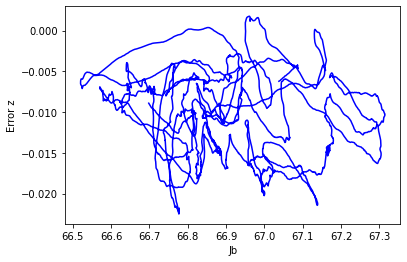

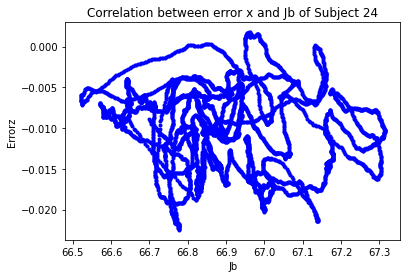

[[ 1.         -0.13666384]
 [-0.13666384  1.        ]]


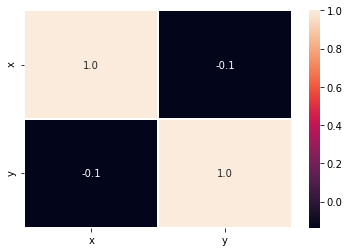

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


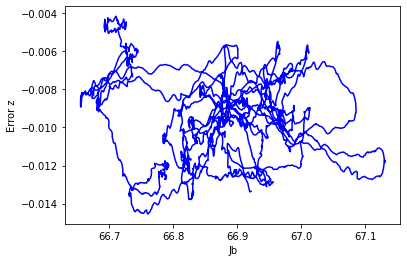

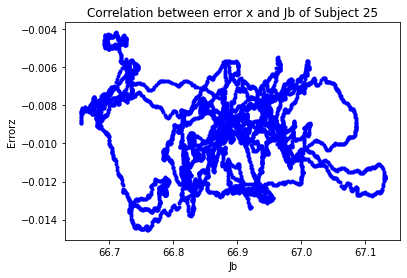

[[ 1.         -0.11796852]
 [-0.11796852  1.        ]]


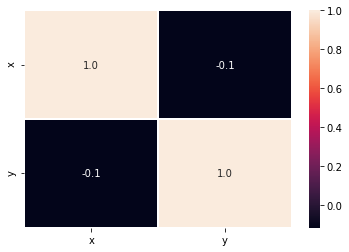

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


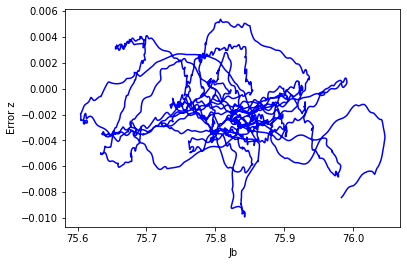

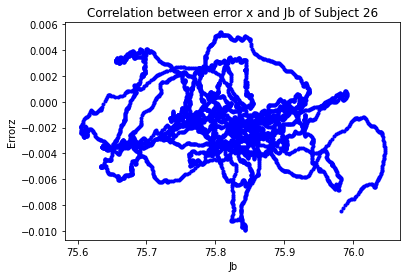

[[ 1.         -0.14421503]
 [-0.14421503  1.        ]]


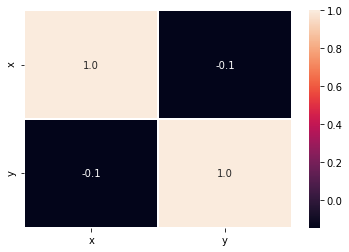

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


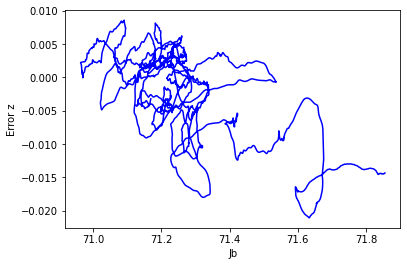

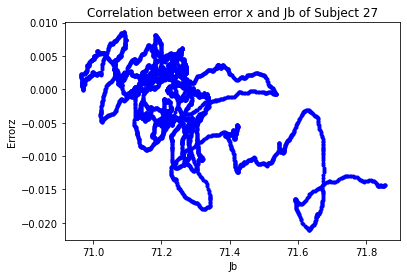

[[ 1.         -0.57990972]
 [-0.57990972  1.        ]]


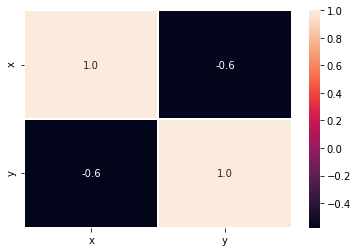

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


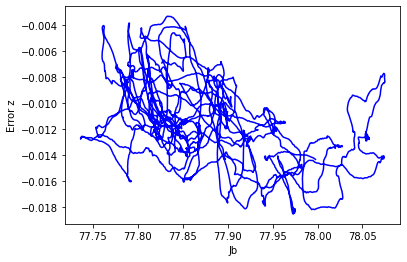

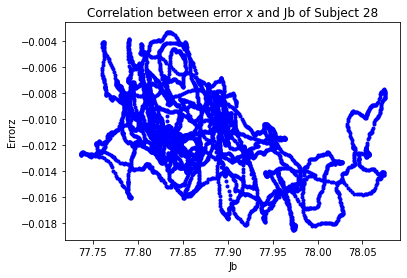

[[ 1.         -0.45534953]
 [-0.45534953  1.        ]]


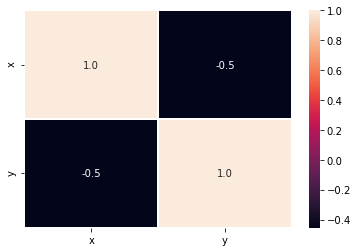

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


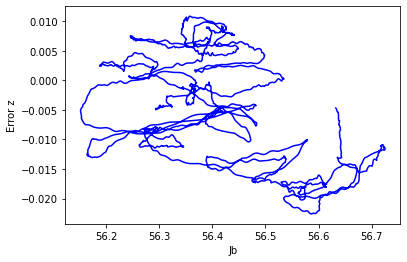

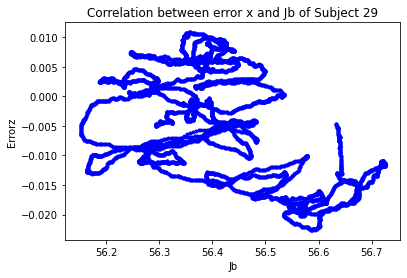

[[ 1.         -0.48717573]
 [-0.48717573  1.        ]]


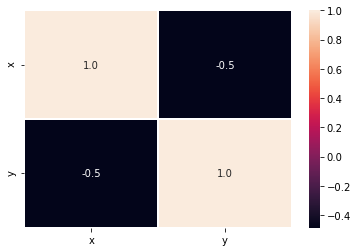

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


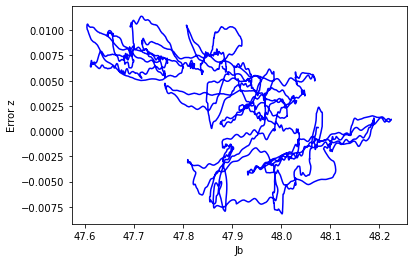

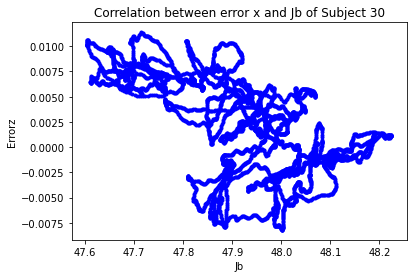

[[ 1.         -0.58562374]
 [-0.58562374  1.        ]]


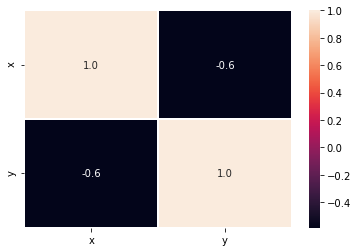

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


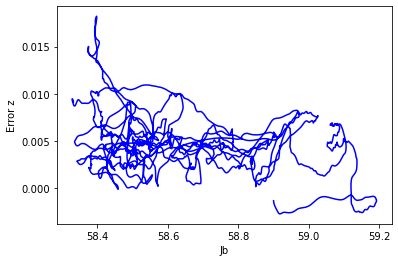

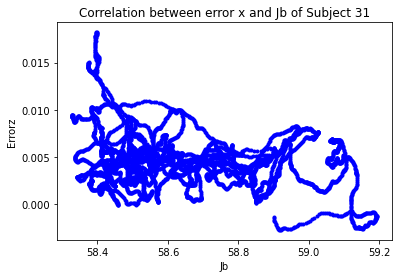

[[ 1.         -0.27034111]
 [-0.27034111  1.        ]]


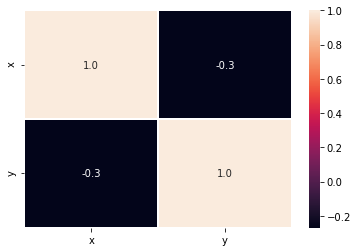

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


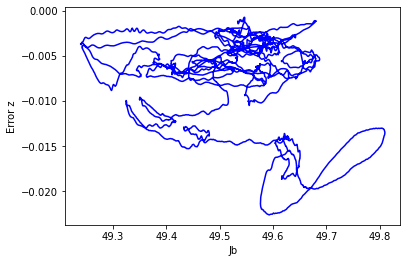

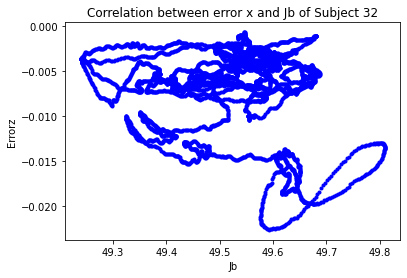

[[ 1.         -0.12851233]
 [-0.12851233  1.        ]]


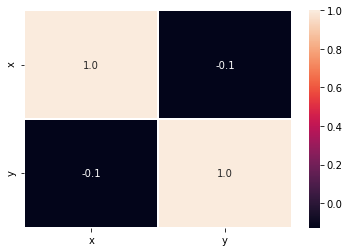

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


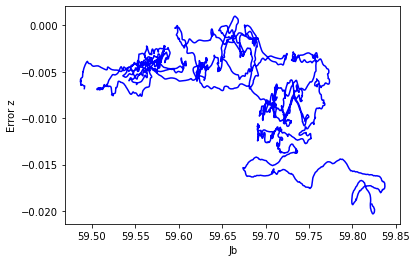

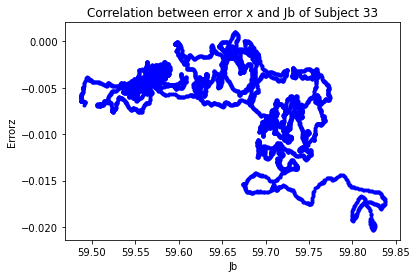

[[ 1.         -0.51639368]
 [-0.51639368  1.        ]]


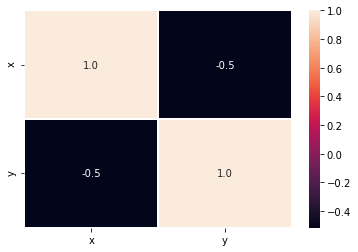

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


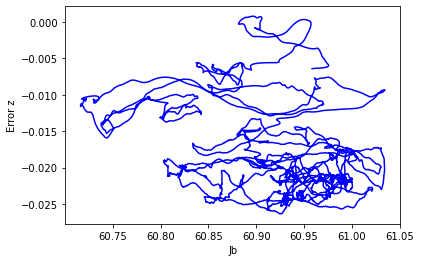

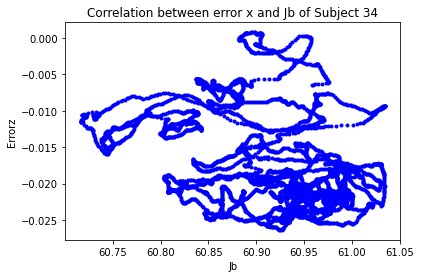

[[ 1.        -0.3514397]
 [-0.3514397  1.       ]]


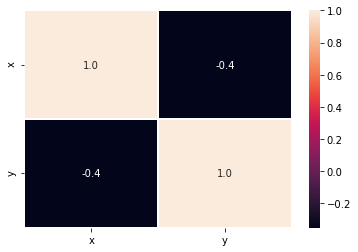

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


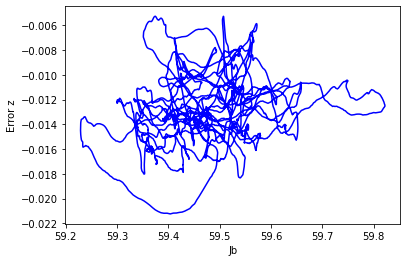

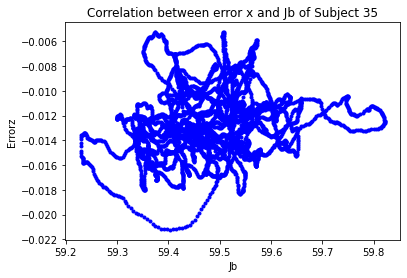

[[1.         0.19194205]
 [0.19194205 1.        ]]


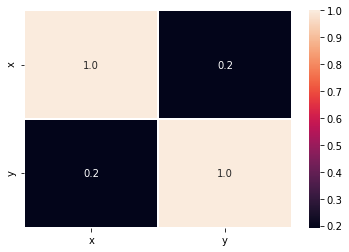

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


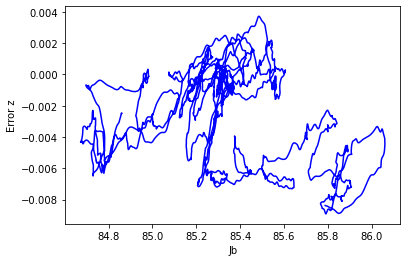

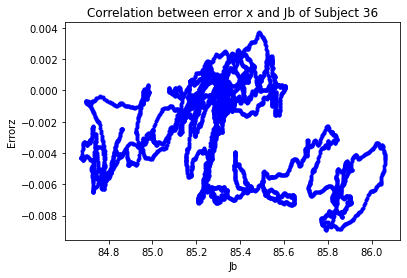

[[ 1.         -0.19227474]
 [-0.19227474  1.        ]]


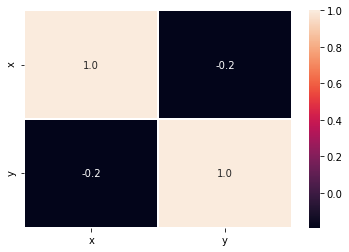

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


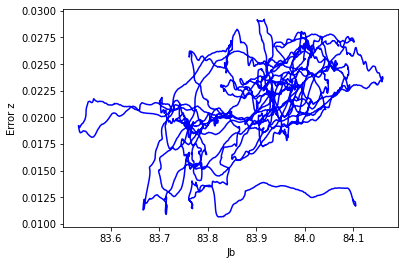

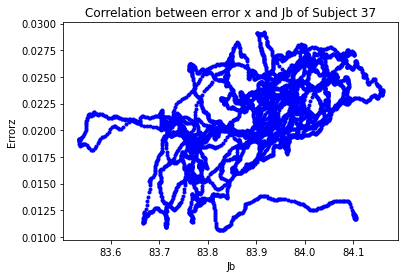

[[1.         0.49848038]
 [0.49848038 1.        ]]


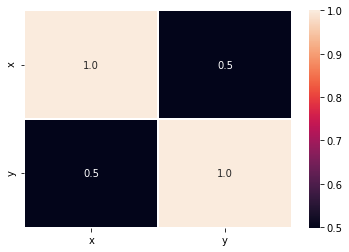

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


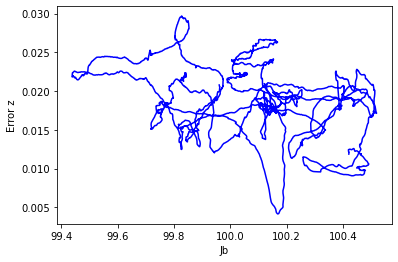

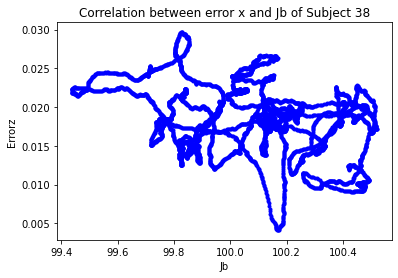

[[ 1.         -0.31236169]
 [-0.31236169  1.        ]]


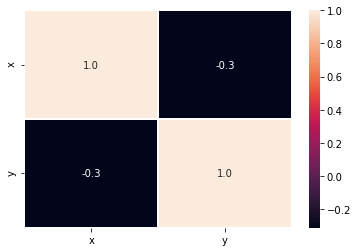

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


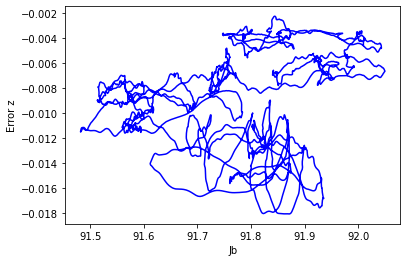

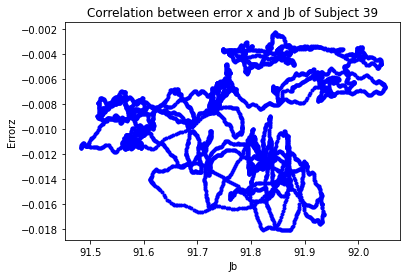

[[1.         0.17256888]
 [0.17256888 1.        ]]


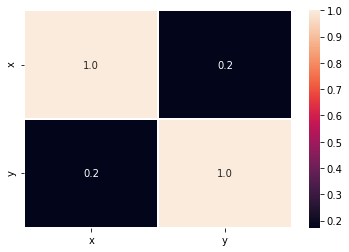

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


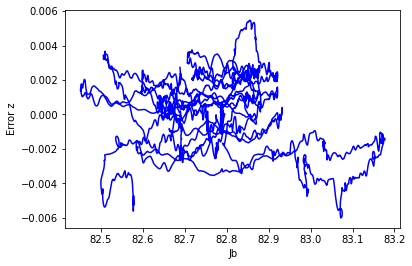

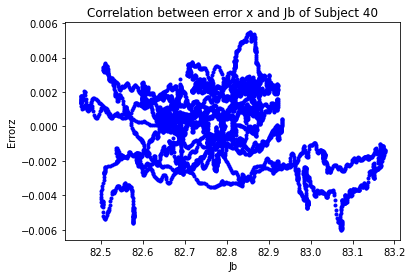

[[ 1.         -0.24291392]
 [-0.24291392  1.        ]]


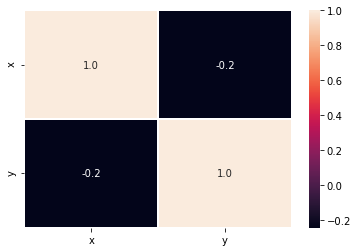

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


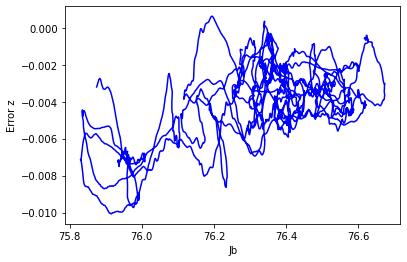

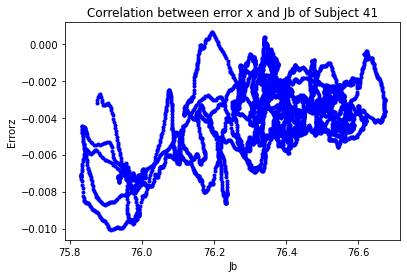

[[1.         0.55624244]
 [0.55624244 1.        ]]


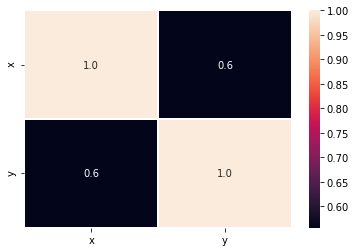

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


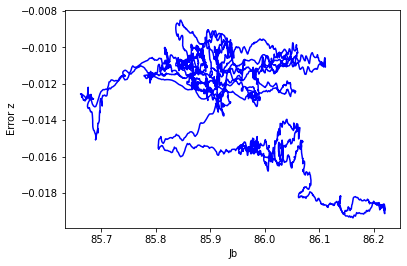

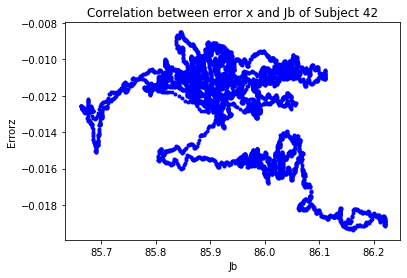

[[ 1.         -0.47358201]
 [-0.47358201  1.        ]]


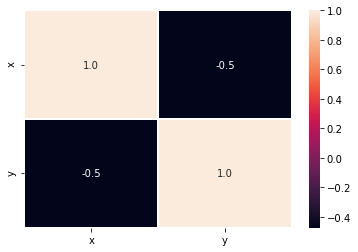

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


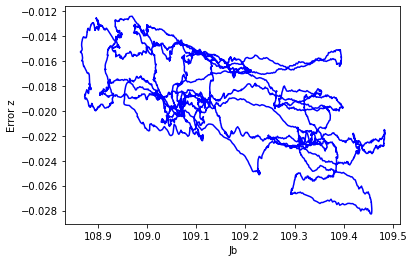

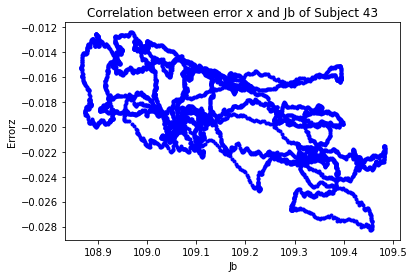

[[ 1.       -0.617075]
 [-0.617075  1.      ]]


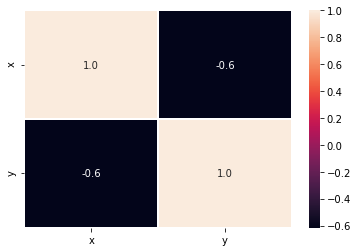

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


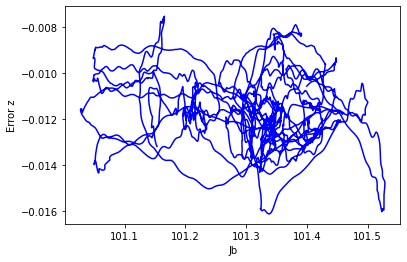

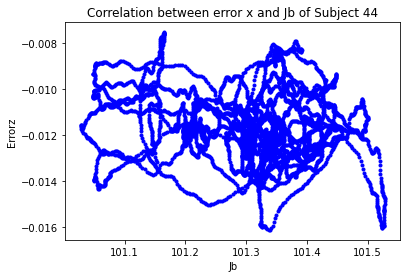

[[ 1.         -0.18492511]
 [-0.18492511  1.        ]]


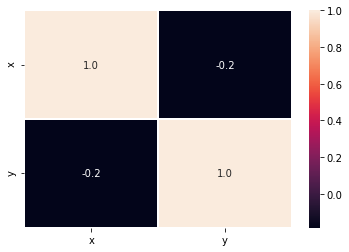

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


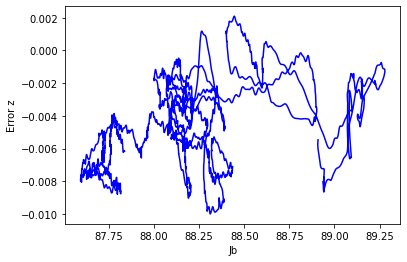

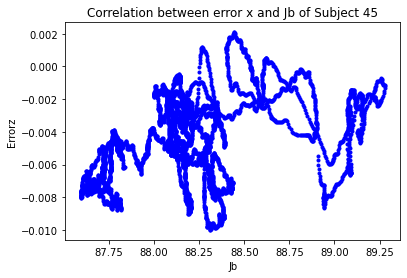

[[1.         0.38844216]
 [0.38844216 1.        ]]


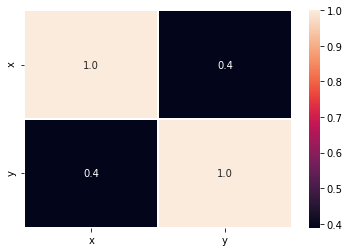

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


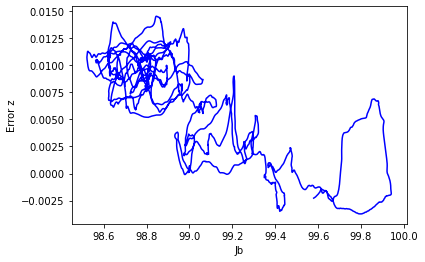

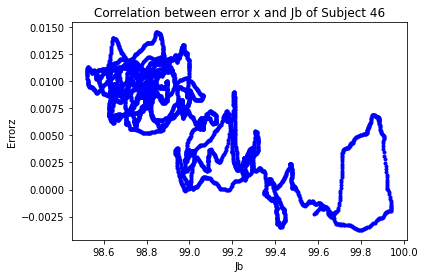

[[ 1.       -0.748423]
 [-0.748423  1.      ]]


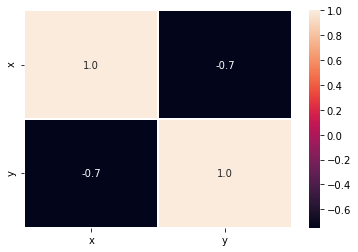

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


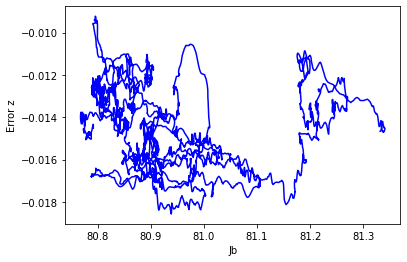

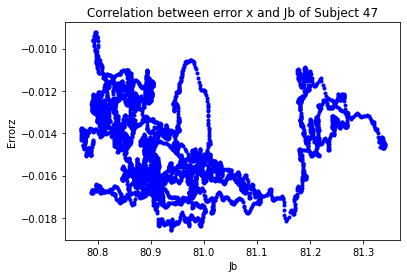

[[ 1.         -0.13384663]
 [-0.13384663  1.        ]]


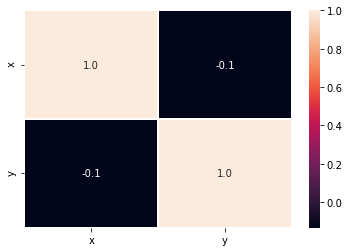

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


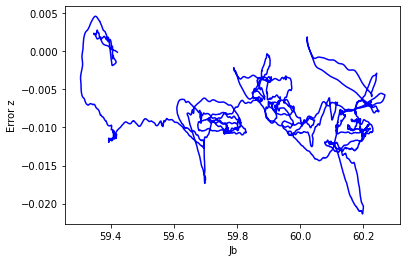

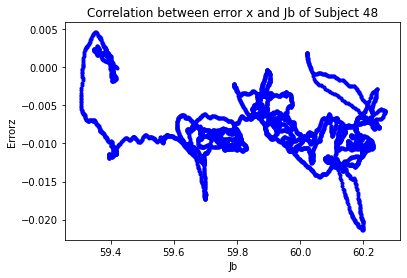

[[ 1.         -0.30635196]
 [-0.30635196  1.        ]]


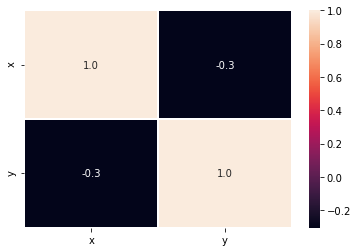

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


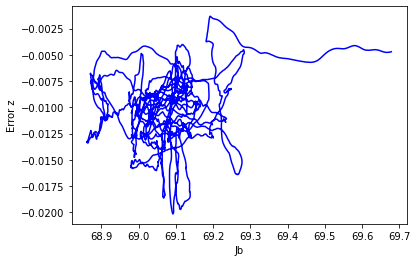

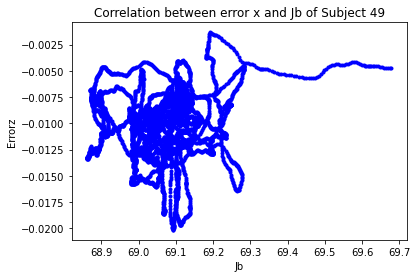

[[1.         0.11868432]
 [0.11868432 1.        ]]


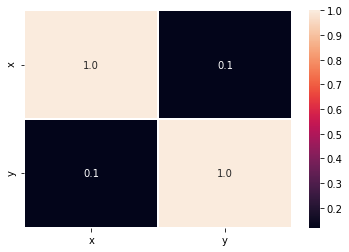

In [15]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(Jb,errorz,color='blue')
    plt.xlabel("Jb")
    plt.ylabel("Error z")
    plt.show()
    data={'x':Jb,
         'y': errorz
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Jb")
    plt.ylabel("Errorz")
    plt.title("Correlation between error x and Jb of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(Jb,errorz)
    print(r)
    plt.figure()
    data={'x':Jb,
         'y': errorz
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    